In [68]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 

import json
from random import uniform
from glob import glob 
from copy import deepcopy

from engine import Engine, args_template


In [83]:
np.exp(np.sqrt(0.05))

1.2505791921887124

In [2]:
# engine = Engine("train/model/20190619_001.pt")
engine = Engine("train/model/20190704_002.pt")

In [51]:
wl = [i for i in range(660, 811, 10)]
engine.wl = wl

### mua

In [54]:
mua = pd.read_csv("input/coefficients.csv")
mua = mua[
    (mua["wavelength"] >= wl[0])&
    (mua["wavelength"] <= wl[-1])
]
oxy = mua["oxy"] * 0.1
deoxy = mua["deoxy"] * 0.1

In [4]:
x_range = {
    "sb": (0, 0.1),
    "ss": (0.5, 1.0),
    "sw": (0, 1.0),
    "sf": (0, 1.0),
    "sm": (0, 1.0),

    "fb": (0, 0.1),
    "fs": (0, 1.0),
    "ff": (0.9, 1),

    "mb": (0.005, 0.1),
    "ms": (0.0, 1.0),
    "mw": (0.0, 1.0),

    "is": (0.4, 0.8),

    "cs": (0.85, 1.0),
}

In [5]:
def get_args(geo_max, geo_min):
    
    # absorption
    sb = uniform(x_range["sb"][0], x_range["sb"][1])
    ss = uniform(x_range["ss"][0], x_range["ss"][1])
    sw = uniform(x_range["sw"][0], max(x_range["sw"][0], min(x_range["sw"][1], 1-sb)))
    sf = uniform(x_range["sf"][0], max(x_range["sf"][0], min(x_range["sf"][1], 1-sb-sw)))
    sm = 1-sb-sw-sf
    
    fb = uniform(x_range["fb"][0], x_range["fb"][1])
    fs = uniform(x_range["fs"][0], x_range["fs"][1])
    ff = 1 - fb
    
    mb = uniform(x_range["mb"][0], x_range["mb"][1])
    ms = uniform(x_range["ms"][0], x_range["ms"][1])
    mw = uniform(x_range["mw"][0], max(x_range["mw"][0], min(x_range["mw"][1], 1-mb)))
    mc = 1 - mb - mw
    is_ = uniform(x_range["is"][0], x_range["is"][1])
    cs = uniform(x_range["cs"][0], x_range["cs"][1])
    
    # scattering
    s_musp = uniform(29.7, 48.9)
    s_bmie = uniform(0.705, 2.453)
    
    f_musp = uniform(13.7, 35.8)
    f_bmie = uniform(0.385, 0.988)
    
    m_musp = uniform(9.8, 13.0)
    m_bmie = uniform(0.926, 2.82)
    
    i_musp = uniform(0.1, 1)
    i_bmie = uniform(1, 1)
    
    c_musp = uniform(0.1, 1)
    c_bmie = uniform(1, 1)
    
    # scattering 亂調整
#     s_musp = uniform(0, 0.9)
#     s_bmie = uniform(0.705, 2.453)
    
#     f_musp = uniform(0, 3.8)
#     f_bmie = uniform(0.385, 0.988)
    
#     m_musp = uniform(0, 5.0)
#     m_bmie = uniform(0.926, 2.82)
    
#     i_musp = uniform(0.1, 1)
#     i_bmie = uniform(1, 1)
    
#     c_musp = uniform(0.1, 1)
#     c_bmie = uniform(1, 1)
    
    
        
    args_max = {
        "skin":{
            "blood_volume_fraction": sb,
            "ScvO2": ss,
            "water_volume": sw,
            "fat_volume": sf,
            "melanin_volume": sm,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.71,
            "muspx": s_musp,
            "bmie": s_bmie
        },

        "fat":{
            "blood_volume_fraction": fb,
            "ScvO2": fs,
            "water_volume": 0,
            "fat_volume": ff,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.90,
            "muspx": f_musp,
            "bmie": f_bmie
        },

        "muscle":{
            "blood_volume_fraction": mb,
            "ScvO2": ms,
            "water_volume": mw,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": mc,
            "n": 1.40,
            "g": 0.9,
            "muspx": m_musp,
            "bmie": m_bmie
        },

        "IJV":{
            "blood_volume_fraction": 1.0,
            "ScvO2": is_,
            "water_volume": 0,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.90,
            "muspx": i_musp,
            "bmie": i_bmie
        },

        "CCA":{
            "blood_volume_fraction": 1.0,
            "ScvO2": cs,
            "water_volume": 0,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.94,
            "muspx": c_musp,
            "bmie": c_bmie
        },
        "geometry": geo_max
    }
    args_min = {
        "skin":{
            "blood_volume_fraction": sb,
            "ScvO2": ss,
            "water_volume": sw,
            "fat_volume": sf,
            "melanin_volume": sm,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.71,
            "muspx": s_musp,
            "bmie": s_bmie
        },

        "fat":{
            "blood_volume_fraction": fb,
            "ScvO2": fs,
            "water_volume": 0,
            "fat_volume": ff,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.90,
            "muspx": f_musp,
            "bmie": f_bmie
        },

        "muscle":{
            "blood_volume_fraction": mb,
            "ScvO2": ms,
            "water_volume": mw,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": mc,
            "n": 1.40,
            "g": 0.9,
            "muspx": m_musp,
            "bmie": m_bmie
        },

        "IJV":{
            "blood_volume_fraction": 1.0,
            "ScvO2": is_,
            "water_volume": 0,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.90,
            "muspx": i_musp,
            "bmie": i_bmie
        },

        "CCA":{
            "blood_volume_fraction": 1.0,
            "ScvO2": cs,
            "water_volume": 0,
            "fat_volume": 0,
            "melanin_volume": 0,
            "collagen_volume": 0,
            "n": 1.40,
            "g": 0.94,
            "muspx": c_musp,
            "bmie": c_bmie
        },
        "geometry": geo_min
    }
    return args_max, args_min

In [35]:
def rmse_loss(x, y):
    return np.sqrt(((x - y)**2)).mean()
def rmsp_loss(x, y):
    return np.sqrt(((1 - y/x)**2)).mean()

In [7]:
def normalize(x):
    return (x - x.mean())/x.std()

In [8]:
def normalize(x):
    x = x - x.min()
    x /= x.max()
    return x

### 0524 (是澂)

In [45]:
spec_list = glob("data/calibrated/20190524_split/IJV/20190524_split_*_*.csv")
spec_list.sort(key=
    lambda x: (int(x.split('_')[-2]), int(x.split('_')[-1].strip('.csv')))
)

1: 正常
2, 3, 4: 過度換氣 ,
5, 6, 7: 吸氧氣 

data/calibrated/20190524_split/IJV/20190524_split_1_1.csv
iter: 4 | loss: 0.8297766169201197


/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.


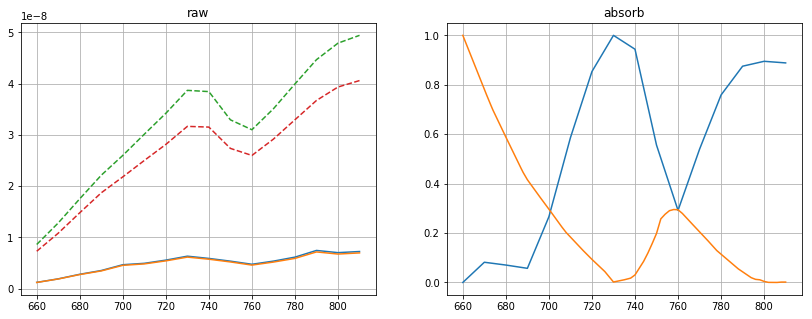

parameters: 
0.44782501964336974
iter: 19 | loss: 0.14263520606655275


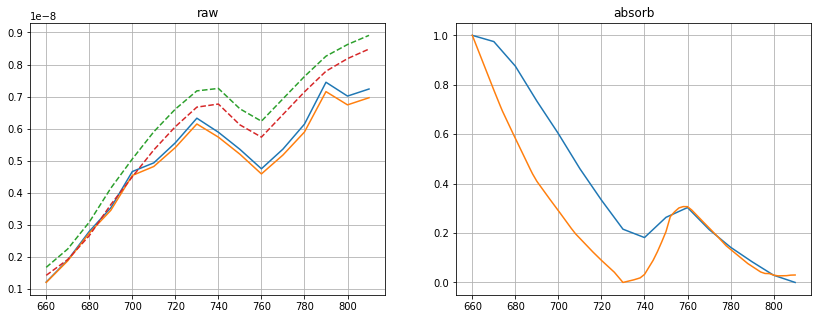

parameters: 
0.4854373209600075
iter: 40 | loss: 0.06668171871344286


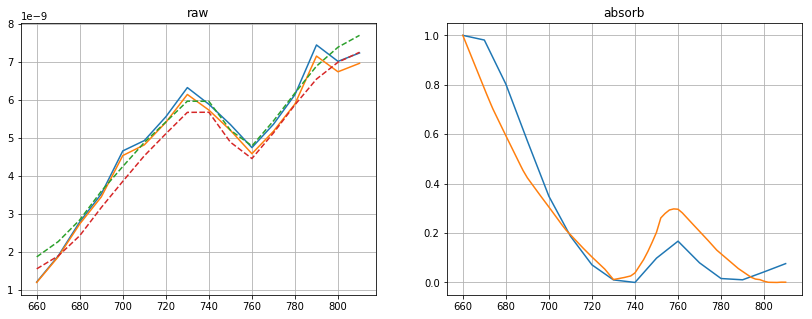

parameters: 
0.43359735809152


/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


iter: 2726 | loss: 0.06572322909907834


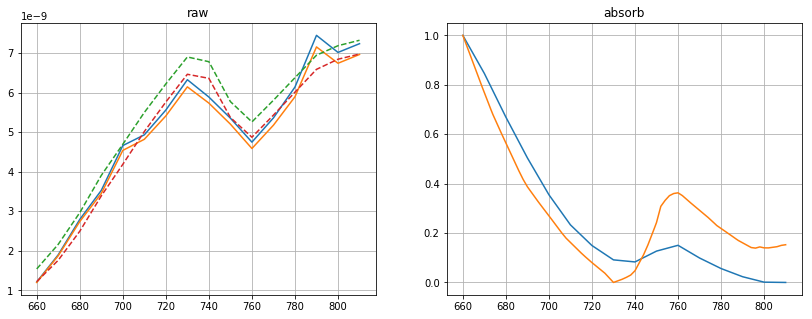

parameters: 
0.5940504771585319
data/calibrated/20190524_split/IJV/20190524_split_1_2.csv
iter: 1 | loss: 0.19760117560175944


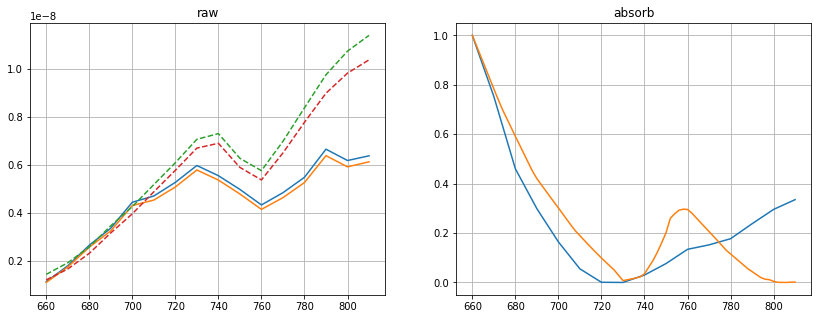

parameters: 
0.43980213431173487
iter: 48 | loss: 0.17396210755250047


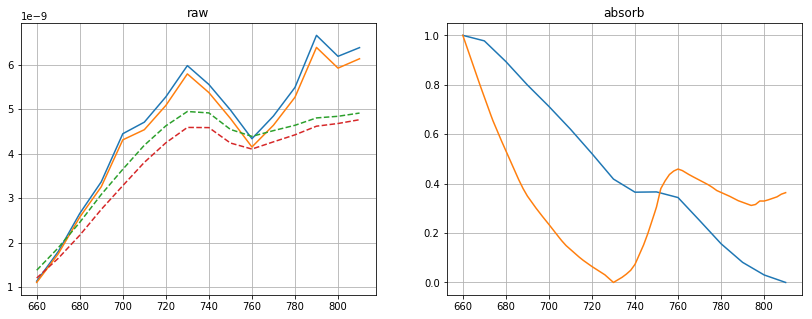

parameters: 
0.6984380503308959
iter: 138 | loss: 0.12873801483205766


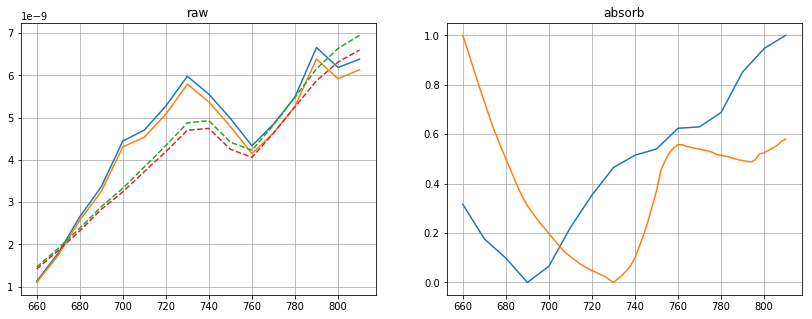

parameters: 
0.75862733843954
iter: 160 | loss: 0.11288085161809656


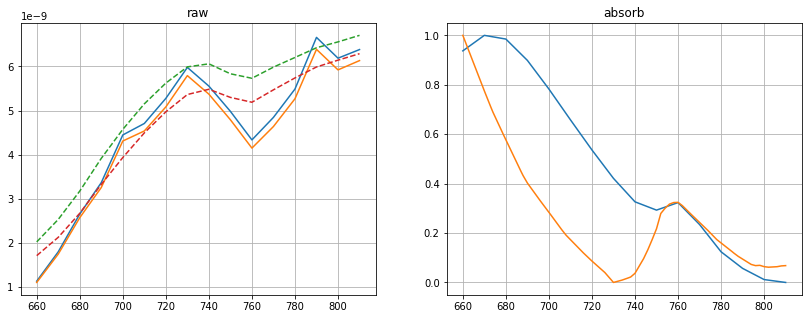

parameters: 
0.5252535024653803
iter: 736 | loss: 0.10201108921645372


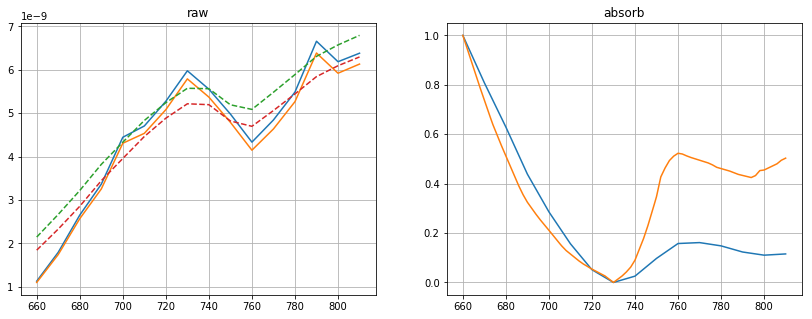

parameters: 
0.7405105965417694
iter: 799 | loss: 0.0863059304552814


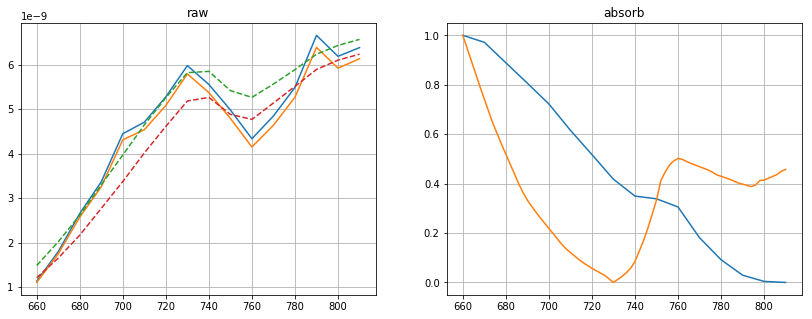

parameters: 
0.7283466590723249
iter: 1444 | loss: 0.07262791128167159


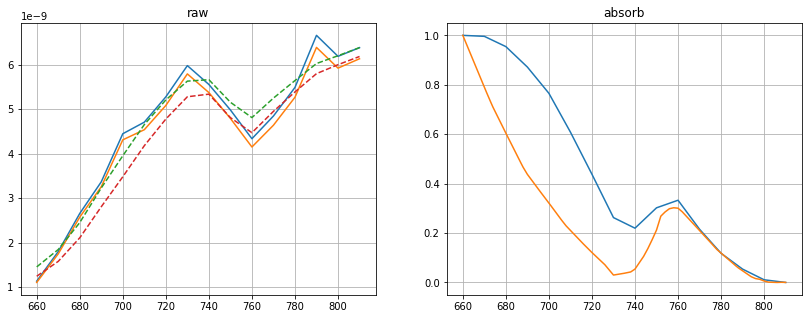

parameters: 
0.4041594674102009
data/calibrated/20190524_split/IJV/20190524_split_1_3.csv
iter: 3 | loss: 14.829463288596612


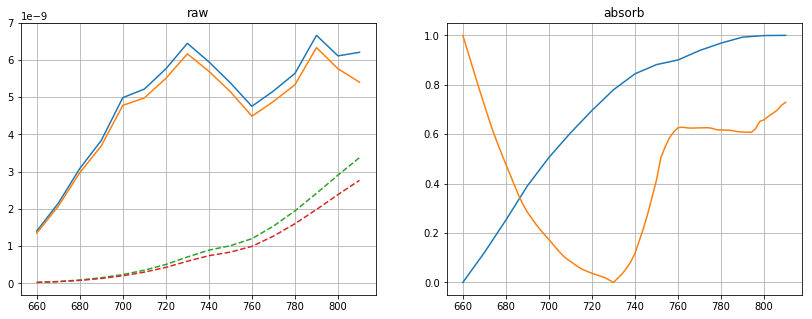

parameters: 
0.7863760537227109
iter: 10 | loss: 0.2301704367535315


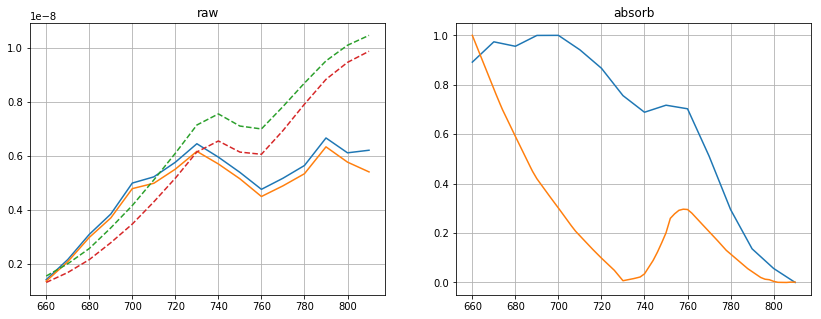

parameters: 
0.4404957366889546
iter: 31 | loss: 0.2209141375978903


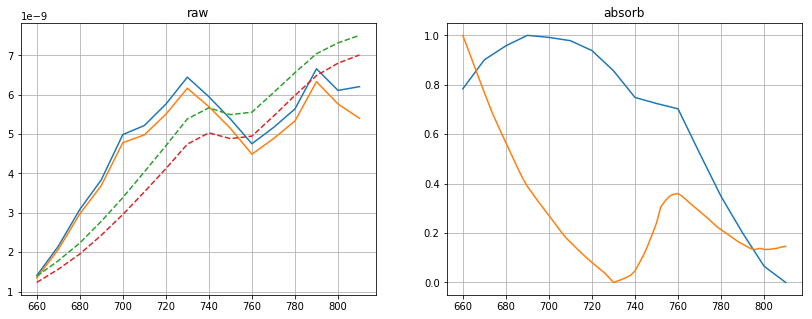

parameters: 
0.5893716901723445
iter: 187 | loss: 0.16956451258626087


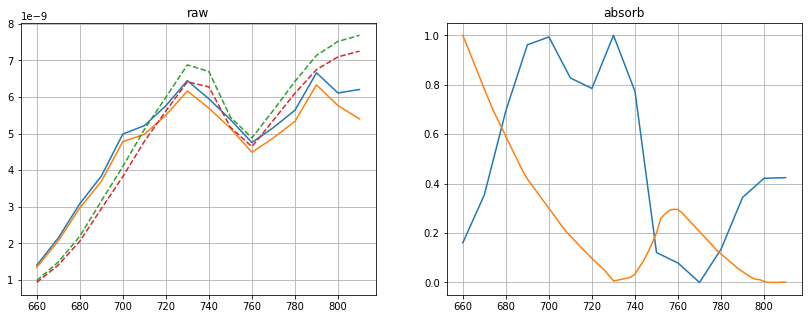

parameters: 
0.44182469665047397
iter: 322 | loss: 0.11228558732952132


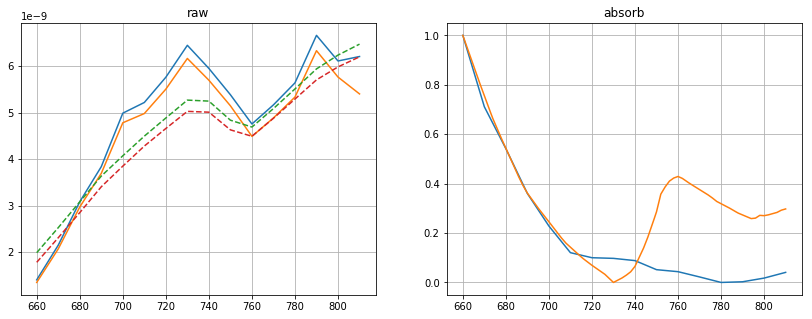

parameters: 
0.6726776693640348
iter: 638 | loss: 0.05697685128539488


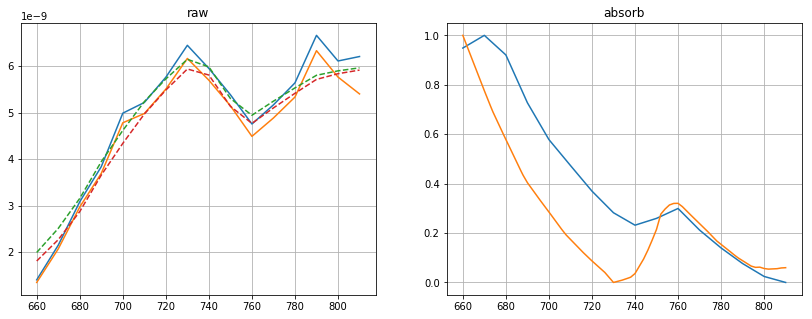

parameters: 
0.517038523631845
data/calibrated/20190524_split/IJV/20190524_split_1_4.csv
iter: 8 | loss: 0.8089781241808134


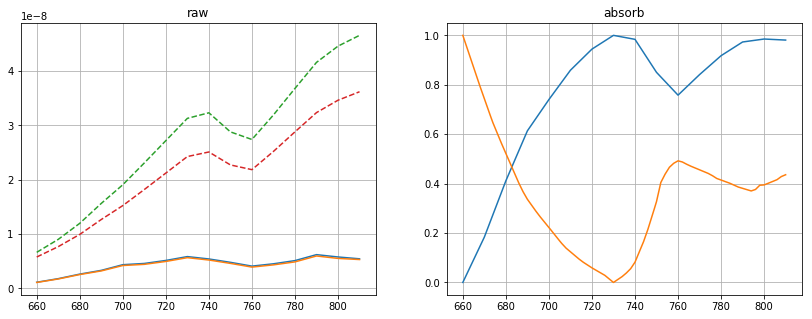

parameters: 
0.7220657118236152
iter: 9 | loss: 0.6180967148079208


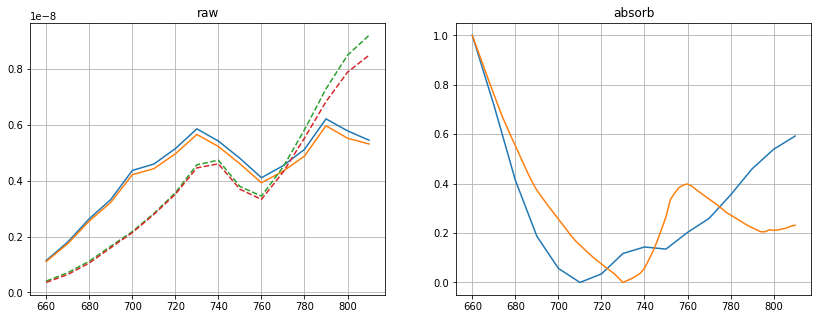

parameters: 
0.6414342896250758
iter: 32 | loss: 0.27688699971287867


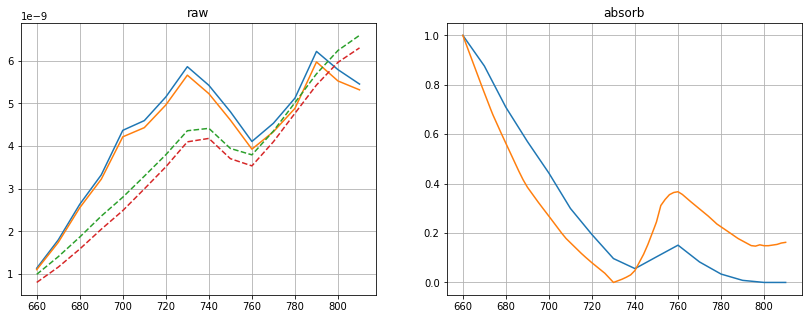

parameters: 
0.6005608082525938
iter: 33 | loss: 0.27576199622022146


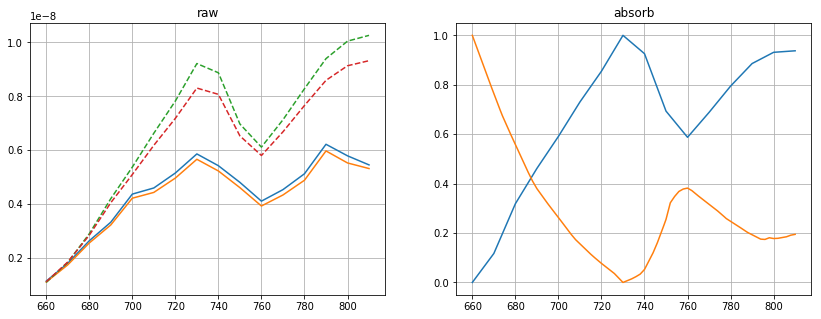

parameters: 
0.6208545164212933
iter: 49 | loss: 0.24051031502645215


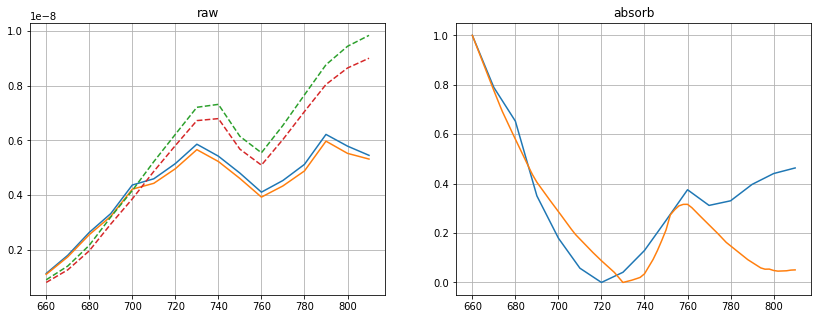

parameters: 
0.5079874309183742
iter: 287 | loss: 0.2355687565170607


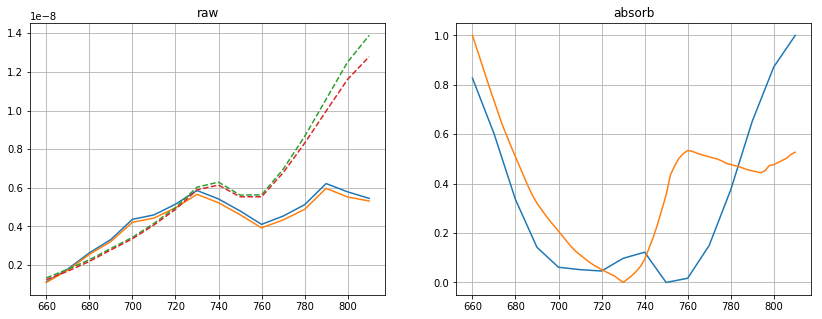

parameters: 
0.7464170173248799
iter: 420 | loss: 0.14618767663320842


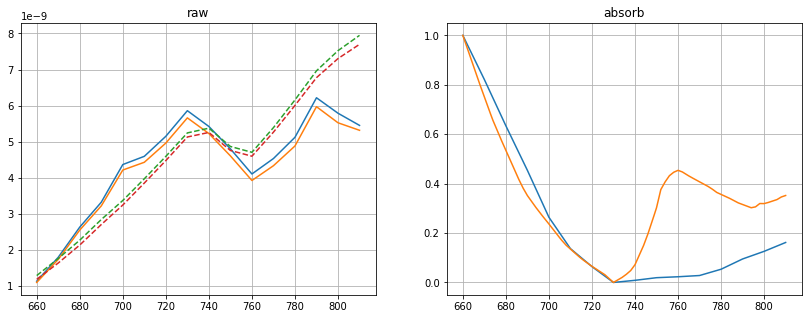

parameters: 
0.6942628116392575
iter: 767 | loss: 0.09250181826927673


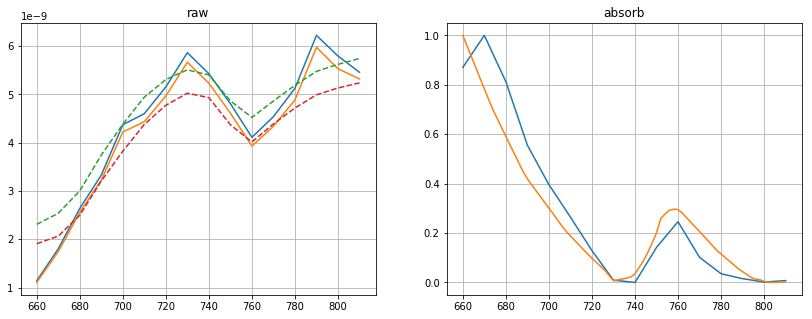

parameters: 
0.44081388302187496
iter: 5540 | loss: 0.07527124969932542


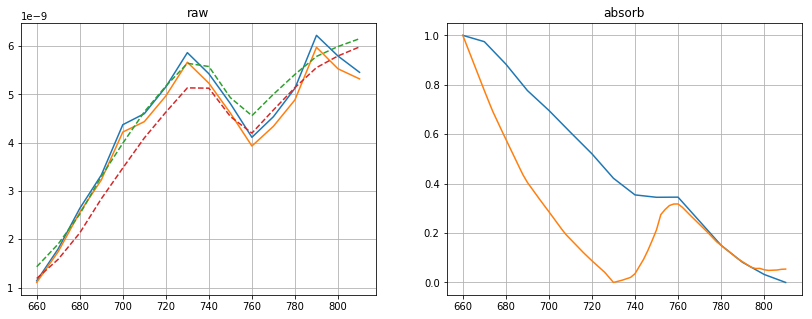

parameters: 
0.5113449132422642
iter: 6908 | loss: 0.04495500786659778


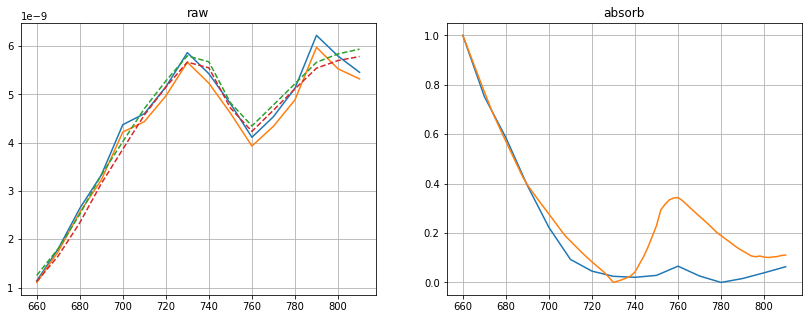

parameters: 
0.5629693173725651
data/calibrated/20190524_split/IJV/20190524_split_1_5.csv
iter: 10 | loss: 1.328595757143526


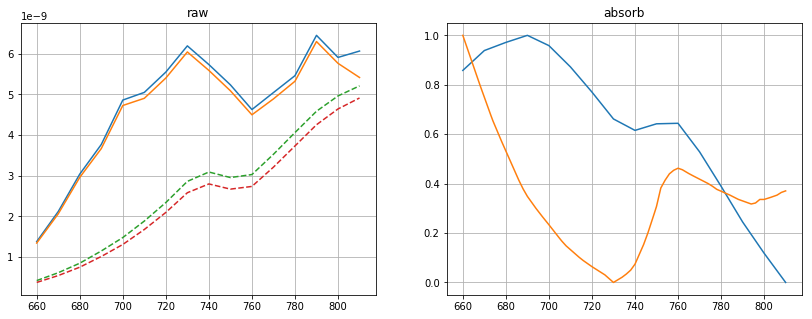

parameters: 
0.7009782476398814
iter: 14 | loss: 0.3993078312675353


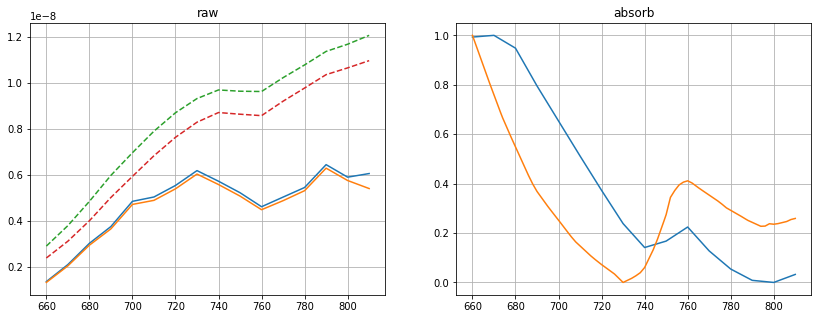

parameters: 
0.655207569008782
iter: 27 | loss: 0.37462010270429086


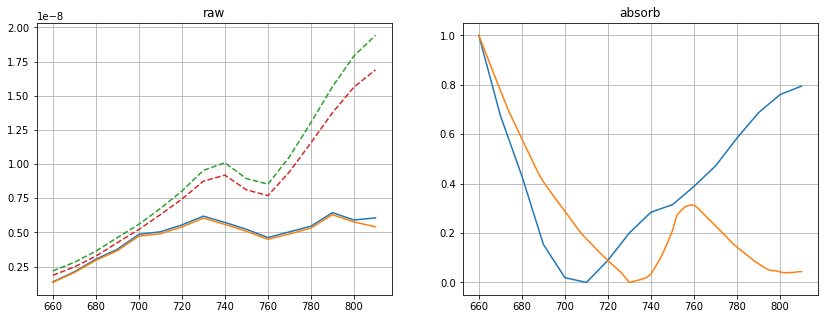

parameters: 
0.50055714477151
iter: 53 | loss: 0.3712443272105418


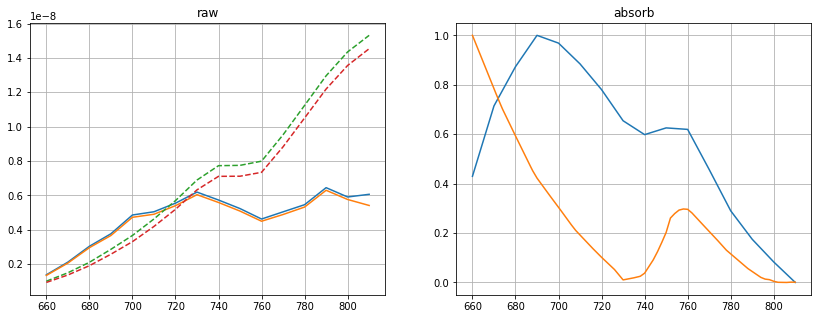

parameters: 
0.43561495487916324
iter: 73 | loss: 0.24809871931538138


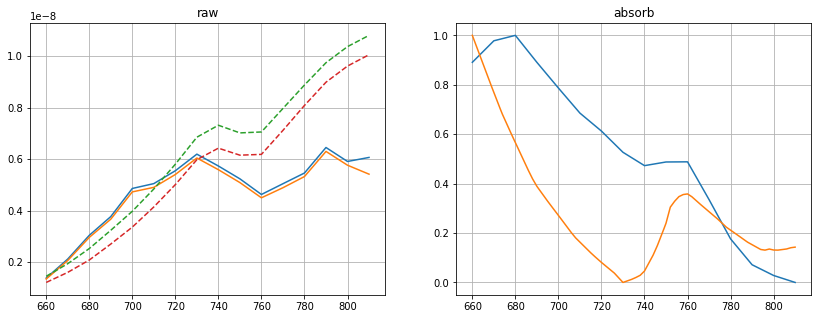

parameters: 
0.5872567235832622
iter: 262 | loss: 0.240984942734199


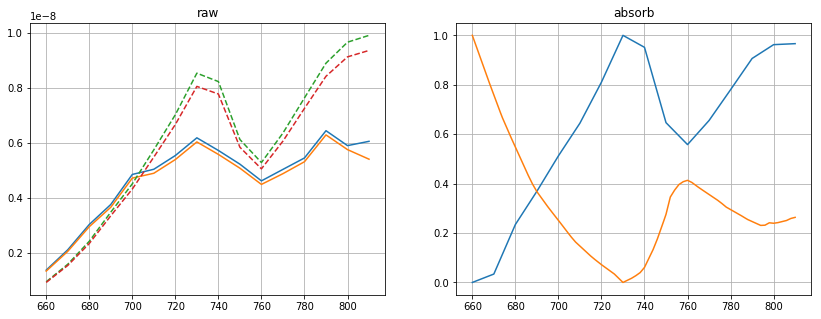

parameters: 
0.6572849240646352
iter: 340 | loss: 0.24021730269504213


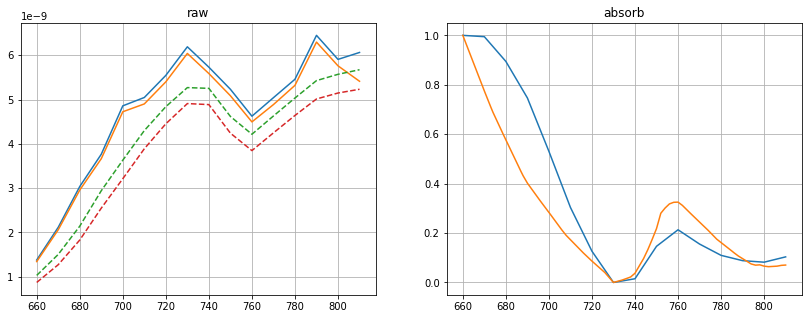

parameters: 
0.5274471173579844
iter: 475 | loss: 0.23791412493464387


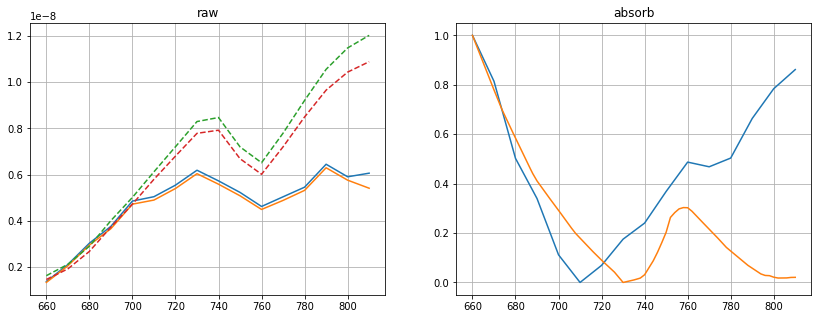

parameters: 
0.4743076317570791
iter: 575 | loss: 0.09270579974921185


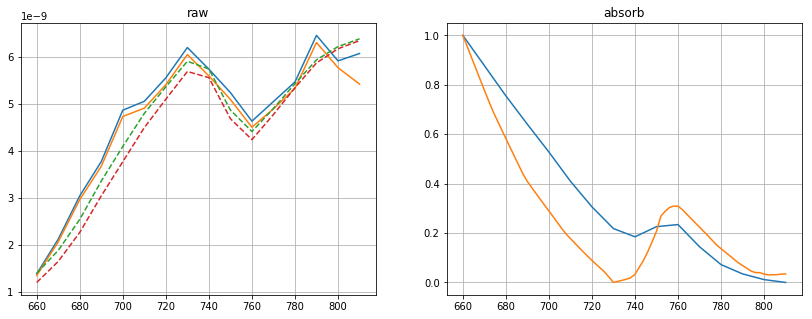

parameters: 
0.49035257389786524
iter: 1419 | loss: 0.07368812790149012


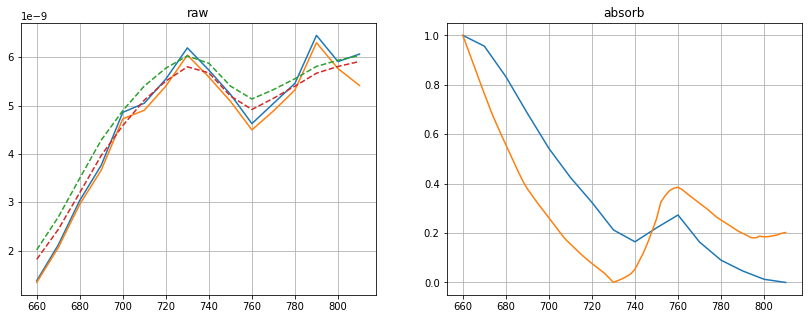

parameters: 
0.6252057904920437
iter: 8500 | loss: 0.05601055665735428


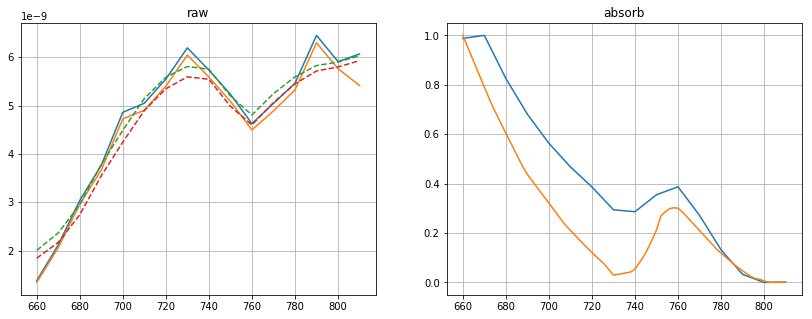

parameters: 
0.40435944999907764
data/calibrated/20190524_split/IJV/20190524_split_2_1.csv
iter: 5 | loss: 0.7324112631619382


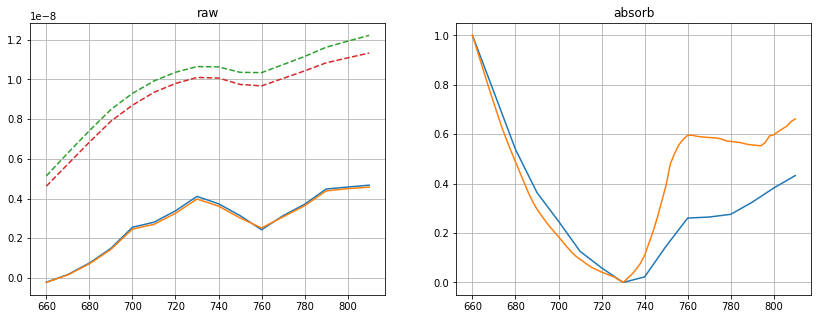

parameters: 
0.7747910685445002
iter: 28 | loss: 0.5135041252797937


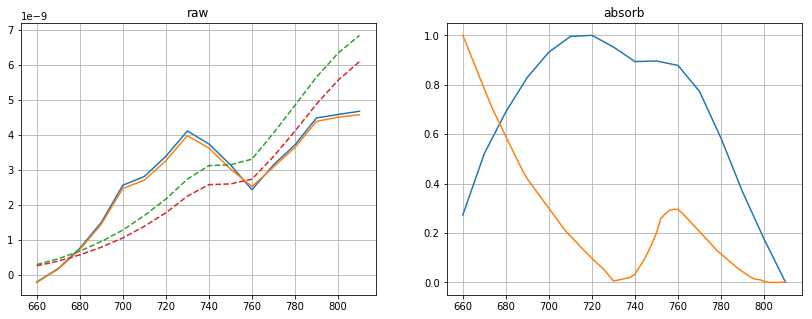

parameters: 
0.44186684644999624
iter: 32 | loss: 0.42234302117672423


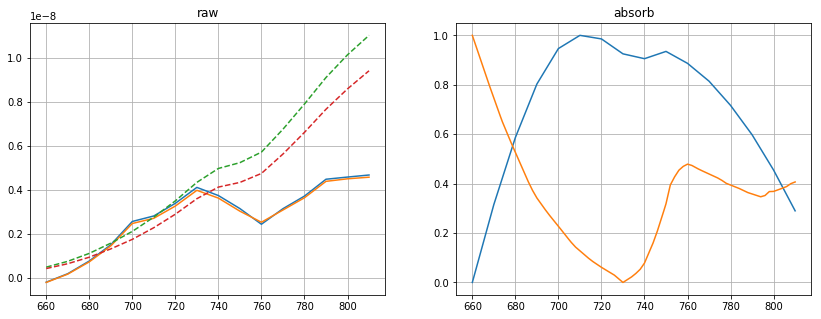

parameters: 
0.7130660960774883
iter: 40 | loss: 0.22461223037493872


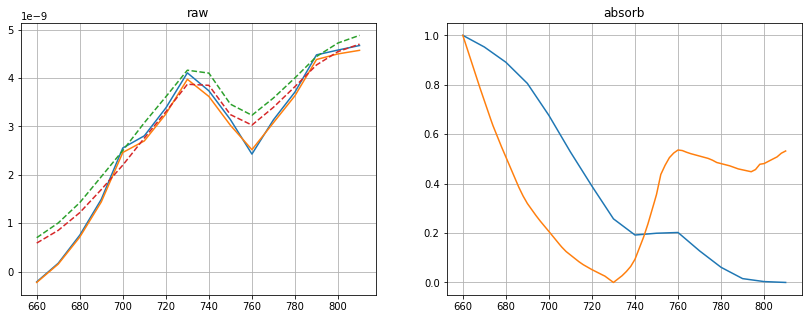

parameters: 
0.7476610052519633
data/calibrated/20190524_split/IJV/20190524_split_2_2.csv
iter: 3 | loss: 0.8407420040276928


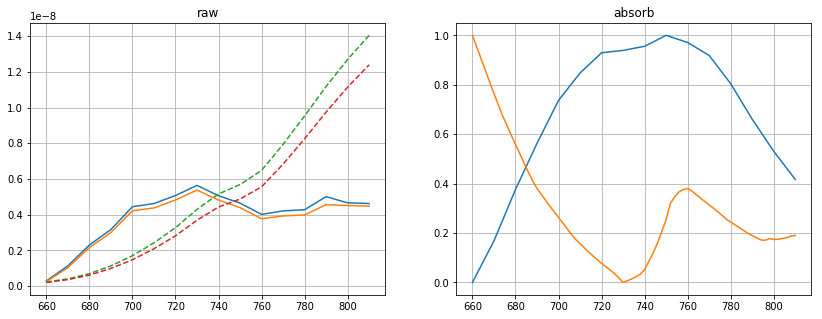

parameters: 
0.6183994734805695
iter: 7 | loss: 0.31661776827000954


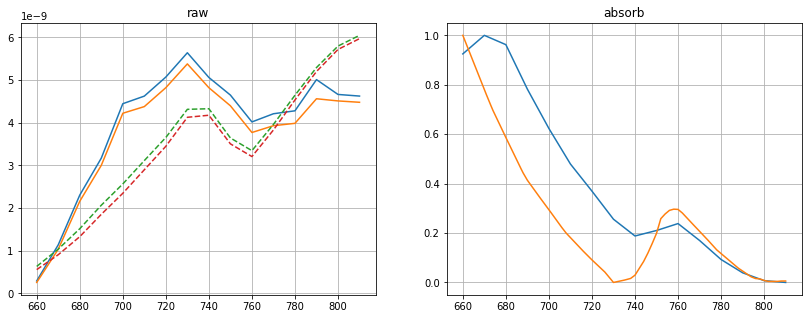

parameters: 
0.4559304579778236
iter: 16 | loss: 0.28826072073556175


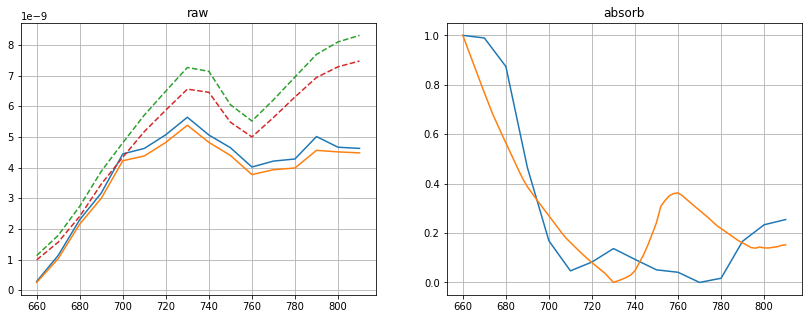

parameters: 
0.5938272804102511
iter: 78 | loss: 0.2696143220061959


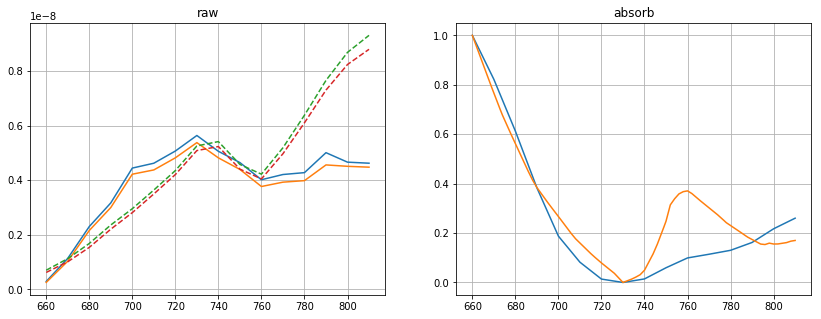

parameters: 
0.6055699853068254
iter: 152 | loss: 0.22997331107509963


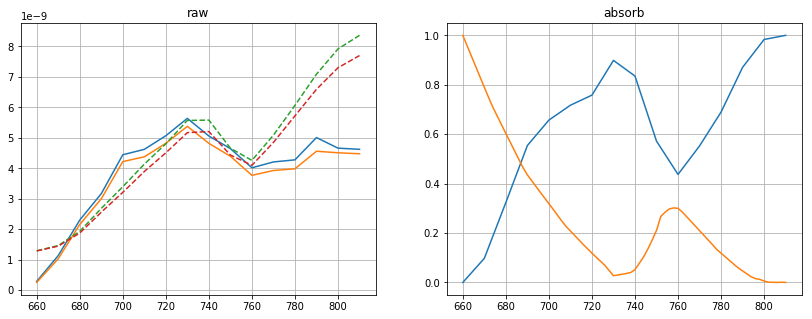

parameters: 
0.4086795629961754
iter: 187 | loss: 0.19812942271277026


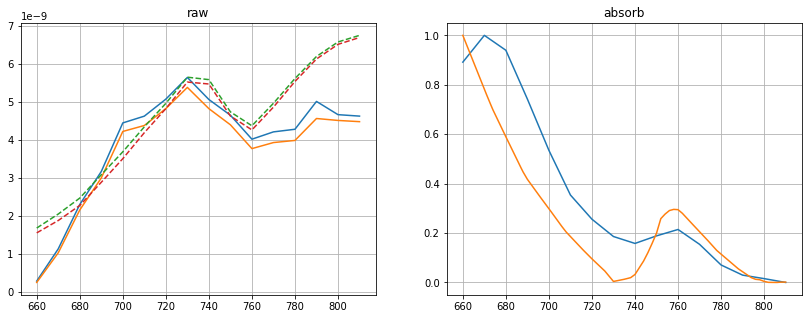

parameters: 
0.4447730392538652
iter: 379 | loss: 0.1407976128118678


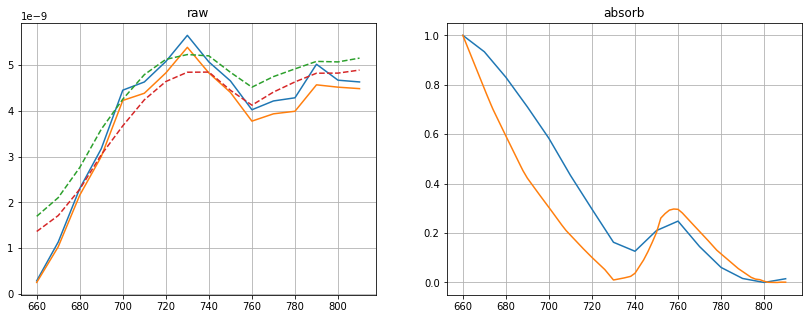

parameters: 
0.43621658877993297
iter: 2822 | loss: 0.13209045977925948


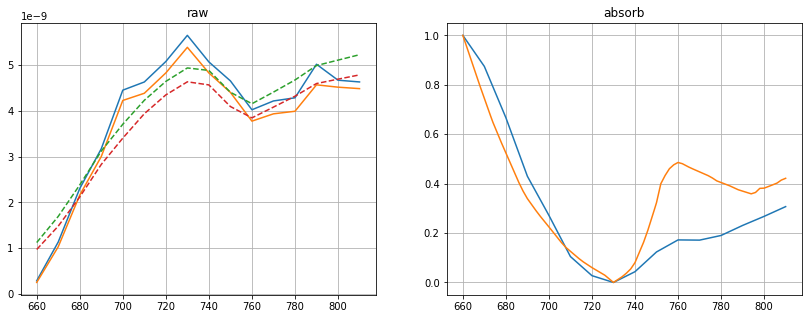

parameters: 
0.7176896630056744
iter: 7096 | loss: 0.1275886786199403


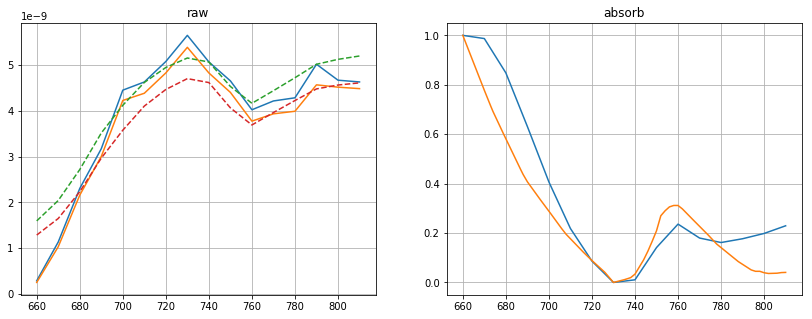

parameters: 
0.49712765111073115
data/calibrated/20190524_split/IJV/20190524_split_2_3.csv
iter: 1 | loss: 0.3812942838849953


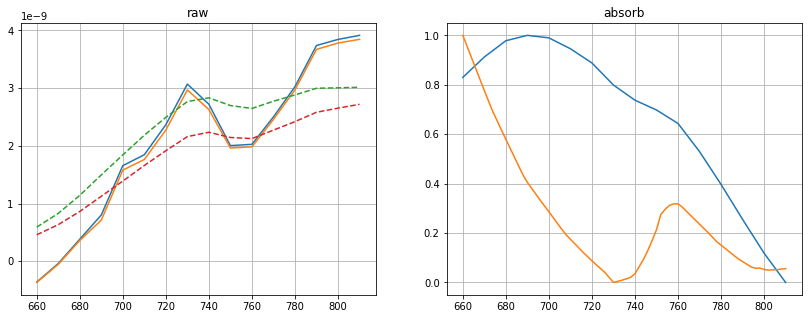

parameters: 
0.5127030637676405
iter: 311 | loss: 0.3767294298761369


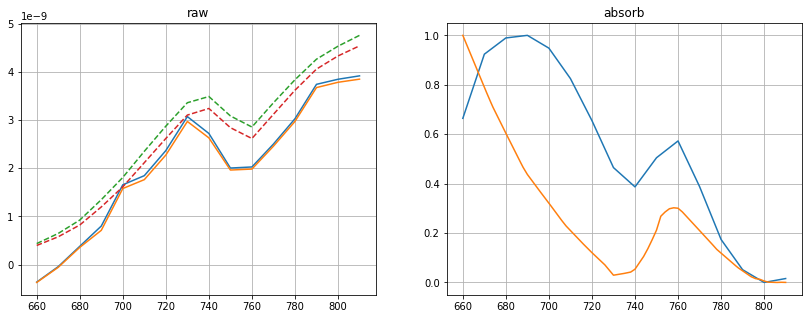

parameters: 
0.40514146481311086
iter: 589 | loss: 0.3466738051287664


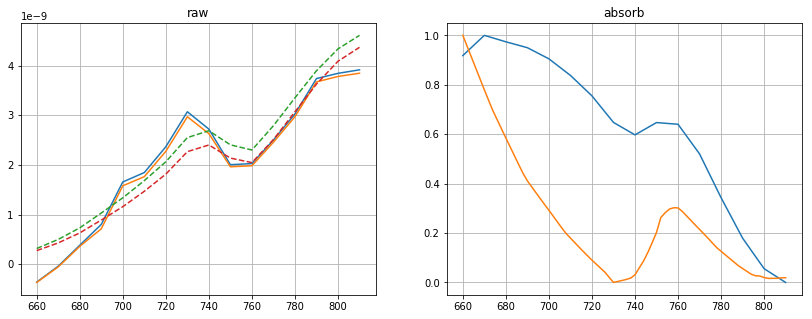

parameters: 
0.4723840732090592
iter: 1178 | loss: 0.32822901672184057


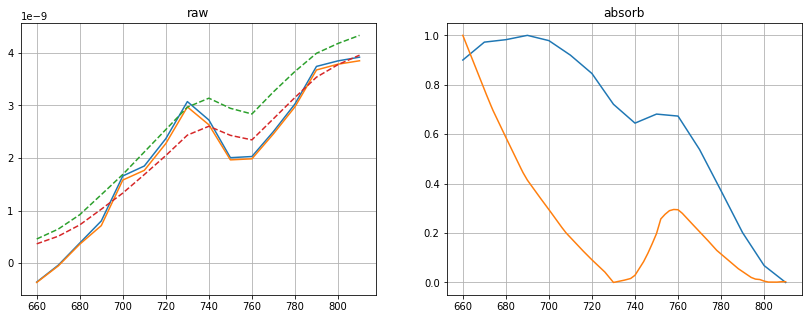

parameters: 
0.4521038398823527
iter: 2029 | loss: 0.32806806705017677


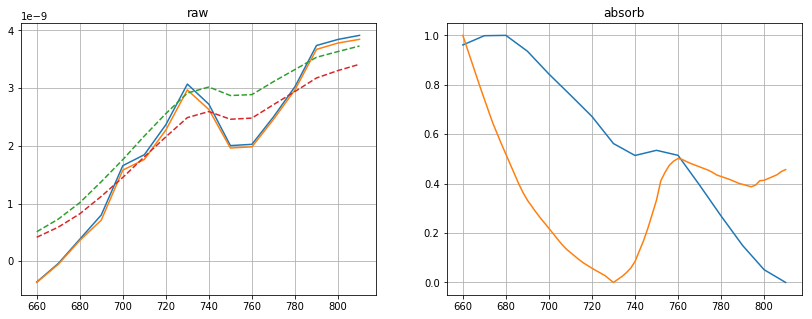

parameters: 
0.7280834491170767
iter: 2486 | loss: 0.3023366359977568


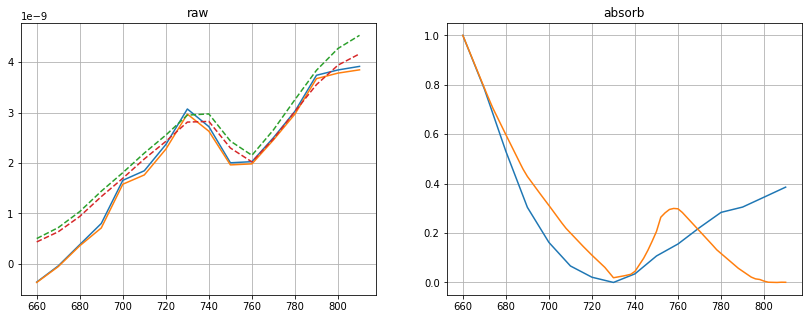

parameters: 
0.42223966705900917
iter: 4277 | loss: 0.2920570012056774


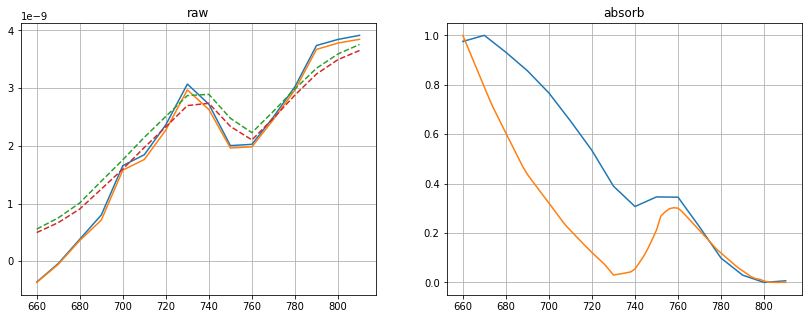

parameters: 
0.40388026491976836
data/calibrated/20190524_split/IJV/20190524_split_3_1.csv
iter: 2 | loss: 0.716303058776419


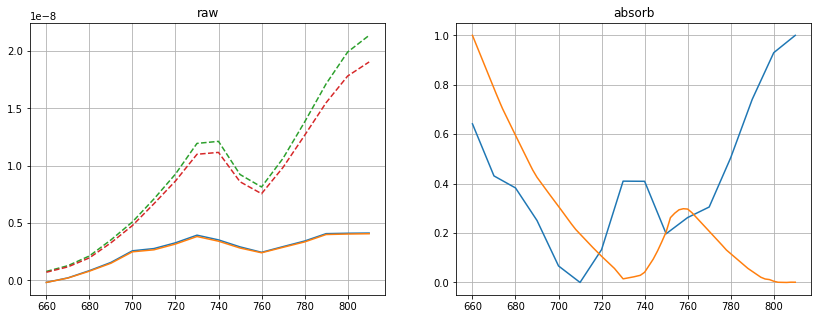

parameters: 
0.4291461585106358
iter: 7 | loss: 0.3716716260389584


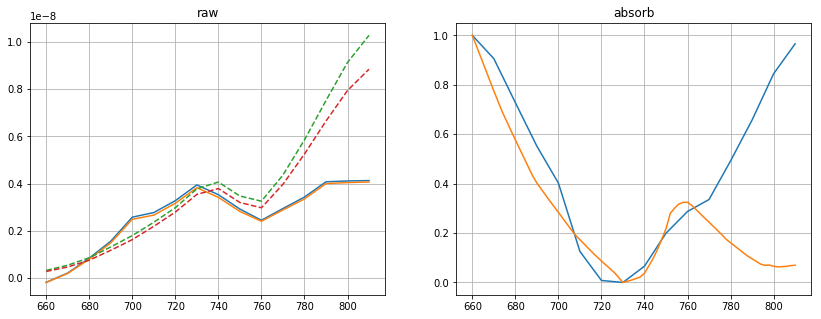

parameters: 
0.5265754421569807
iter: 47 | loss: 0.28643848465980015


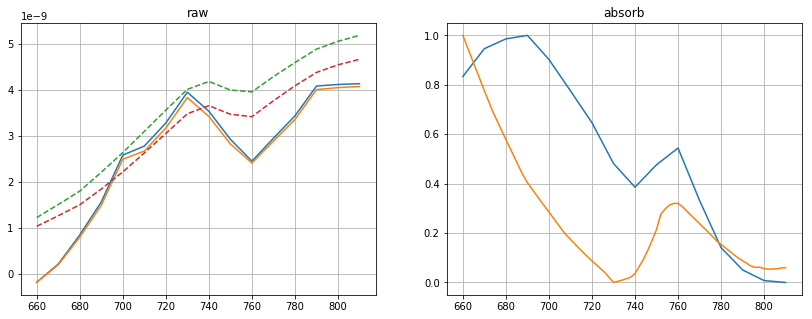

parameters: 
0.516845519729406
iter: 1335 | loss: 0.280305824106062


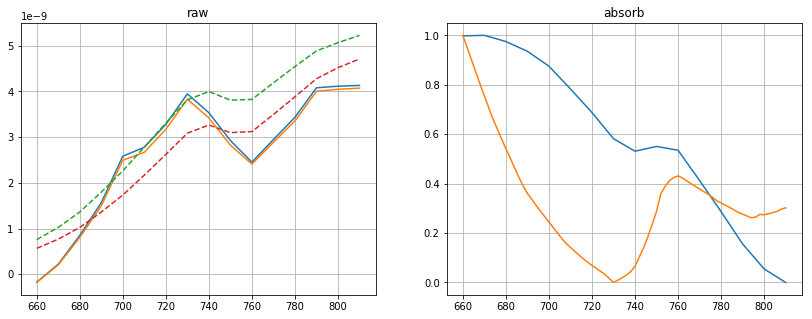

parameters: 
0.6745324076632072
iter: 2566 | loss: 0.24897662457037295


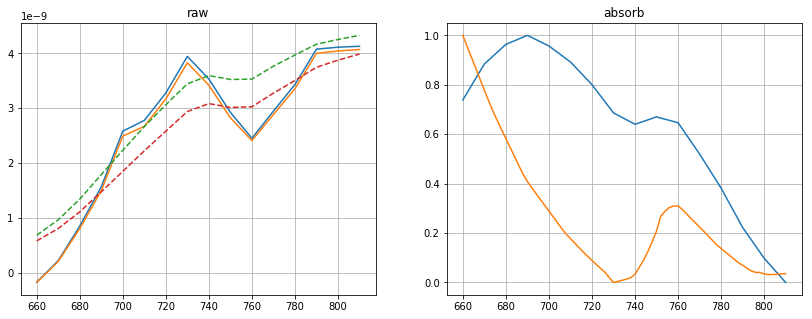

parameters: 
0.4915940498455412
iter: 4250 | loss: 0.2368245781121267


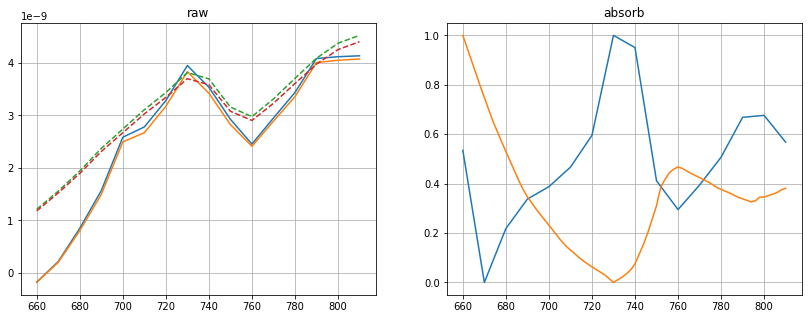

parameters: 
0.7046930251653105
iter: 4933 | loss: 0.20300978657765872


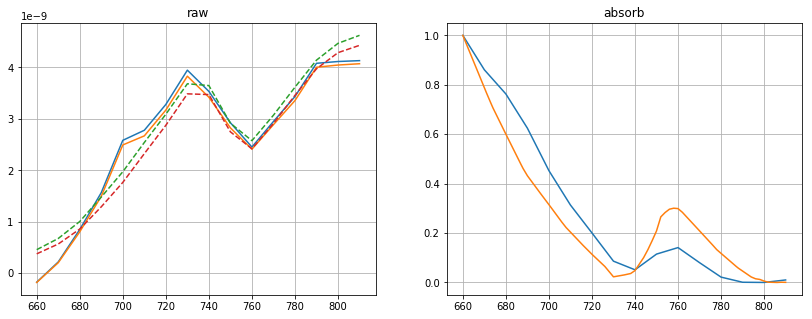

parameters: 
0.4162020423367945
data/calibrated/20190524_split/IJV/20190524_split_3_2.csv
iter: 6 | loss: 0.8155011259434222


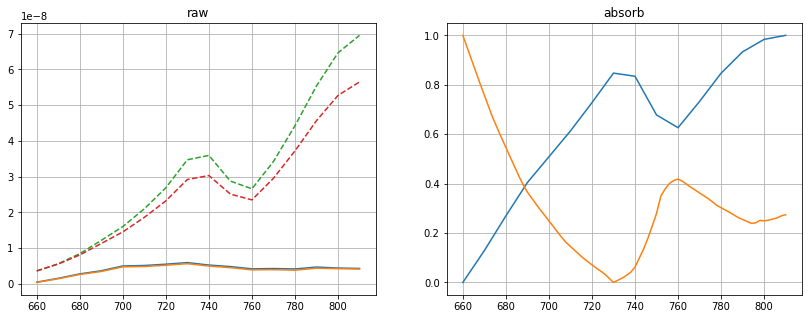

parameters: 
0.6622929165684539
iter: 38 | loss: 0.7464888802768979


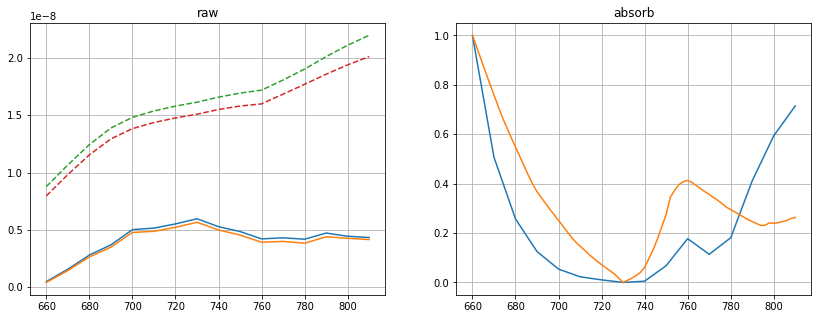

parameters: 
0.6571529358033295
iter: 51 | loss: 0.4950050390251333


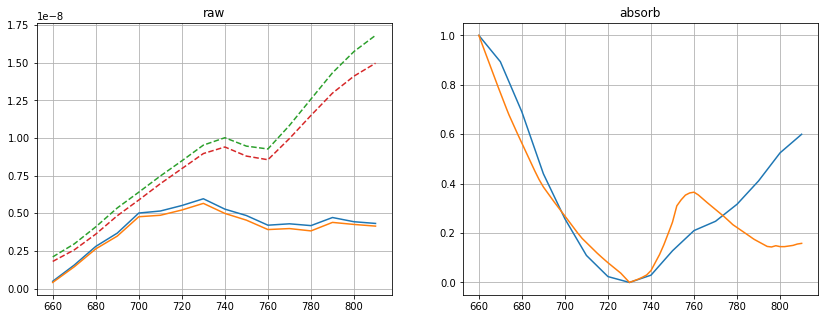

parameters: 
0.5977857686975907
iter: 86 | loss: 0.21910518414258146


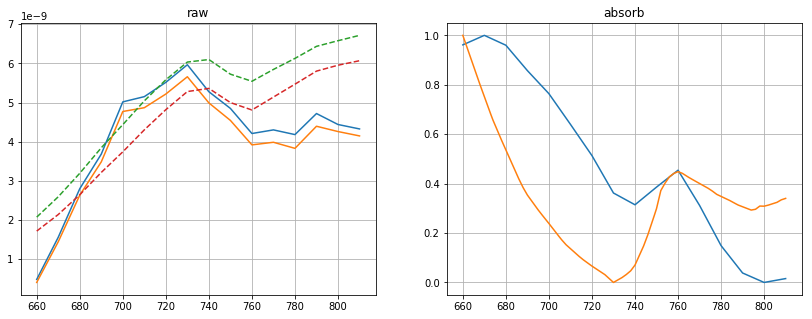

parameters: 
0.6898943186695135
iter: 1874 | loss: 0.1682692157698465


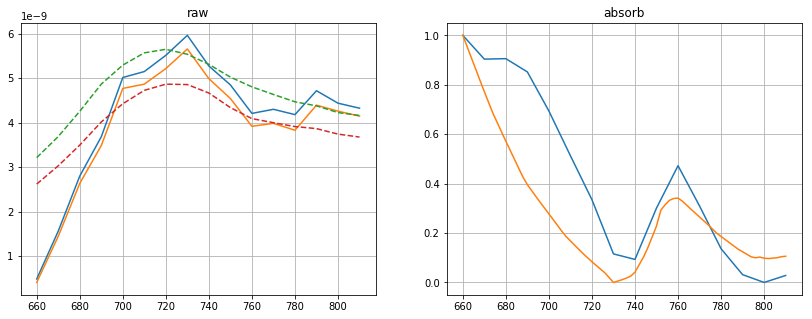

parameters: 
0.5589723708647072
iter: 4395 | loss: 0.12980898466040067


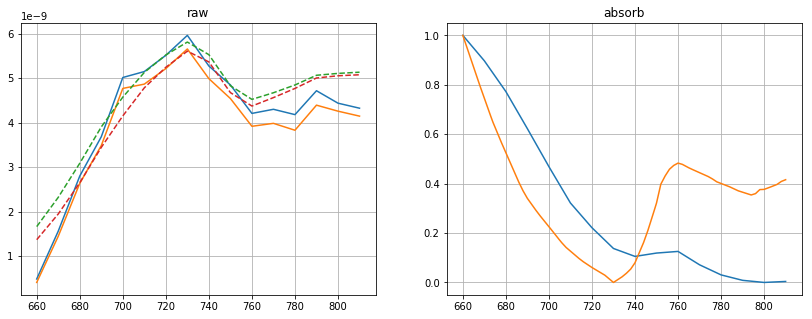

parameters: 
0.7159400014917856
iter: 5593 | loss: 0.10621020254055105


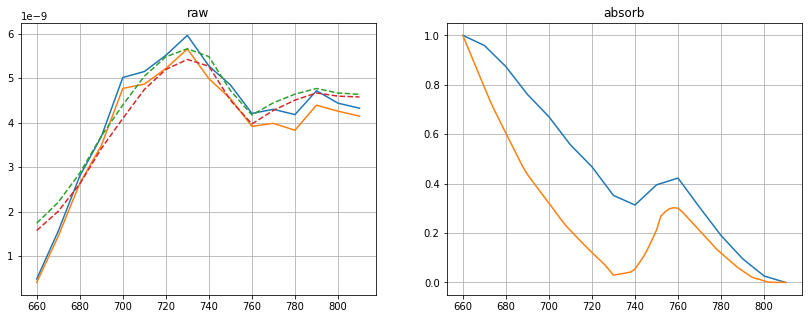

parameters: 
0.4045246993100197
data/calibrated/20190524_split/IJV/20190524_split_3_3.csv
iter: 0 | loss: 0.7011664597349514


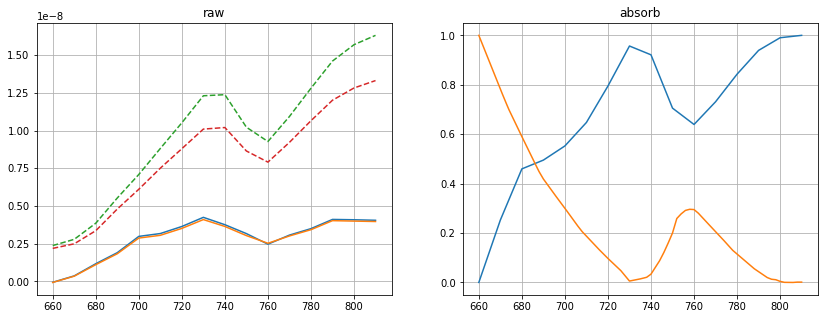

parameters: 
0.4424195519398437
iter: 6 | loss: 0.39509574830305827


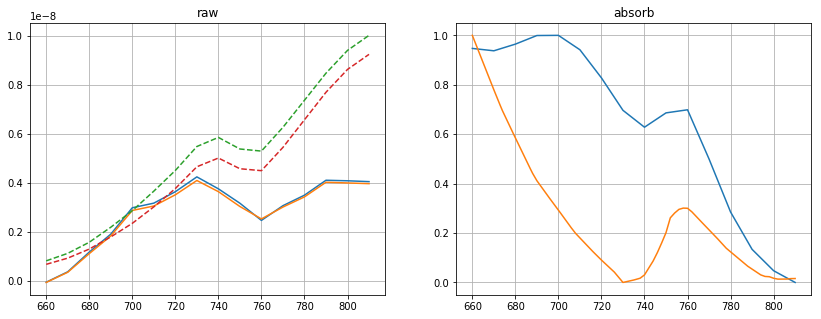

parameters: 
0.46848027491531824
iter: 21 | loss: 0.3499815475336555


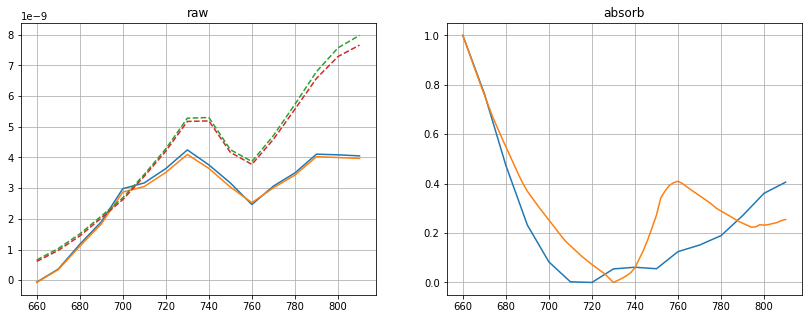

parameters: 
0.6531522038643647
iter: 34 | loss: 0.28717712594420974


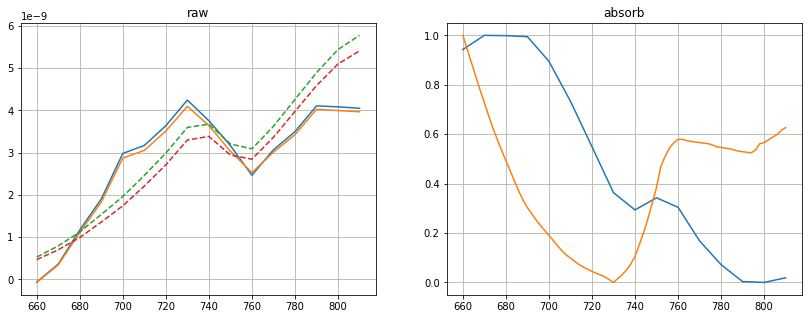

parameters: 
0.7680915692268676
iter: 121 | loss: 0.2456631167747007


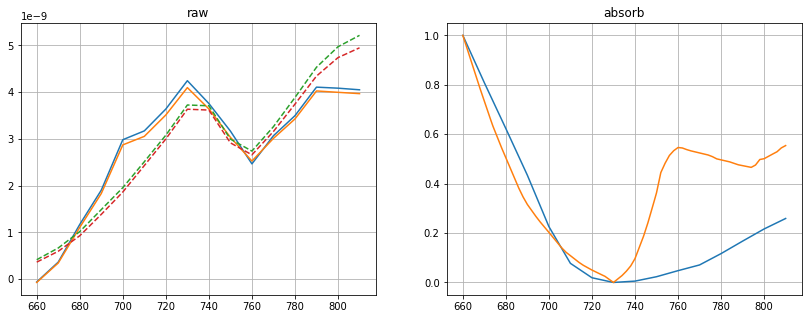

parameters: 
0.7527545923241613
iter: 574 | loss: 0.22108896392746494


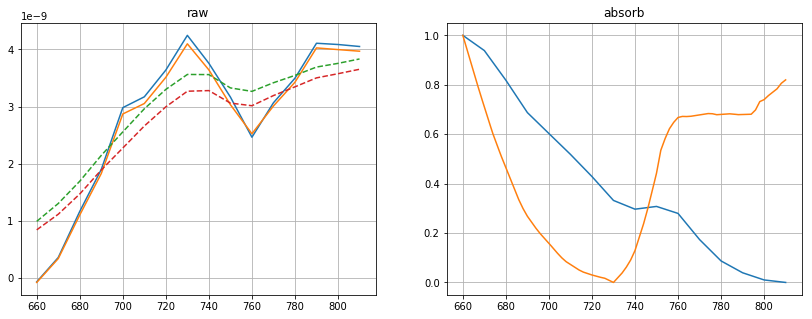

parameters: 
0.7999924047035161
iter: 1602 | loss: 0.20014817989610045


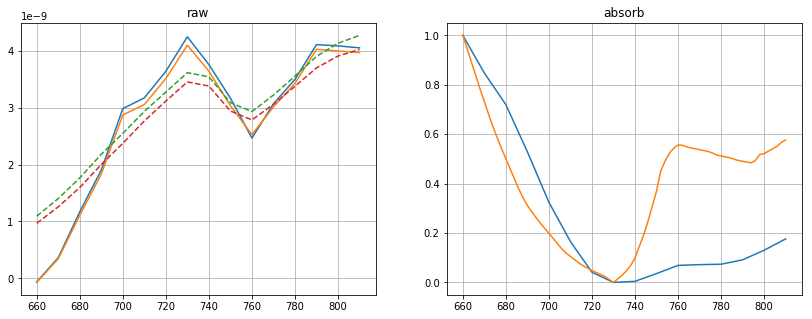

parameters: 
0.7578050505009963
iter: 4630 | loss: 0.19983459546514473


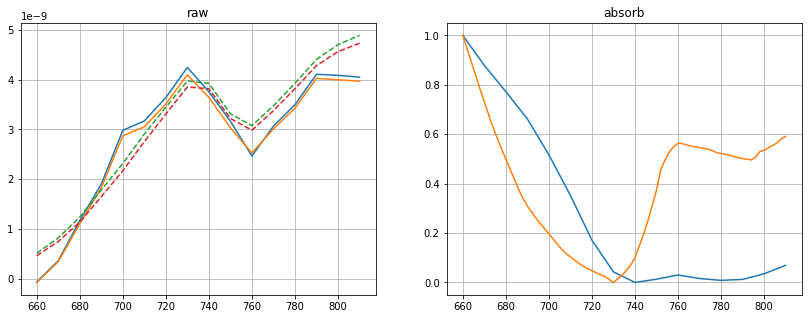

parameters: 
0.760914790145152
data/calibrated/20190524_split/IJV/20190524_split_4_1.csv
iter: 3 | loss: 0.3907372839063951


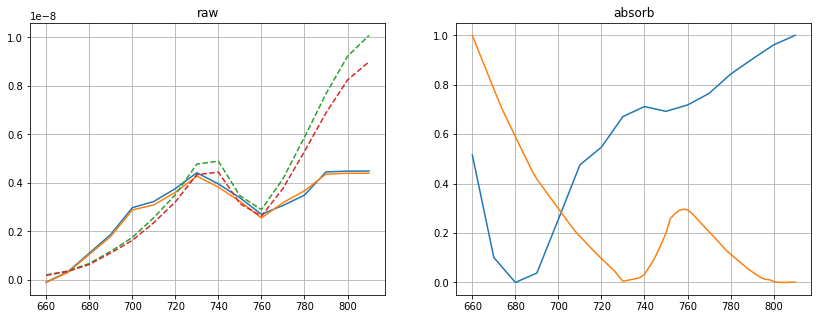

parameters: 
0.443613467639465
iter: 59 | loss: 0.3292805473137076


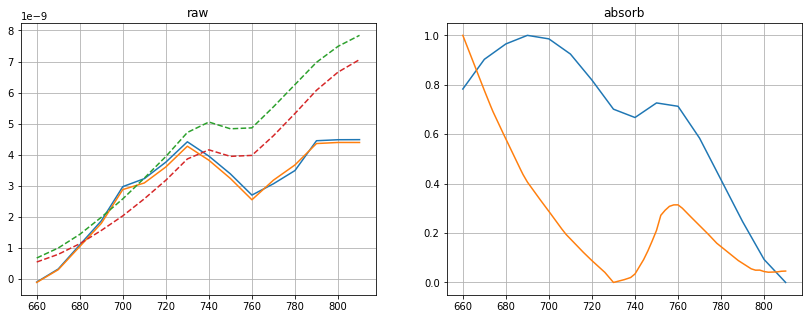

parameters: 
0.503002477216075
iter: 175 | loss: 0.2325590349584346


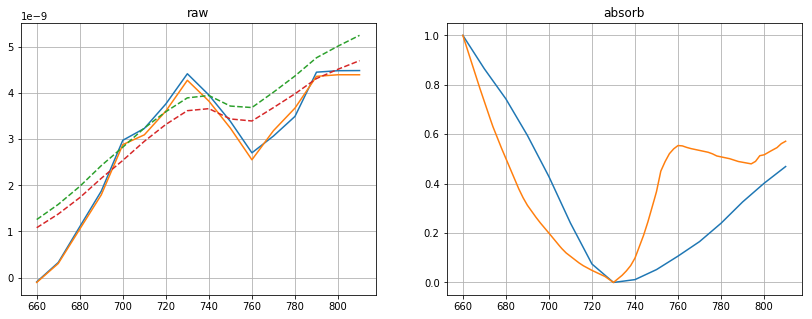

parameters: 
0.7566738079319816
iter: 853 | loss: 0.19860566501786353


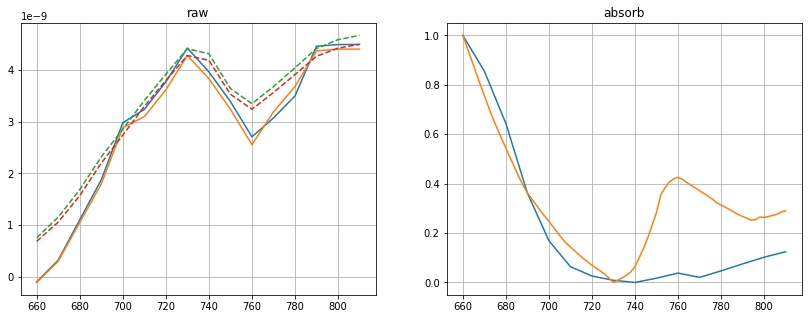

parameters: 
0.6693486797297393
iter: 1775 | loss: 0.18057586088946098


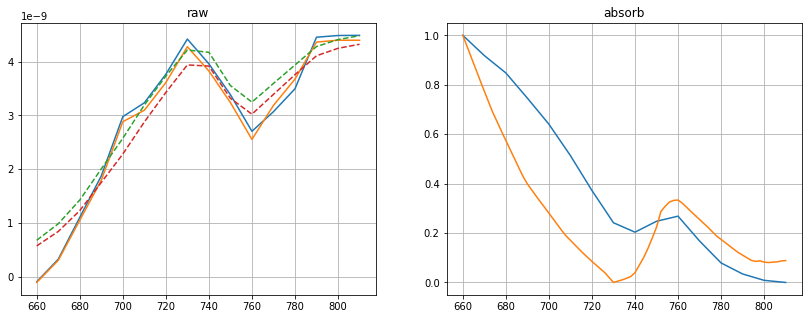

parameters: 
0.5441381770704723
data/calibrated/20190524_split/IJV/20190524_split_4_2.csv
iter: 8 | loss: 12.533274084056059


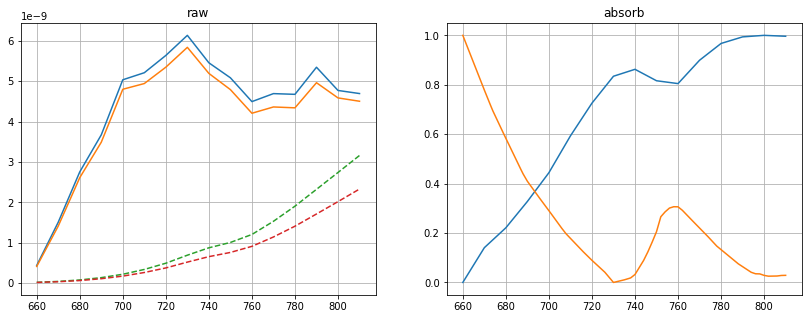

parameters: 
0.4838167234234
iter: 10 | loss: 5.815567551475864


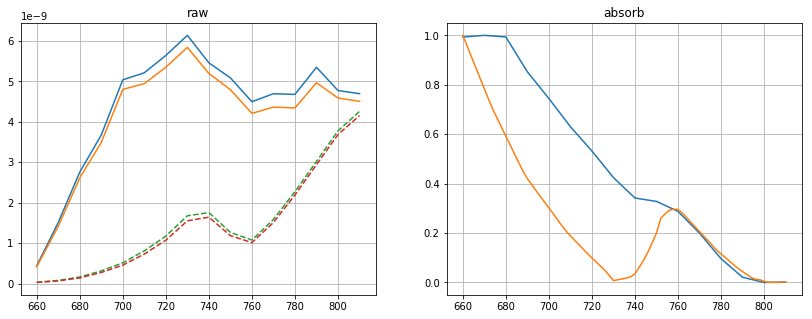

parameters: 
0.43976433059059067
iter: 15 | loss: 0.6711025098837039


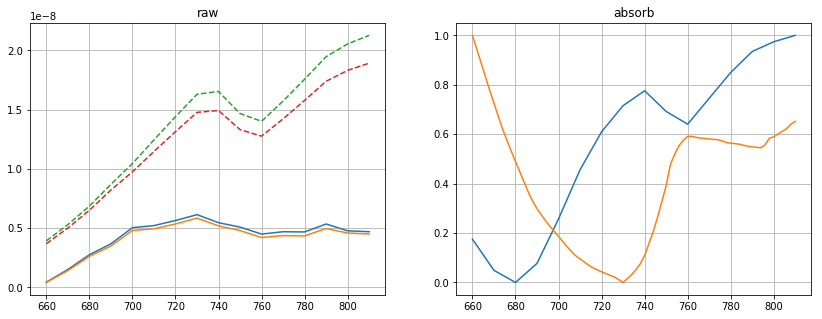

parameters: 
0.7729558903884273
iter: 22 | loss: 0.2433251997189929


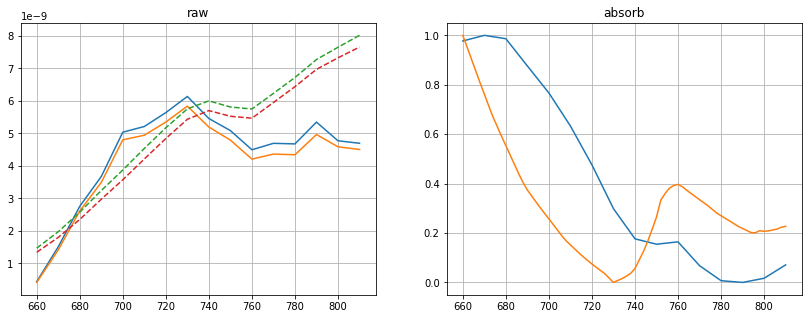

parameters: 
0.6391007452389739
iter: 829 | loss: 0.23258895705718463


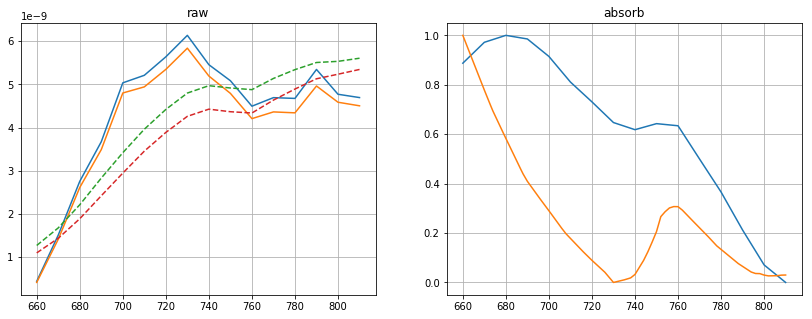

parameters: 
0.4853378833305415
iter: 1304 | loss: 0.17952903770100942


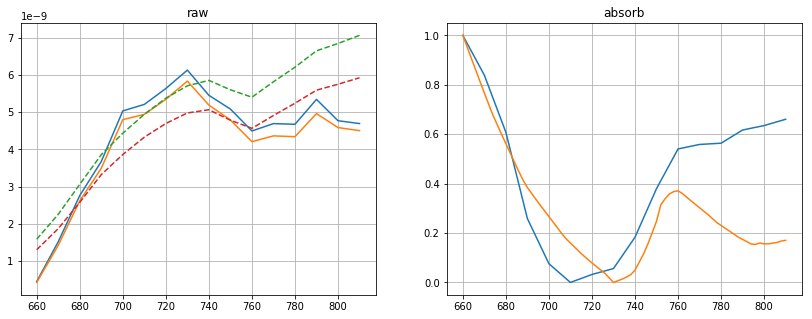

parameters: 
0.6059432482345442
iter: 1505 | loss: 0.17739008872247053


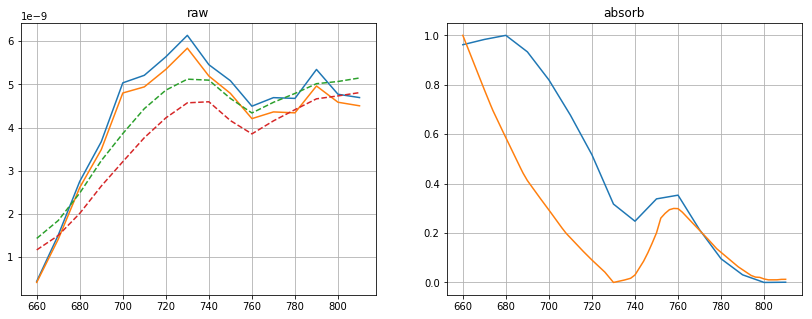

parameters: 
0.4645328219277929
iter: 1537 | loss: 0.12134666790702456


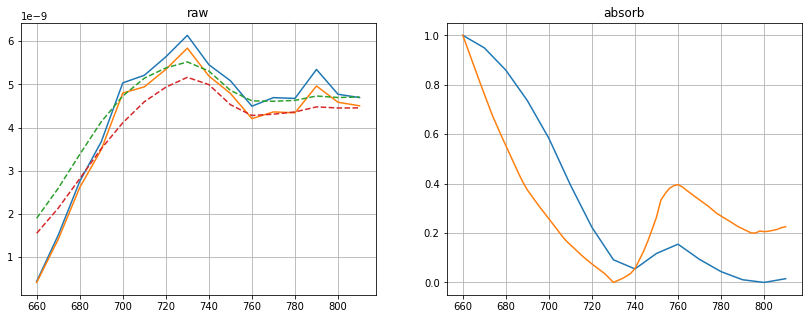

parameters: 
0.6382483921726364
iter: 9696 | loss: 0.10224019198497947


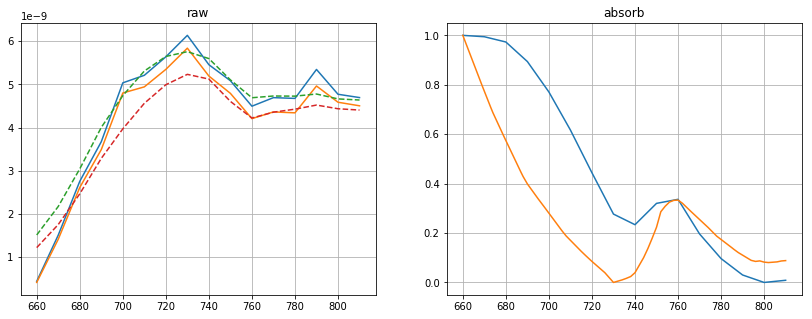

parameters: 
0.5440247458577423
data/calibrated/20190524_split/IJV/20190524_split_4_3.csv
iter: 1 | loss: 83.44099073244351


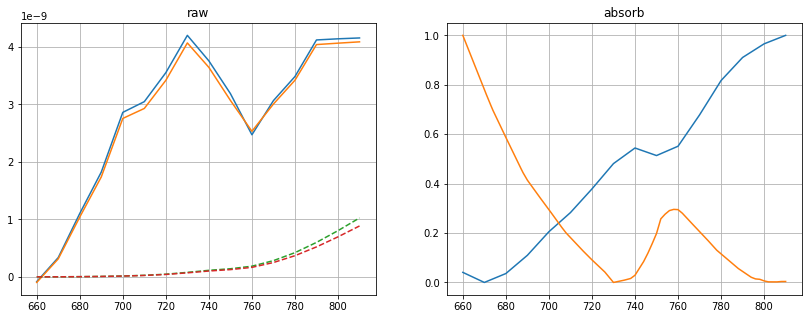

parameters: 
0.45336722029110715
iter: 10 | loss: 0.339186277400927


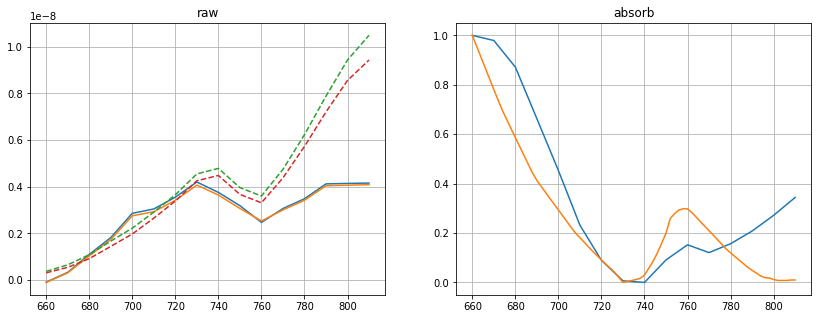

parameters: 
0.46112670383400256
iter: 88 | loss: 0.23159060398719045


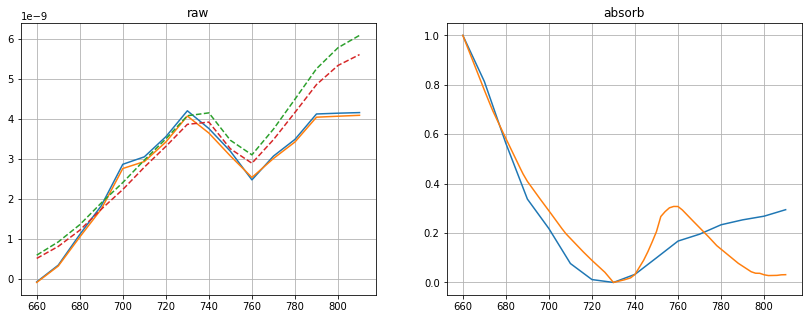

parameters: 
0.48690563290012173
iter: 144 | loss: 0.19868229172201185


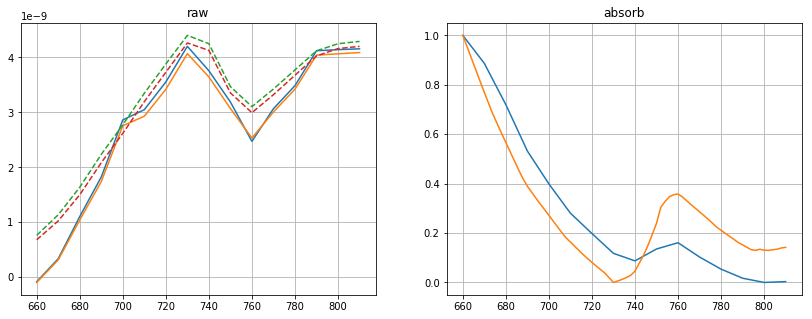

parameters: 
0.5865543308763407
data/calibrated/20190524_split/IJV/20190524_split_5_1.csv
iter: 0 | loss: 6.479097358040617


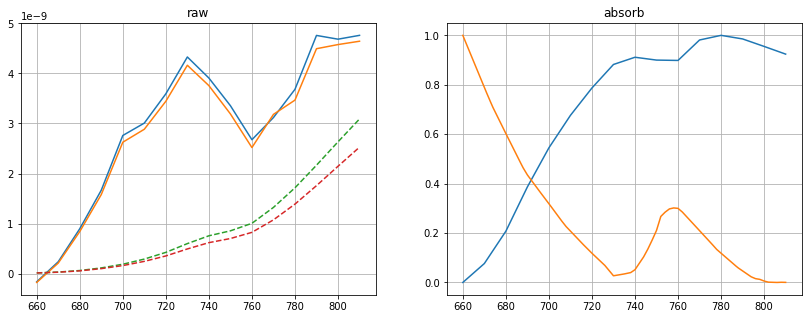

parameters: 
0.4091847020174378
iter: 6 | loss: 0.6989519609346947


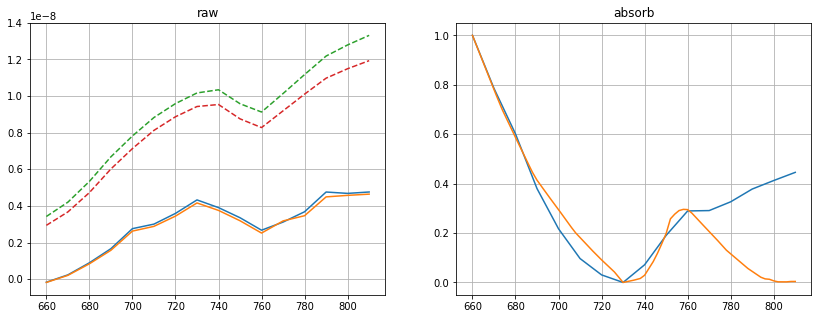

parameters: 
0.4535699856768649
iter: 12 | loss: 0.3102952162814902


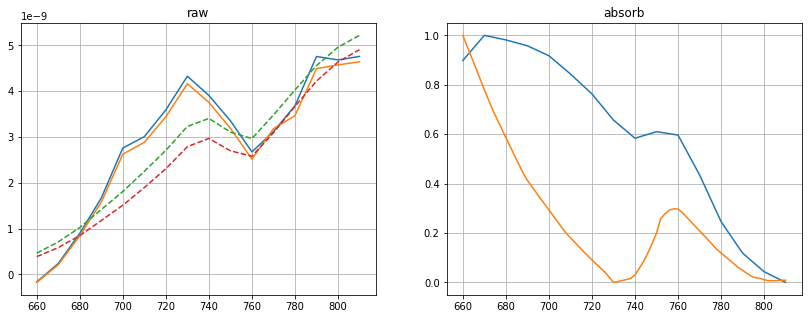

parameters: 
0.46016010566212534
iter: 25 | loss: 0.27435271334293077


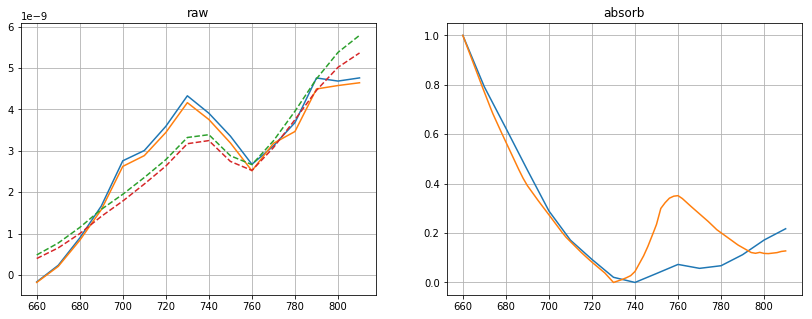

parameters: 
0.576036871276056
iter: 266 | loss: 0.2115833198785418


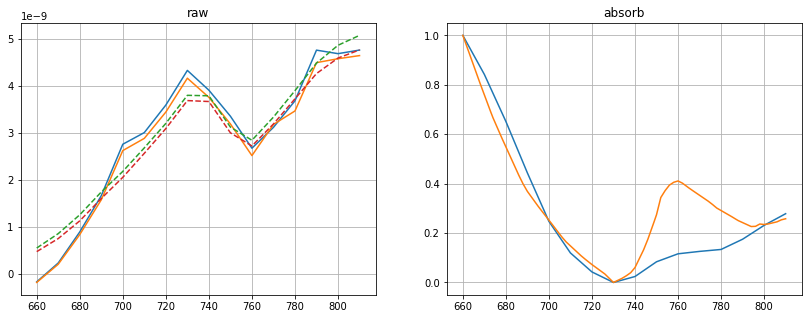

parameters: 
0.6546053677407964
iter: 963 | loss: 0.19279711647065464


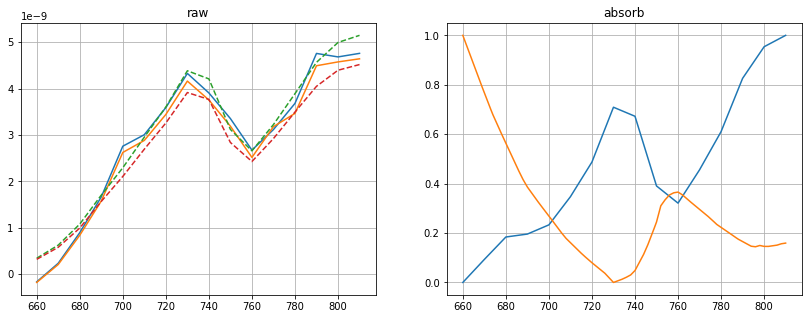

parameters: 
0.5985186545089035
data/calibrated/20190524_split/IJV/20190524_split_5_2.csv
iter: 3 | loss: 0.73373577419078


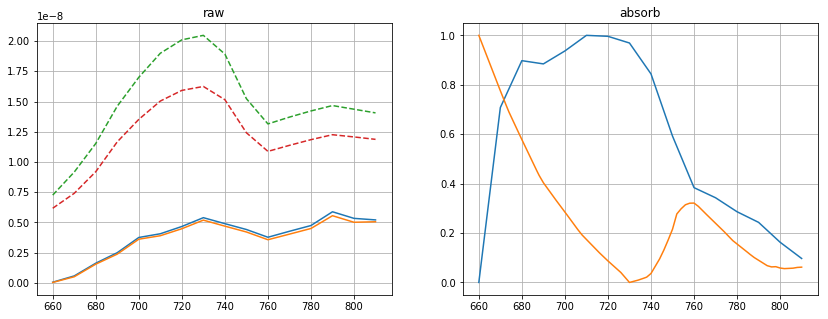

parameters: 
0.5191979420043287
iter: 19 | loss: 0.6682735861210968


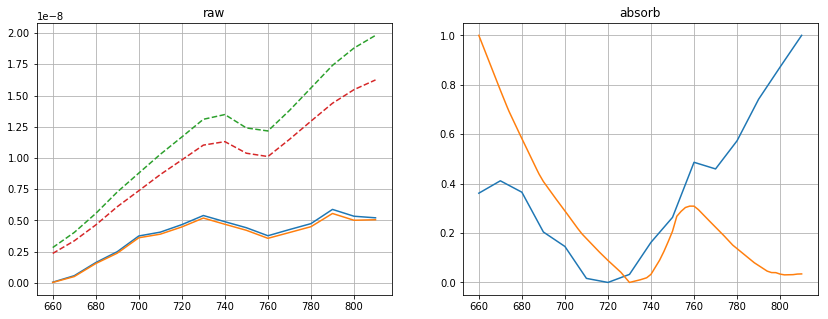

parameters: 
0.4903676428502728
iter: 30 | loss: 0.5892464307358863


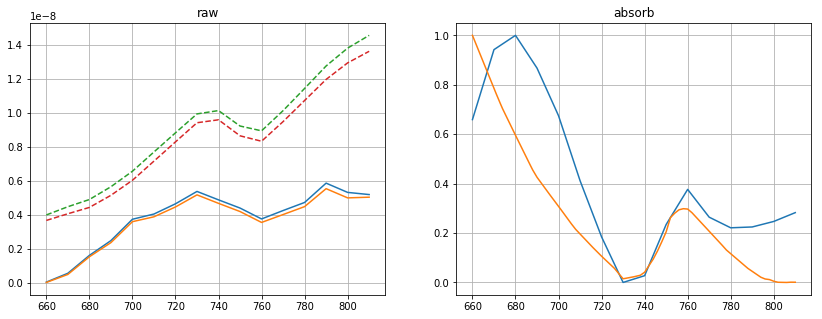

parameters: 
0.4288442753899807
iter: 52 | loss: 0.48281570450168065


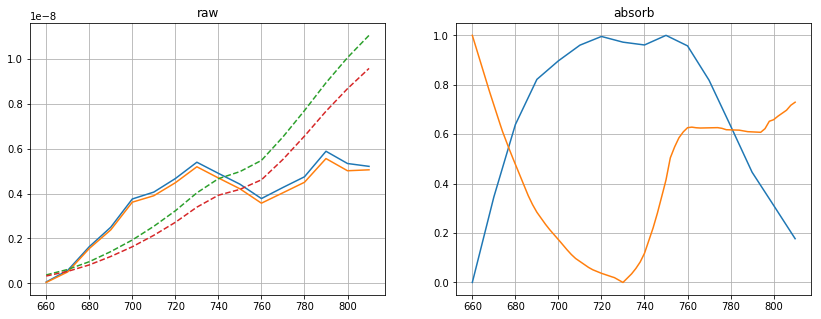

parameters: 
0.7864533174701509
iter: 66 | loss: 0.3623161975628133


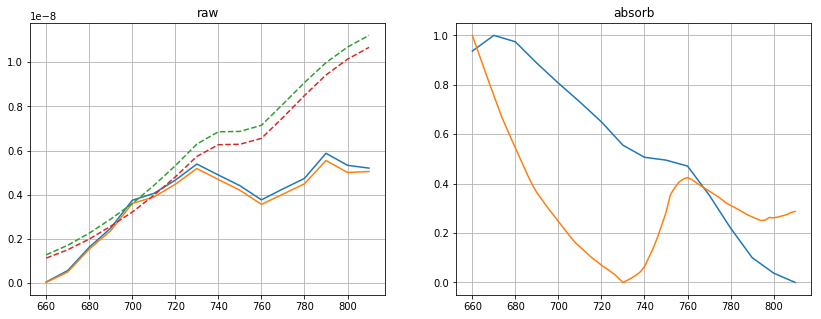

parameters: 
0.6684605321361812
iter: 84 | loss: 0.34389303095748464


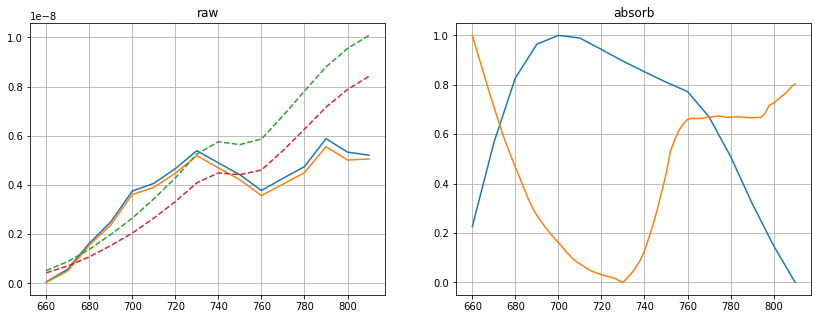

parameters: 
0.7977272115331576
iter: 130 | loss: 0.27407435730203566


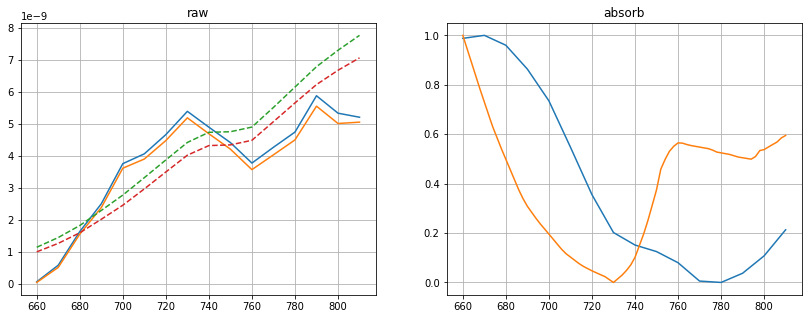

parameters: 
0.7616996696168052
iter: 151 | loss: 0.26312740708042187


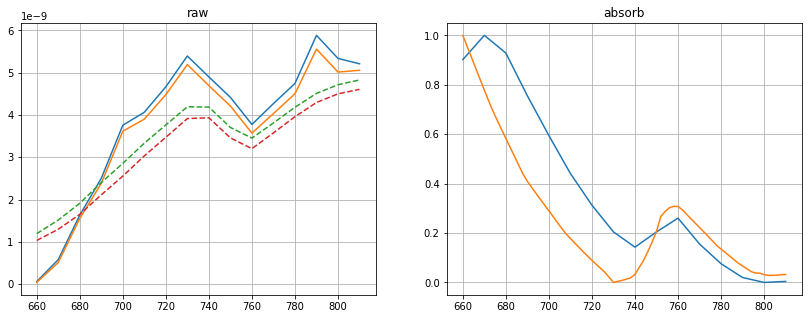

parameters: 
0.4877467197996726
iter: 162 | loss: 0.25296223805295465


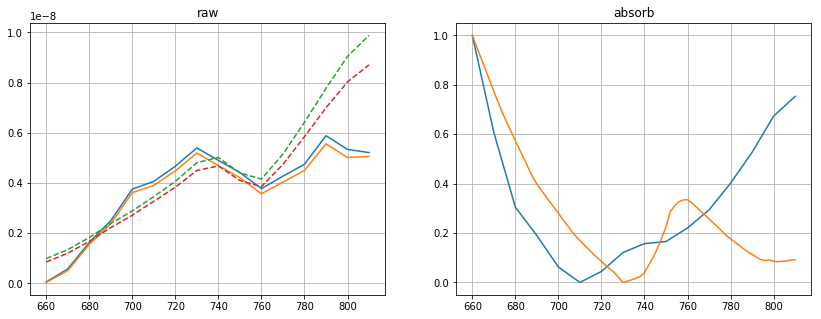

parameters: 
0.5474548591174797
iter: 310 | loss: 0.2527918364500429


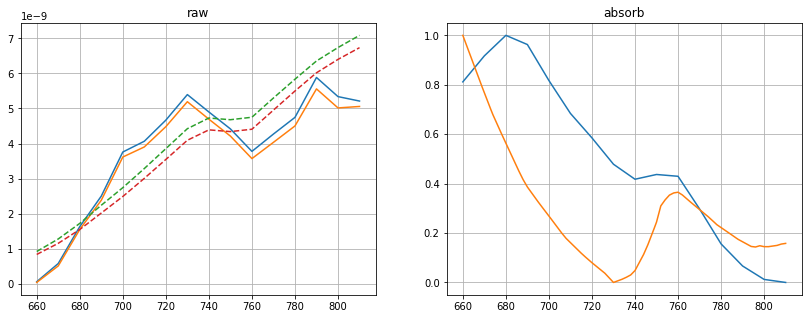

parameters: 
0.5977273725885643
iter: 671 | loss: 0.2461864581188882


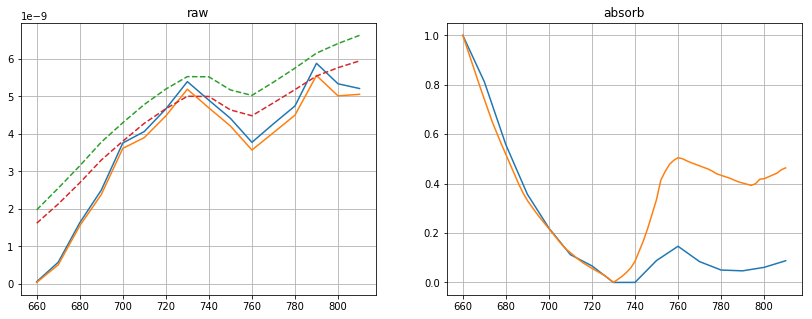

parameters: 
0.7300479355255719
iter: 805 | loss: 0.21002513766668918


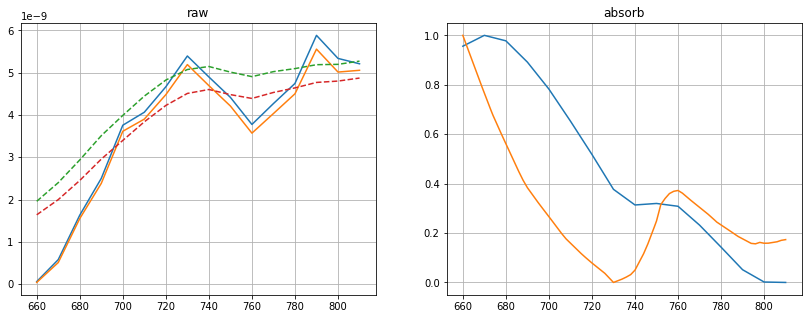

parameters: 
0.6077965784293827
iter: 1083 | loss: 0.20631255631663886


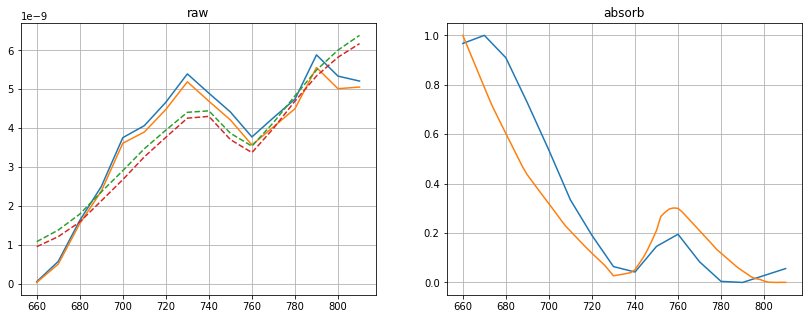

parameters: 
0.40935311867416374
iter: 1492 | loss: 0.1890152854934447


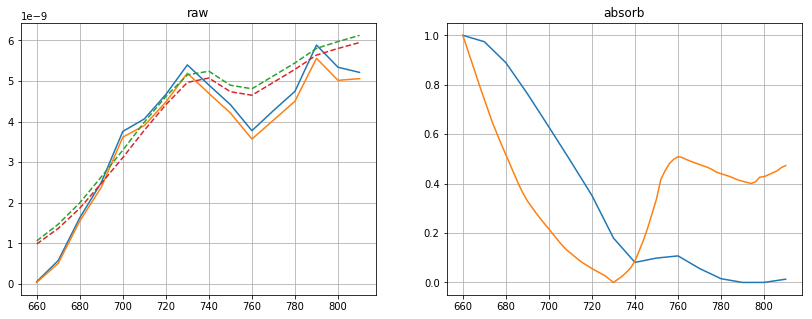

parameters: 
0.7326094535609635
iter: 1571 | loss: 0.18866311033519037


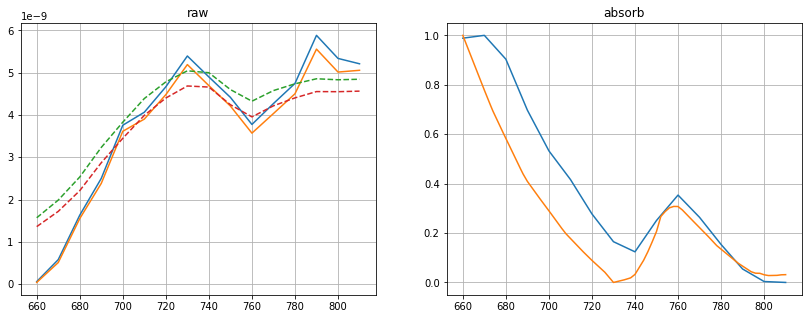

parameters: 
0.4869713799237986
iter: 1795 | loss: 0.1787956053924791


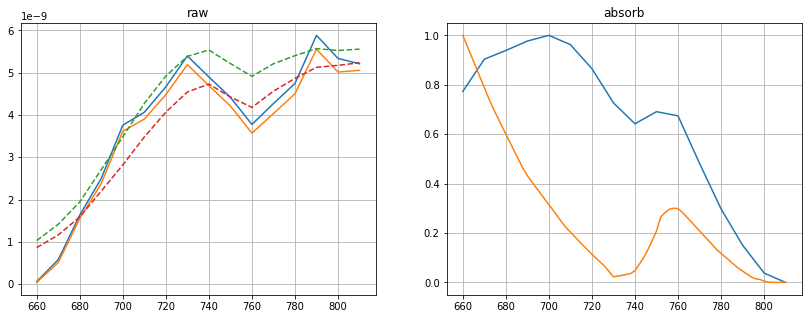

parameters: 
0.41632604999469397
iter: 2607 | loss: 0.13980907277394025


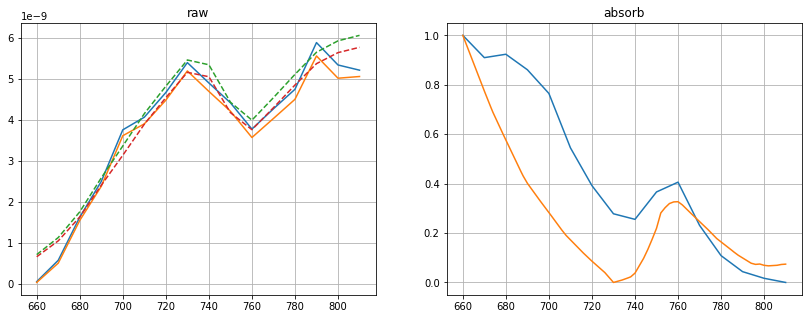

parameters: 
0.5309273381325518
data/calibrated/20190524_split/IJV/20190524_split_5_3.csv
iter: 6 | loss: 88.37893518754534


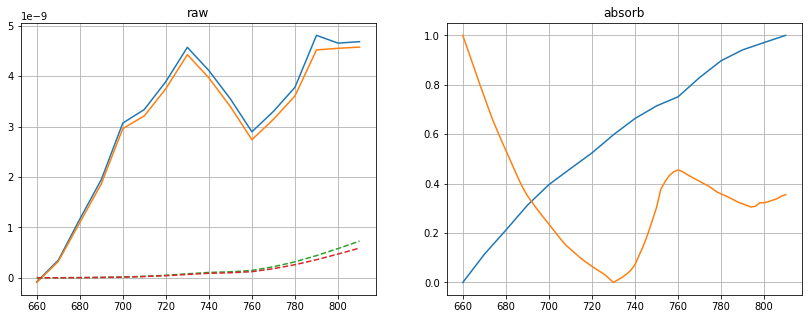

parameters: 
0.6955280015064071
iter: 9 | loss: 0.6588322974679399


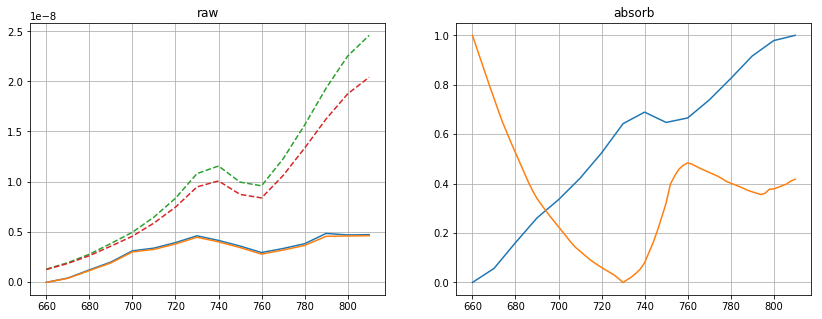

parameters: 
0.7165564600479575
iter: 27 | loss: 0.3514897670397895


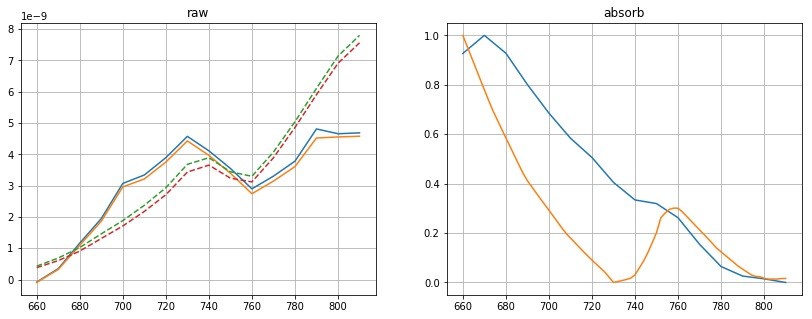

parameters: 
0.4687386634266846
iter: 60 | loss: 0.33508861355836383


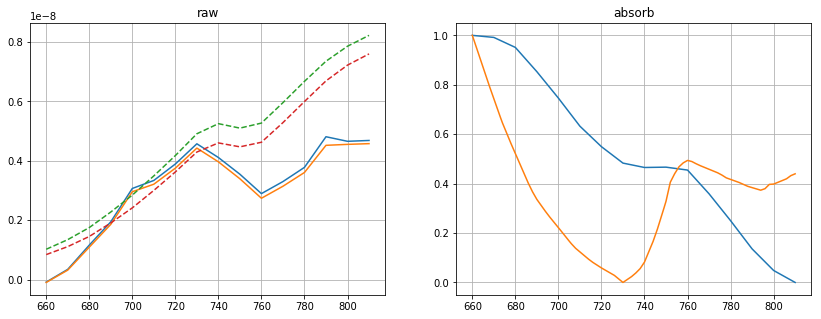

parameters: 
0.7231773913570502
iter: 136 | loss: 0.24222464400056332


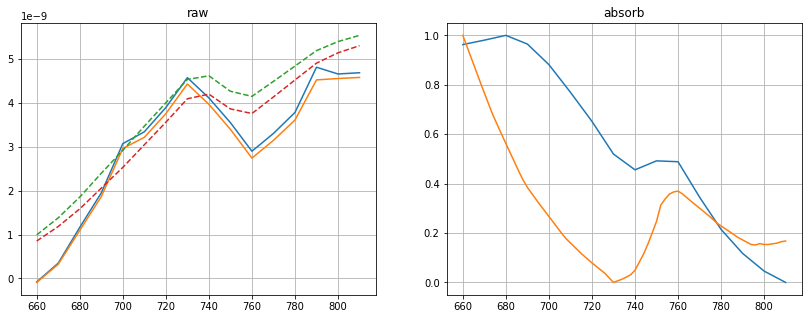

parameters: 
0.60415890933459
iter: 288 | loss: 0.19998186825760494


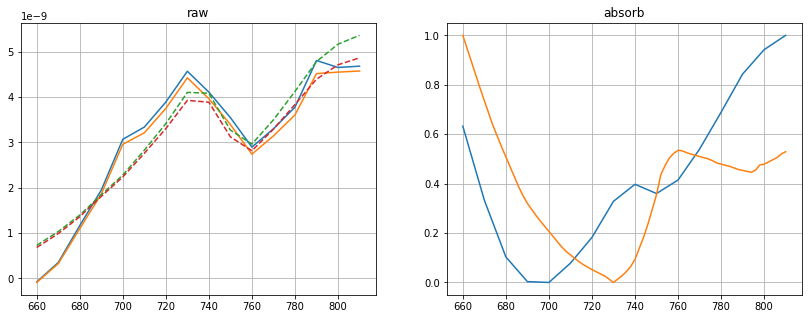

parameters: 
0.7469637282255858
iter: 8395 | loss: 0.1855157695834556


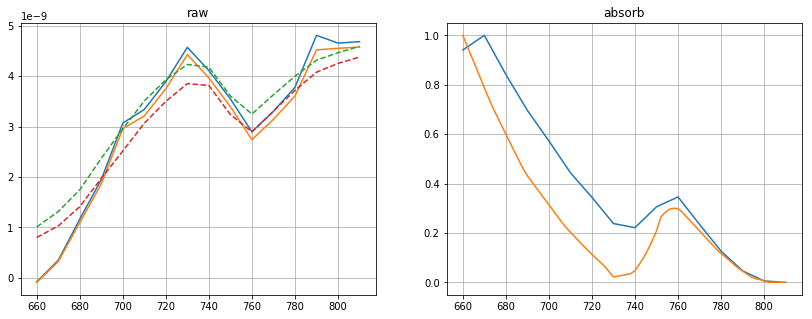

parameters: 
0.41706688453646157
data/calibrated/20190524_split/IJV/20190524_split_6_1.csv
iter: 14 | loss: 0.43538153606210106


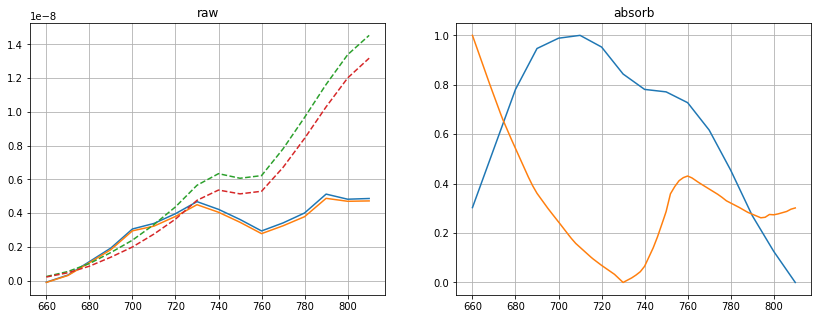

parameters: 
0.6743831076912177
iter: 34 | loss: 0.21235031976444274


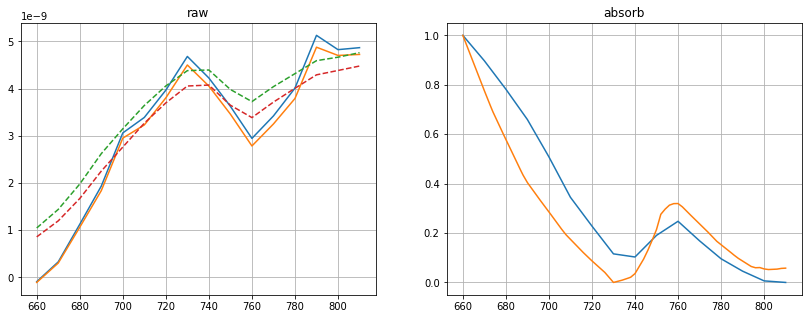

parameters: 
0.5151694738238743
iter: 3325 | loss: 0.2085712458178448


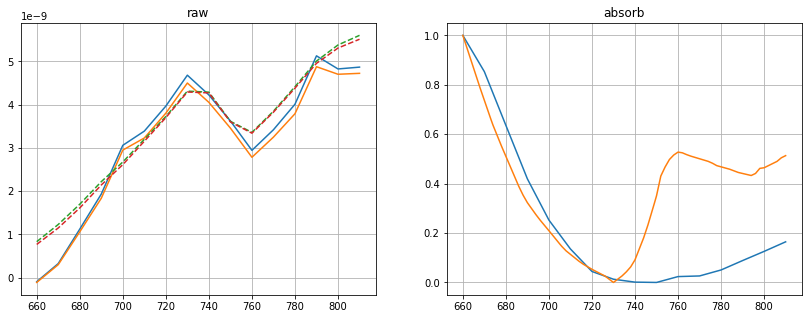

parameters: 
0.7430666031645594
iter: 4074 | loss: 0.18597235894416617


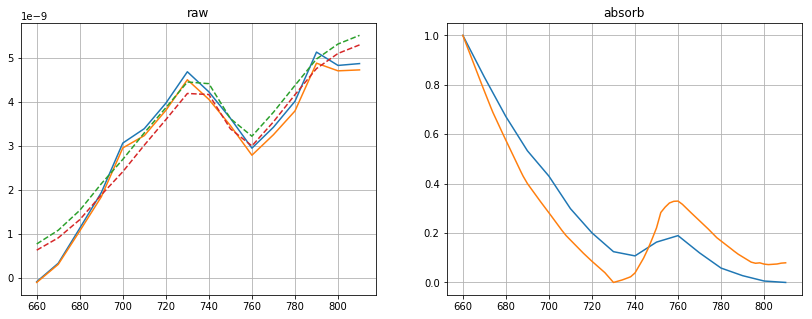

parameters: 
0.5359871874015729
iter: 9088 | loss: 0.17849575315469116


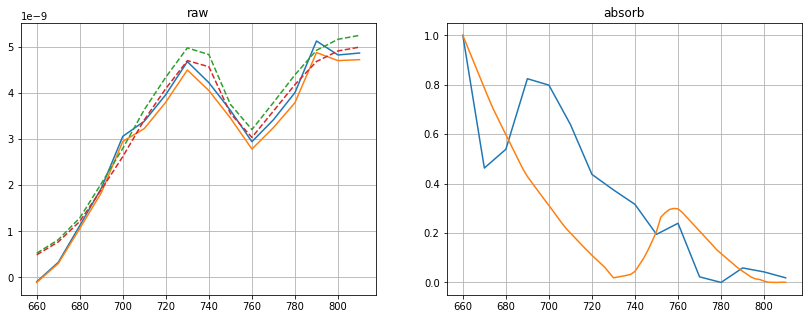

parameters: 
0.42263088887440386
data/calibrated/20190524_split/IJV/20190524_split_6_2.csv
iter: 4 | loss: 0.8863270911857373


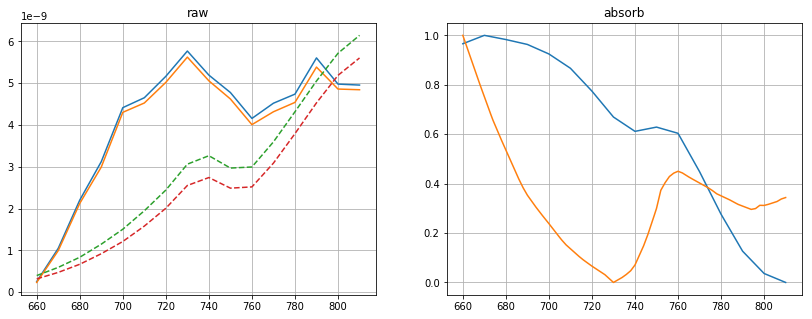

parameters: 
0.6911793137000324
iter: 7 | loss: 0.31107397768521156


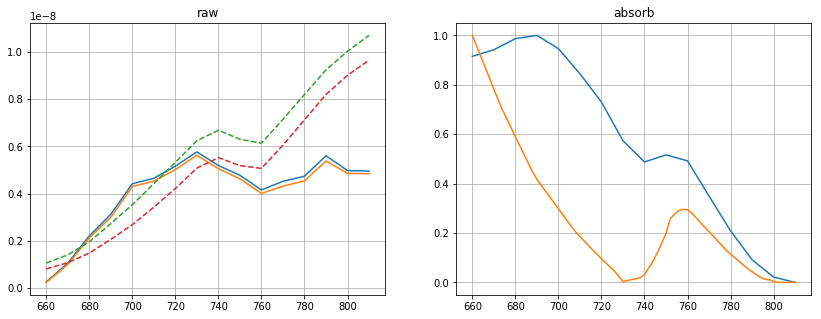

parameters: 
0.4446186130395939
iter: 134 | loss: 0.2797872450295655


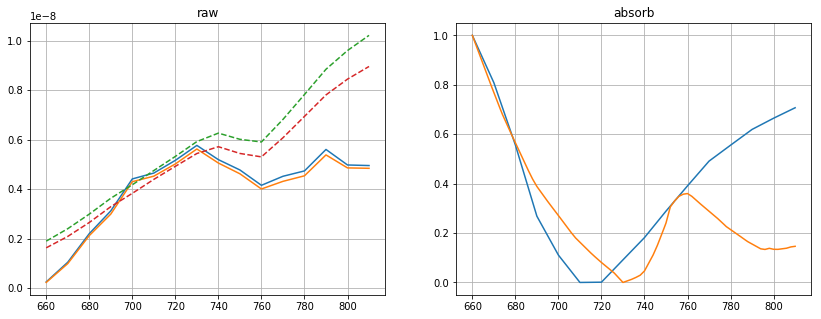

parameters: 
0.5895967024386044
iter: 242 | loss: 0.20603423928180248


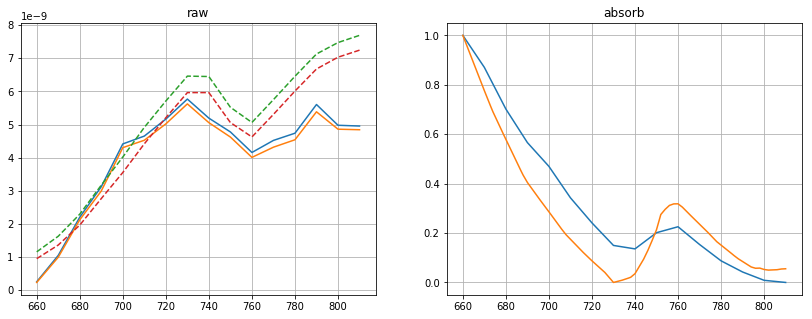

parameters: 
0.5126549936642429
iter: 416 | loss: 0.15639312607364045


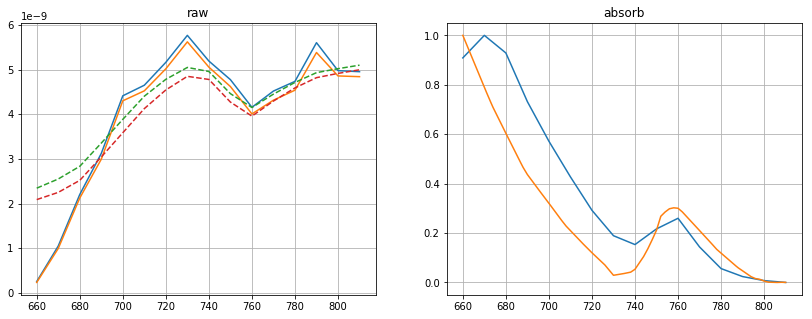

parameters: 
0.4057408132243945
iter: 4470 | loss: 0.12025020363874996


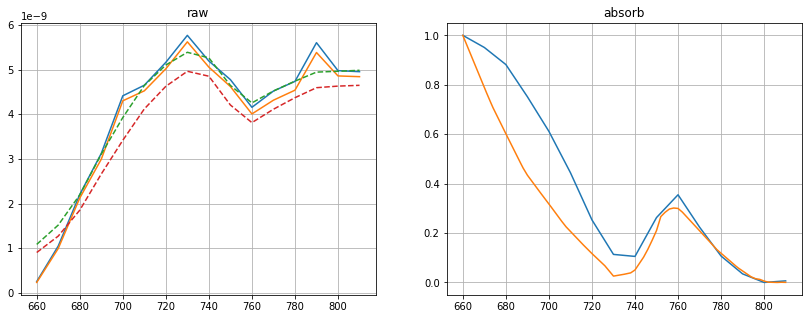

parameters: 
0.4113841344285597
data/calibrated/20190524_split/IJV/20190524_split_6_3.csv
iter: 5 | loss: 0.5297196912293418


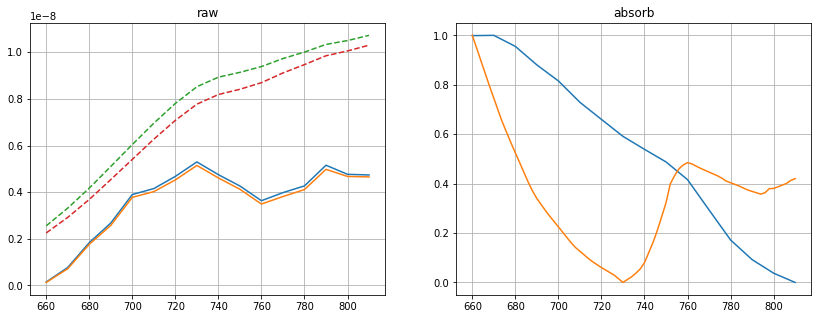

parameters: 
0.7172736521361011
iter: 15 | loss: 0.229058841045987


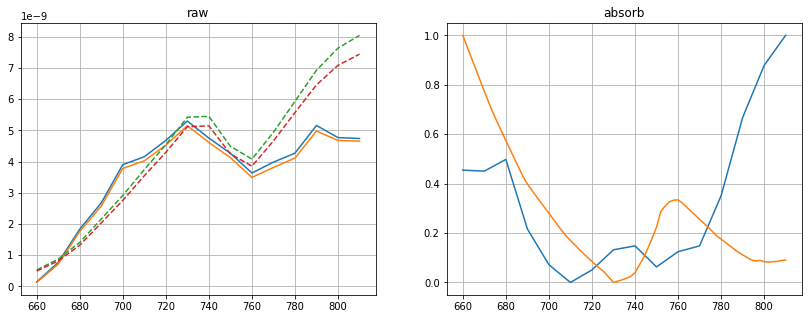

parameters: 
0.5458521205074616
iter: 20 | loss: 0.227274014333947


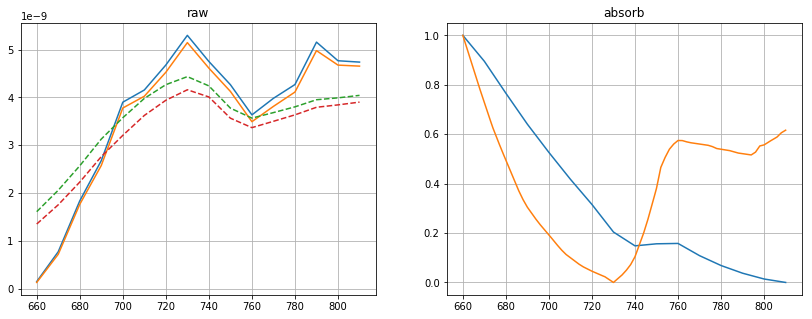

parameters: 
0.7660413101092498
iter: 225 | loss: 0.21242343719197113


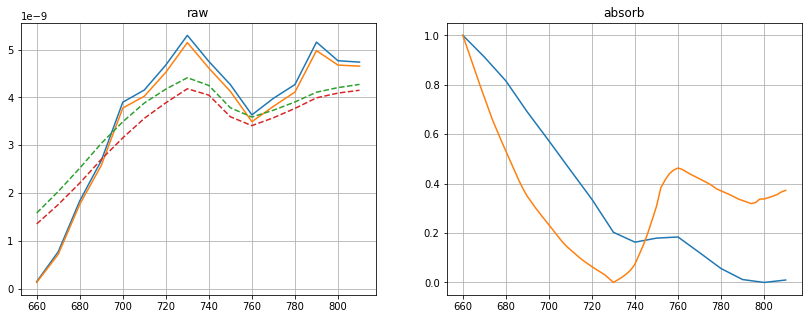

parameters: 
0.7016717307833117
iter: 1092 | loss: 0.17814972407151605


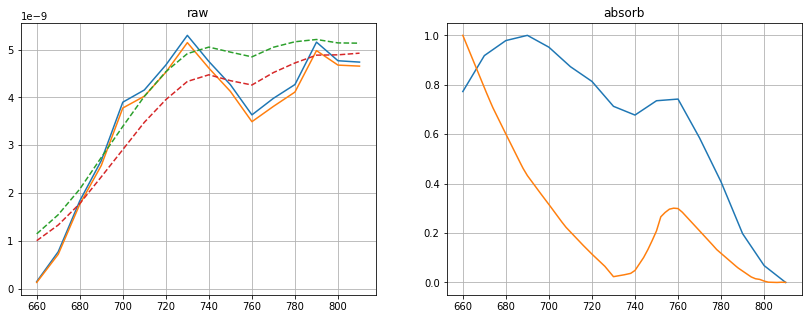

parameters: 
0.4151590021973026
iter: 2276 | loss: 0.15914563976404852


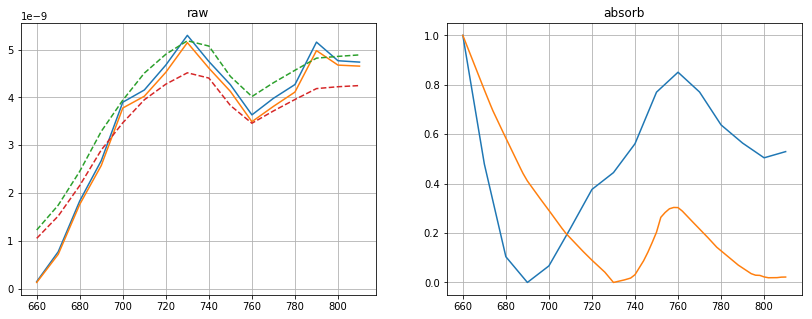

parameters: 
0.47575956930424007
iter: 5630 | loss: 0.13249012577433542


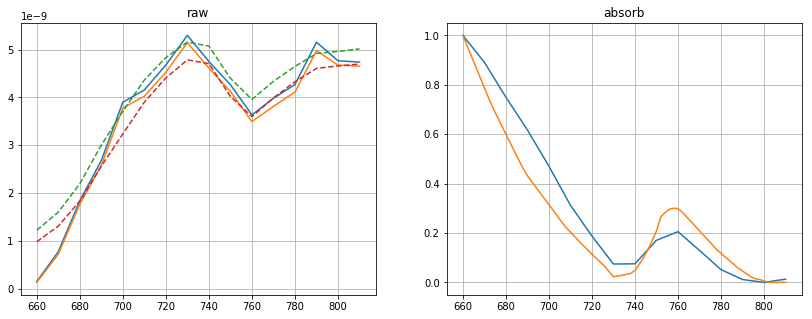

parameters: 
0.4158236861056302
data/calibrated/20190524_split/IJV/20190524_split_7_1.csv
iter: 14 | loss: 0.2448938348367744


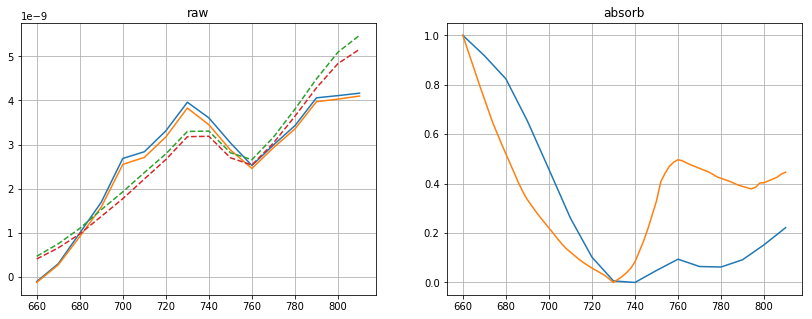

parameters: 
0.7250481387690847
iter: 178 | loss: 0.21647992428557417


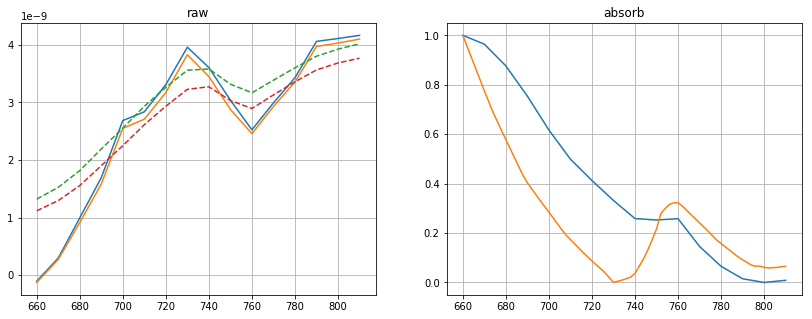

parameters: 
0.5221109498218995
iter: 329 | loss: 0.20746491737976605


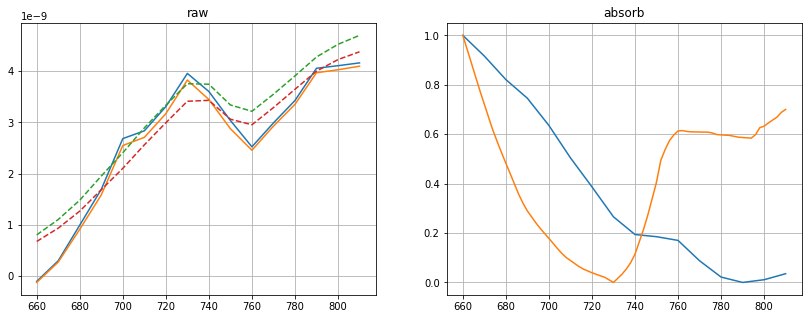

parameters: 
0.7815984147324361
iter: 5236 | loss: 0.1945689137182476


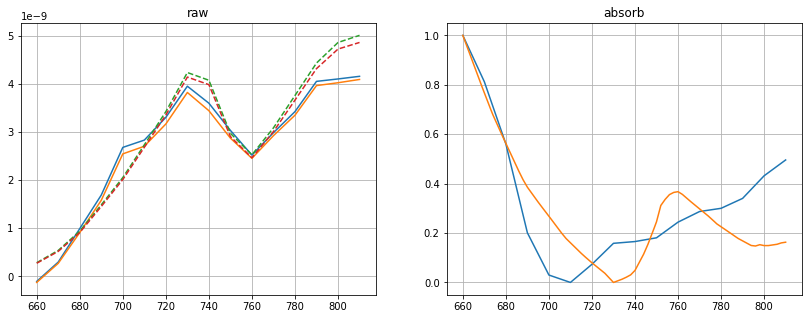

parameters: 
0.6009310485146735
iter: 6357 | loss: 0.1693612025398769


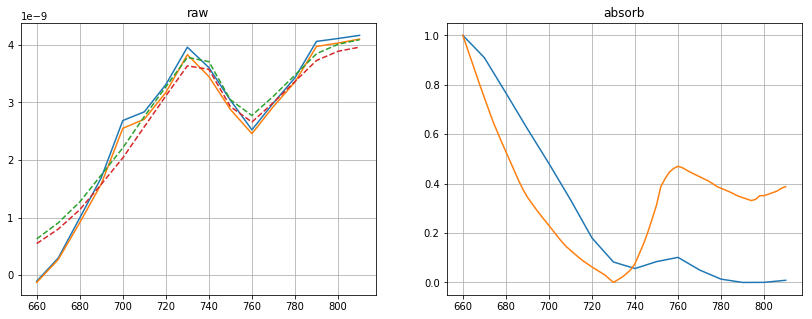

parameters: 
0.7068588597403775
data/calibrated/20190524_split/IJV/20190524_split_7_2.csv
iter: 2 | loss: 0.2911054305411599


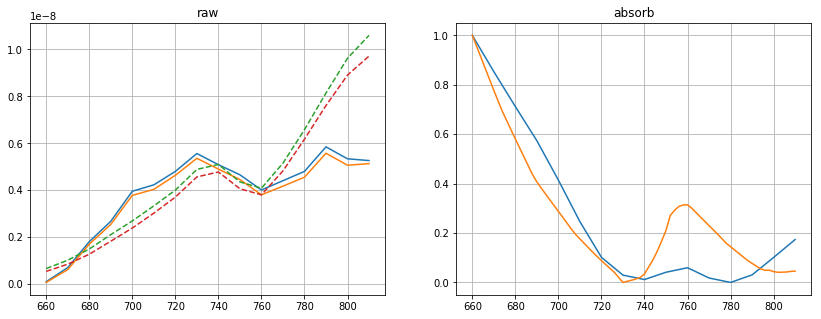

parameters: 
0.5025696932911801
iter: 33 | loss: 0.22751564994504886


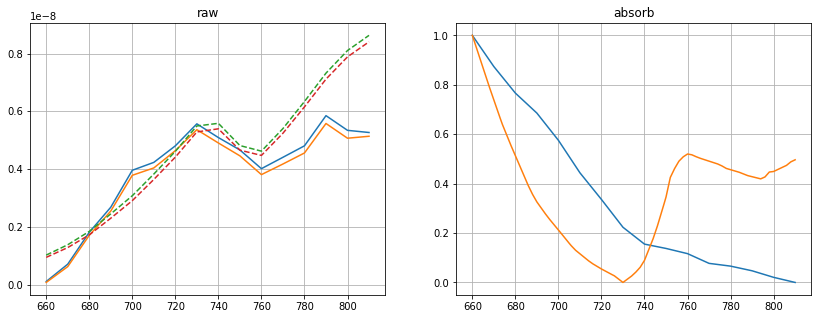

parameters: 
0.7388183252667821
iter: 378 | loss: 0.20889687918691446


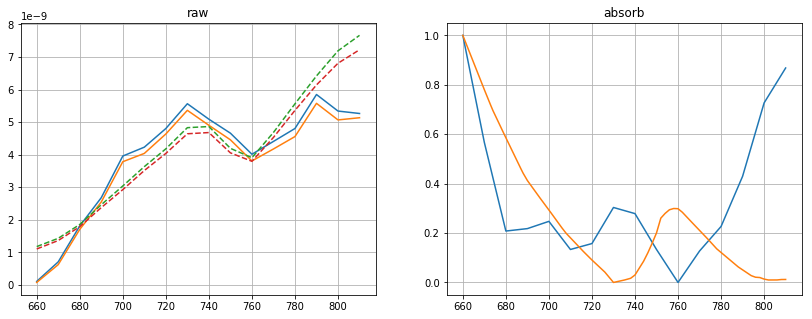

parameters: 
0.4638026208936401
iter: 556 | loss: 0.18857778174582107


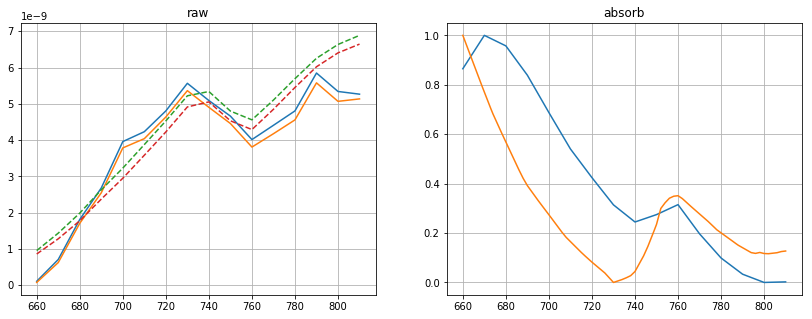

parameters: 
0.5757026738261399
iter: 1015 | loss: 0.166505766242737


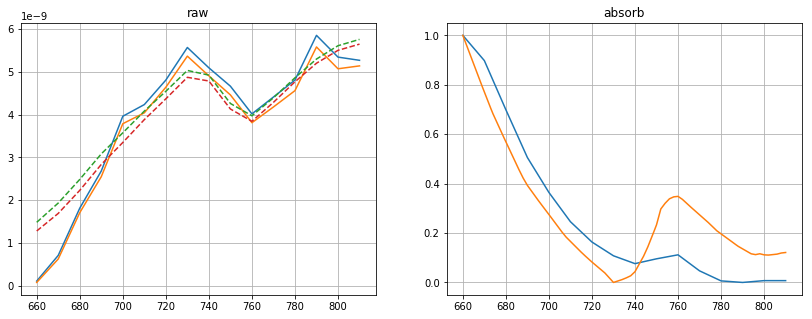

parameters: 
0.5711389688445364
iter: 3809 | loss: 0.12325309111768407


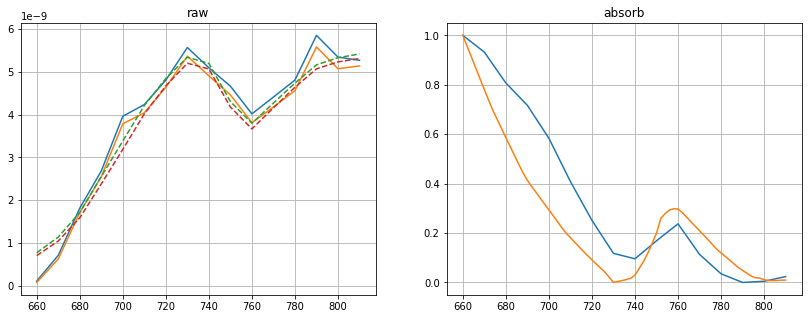

parameters: 
0.4604874015576208
data/calibrated/20190524_split/IJV/20190524_split_7_3.csv
iter: 1 | loss: 0.7671145477043573


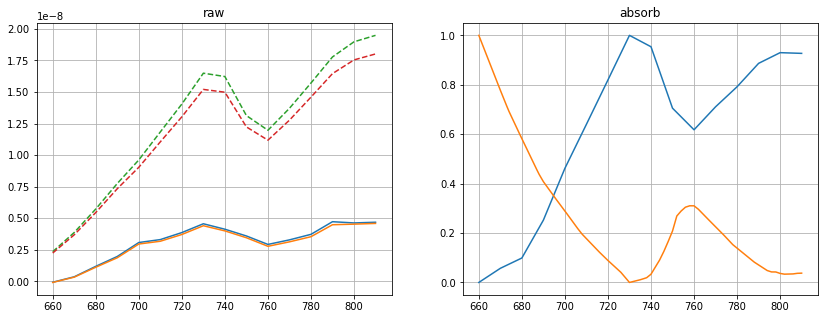

parameters: 
0.4937930626655737
iter: 4 | loss: 0.6969705436680445


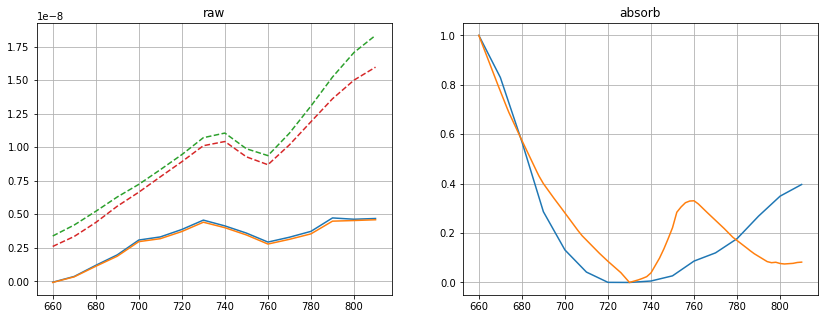

parameters: 
0.5384665309531932
iter: 15 | loss: 0.401306412789106


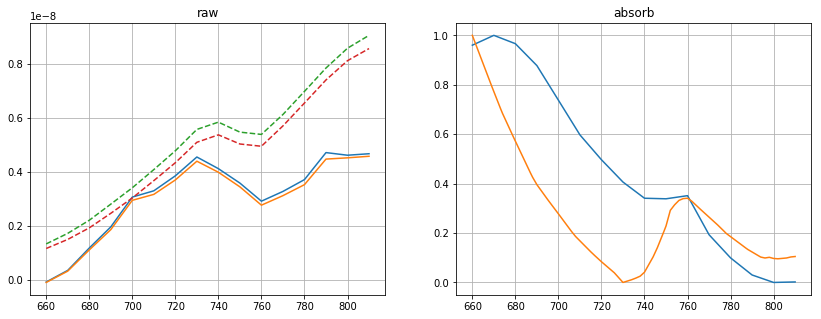

parameters: 
0.5581255134324683
iter: 18 | loss: 0.28122155754904316


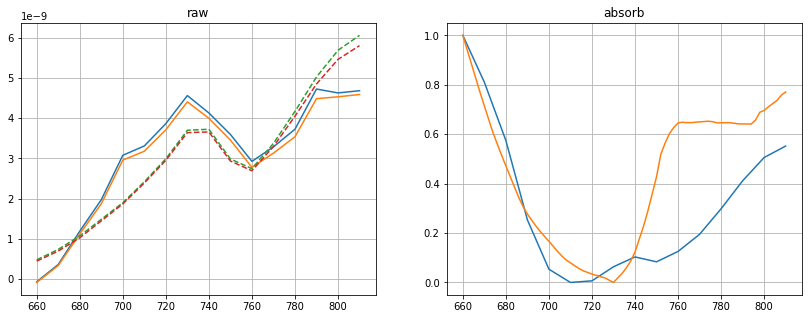

parameters: 
0.7929133891811599
iter: 70 | loss: 0.22660425397066686


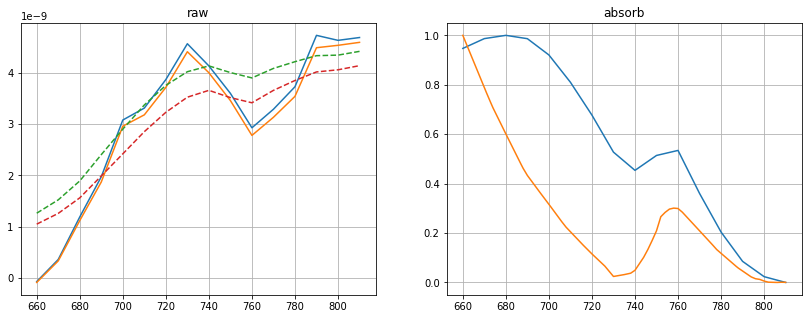

parameters: 
0.4138685328528391
iter: 131 | loss: 0.22508203767888482


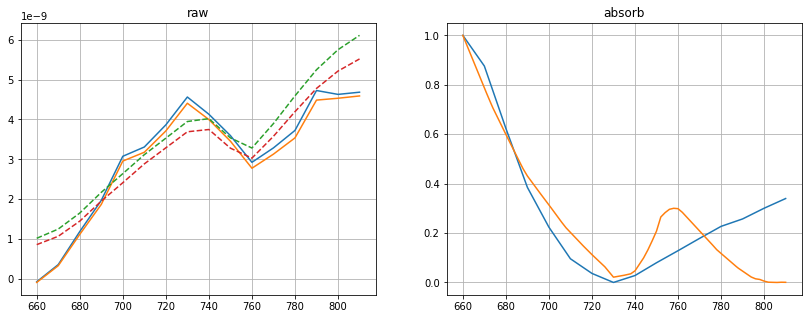

parameters: 
0.4184633649431667
iter: 1612 | loss: 0.20677780518553468


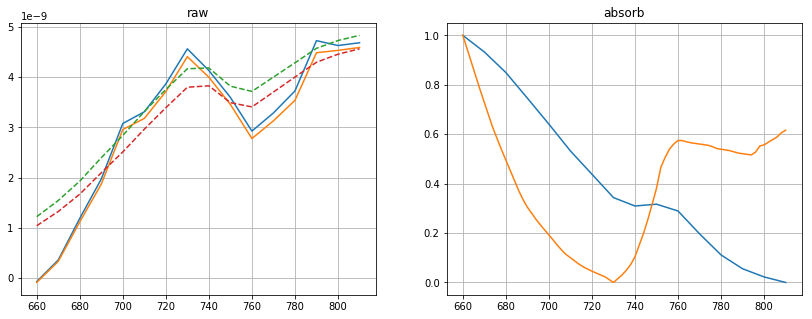

parameters: 
0.7660344497331326
iter: 2193 | loss: 0.20672677474314144


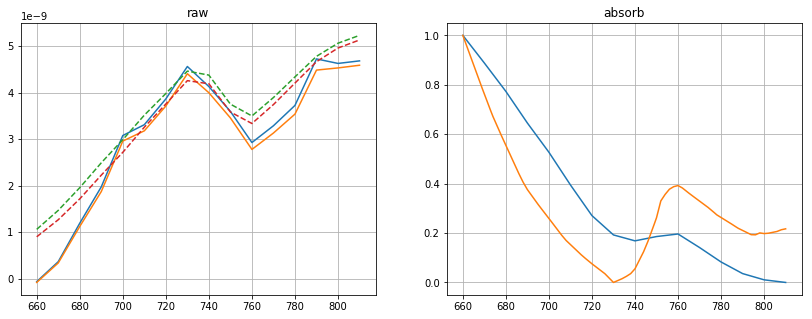

parameters: 
0.6335955874335231
iter: 2442 | loss: 0.17496901426147993


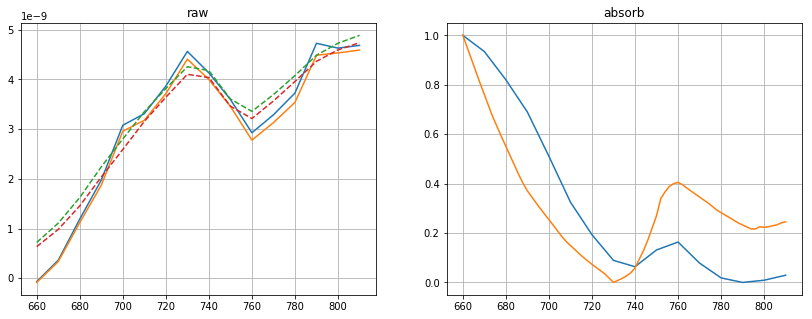

parameters: 
0.6484993741985221


In [72]:
for s in spec_list:
    print(s)
    spec = pd.read_csv(s)
    spec = spec[
        (spec["wavelength"] >= wl[0])&
        (spec["wavelength"] <= wl[-1])
    ]
    spec_max = spec["max"].values.T
    spec_min = spec["min"].values.T
    
    spec_max_n = normalize(spec_max)
    spec_min_n = normalize(spec_min)

    min_loss = 100
    min_args = {}
    for i in range(10000):
        args_max, args_min = get_args(
            geo_max=[1.27, 1.00, 7.71 + uniform(-0.2, 0.2), 14.95, 3.53, 23.86, 7.68],
            geo_min=[1.27, 1.00, 7.10 + uniform(-0.2, 0.2), 14.95, 3.53, 23.86, 7.68]
        )
        pred_max = engine.get_spectrum(args_min, warning=False)
        pred_min = engine.get_spectrum(args_max, warning=False)
        
        pred_max_n = normalize(pred_max)
        pred_min_n = normalize(pred_min)
        
#         loss = (rmse_loss(pred_max_n, spec_max_n) + rmse_loss(pred_min_n, spec_min_n))/2  
#         loss = (rmse_loss(pred_max, spec_max) + rmse_loss(pred_min, spec_min))/2
        
        loss = (rmsp_loss(pred_max, spec_max) + rmsp_loss(pred_min, spec_min))/2 \
#         + 0.001 * rmse_loss(
#             normalize(np.log(spec_max/spec_min)), normalize(np.log(pred_max/pred_min))
#         )
        if min_loss > loss:
            print("iter: {} | loss: {}".format(i, loss))
            min_loss = loss
            min_args = args_min
            
            fig, ax = plt.subplots(1, 2, figsize=(14, 5))
            ax[0].plot(wl, spec_max, label="spec_max")
            ax[0].plot(wl, spec_min, label="spec_min")
            ax[0].plot(wl, pred_max, '--', label="pred_max")
            ax[0].plot(wl, pred_min, '--', label="pred_min")
            ax[0].set_title("raw")
            ax[0].grid()
            
#             ax[1].plot(wl, spec_max_n, label="spec_max")
#             ax[1].plot(wl, spec_min_n, label="spec_min")
#             ax[1].plot(wl, pred_max_n, '--', label="pred_max")
#             ax[1].plot(wl, pred_min_n, '--', label="pred_min")
#             ax[1].set_title("norm")
#             plt.show()
            
#             ax[1].plot(wl, normalize(np.log(spec_max/spec_min)))
            ax[1].plot(wl, normalize(np.log(pred_max/pred_min)))
            sss = args_max["IJV"]["ScvO2"]
            ax[1].plot(mua["wavelength"], normalize(oxy * sss + deoxy * (1-sss)))
            ax[1].set_title("absorb")
            
            ax[1].grid()
            plt.show()
            
            print("parameters: ")
            print(args_max["IJV"]["ScvO2"])
            with open("fitting/" + s.split('/')[-1].strip('.csv') + ".json", 'w') as f:
                args_max["rmsp"] = loss
                json.dump(args_max, f, indent=4)
            
    


In [73]:
for i in range(100):
    args_max, args_min = get_args(
        geo_max=[1.27, 1.00, 7.71, 14.95, 3.53, 23.86, 7.68],
        geo_min=[1.27, 1.00, 7.10, 14.95, 3.53, 23.86, 7.68]
    )
    pred_min = engine.get_spectrum(args_max)
    pred_max = engine.get_spectrum(args_min)

    pred_max_n = normalize(pred_max)
    pred_min_n = normalize(pred_min)

#     plt.plot(wl, pred_max)
#     plt.plot(wl, pred_min)
#     plt.title("spec")
#     plt.show()
#     fig, ax = plt.subplots(1, 2, figsize=(14, 5))
    plt.plot(wl, np.log(pred_max/pred_min))
#     ax[0].set_title("-log(s1/s2)")
    
    absorb = deoxy * (1-args_max["IJV"]["ScvO2"]) + oxy * args_max["IJV"]["ScvO2"]
    plt.plot(mua["wavelength"], absorb)
    plt.show()
    

### 0527 (柏廷)

In [79]:
spec_list = glob("data/calibrated/20190527_split/IJV/20190527_split_*_*.csv")
spec_list.sort(key=
    lambda x: (int(x.split('_')[-2]), int(x.split('_')[-1].strip('.csv'))) 
)

In [76]:
1: 正常
2, 3: 過度換氣 ,
4, 5: 吸氧氣 ,
6, 7: 閉氣

data/calibrated/20190527_split/IJV/20190527_split_1_1.csv
iter: 1 | loss: 0.2383129792445079


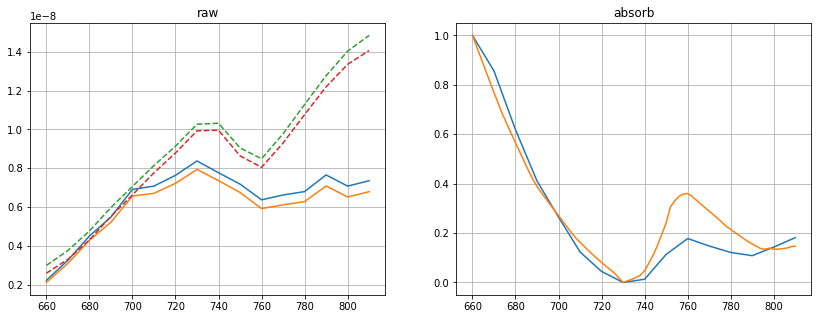

parameters: 
0.590026791324362


/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.


iter: 12 | loss: 0.07769931005408962


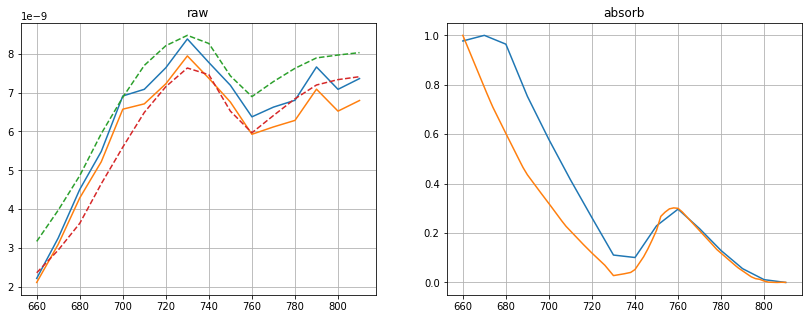

parameters: 
0.4079470347332989


/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


iter: 1805 | loss: 0.06182465682821922


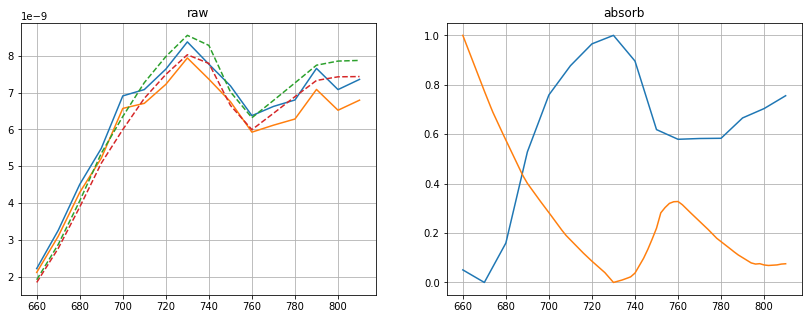

parameters: 
0.5324342302349956
iter: 8089 | loss: 0.060538495727254865


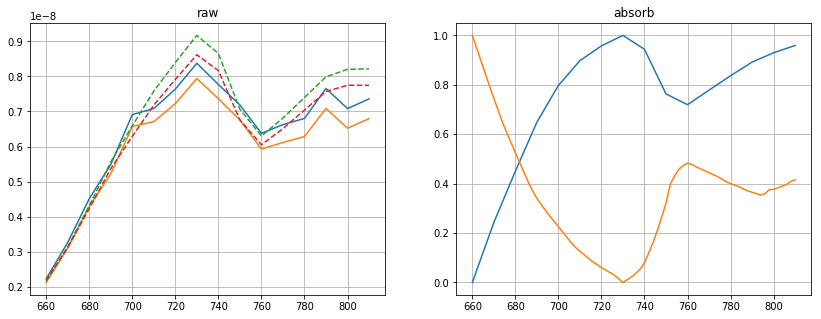

parameters: 
0.7158566779708325
iter: 8772 | loss: 0.05354471785193747


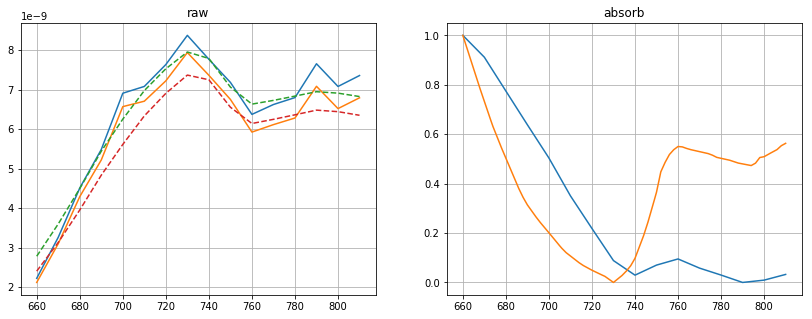

parameters: 
0.7548014094119366
data/calibrated/20190527_split/IJV/20190527_split_2_1.csv
iter: 4 | loss: 38.56516643743811


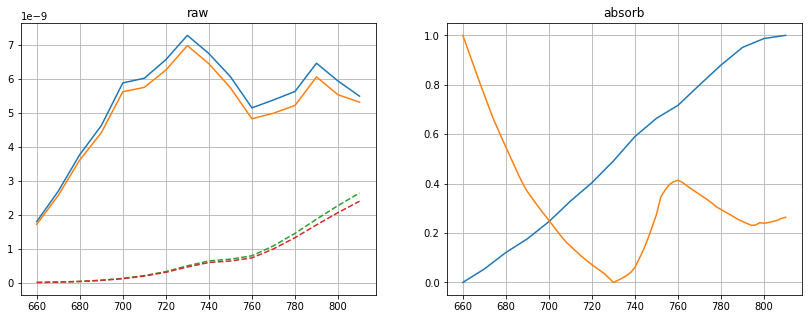

parameters: 
0.6574344563942689
iter: 12 | loss: 7.331785451900837


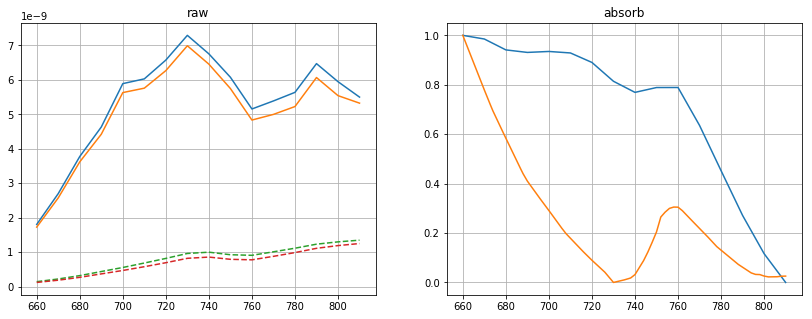

parameters: 
0.4802222870620615
iter: 13 | loss: 1.5713862392912552


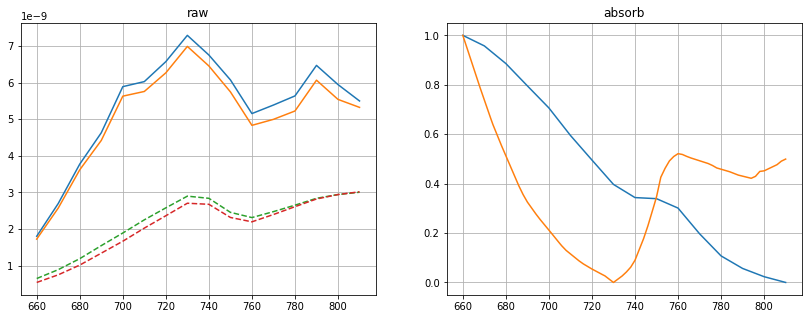

parameters: 
0.7395534161261379
iter: 16 | loss: 0.7736523374846044


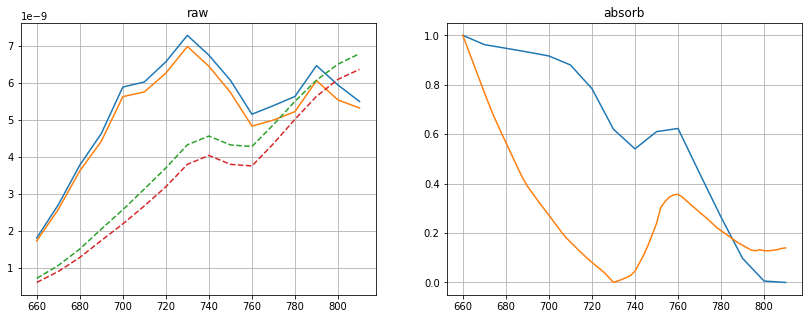

parameters: 
0.5850571700552233
iter: 27 | loss: 0.4884145908389874


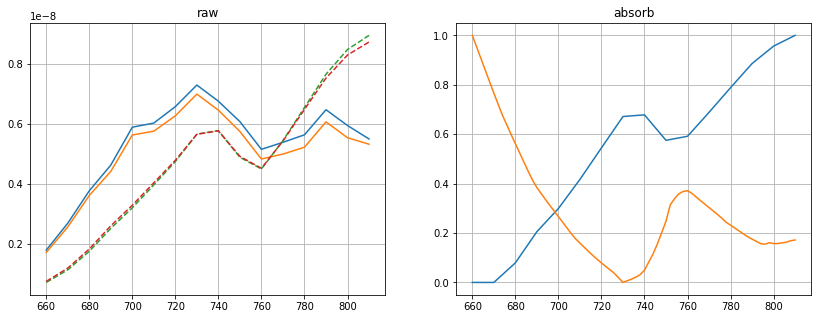

parameters: 
0.606818881325605
iter: 102 | loss: 0.194616475132197


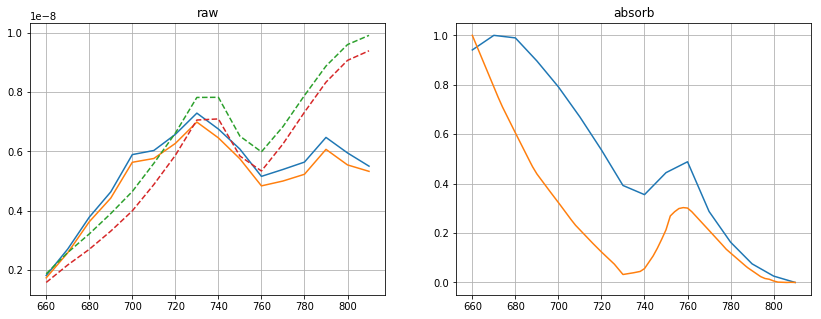

parameters: 
0.4001547696844079
iter: 284 | loss: 0.1858464690706889


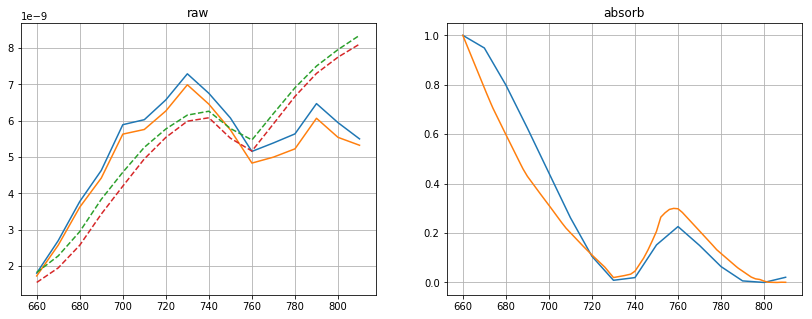

parameters: 
0.42093466438662985
iter: 530 | loss: 0.17542881576166994


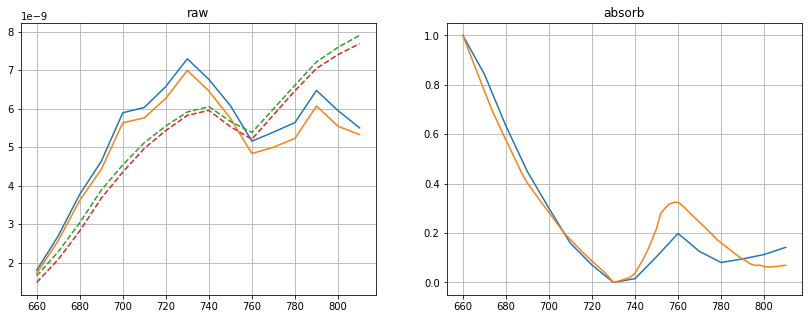

parameters: 
0.5261420473592968
iter: 671 | loss: 0.14454148490838092


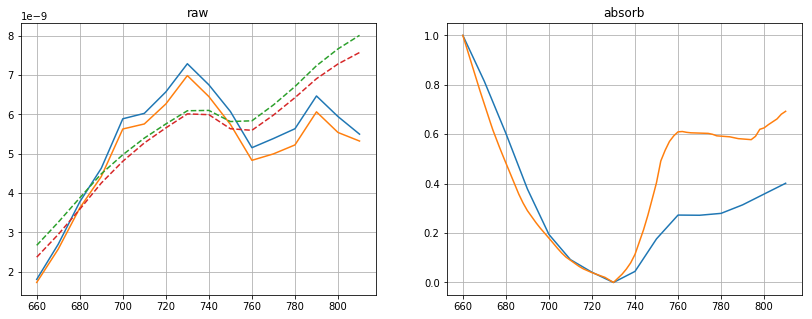

parameters: 
0.7802876899682352
iter: 728 | loss: 0.13703496051350683


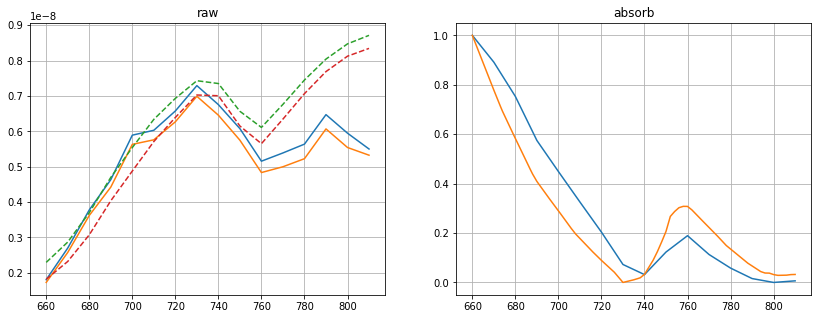

parameters: 
0.48792339468357854
iter: 1342 | loss: 0.13022658645399107


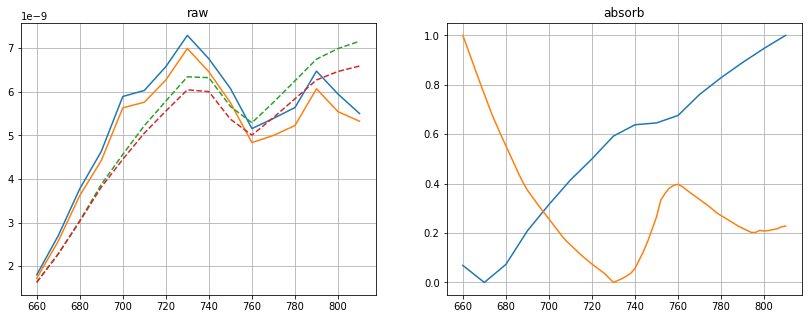

parameters: 
0.6397578238002399
iter: 1534 | loss: 0.1109451991113913


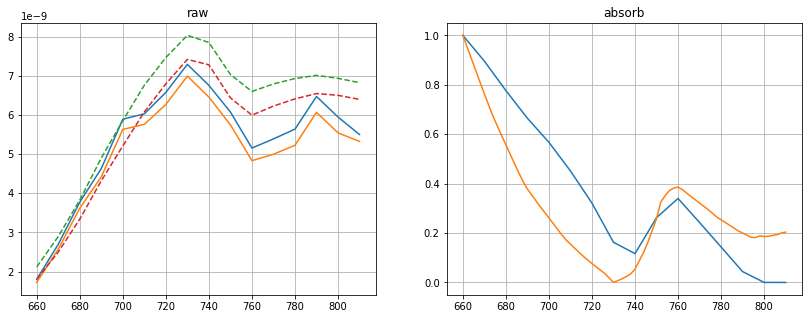

parameters: 
0.6260740921767118
iter: 2432 | loss: 0.09171966165075901


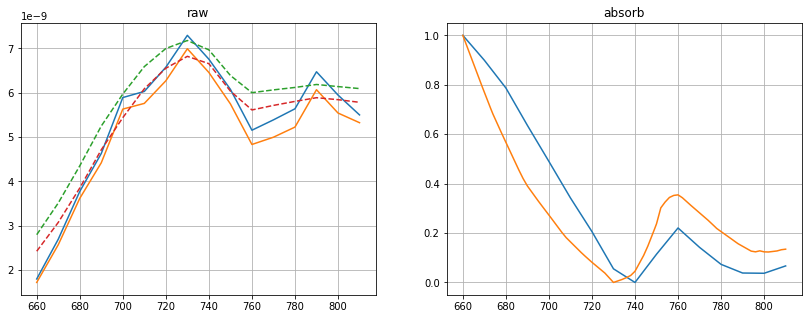

parameters: 
0.5812875246666789
iter: 7420 | loss: 0.0805420750434765


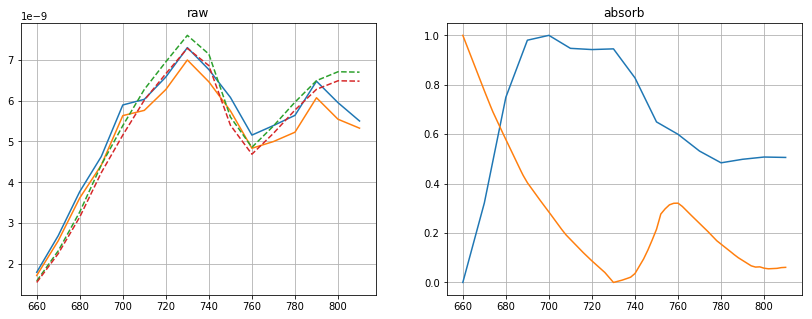

parameters: 
0.5184132290246674
iter: 7678 | loss: 0.04765878378418915


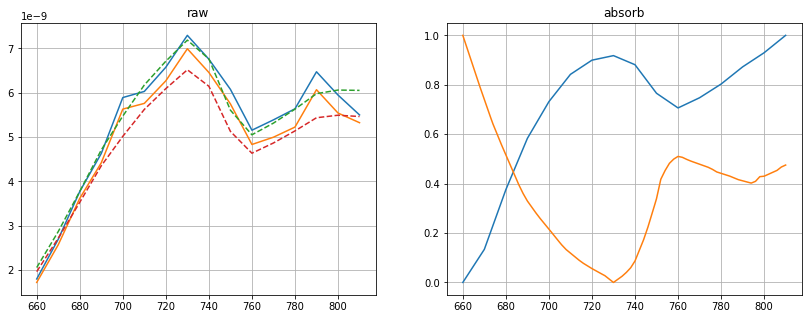

parameters: 
0.7331980499349918
data/calibrated/20190527_split/IJV/20190527_split_2_2.csv
iter: 9 | loss: 9.401658600039902


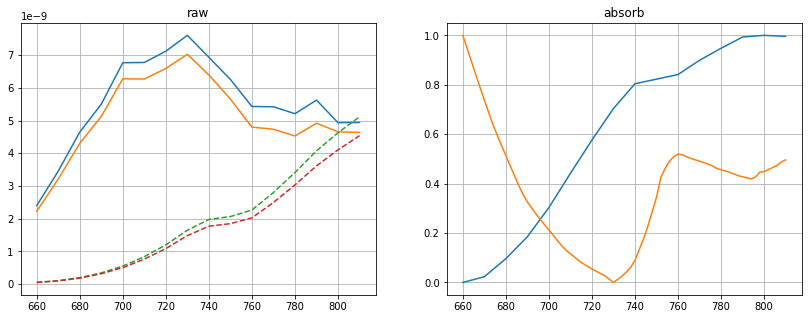

parameters: 
0.7387260612153886
iter: 10 | loss: 4.081883529448918


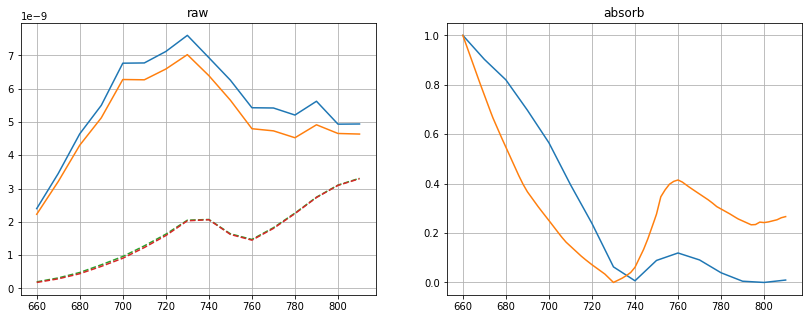

parameters: 
0.658736203603908
iter: 11 | loss: 1.168306372623101


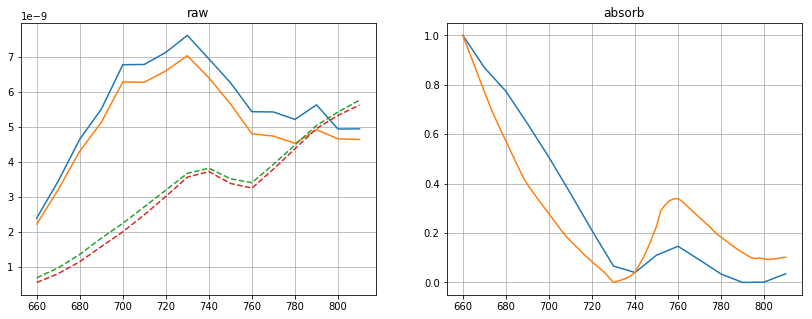

parameters: 
0.5558075914091188
iter: 12 | loss: 0.40394444431792625


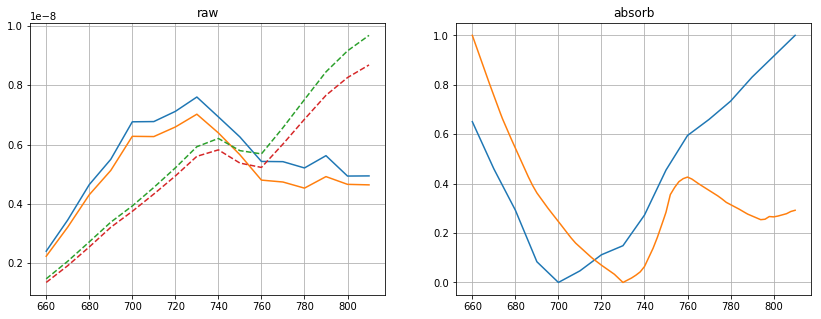

parameters: 
0.6703395805643422
iter: 54 | loss: 0.23742515973433673


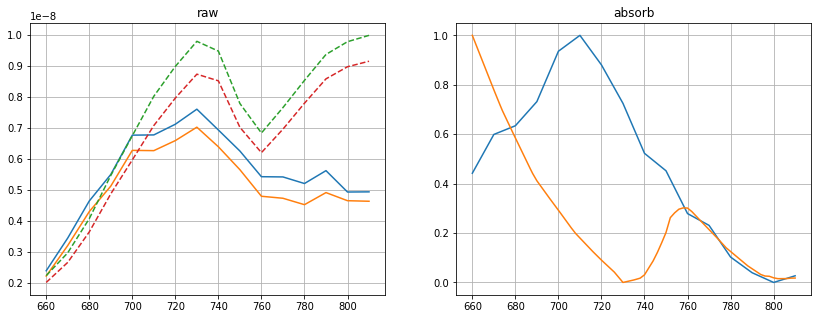

parameters: 
0.4708811900097805
iter: 180 | loss: 0.19179756935106035


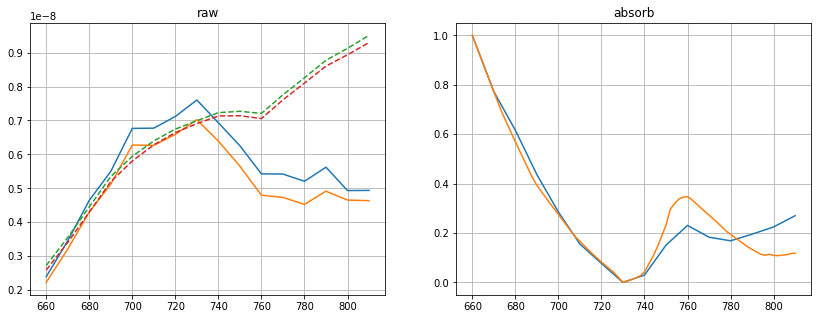

parameters: 
0.5691930819499219
iter: 982 | loss: 0.10495807349770744


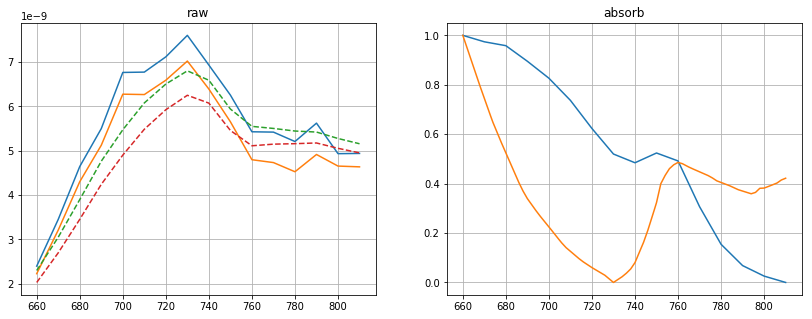

parameters: 
0.7177837028450204
iter: 4146 | loss: 0.09657267894645874


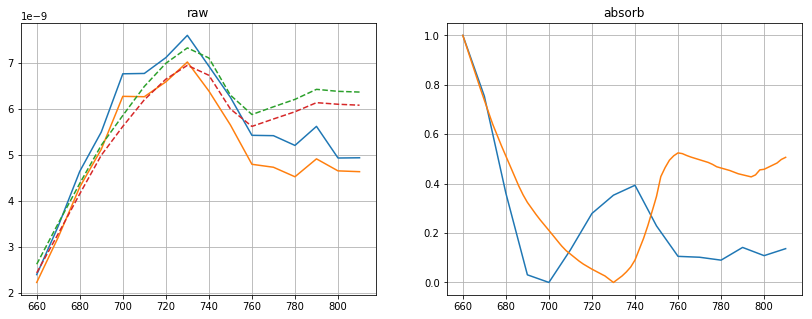

parameters: 
0.7413397324327395
iter: 5211 | loss: 0.08380317874770306


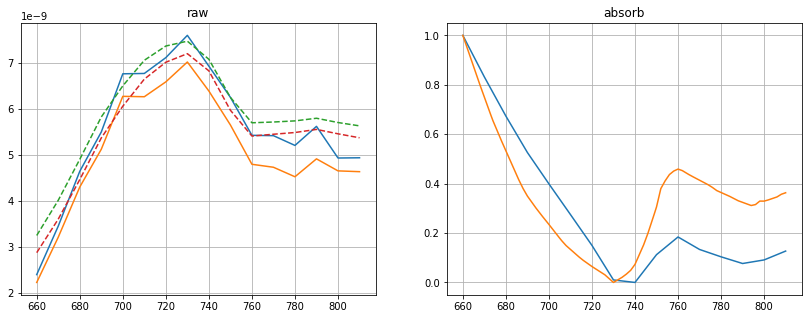

parameters: 
0.698303274107158
iter: 8310 | loss: 0.07231962850186259


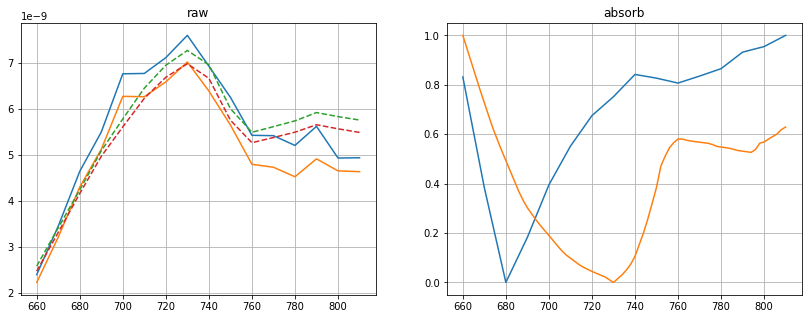

parameters: 
0.7686049474176215
data/calibrated/20190527_split/IJV/20190527_split_2_3.csv
iter: 3 | loss: 0.38002780709013895


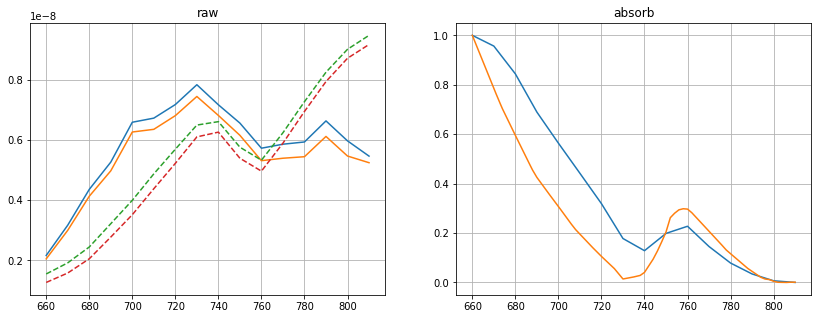

parameters: 
0.42998640252332904
iter: 34 | loss: 0.16149236172725118


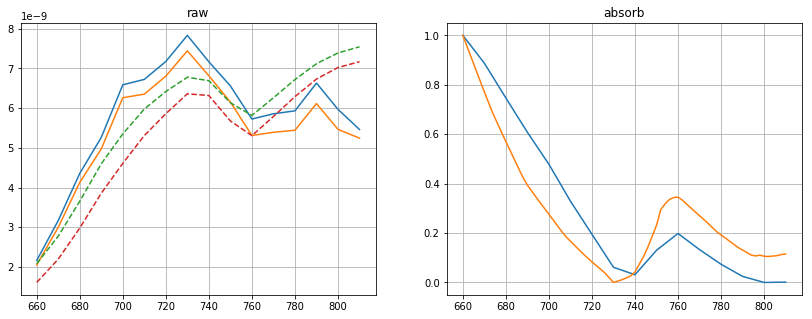

parameters: 
0.5661945750769655
iter: 291 | loss: 0.13206499004143157


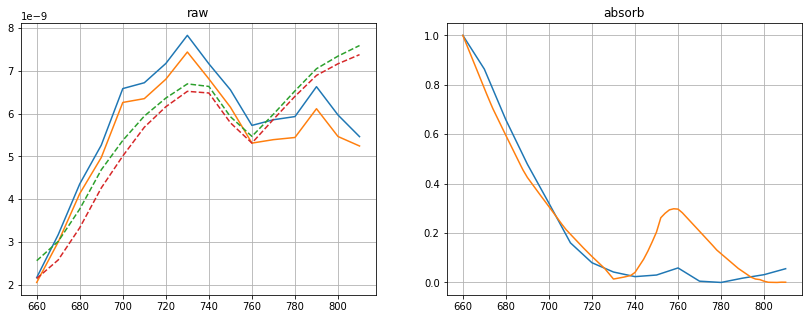

parameters: 
0.43045059679686504
iter: 488 | loss: 0.09829633719082172


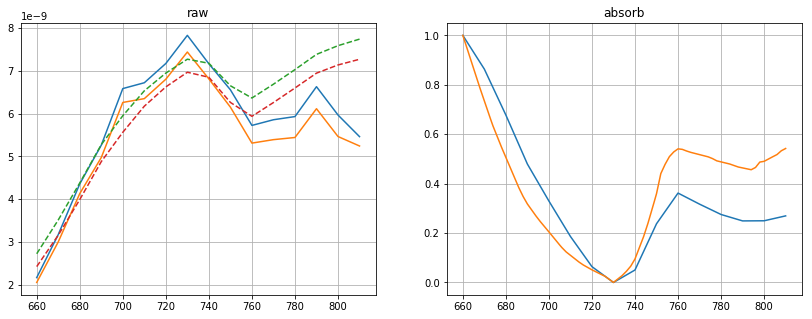

parameters: 
0.7500367095658447
iter: 1426 | loss: 0.0833965923353146


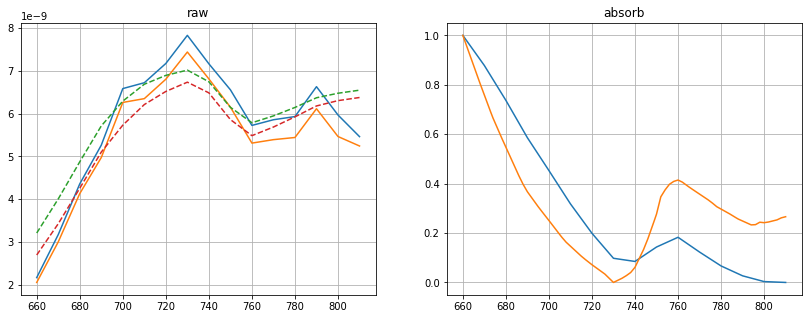

parameters: 
0.6585201031179528
iter: 2557 | loss: 0.06739433638338313


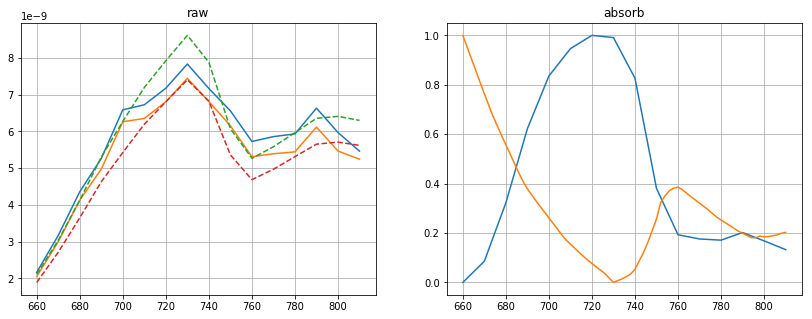

parameters: 
0.6254077261070614
data/calibrated/20190527_split/IJV/20190527_split_3_1.csv
iter: 1 | loss: 10.44271874503961


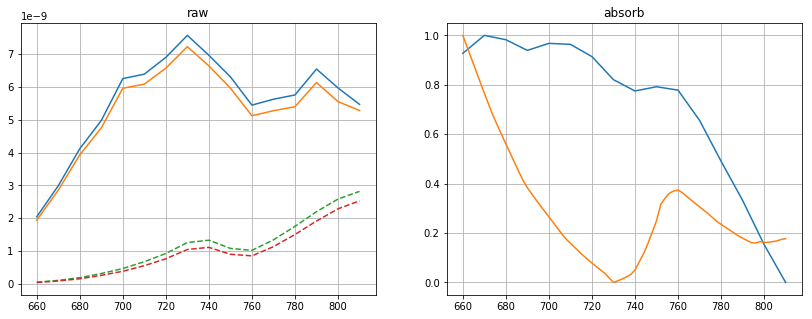

parameters: 
0.6101627469763172
iter: 12 | loss: 2.072428872799784


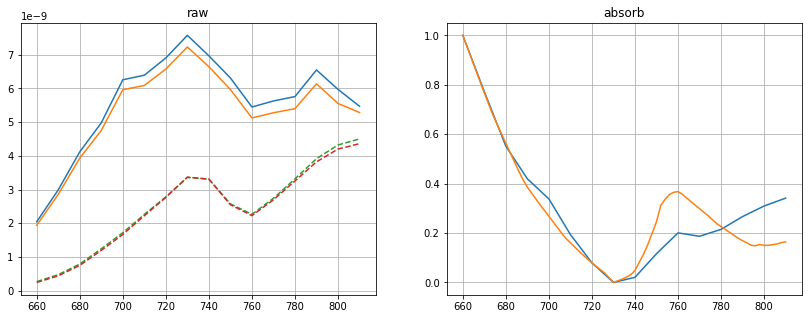

parameters: 
0.6016578504938195
iter: 24 | loss: 0.22582580755018866


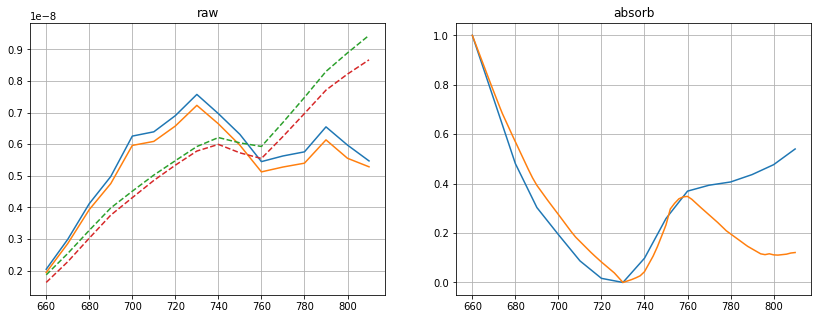

parameters: 
0.5710521939441553
iter: 292 | loss: 0.2084168899895099


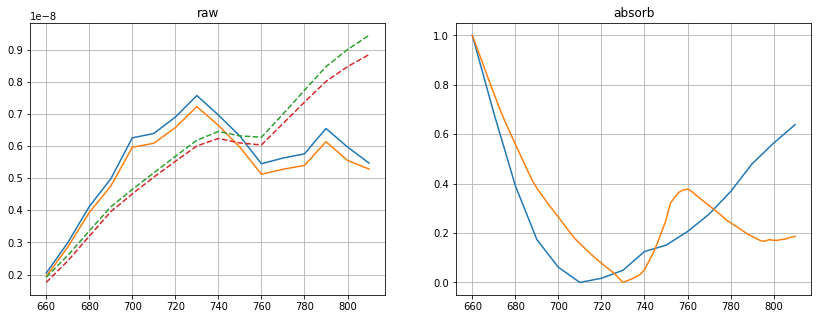

parameters: 
0.6158347666352587
iter: 441 | loss: 0.05122519503973624


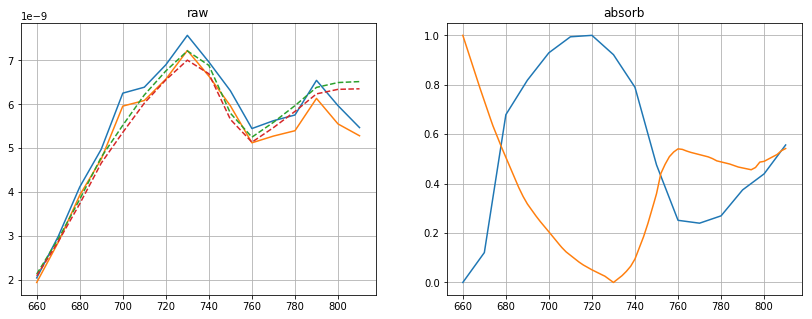

parameters: 
0.750013058186949
data/calibrated/20190527_split/IJV/20190527_split_3_2.csv
iter: 4 | loss: 3.1466214274758477


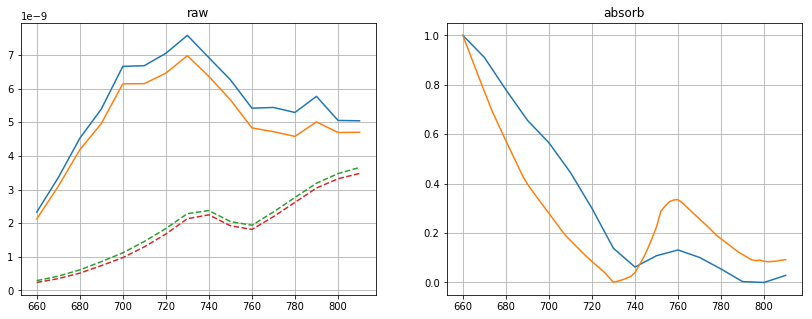

parameters: 
0.5471194811396028
iter: 13 | loss: 2.525987969292709


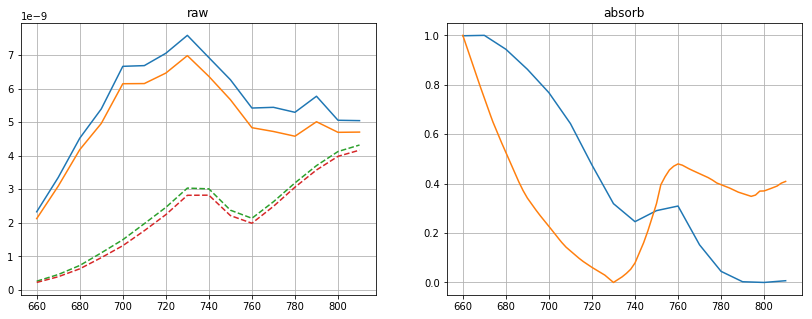

parameters: 
0.7137498737257524
iter: 14 | loss: 0.40158865725820997


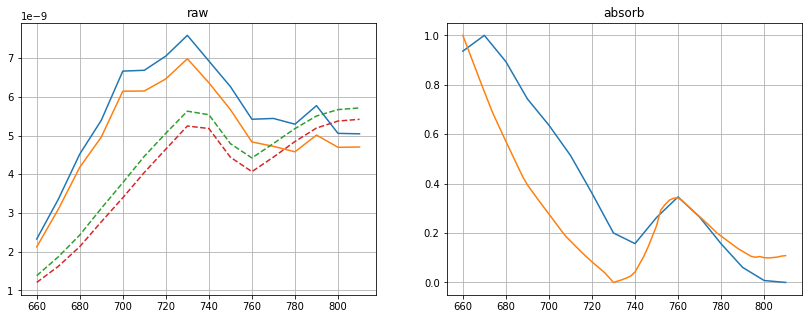

parameters: 
0.5610425452269441
iter: 58 | loss: 0.2842332930031072


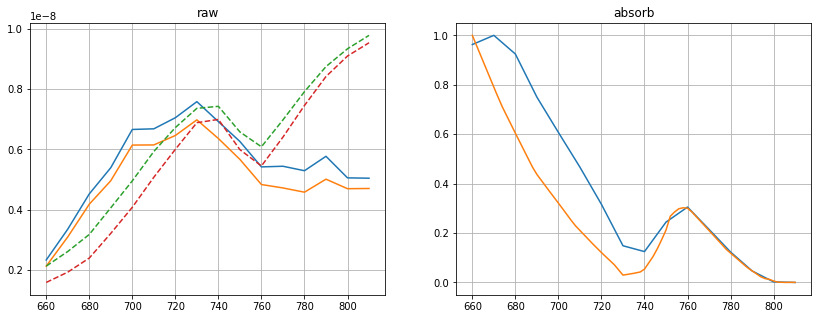

parameters: 
0.4045652062996874
iter: 188 | loss: 0.22031438140748422


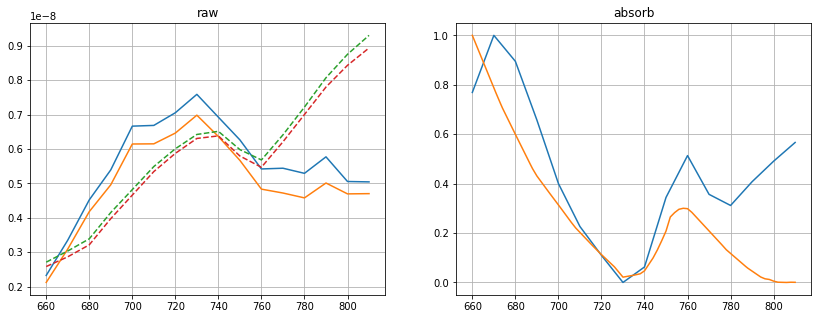

parameters: 
0.4182941853666597
iter: 202 | loss: 0.16093045443472534


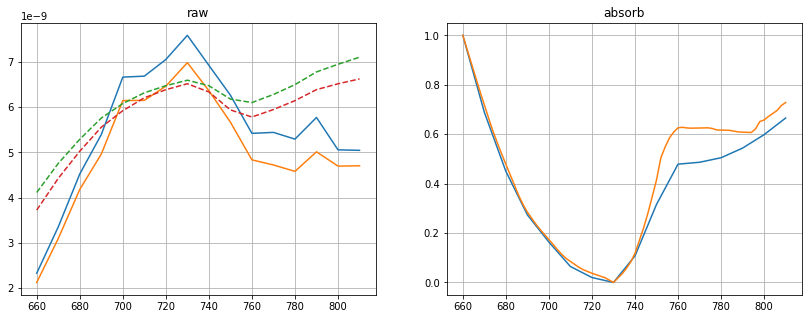

parameters: 
0.7862541006911107
iter: 404 | loss: 0.14986083798078964


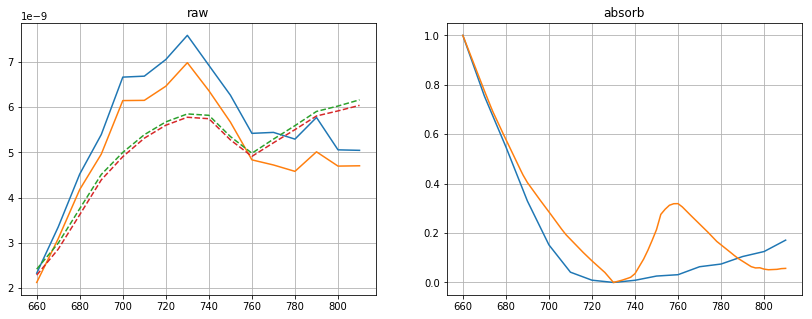

parameters: 
0.5142413302228566
iter: 1510 | loss: 0.11293091167888952


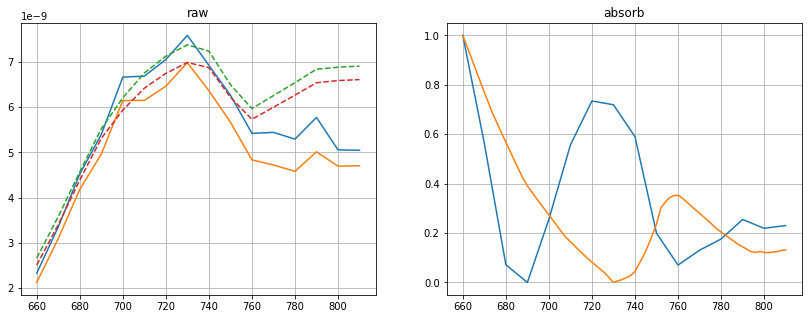

parameters: 
0.579247985149603
iter: 6425 | loss: 0.0922086335307544


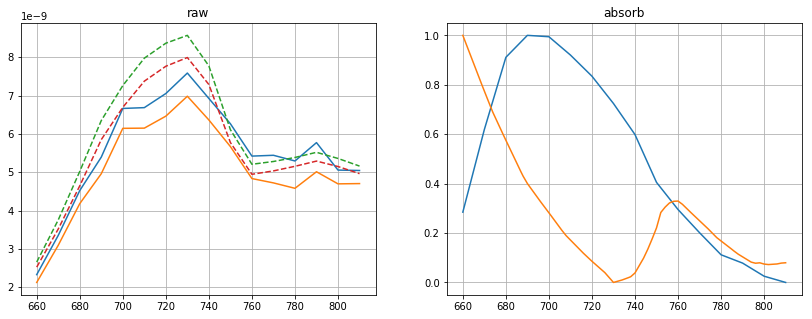

parameters: 
0.5361452900156749
data/calibrated/20190527_split/IJV/20190527_split_3_3.csv
iter: 7 | loss: 16.041040329505535


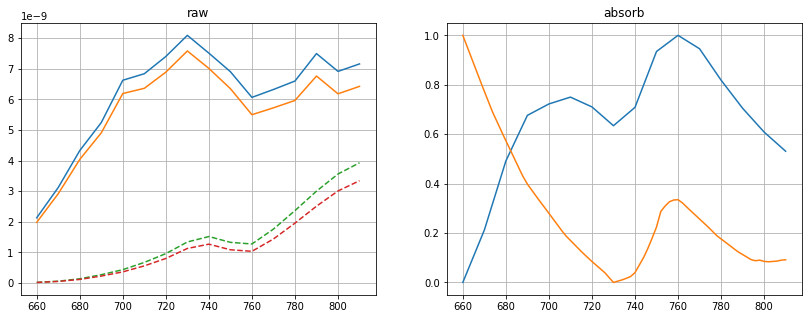

parameters: 
0.5469518083517197
iter: 9 | loss: 12.045023963119277


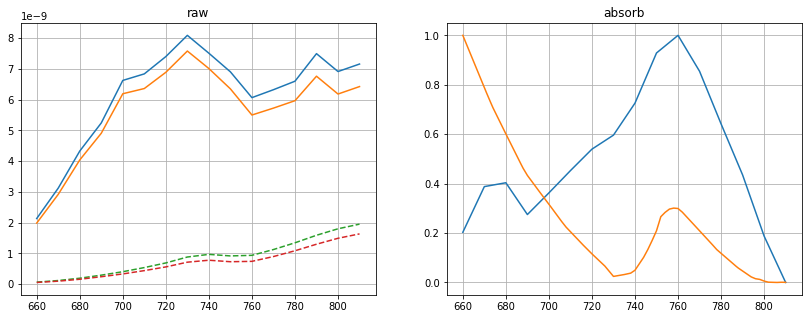

parameters: 
0.413467657598524
iter: 10 | loss: 2.033184965046568


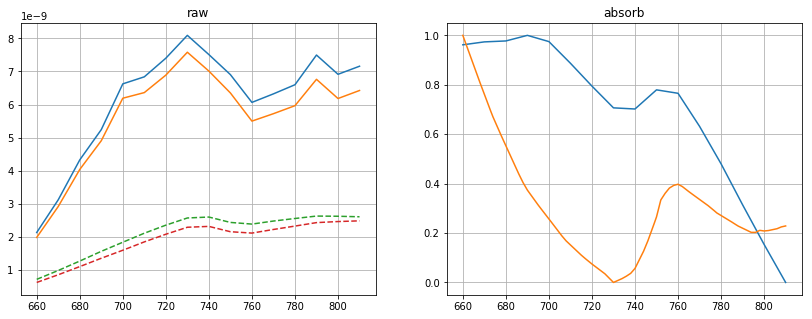

parameters: 
0.6398839579035996
iter: 13 | loss: 0.287987776155207


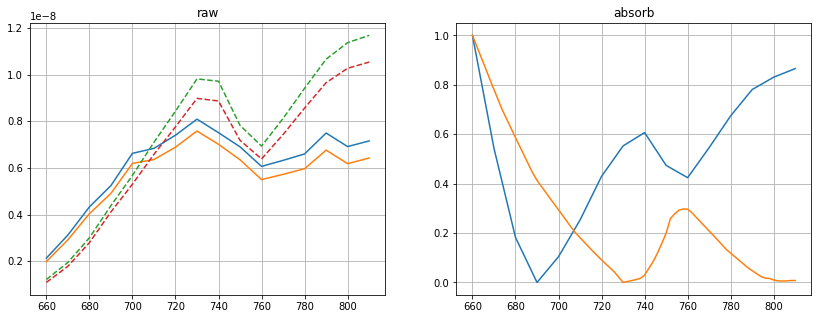

parameters: 
0.45850389436982575
iter: 87 | loss: 0.26948467481462496


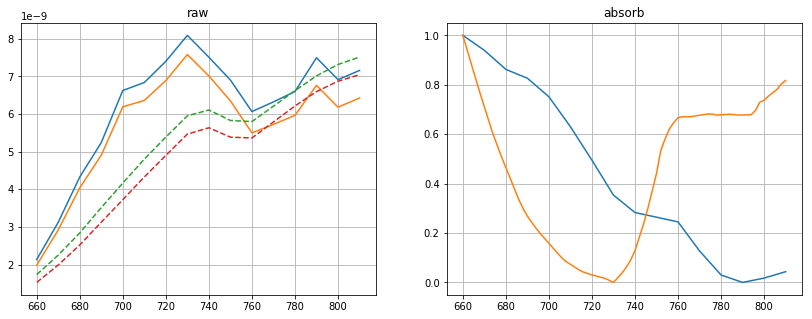

parameters: 
0.799657983821717
iter: 99 | loss: 0.257053491651239


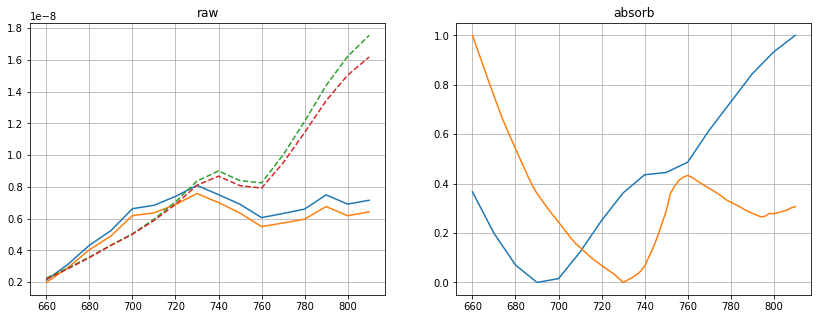

parameters: 
0.6765081643361646
iter: 132 | loss: 0.14996671803493003


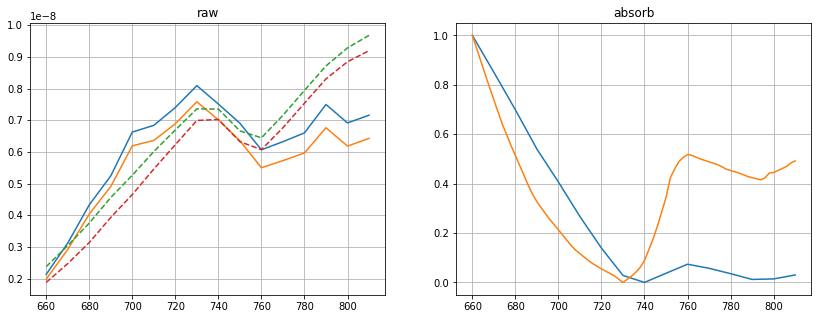

parameters: 
0.7375976698577872
iter: 359 | loss: 0.08693482610708966


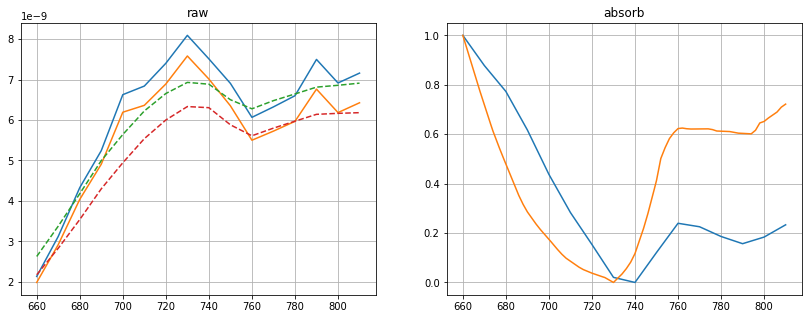

parameters: 
0.7851870791401595
iter: 1022 | loss: 0.05662724675202051


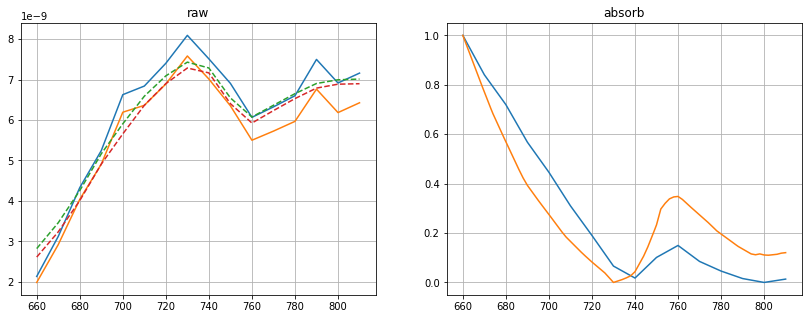

parameters: 
0.570638345952205
iter: 3361 | loss: 0.05588921003838626


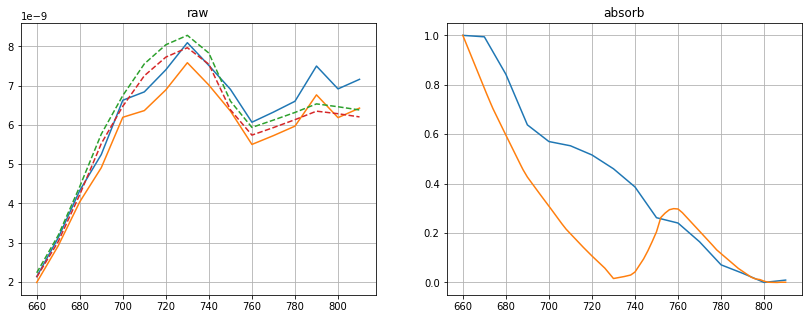

parameters: 
0.4272255081011354
data/calibrated/20190527_split/IJV/20190527_split_4_1.csv
iter: 0 | loss: 3.5939704541546034


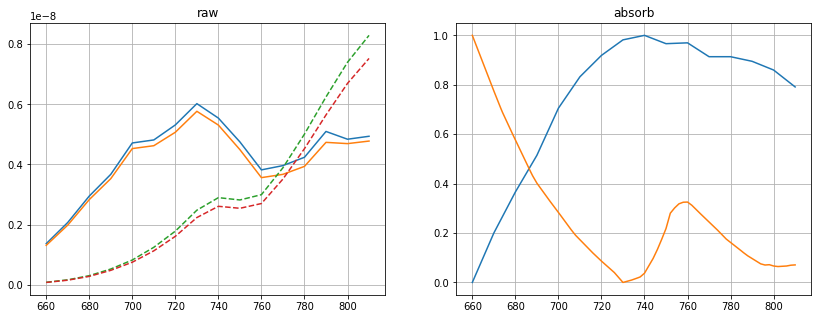

parameters: 
0.5280347633453023
iter: 7 | loss: 0.21664489697549594


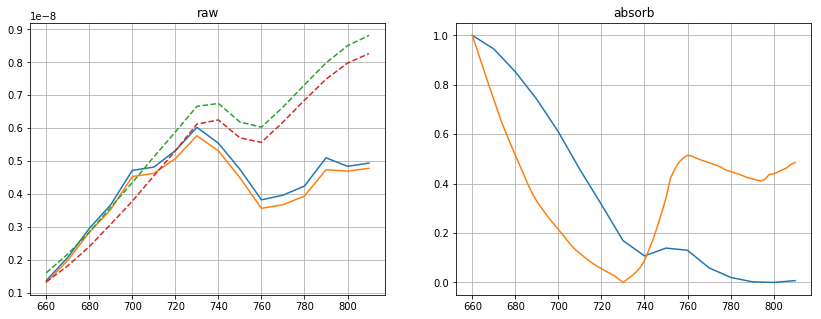

parameters: 
0.7359598440307427
iter: 74 | loss: 0.16516653819432092


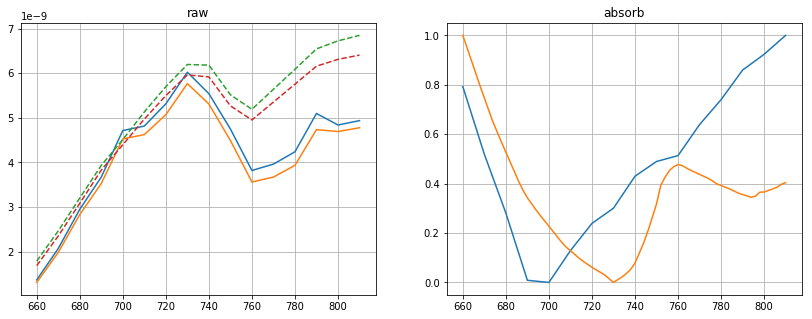

parameters: 
0.7121748529800167
iter: 212 | loss: 0.13775139978358145


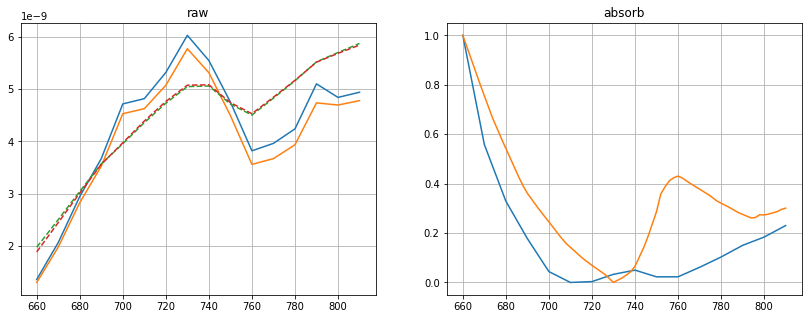

parameters: 
0.6740196572100251
iter: 674 | loss: 0.08178547745029902


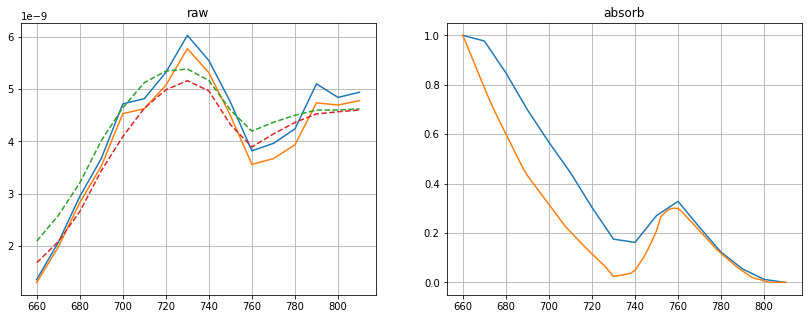

parameters: 
0.41401164122618445
data/calibrated/20190527_split/IJV/20190527_split_4_2.csv
iter: 5 | loss: 0.16598652936926733


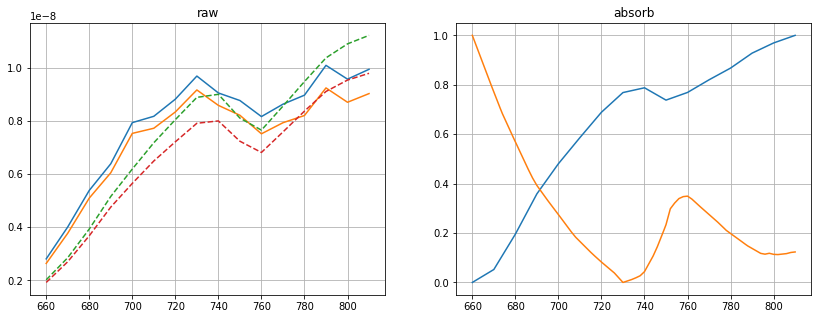

parameters: 
0.5728348773021021
iter: 77 | loss: 0.14481127457662873


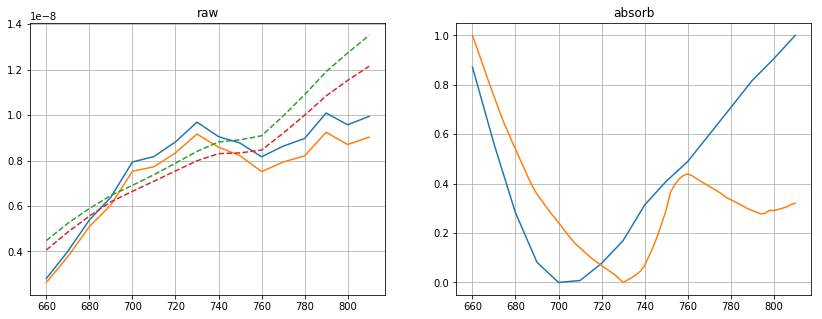

parameters: 
0.6823118978016305
iter: 84 | loss: 0.1257577053704287


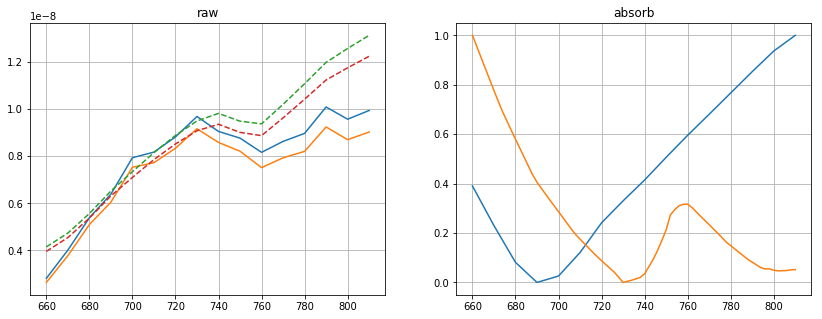

parameters: 
0.5092053149883385
iter: 352 | loss: 0.10862984909697124


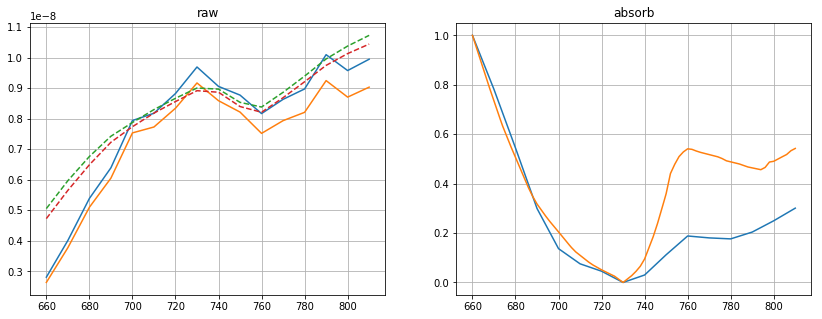

parameters: 
0.7500824733033458
iter: 536 | loss: 0.09911261195680676


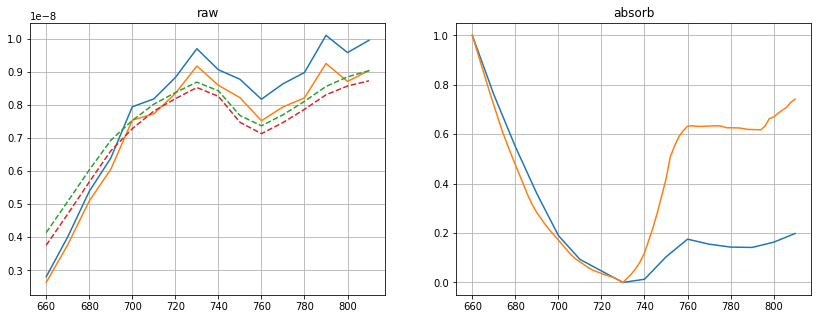

parameters: 
0.7884072077440557
iter: 1823 | loss: 0.0887177886163407


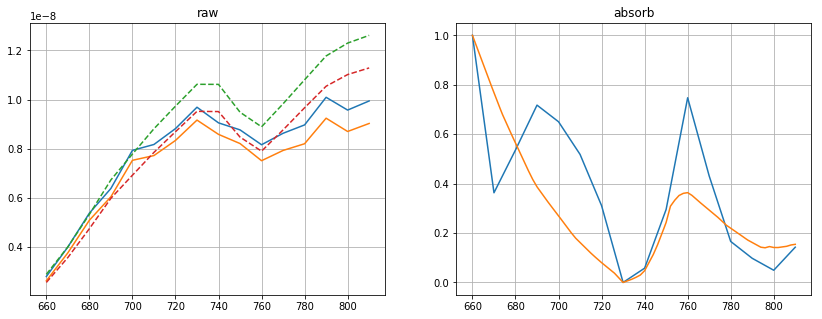

parameters: 
0.5951824292247986
iter: 2632 | loss: 0.07689976926735526


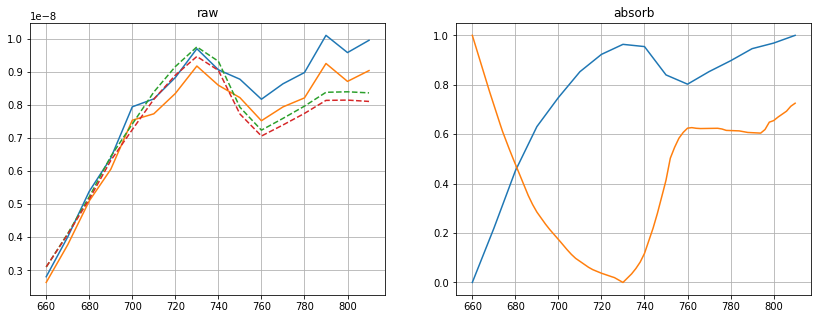

parameters: 
0.7857848591356246
iter: 4674 | loss: 0.07237963725239313


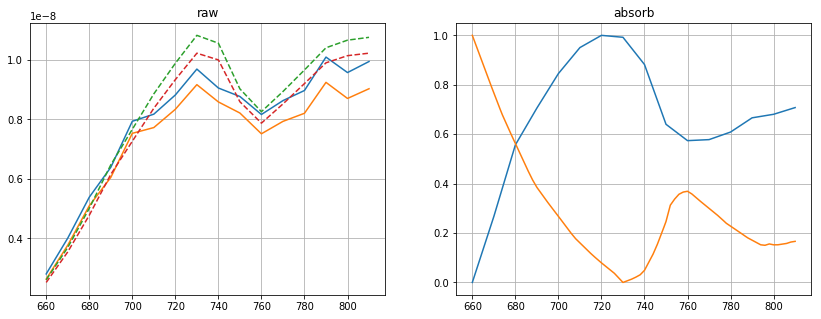

parameters: 
0.603225168034631
iter: 4769 | loss: 0.05486797874038859


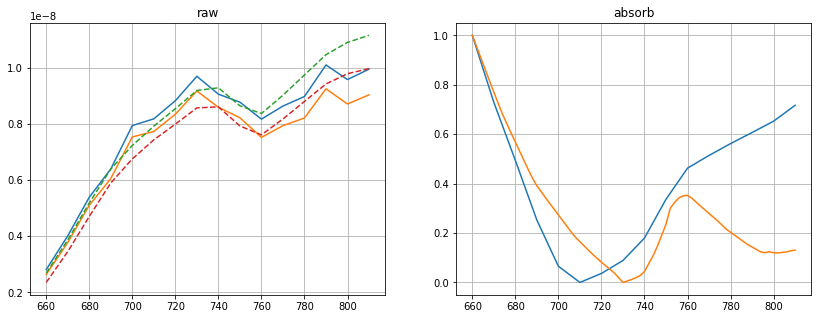

parameters: 
0.5782855046291427
data/calibrated/20190527_split/IJV/20190527_split_4_3.csv
iter: 1 | loss: 5.610785314301635


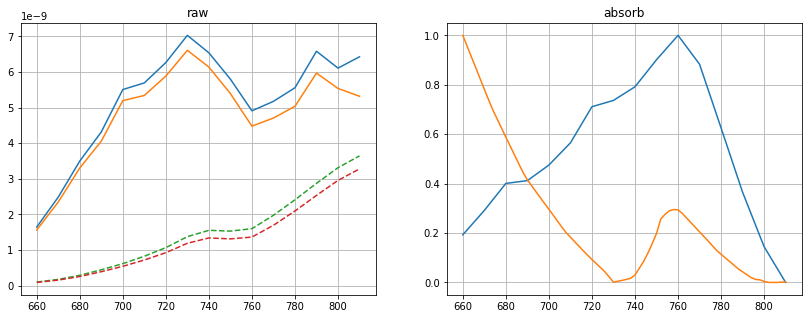

parameters: 
0.4486257380579451
iter: 11 | loss: 0.30289895032213177


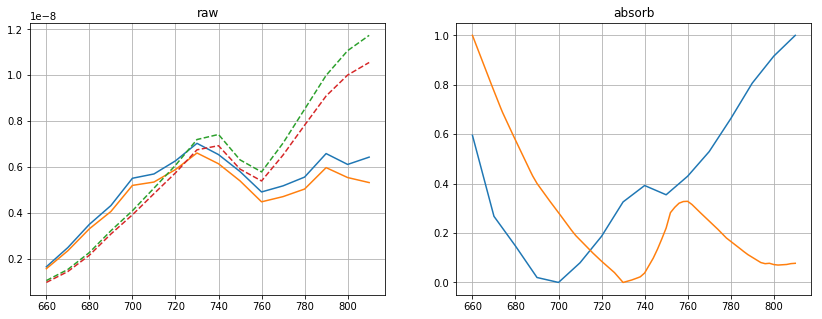

parameters: 
0.5341374733667519
iter: 43 | loss: 0.1838074550839004


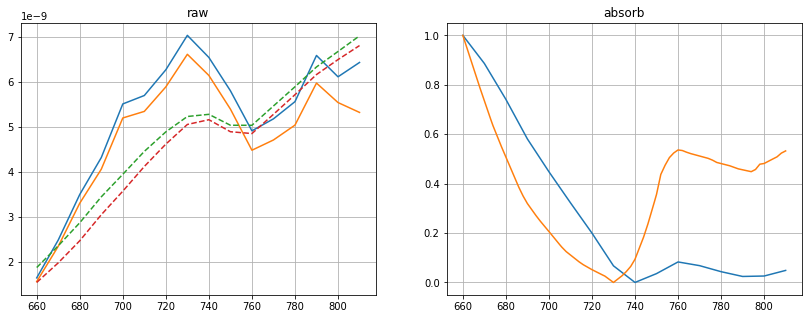

parameters: 
0.7477370428352748
iter: 251 | loss: 0.1369066074883488


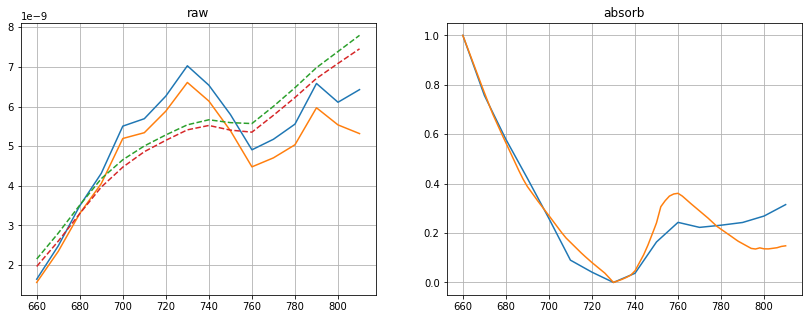

parameters: 
0.5910292996519746
iter: 311 | loss: 0.12022252515539474


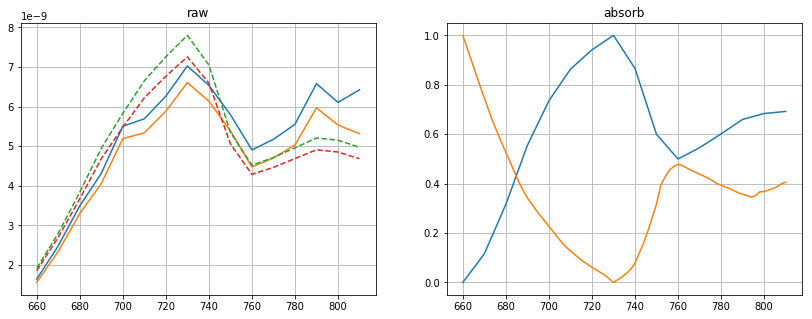

parameters: 
0.7127478135694132
iter: 541 | loss: 0.0983567120923485


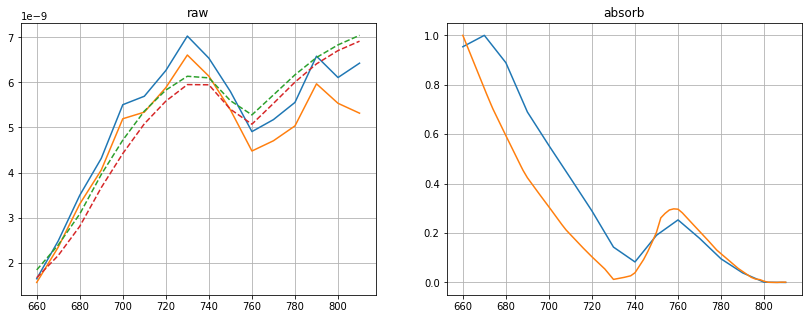

parameters: 
0.4325992981768097
iter: 562 | loss: 0.0743254243336096


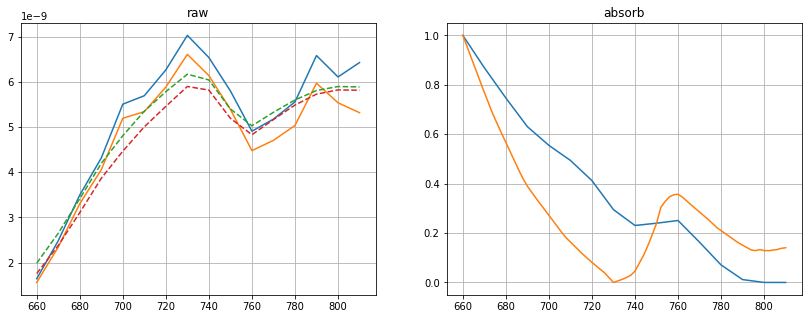

parameters: 
0.5854760002596334
iter: 6422 | loss: 0.061390360866904845


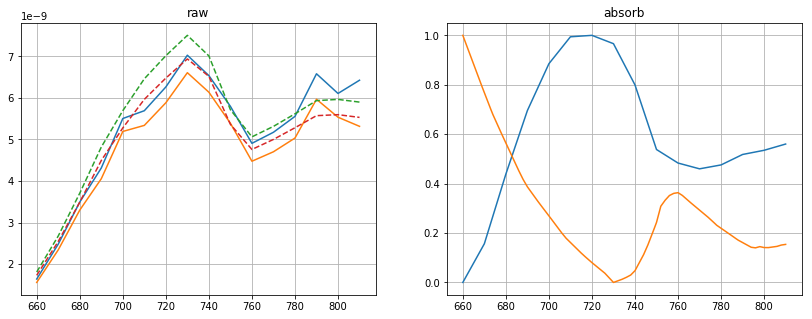

parameters: 
0.5949760983571009
data/calibrated/20190527_split/IJV/20190527_split_5_1.csv
iter: 4 | loss: 4.274670626606078


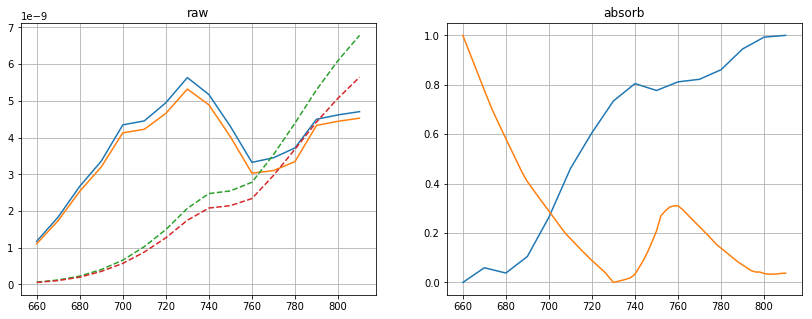

parameters: 
0.493520274205349
iter: 8 | loss: 1.9530553948888631


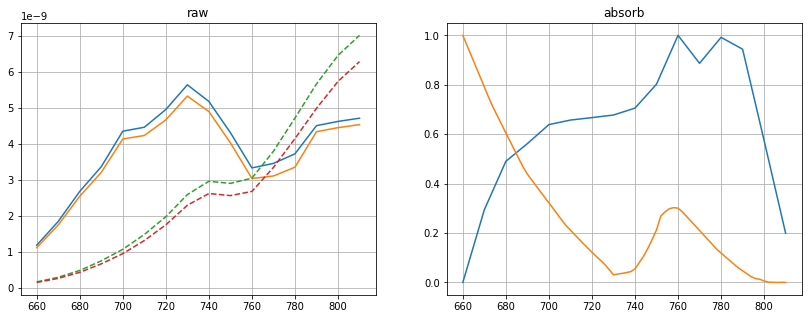

parameters: 
0.4022538608712999
iter: 16 | loss: 0.573746685192021


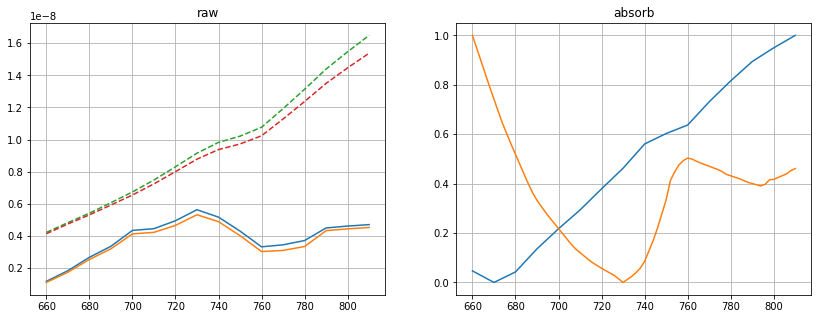

parameters: 
0.7292433117178294
iter: 18 | loss: 0.3662371488889875


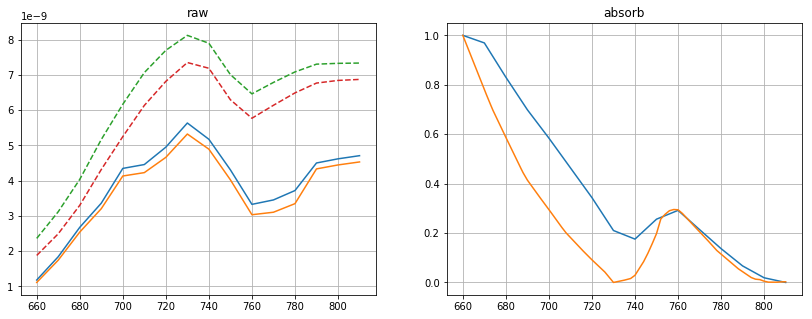

parameters: 
0.45166863296422743
iter: 21 | loss: 0.3360150446034975


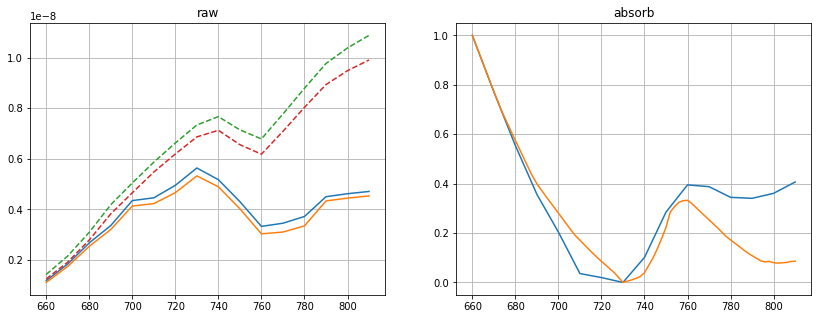

parameters: 
0.5419093214877707
iter: 32 | loss: 0.12773512788501462


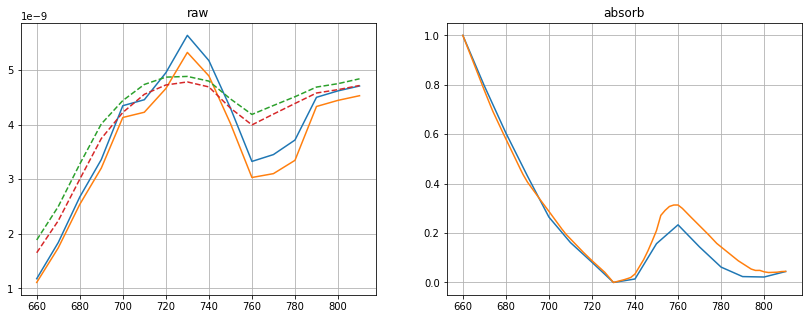

parameters: 
0.5016556497792017
iter: 362 | loss: 0.11825526389472293


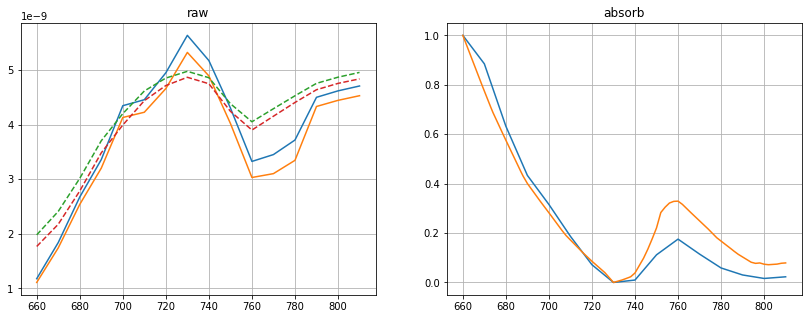

parameters: 
0.5355393511451002
iter: 767 | loss: 0.10931226583096007


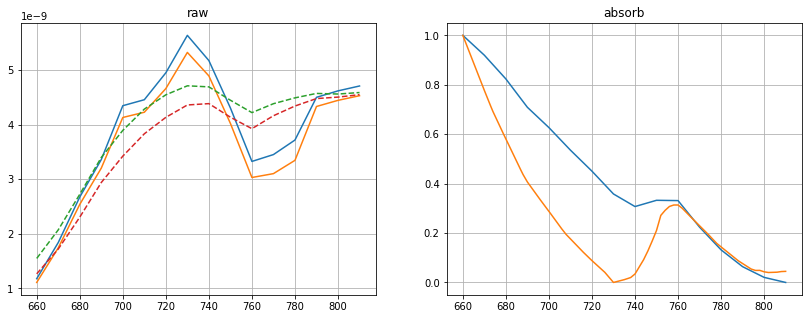

parameters: 
0.5017108236738621
iter: 4326 | loss: 0.10731037307478423


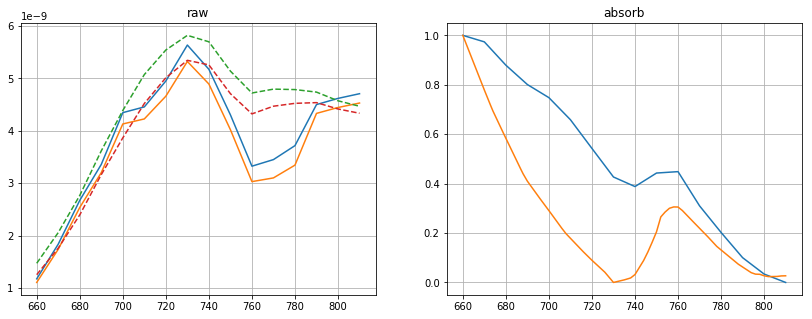

parameters: 
0.4816675561095598
iter: 6538 | loss: 0.09105149220247667


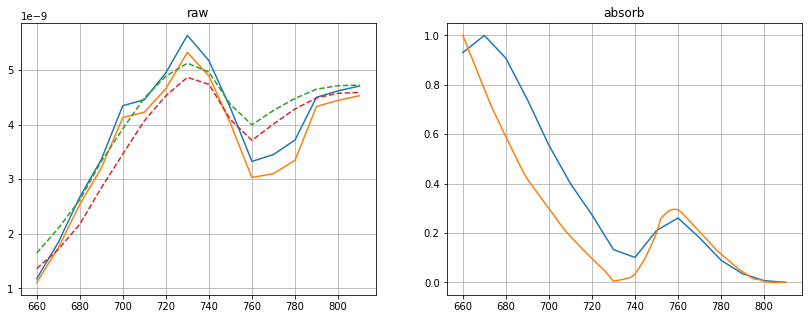

parameters: 
0.443369938283247
iter: 7443 | loss: 0.08825916863454453


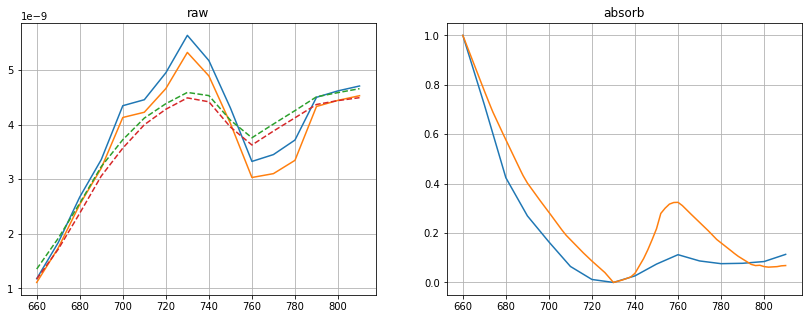

parameters: 
0.5255361442773037
data/calibrated/20190527_split/IJV/20190527_split_5_2.csv
iter: 1 | loss: 5.808370088927088


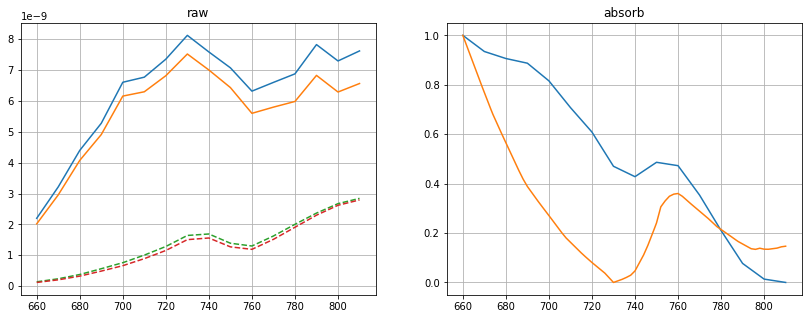

parameters: 
0.5898956311834332
iter: 2 | loss: 0.6753155579830876


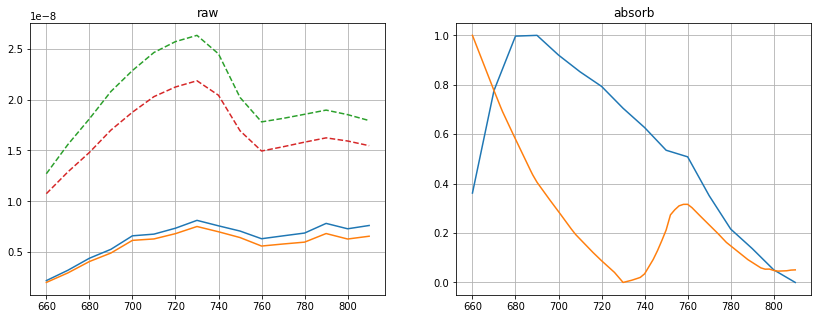

parameters: 
0.5080515717751233
iter: 40 | loss: 0.6110065376773347


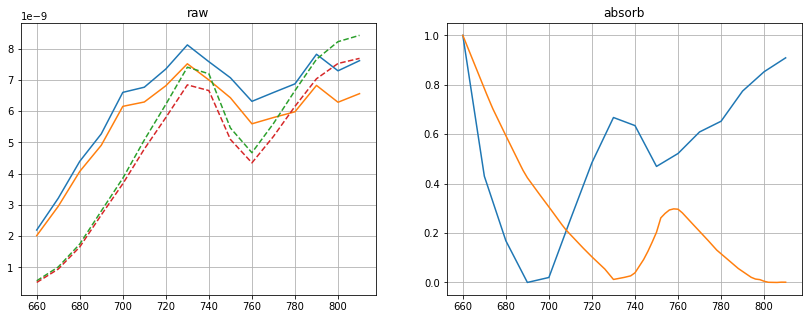

parameters: 
0.432937764712583
iter: 51 | loss: 0.21155030861935942


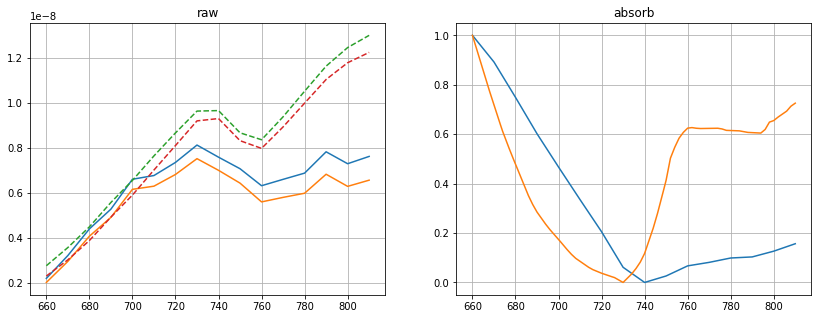

parameters: 
0.7858205063190269
iter: 82 | loss: 0.12367051962998106


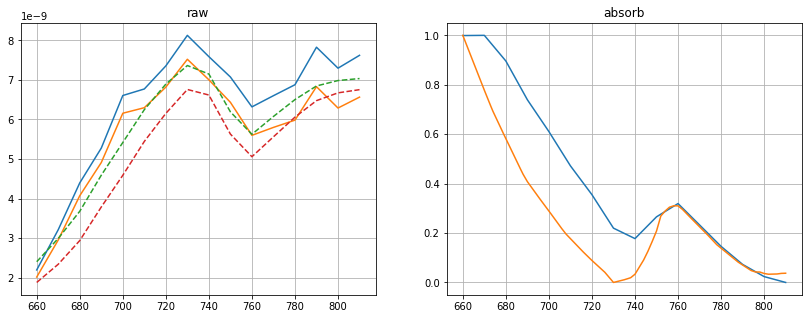

parameters: 
0.49350016936848373
iter: 434 | loss: 0.08158863080244236


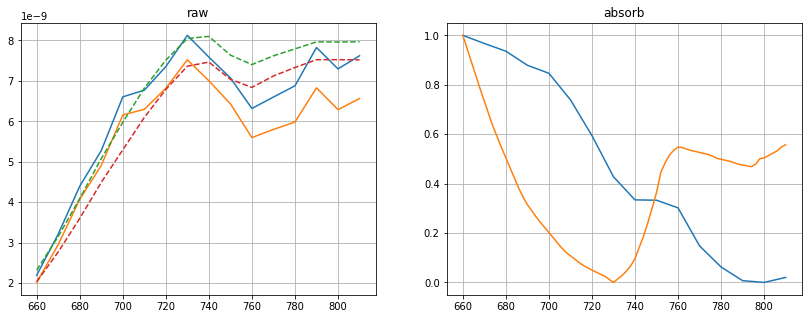

parameters: 
0.753533619403932
iter: 436 | loss: 0.06562983452455858


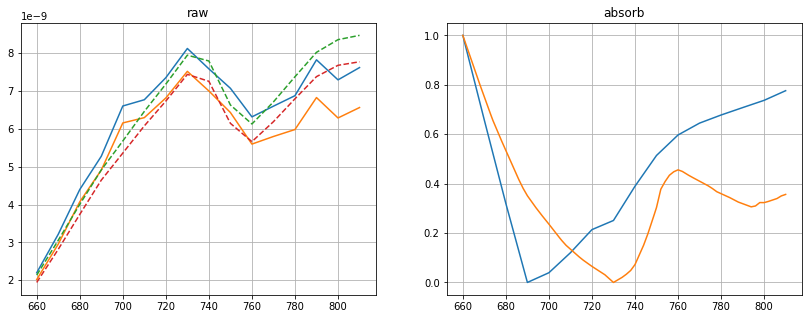

parameters: 
0.6958768720191035
data/calibrated/20190527_split/IJV/20190527_split_5_3.csv
iter: 4 | loss: 0.7638928847880857


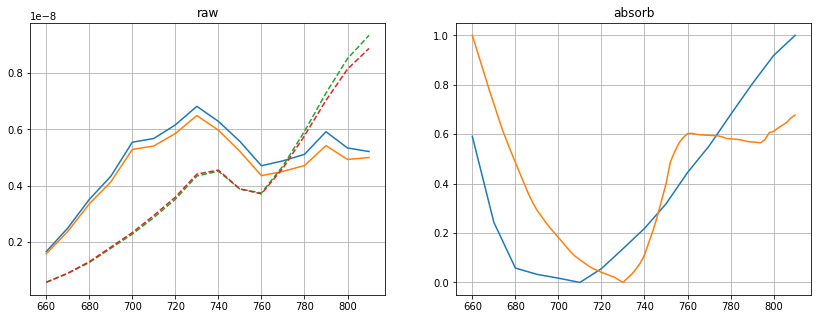

parameters: 
0.7775643528077374
iter: 8 | loss: 0.5045102678458436


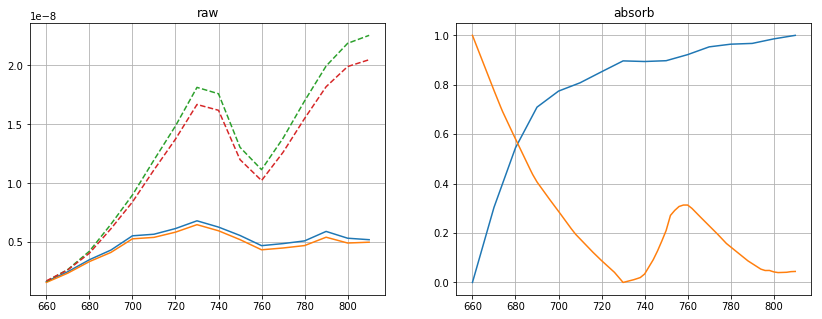

parameters: 
0.5013348476784752
iter: 54 | loss: 0.34537158309617877


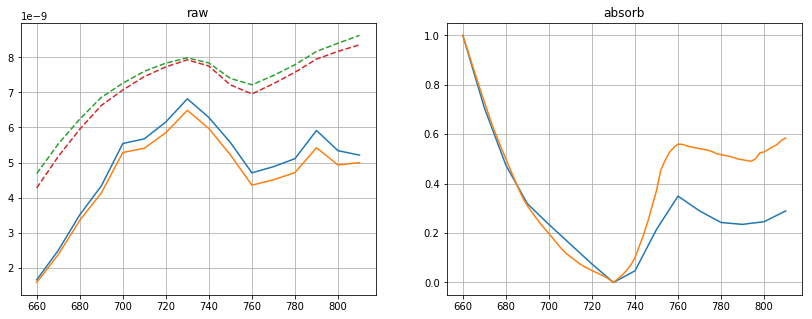

parameters: 
0.7594789216282465
iter: 95 | loss: 0.2112742796778559


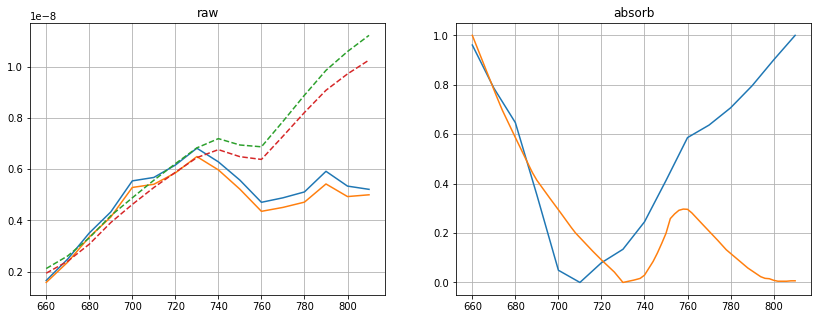

parameters: 
0.4569656283205502
iter: 153 | loss: 0.18436826441657123


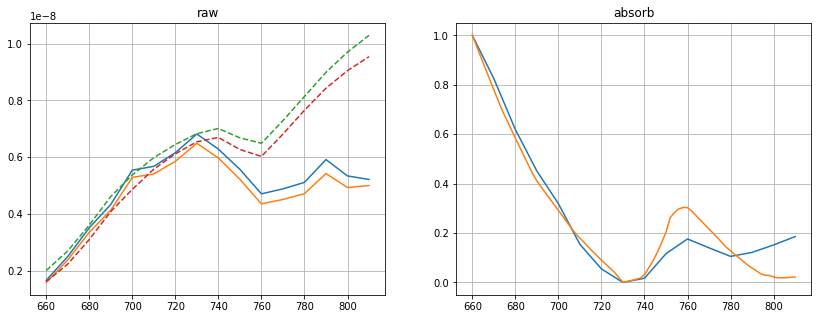

parameters: 
0.4754098061103478
iter: 472 | loss: 0.15501495499420867


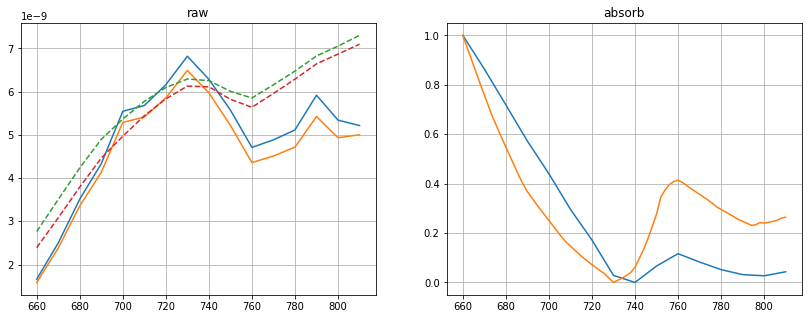

parameters: 
0.6577236627120231
iter: 477 | loss: 0.14719864605171273


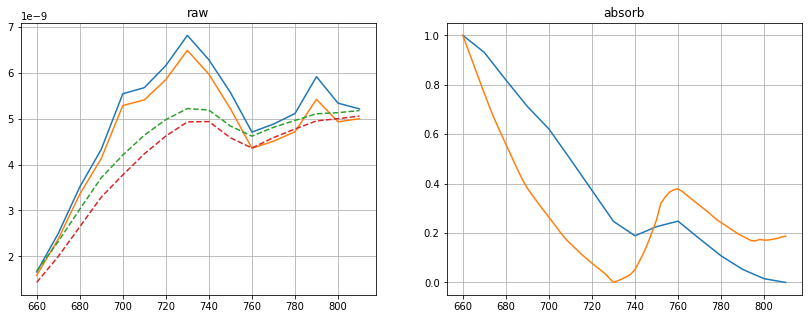

parameters: 
0.6164082843192652
iter: 589 | loss: 0.13227597479134223


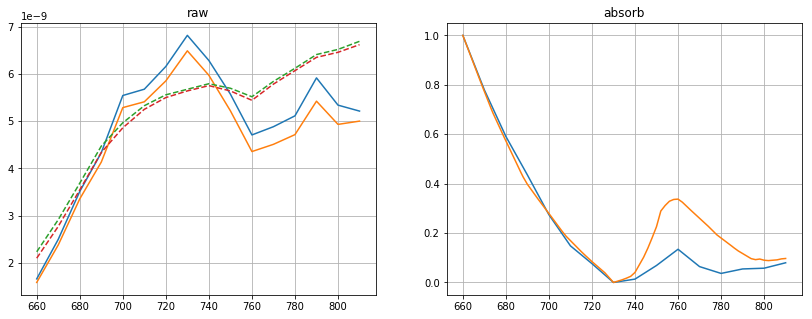

parameters: 
0.5514500787526788
iter: 847 | loss: 0.09627153888372113


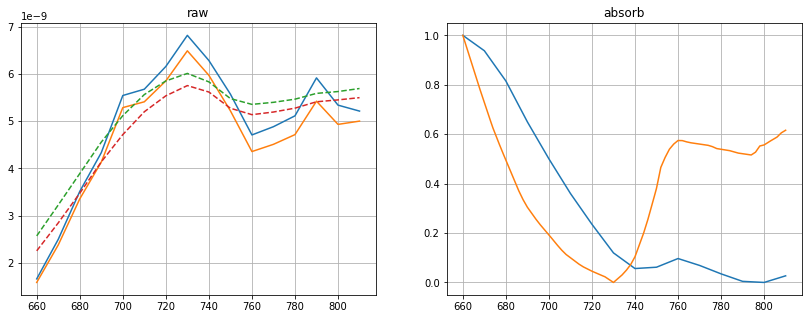

parameters: 
0.7660017890597414
iter: 1915 | loss: 0.06720535742287978


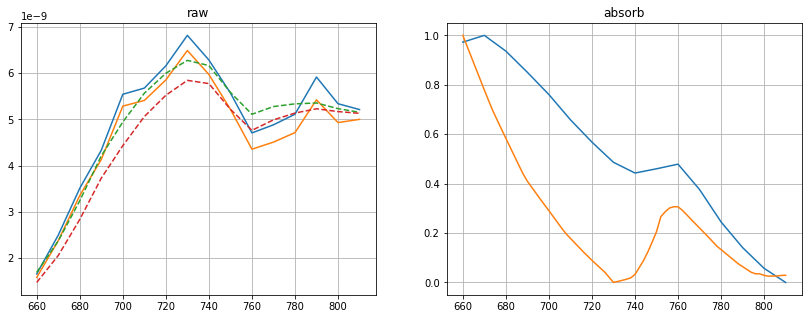

parameters: 
0.4839745888587628
iter: 5016 | loss: 0.056720430494759576


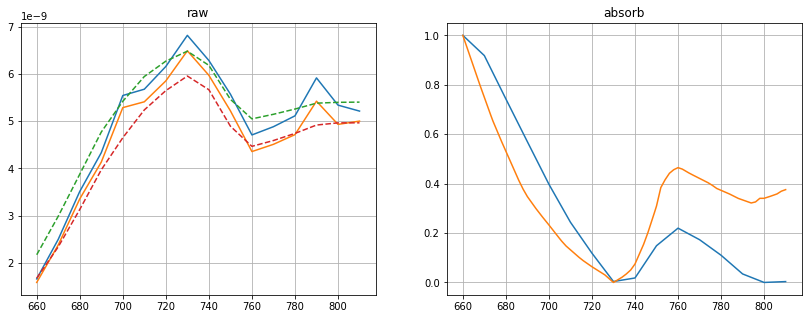

parameters: 
0.7027514294845648
data/calibrated/20190527_split/IJV/20190527_split_6_1.csv
iter: 3 | loss: 2.1382191525658065


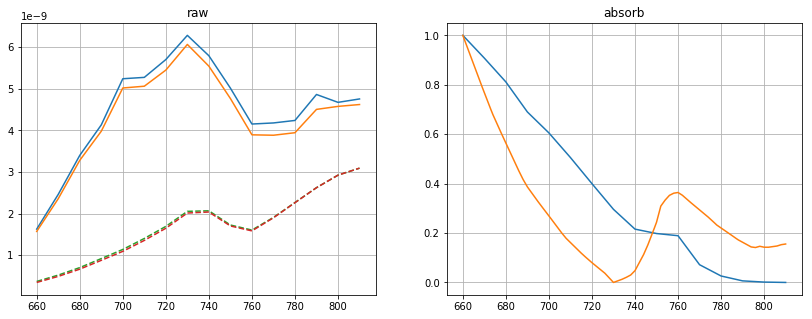

parameters: 
0.5960506281408507
iter: 4 | loss: 1.54655178383611


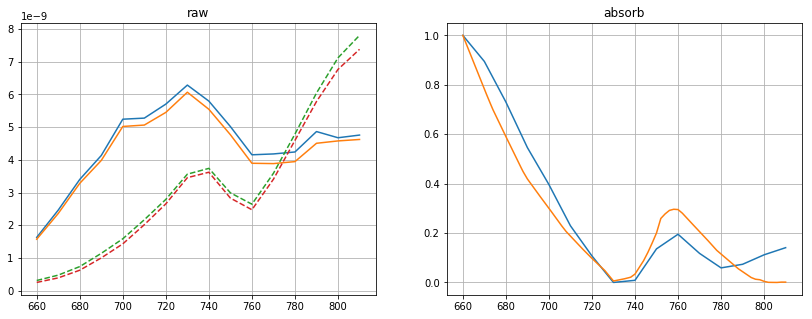

parameters: 
0.44205242430227926
iter: 10 | loss: 0.6503824217455119


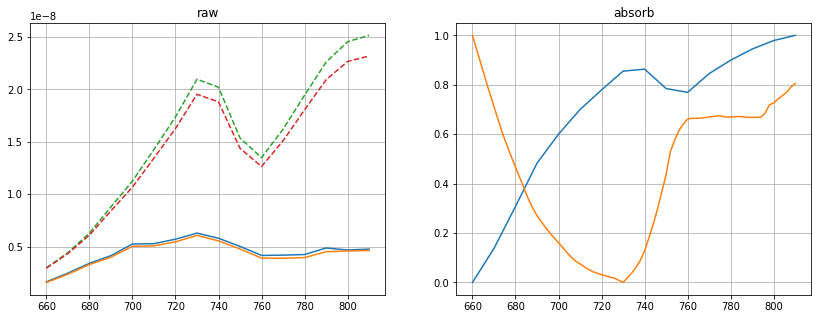

parameters: 
0.7979075210013976
iter: 16 | loss: 0.6220662118286542


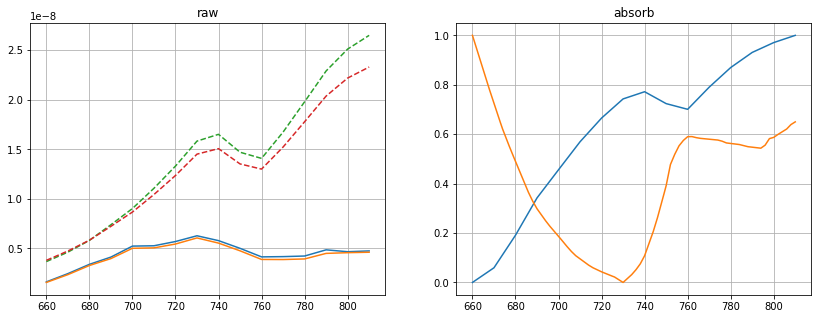

parameters: 
0.7725896753100226
iter: 37 | loss: 0.5521489701465496


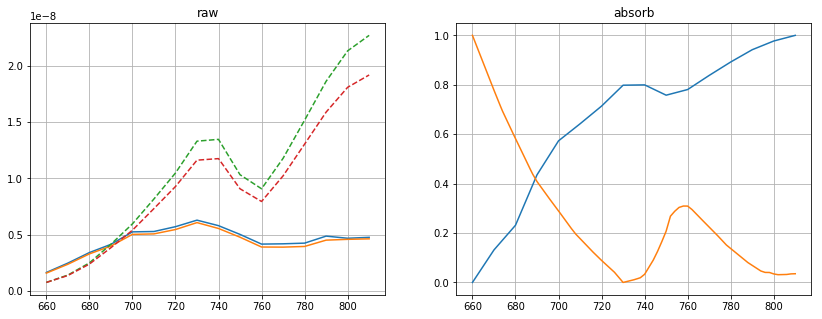

parameters: 
0.4912183260564035
iter: 39 | loss: 0.4688370725480831


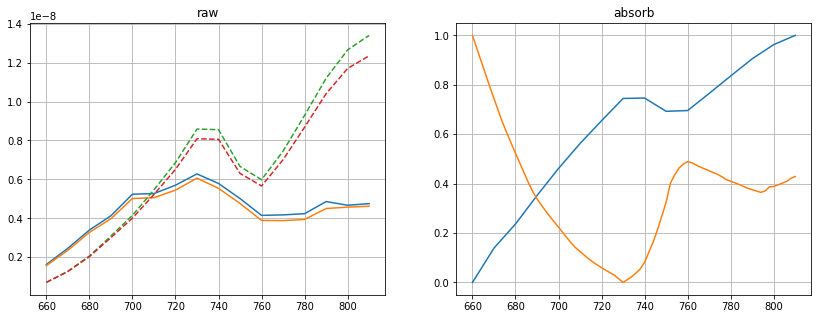

parameters: 
0.7199245454304928
iter: 57 | loss: 0.24037099270878953


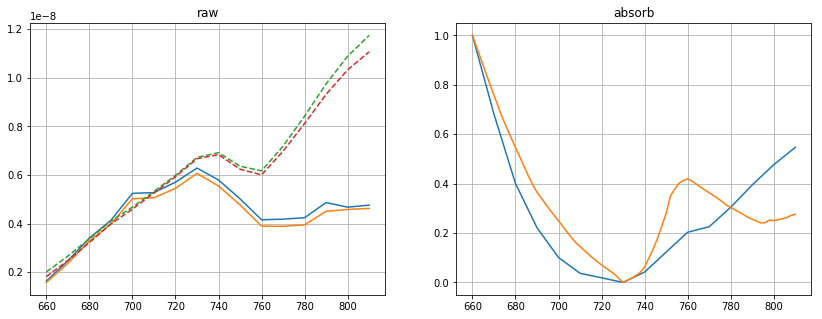

parameters: 
0.663003769137295
iter: 81 | loss: 0.1656440807914683


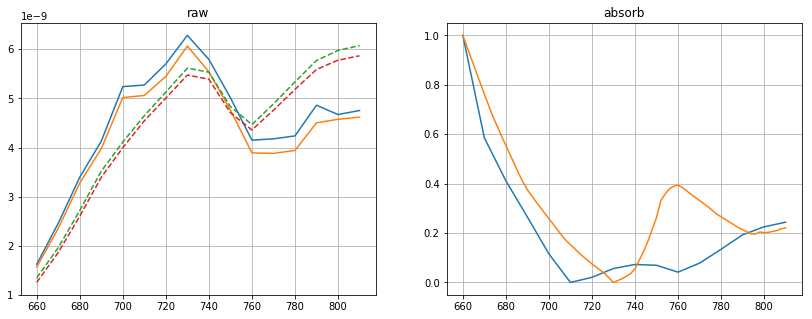

parameters: 
0.635787778339313
iter: 118 | loss: 0.12633918431279634


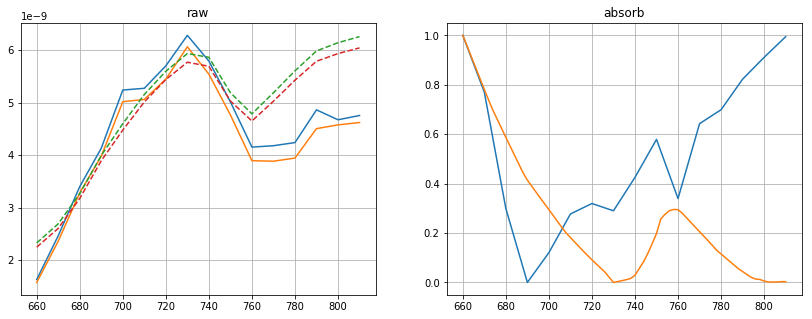

parameters: 
0.4526291485076506
iter: 1149 | loss: 0.10066464730924335


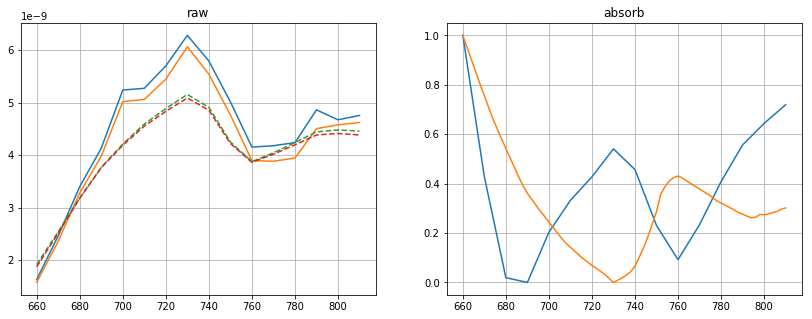

parameters: 
0.6744054874370138
iter: 9086 | loss: 0.09636248731432612


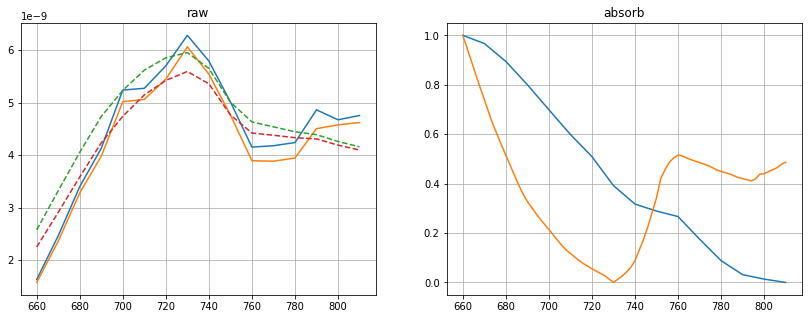

parameters: 
0.7362365533317234
data/calibrated/20190527_split/IJV/20190527_split_6_2.csv
iter: 8 | loss: 1.1620518139647462


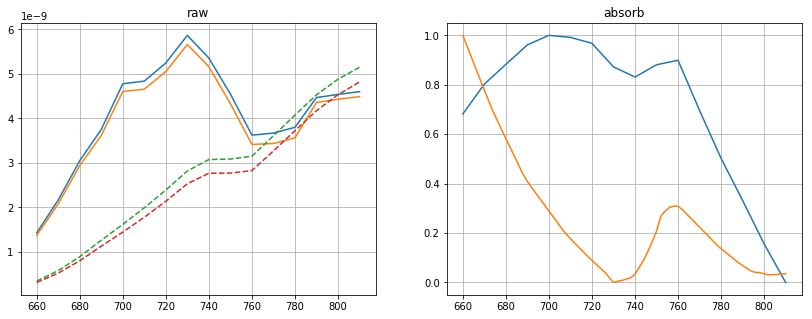

parameters: 
0.4909151497914031
iter: 24 | loss: 0.35835447769901807


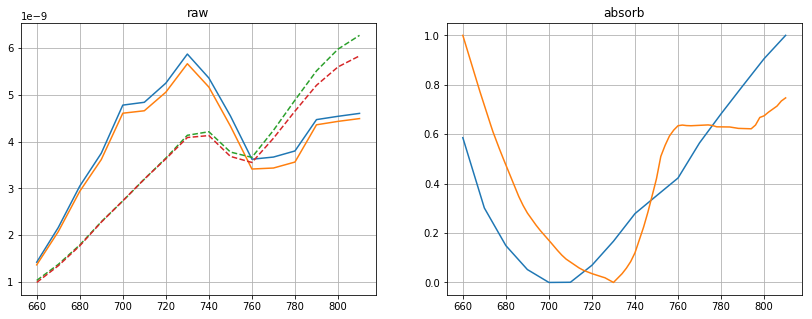

parameters: 
0.7892444792846554
iter: 34 | loss: 0.23176707060791385


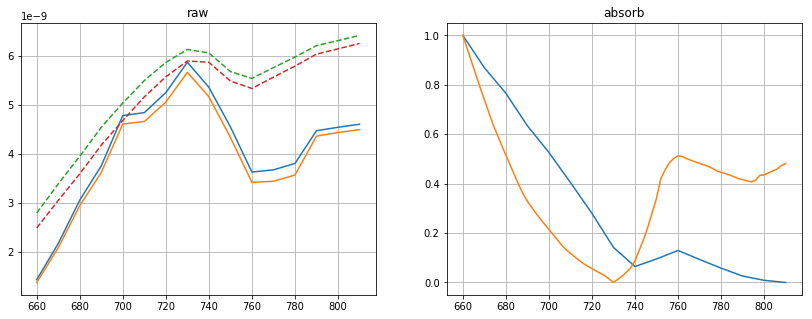

parameters: 
0.7348137566422377
iter: 68 | loss: 0.22202198520060995


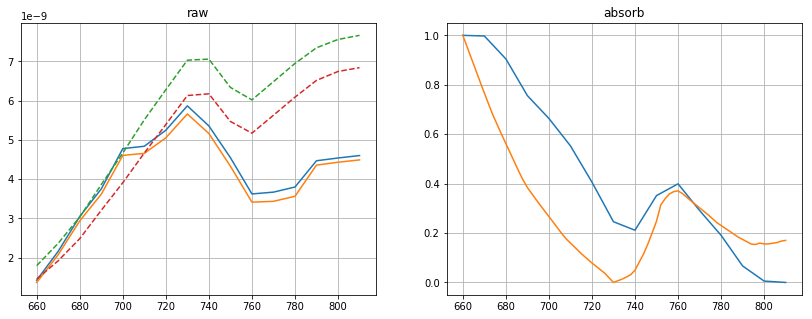

parameters: 
0.6057638045275247
iter: 114 | loss: 0.11899405430620166


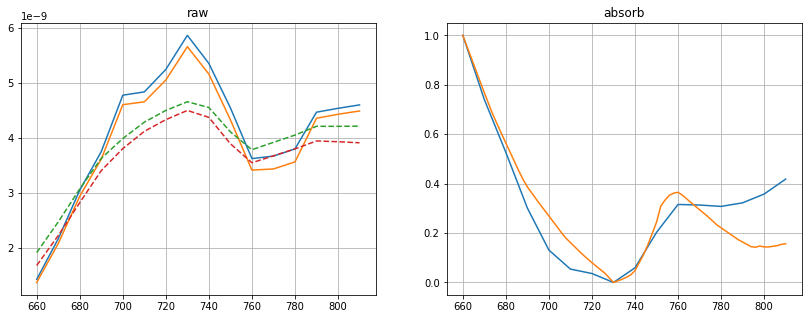

parameters: 
0.5968956469643009
iter: 655 | loss: 0.08261698104656369


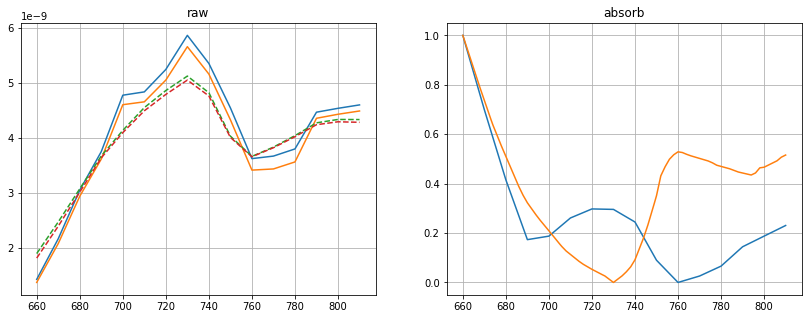

parameters: 
0.7436789712955645
iter: 9594 | loss: 0.0785780991574601


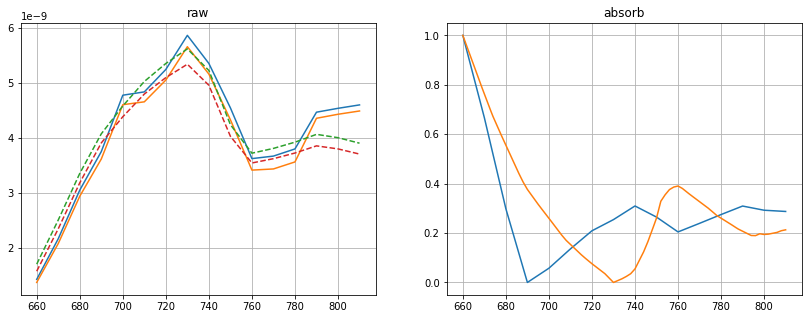

parameters: 
0.6313814230238123
data/calibrated/20190527_split/IJV/20190527_split_6_3.csv
iter: 2 | loss: 1.4845961644743007


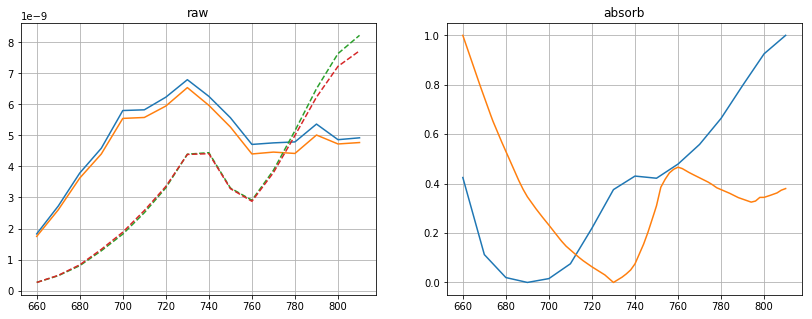

parameters: 
0.7042233118455445
iter: 41 | loss: 0.2561209835122853


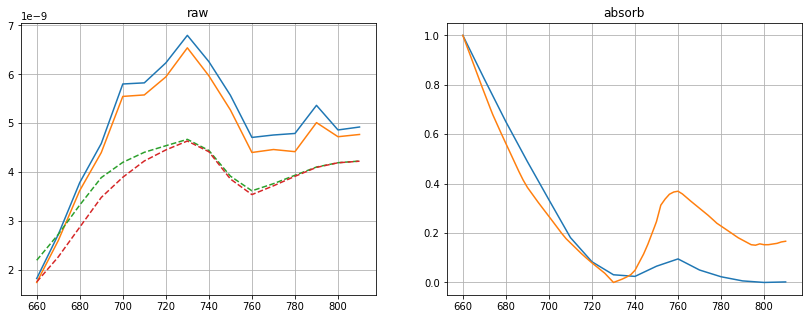

parameters: 
0.6034998621976825
iter: 74 | loss: 0.13994161420221107


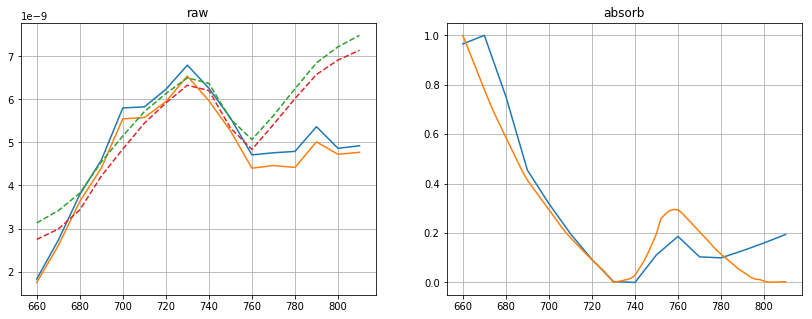

parameters: 
0.4517449915209637
iter: 708 | loss: 0.12288122688640692


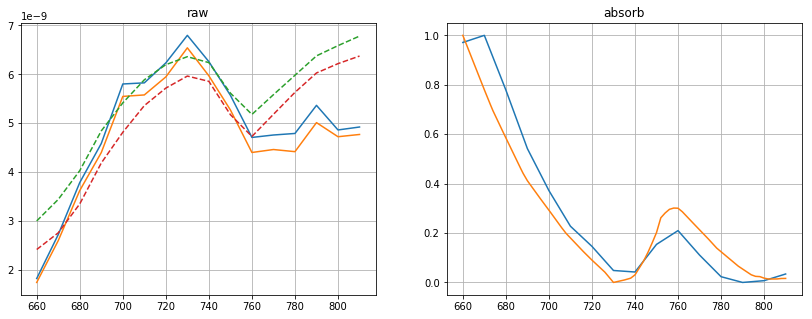

parameters: 
0.46904471559750927
iter: 3105 | loss: 0.08970968429381973


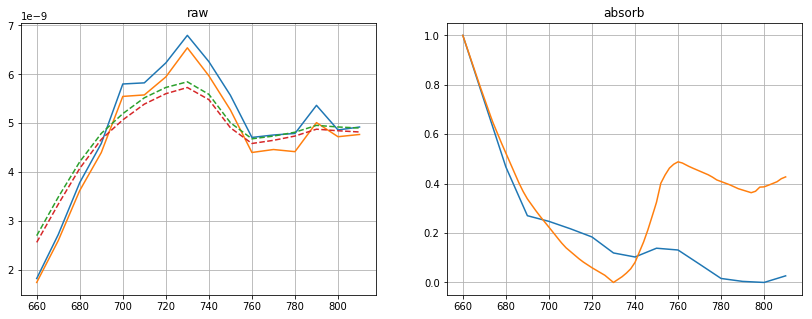

parameters: 
0.719440552211515
iter: 4203 | loss: 0.07127298231414986


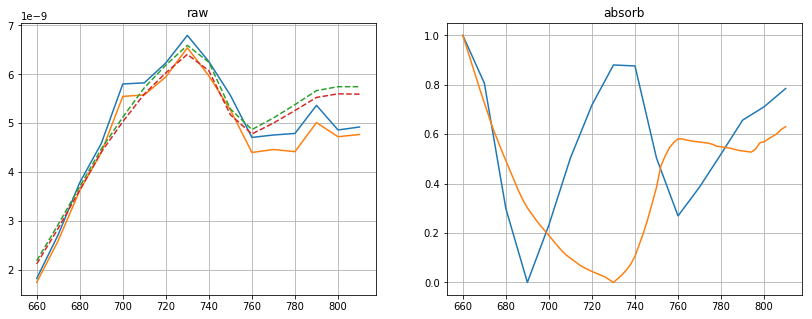

parameters: 
0.7688419226709913
iter: 7495 | loss: 0.070896021143553


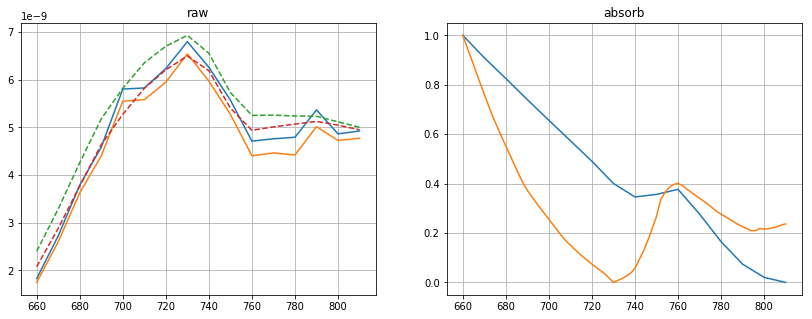

parameters: 
0.6441609928492169
data/calibrated/20190527_split/IJV/20190527_split_7_1.csv
iter: 5 | loss: 61.81471884876714


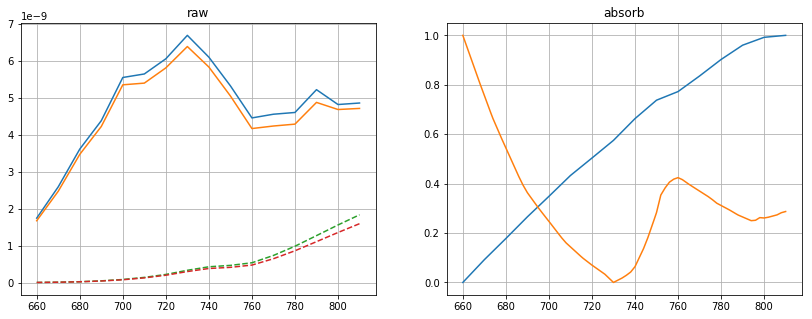

parameters: 
0.6681430415883318
iter: 10 | loss: 5.523849838202507


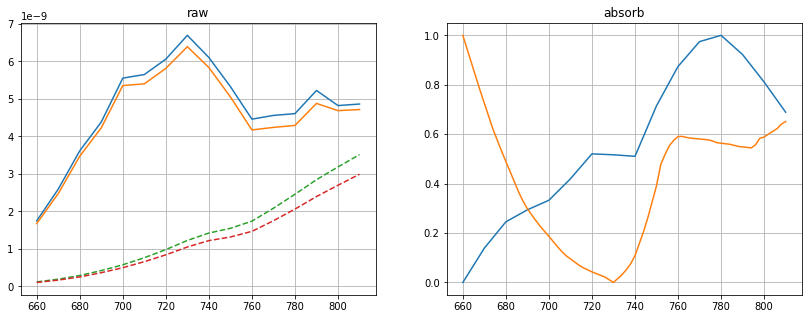

parameters: 
0.7728562359942212
iter: 12 | loss: 0.797057383064754


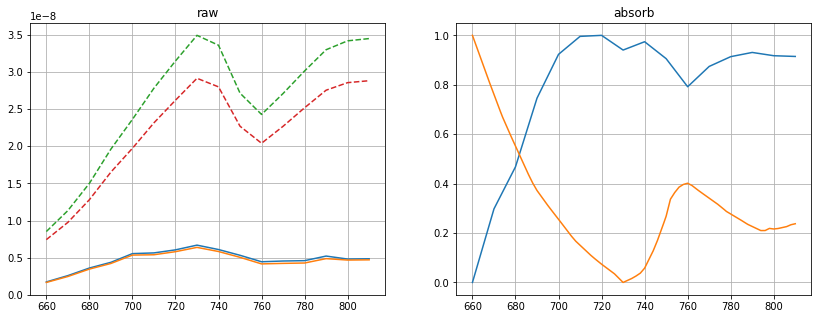

parameters: 
0.6445415299148146
iter: 17 | loss: 0.43485756214801674


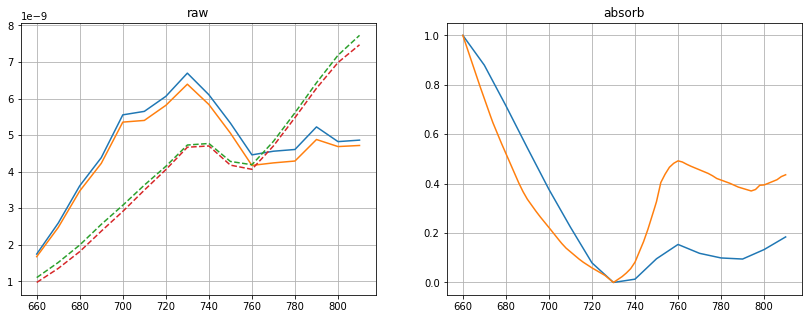

parameters: 
0.7220269720429785
iter: 35 | loss: 0.33823805002503193


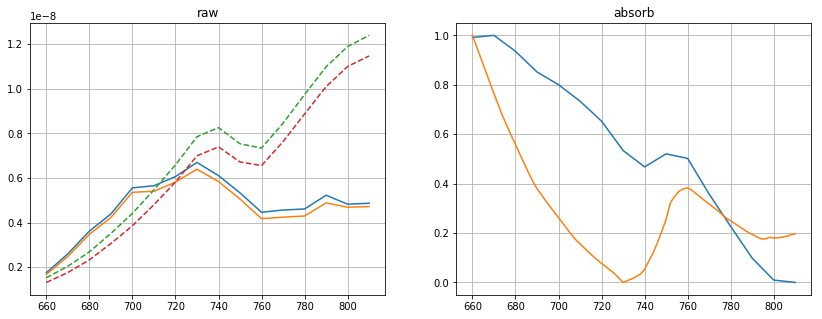

parameters: 
0.6220202788851584
iter: 43 | loss: 0.3086289016078392


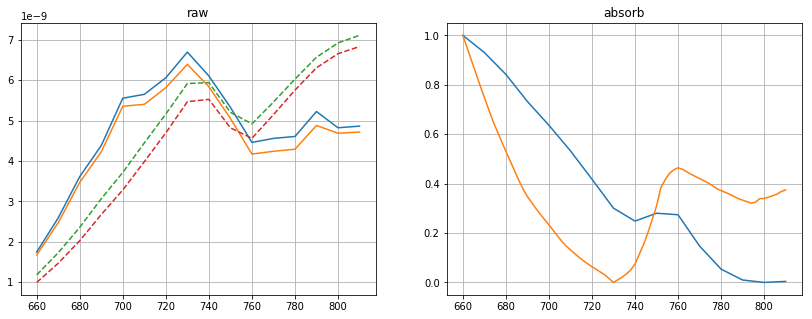

parameters: 
0.7024000125857087
iter: 50 | loss: 0.2317163507620699


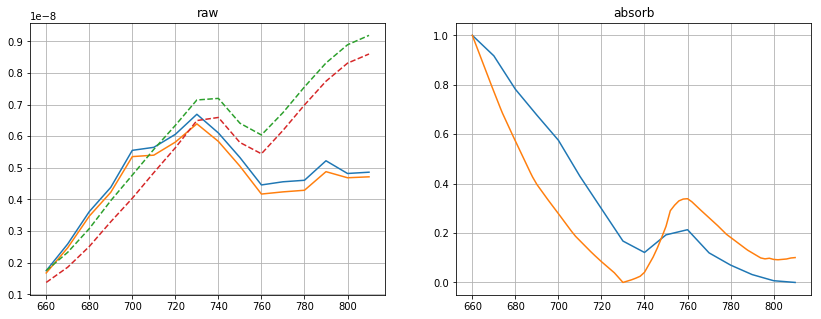

parameters: 
0.5545526278177979
iter: 63 | loss: 0.21505251931924219


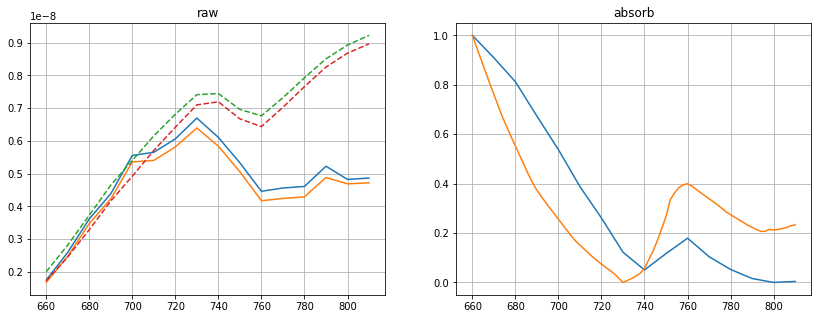

parameters: 
0.6423797665755588
iter: 105 | loss: 0.19482605145186369


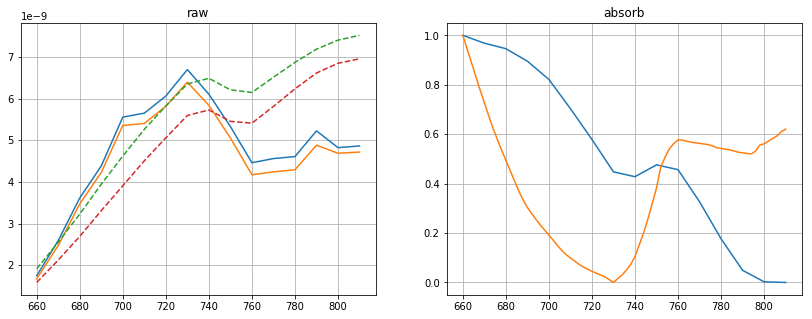

parameters: 
0.7669563578622448
iter: 196 | loss: 0.15549634905760606


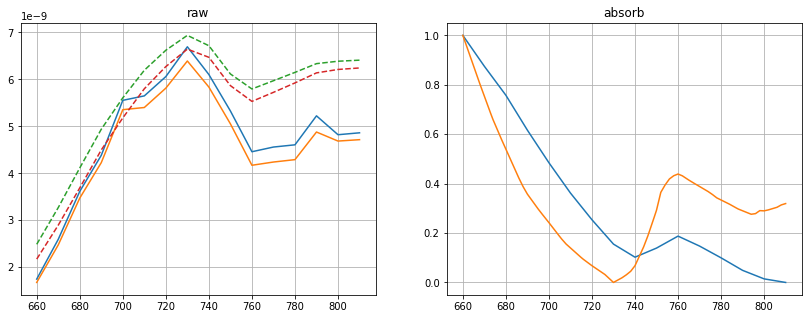

parameters: 
0.681697852673059
iter: 586 | loss: 0.14703153687895


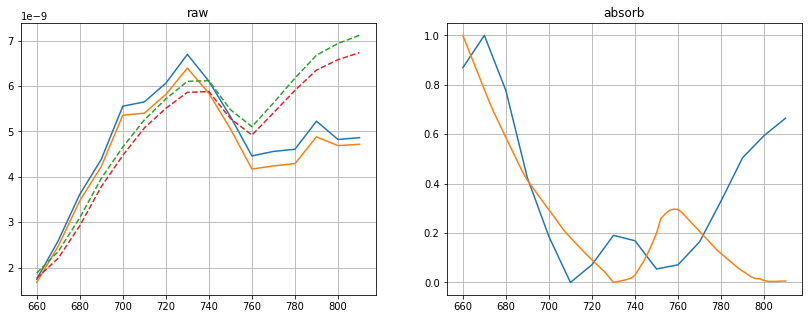

parameters: 
0.45582234879765365
iter: 611 | loss: 0.14379438360461172


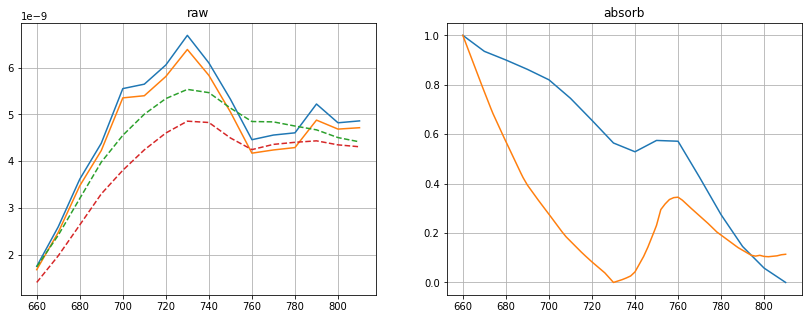

parameters: 
0.5654974579983223
iter: 646 | loss: 0.1423404467068482


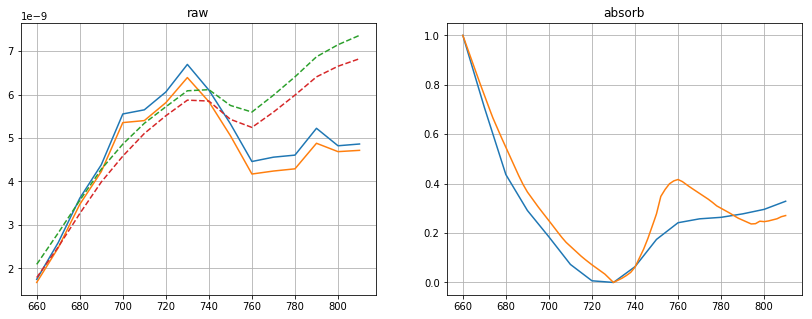

parameters: 
0.6607128032441261
iter: 755 | loss: 0.12207549897376653


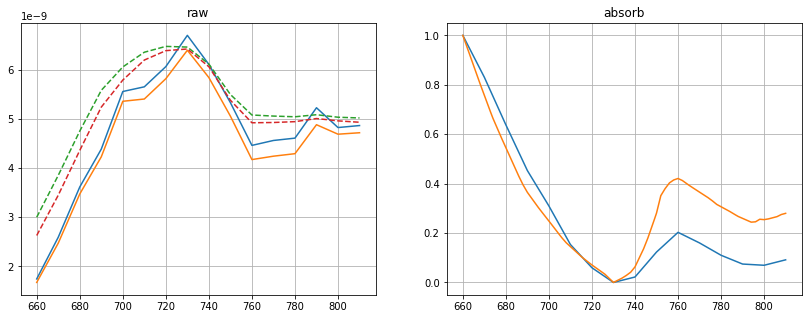

parameters: 
0.6648311417774289
iter: 899 | loss: 0.0971334741455262


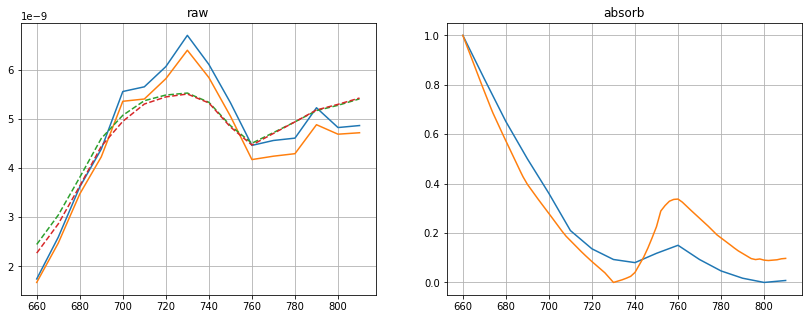

parameters: 
0.5517623230040495
iter: 8418 | loss: 0.09126247559351527


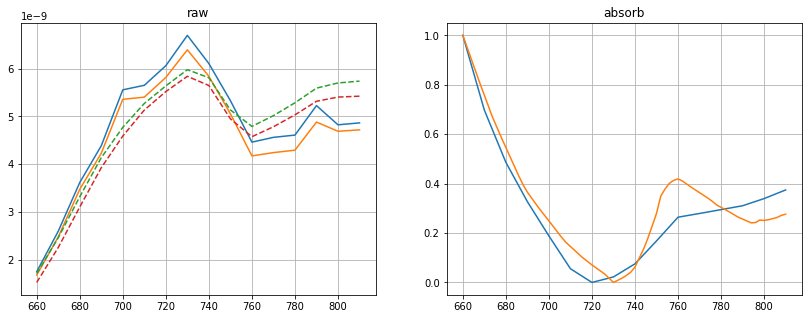

parameters: 
0.6631951805270953
data/calibrated/20190527_split/IJV/20190527_split_7_2.csv
iter: 3 | loss: 0.37347658150068663


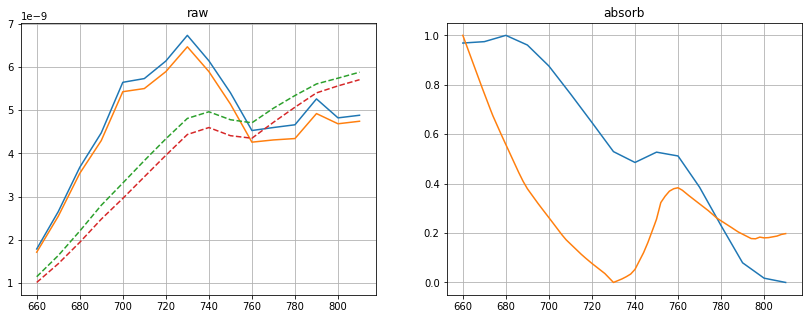

parameters: 
0.6225941778343855
iter: 76 | loss: 0.21521076299068032


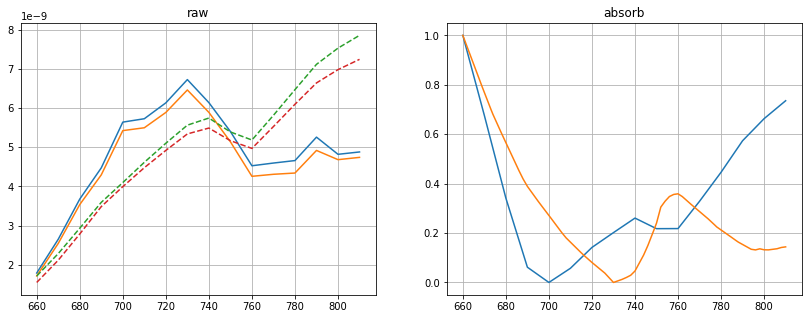

parameters: 
0.5880036649667185
iter: 87 | loss: 0.18698130206980487


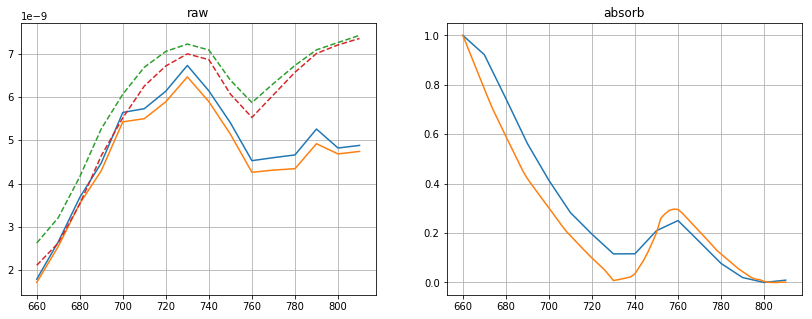

parameters: 
0.4396367087437612
iter: 250 | loss: 0.1607871037086755


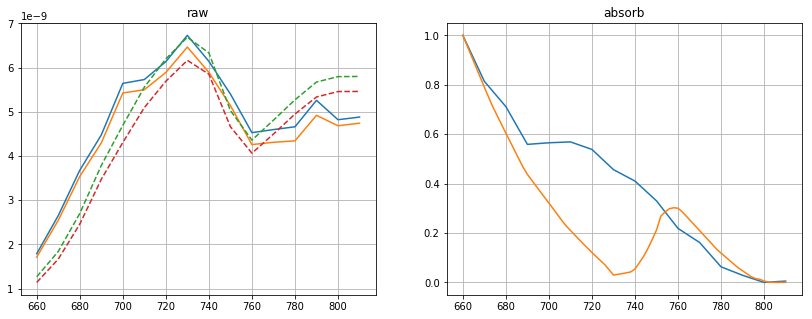

parameters: 
0.40414073395674094
iter: 390 | loss: 0.14125597016769387


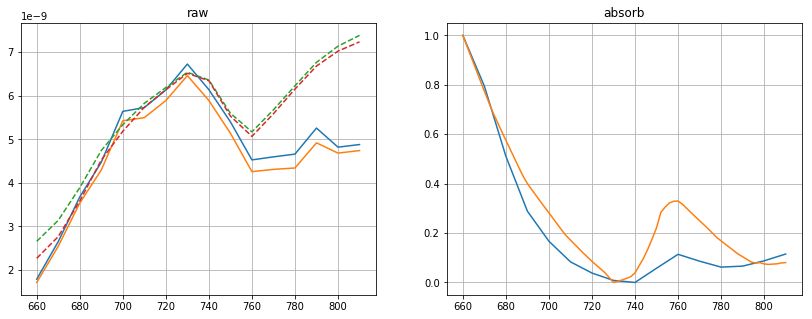

parameters: 
0.5367282831297271
iter: 707 | loss: 0.10672100082144574


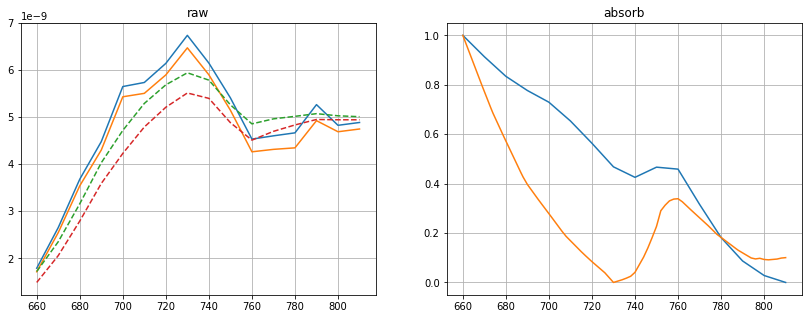

parameters: 
0.5543336409895587
iter: 1548 | loss: 0.09945278835284947


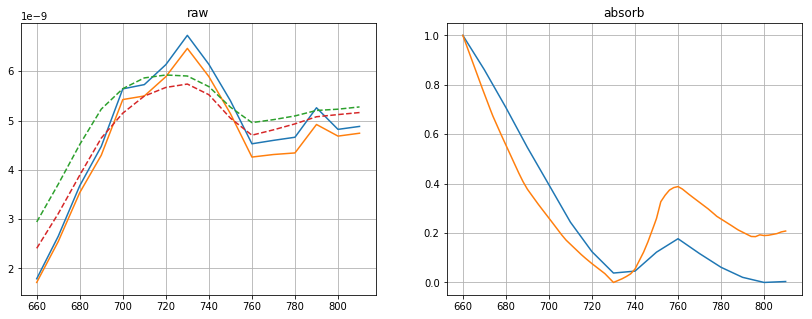

parameters: 
0.6286278491315329
iter: 2367 | loss: 0.08555041182366777


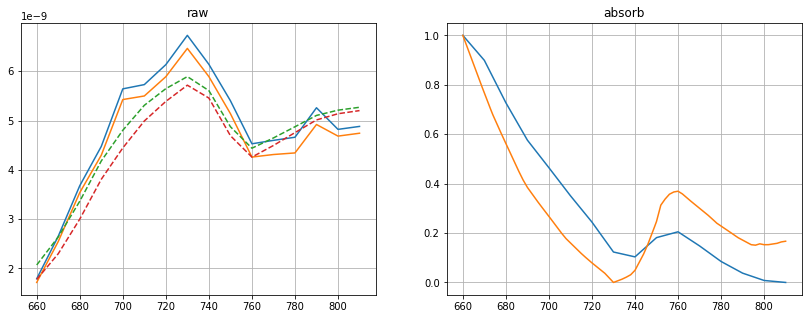

parameters: 
0.6035711778050574
iter: 5980 | loss: 0.0778772201545875


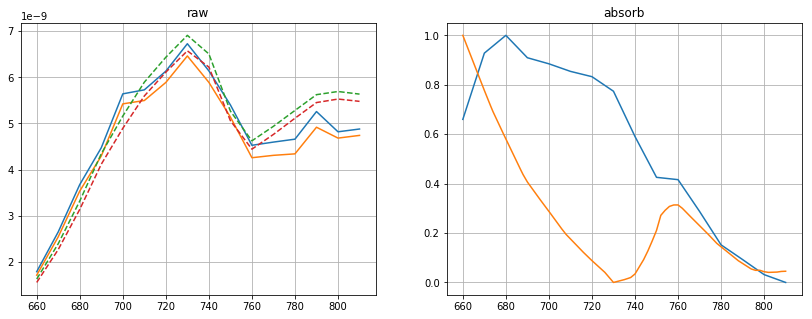

parameters: 
0.5022392988435926
data/calibrated/20190527_split/IJV/20190527_split_7_3.csv
iter: 0 | loss: 0.49718909499027925


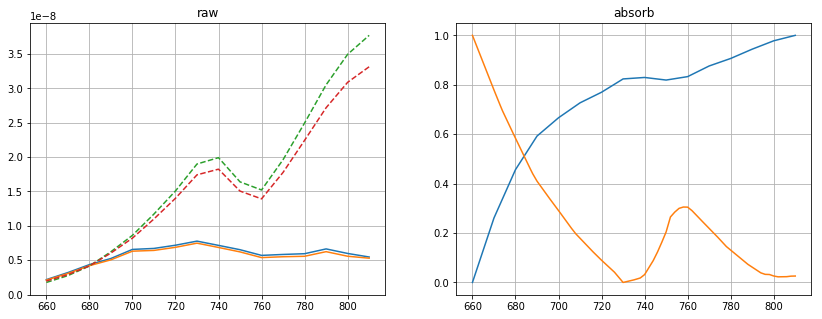

parameters: 
0.48055775599514916
iter: 16 | loss: 0.14757117676683437


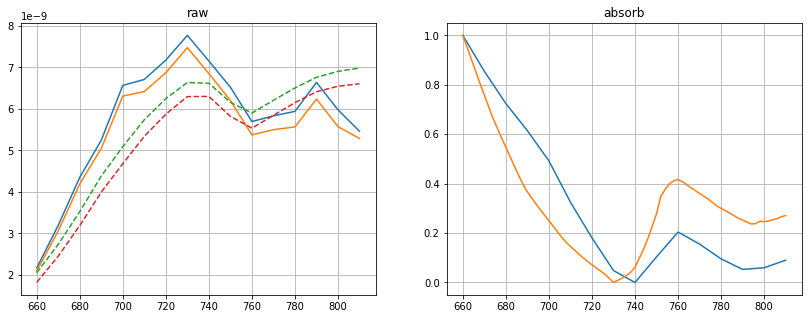

parameters: 
0.660711248929615
iter: 711 | loss: 0.13503012620606564


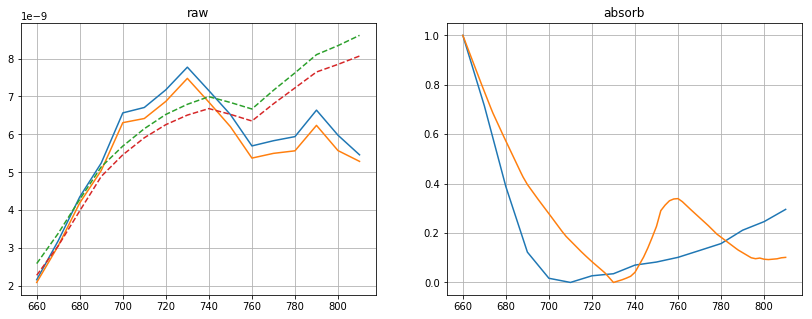

parameters: 
0.5552544548987088
iter: 1368 | loss: 0.07852564273927026


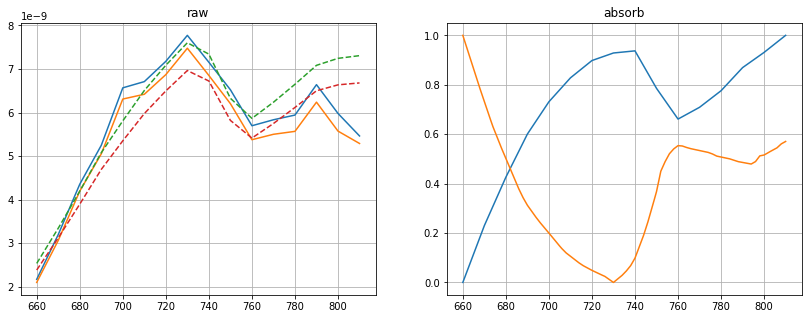

parameters: 
0.7564836070902564
iter: 3154 | loss: 0.06302213340819492


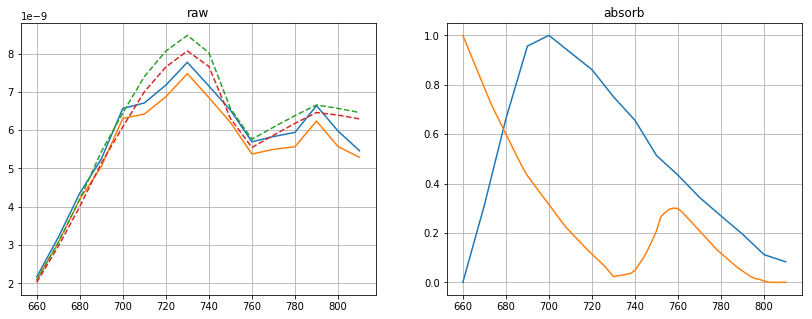

parameters: 
0.415055601834462


In [80]:
for s in spec_list:
    print(s)
    spec = pd.read_csv(s)
    spec = spec[
        (spec["wavelength"] >= wl[0])&
        (spec["wavelength"] <= wl[-1])
    ]
    spec_max = spec["max"].values.T
    spec_min = spec["min"].values.T
    
    spec_max_n = normalize(spec_max)
    spec_min_n = normalize(spec_min)

    min_loss = 100
    min_args = {}
    for i in range(10000):
        args_max, args_min = get_args(
            geo_max=[1.43, 1.11, 8.53 + uniform(-0.2, 0.2), 14.76, 3.27, 22.46, 12.14],
            geo_min=[1.43, 1.11, 7.92 + uniform(-0.2, 0.2), 14.76, 3.27, 22.46, 12.14],
        )
        pred_max = engine.get_spectrum(args_min, warning=False)
        pred_min = engine.get_spectrum(args_max, warning=False)
        
        pred_max_n = normalize(pred_max)
        pred_min_n = normalize(pred_min)
        
#         loss = (rmse_loss(pred_max_n, spec_max_n) + rmse_loss(pred_min_n, spec_min_n))/2  
#         loss = (rmse_loss(pred_max, spec_max) + rmse_loss(pred_min, spec_min))/2
        
        loss = (rmsp_loss(pred_max, spec_max) + rmsp_loss(pred_min, spec_min))/2 \
#         + 0.001 * rmse_loss(
#             normalize(np.log(spec_max/spec_min)), normalize(np.log(pred_max/pred_min))
#         )
        if min_loss > loss:
            print("iter: {} | loss: {}".format(i, loss))
            min_loss = loss
            min_args = args_min
            
            fig, ax = plt.subplots(1, 2, figsize=(14, 5))
            ax[0].plot(wl, spec_max, label="spec_max")
            ax[0].plot(wl, spec_min, label="spec_min")
            ax[0].plot(wl, pred_max, '--', label="pred_max")
            ax[0].plot(wl, pred_min, '--', label="pred_min")
            ax[0].set_title("raw")
            ax[0].grid()
            
#             ax[1].plot(wl, spec_max_n, label="spec_max")
#             ax[1].plot(wl, spec_min_n, label="spec_min")
#             ax[1].plot(wl, pred_max_n, '--', label="pred_max")
#             ax[1].plot(wl, pred_min_n, '--', label="pred_min")
#             ax[1].set_title("norm")
#             plt.show()
            
#             ax[1].plot(wl, normalize(np.log(spec_max/spec_min)))
            ax[1].plot(wl, normalize(np.log(pred_max/pred_min)))
            sss = args_max["IJV"]["ScvO2"]
            ax[1].plot(mua["wavelength"], normalize(oxy * sss + deoxy * (1-sss)))
            ax[1].set_title("absorb")
            
            ax[1].grid()
            plt.show()
            
            print("parameters: ")
            print(args_max["IJV"]["ScvO2"])
            with open("fitting/" + s.split('/')[-1].strip('.csv') + ".json", 'w') as f:
                args_max["rmsp"] = loss
                json.dump(args_max, f, indent=4)
            
    


### 0528 (韋翰)

In [81]:
spec_list = glob("data/calibrated/20190528_split/IJV/20190528_split_*_*.csv")
spec_list.sort(key=
    lambda x: (int(x.split('_')[-2]), int(x.split('_')[-1].strip('.csv'))) 
)

In [ ]:
1: 正常
2, 3: 過度換氣 ,
4: 吸氧氣 ,
5: 閉氣

data/calibrated/20190528_split/IJV/20190528_split_1_1.csv
iter: 4 | loss: 0.7790418381990709


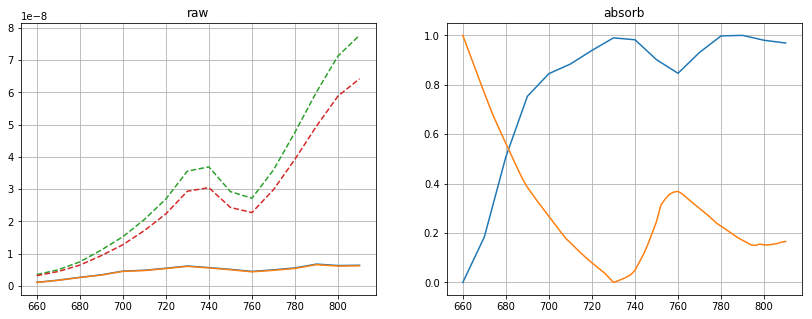

parameters: 
0.6028736446663623


/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/home/md703/toast/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


iter: 43 | loss: 0.5619929558628696


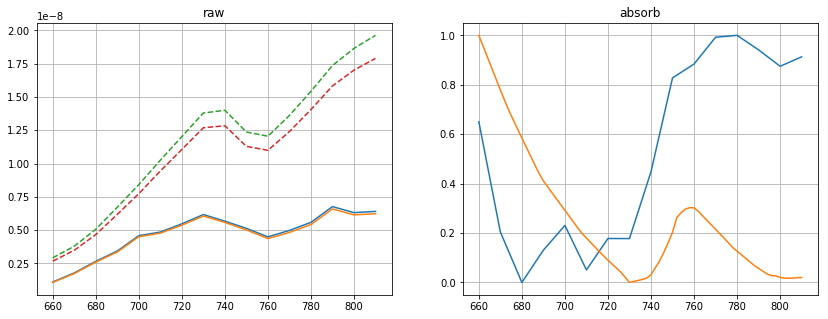

parameters: 
0.47331603129745753
iter: 49 | loss: 0.5412183692179908


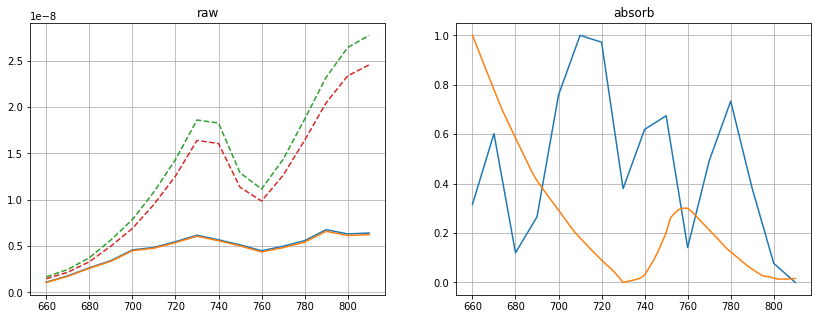

parameters: 
0.46852083816738815
iter: 62 | loss: 0.31428256481532835


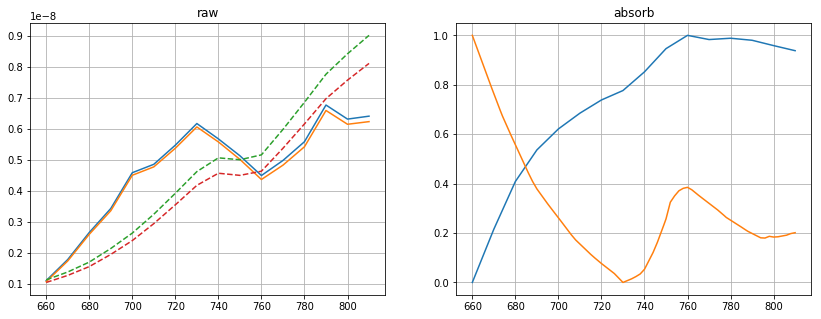

parameters: 
0.624745385989575
iter: 78 | loss: 0.1778558483315329


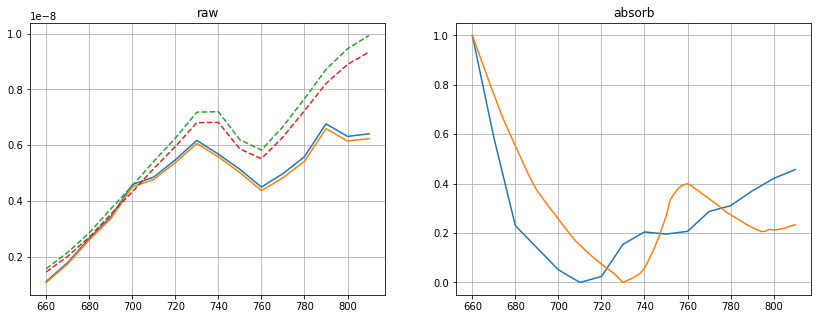

parameters: 
0.6422905220529959
iter: 89 | loss: 0.15560210232132315


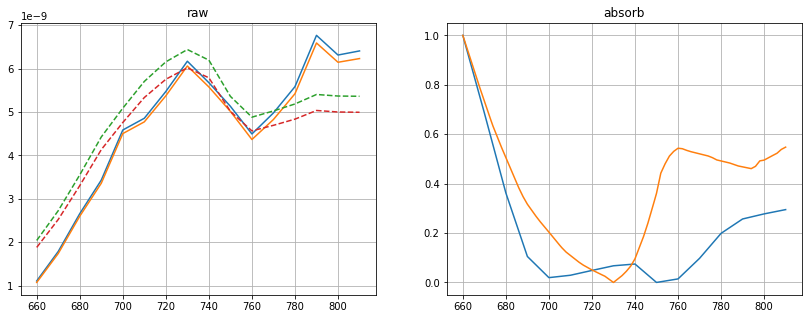

parameters: 
0.7513099536559015
iter: 92 | loss: 0.15024863601490457


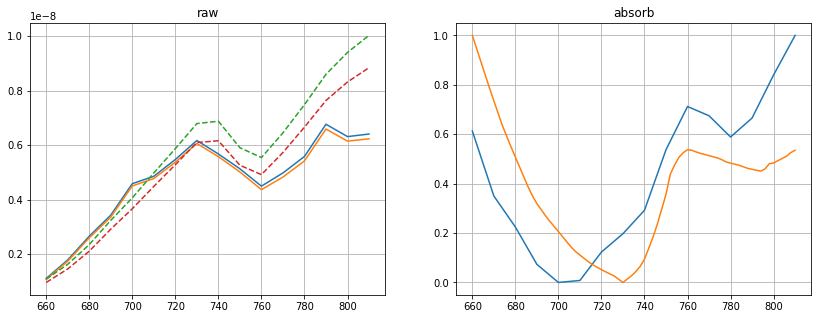

parameters: 
0.7483341161502838
iter: 353 | loss: 0.12942779630754278


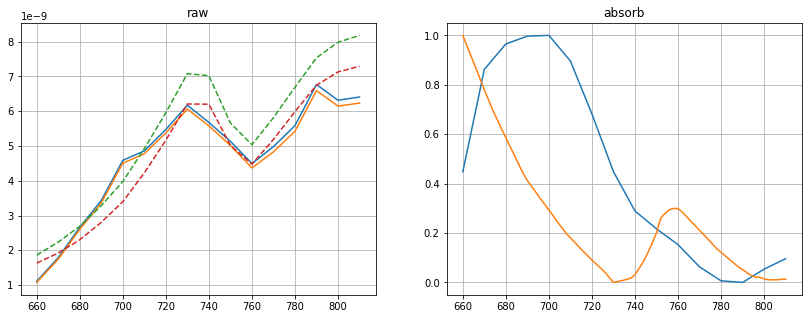

parameters: 
0.4648042605953159
iter: 1139 | loss: 0.08424292944238568


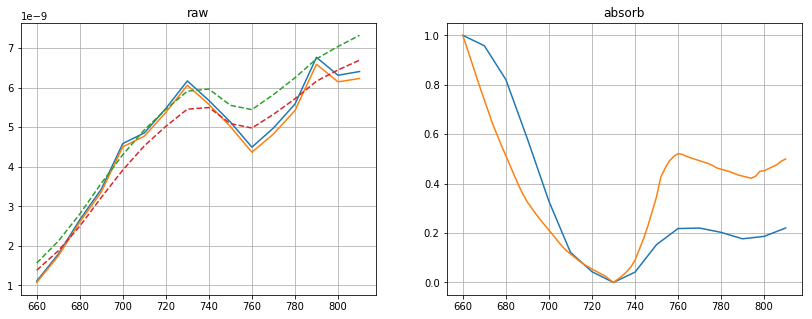

parameters: 
0.7396252581271023
iter: 2077 | loss: 0.08277250414522684


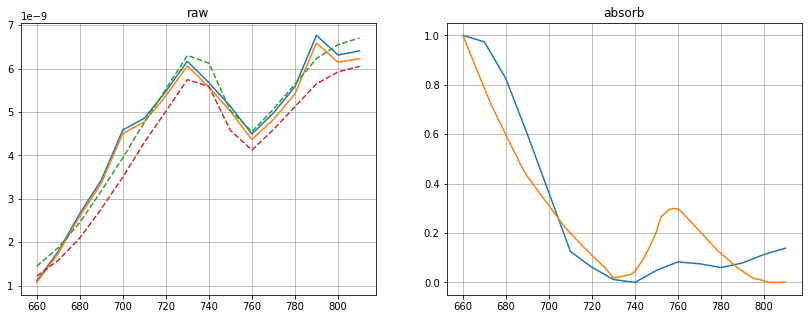

parameters: 
0.4232555641373454
iter: 6829 | loss: 0.07646012618399994


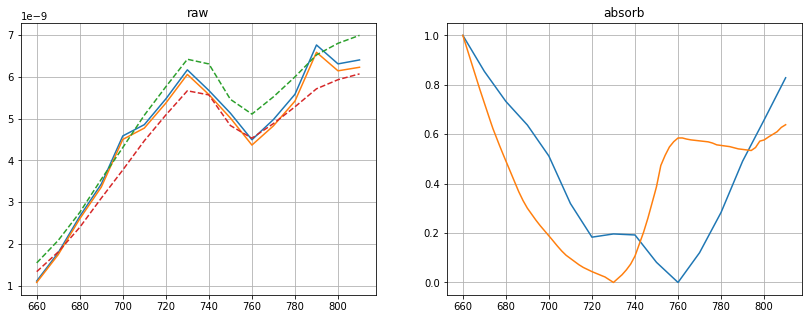

parameters: 
0.7703929388191081
data/calibrated/20190528_split/IJV/20190528_split_2_1.csv
iter: 3 | loss: 0.9450984521237129


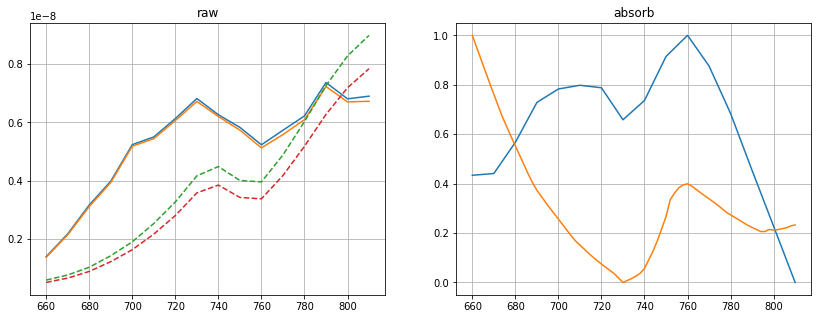

parameters: 
0.6420403949876295
iter: 4 | loss: 0.8000669855907269


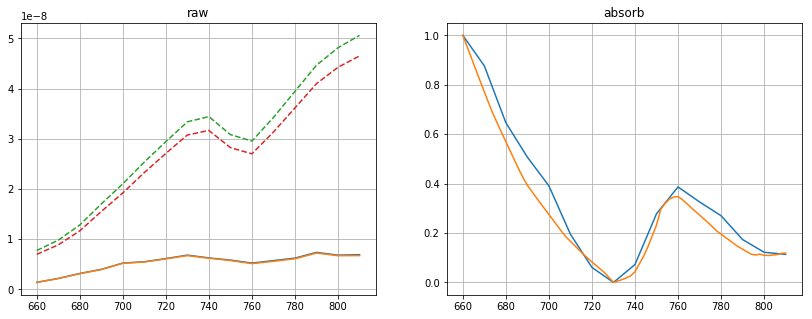

parameters: 
0.5696770506381144
iter: 5 | loss: 0.7338147211917481


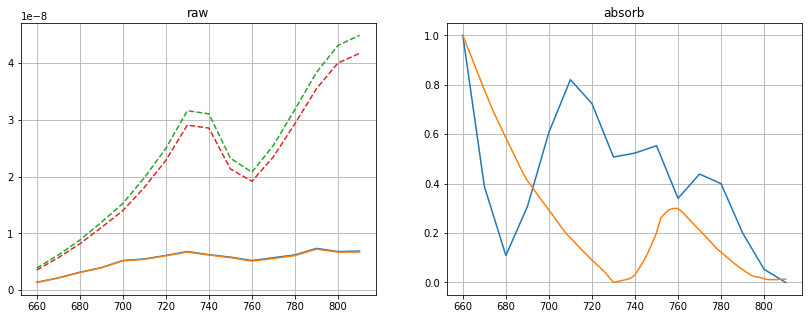

parameters: 
0.46555738721388673
iter: 11 | loss: 0.688541783773698


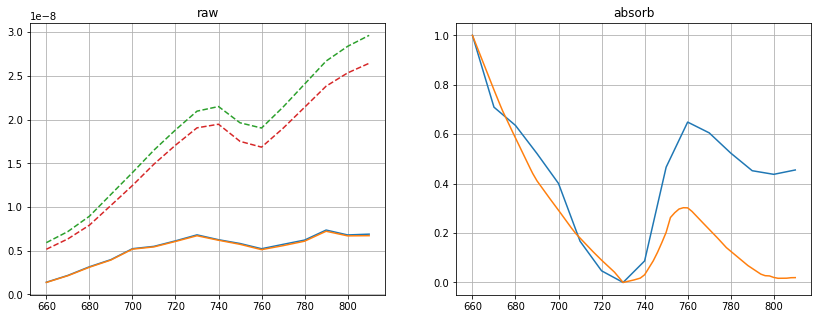

parameters: 
0.47292802081595836
iter: 17 | loss: 0.37472956108387545


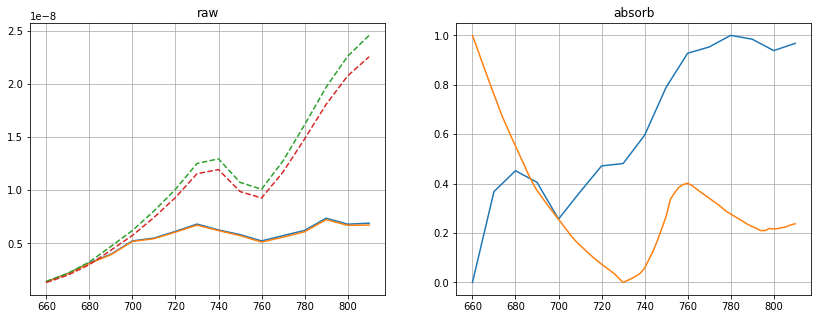

parameters: 
0.6444571643372603
iter: 85 | loss: 0.28580068057918345


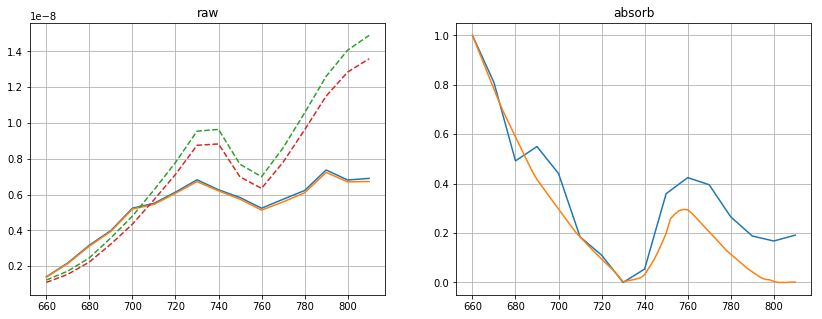

parameters: 
0.44634563654077103
iter: 176 | loss: 0.2554707838714177


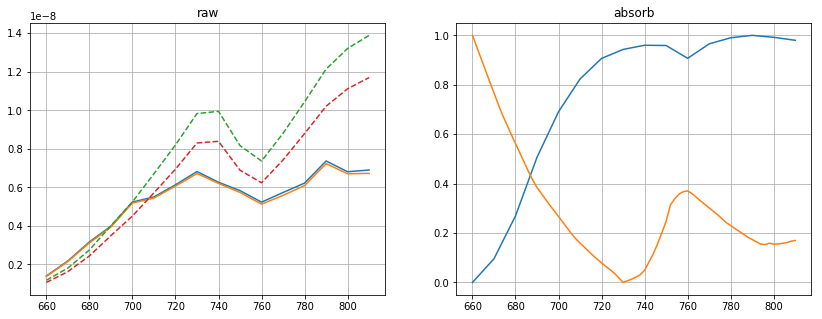

parameters: 
0.6053892754419901
iter: 188 | loss: 0.24485550219343177


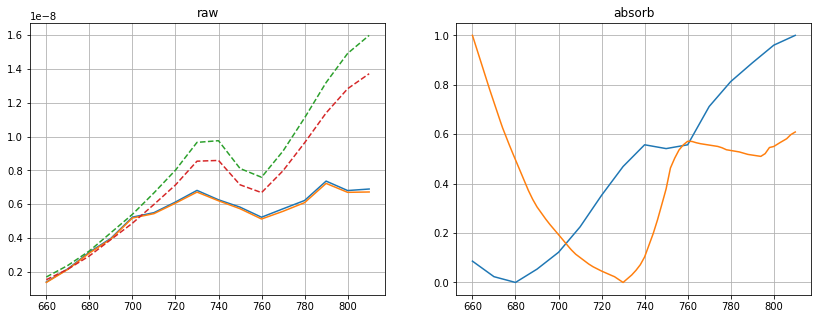

parameters: 
0.7645827592914541
iter: 314 | loss: 0.22902976684016002


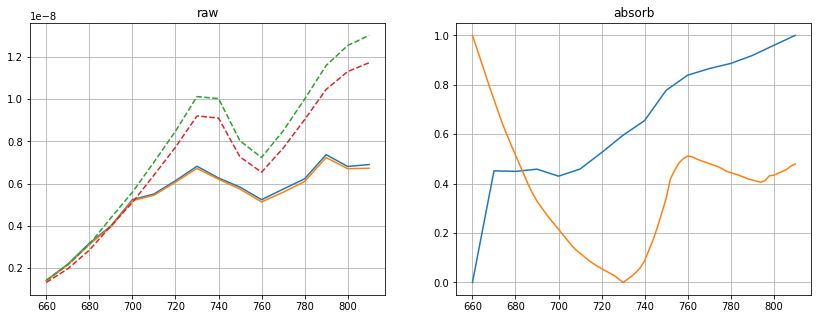

parameters: 
0.7343134586697143
iter: 363 | loss: 0.22656026749484906


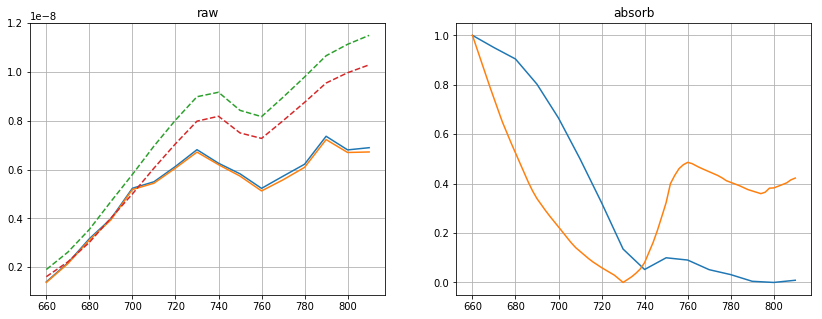

parameters: 
0.7179882917645619
iter: 559 | loss: 0.1255811320681089


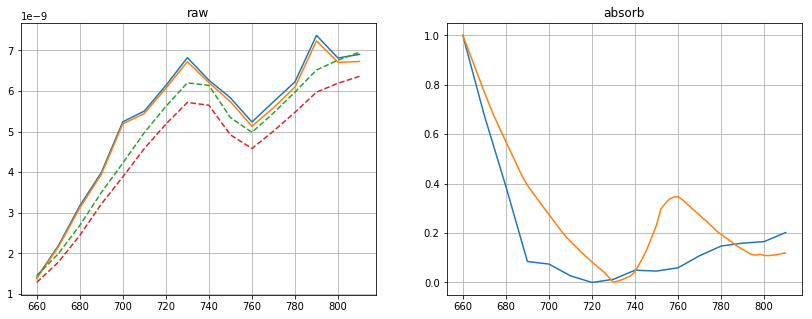

parameters: 
0.569267241536051
iter: 1035 | loss: 0.10658696655294514


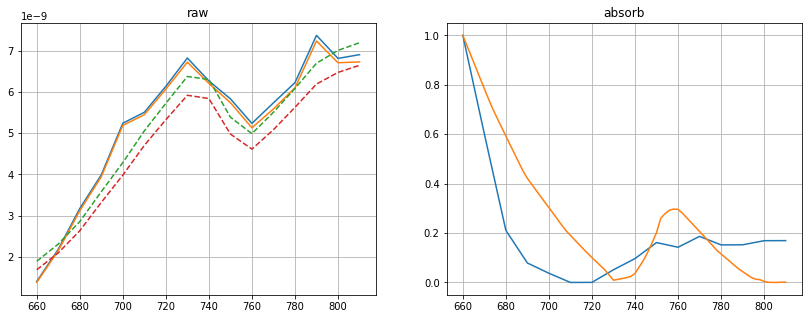

parameters: 
0.4375800679664265
iter: 1293 | loss: 0.10590950356416715


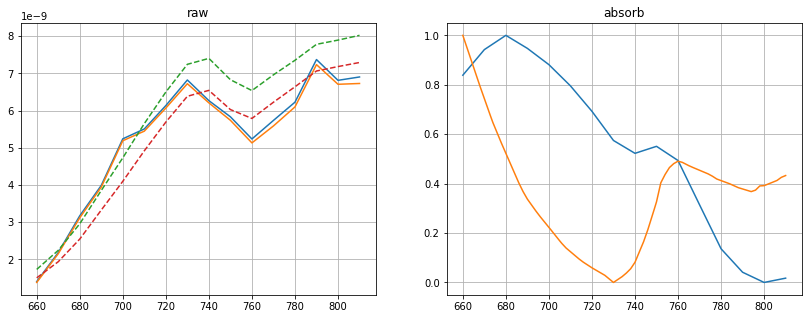

parameters: 
0.7210898855116666
iter: 1606 | loss: 0.09739784819281569


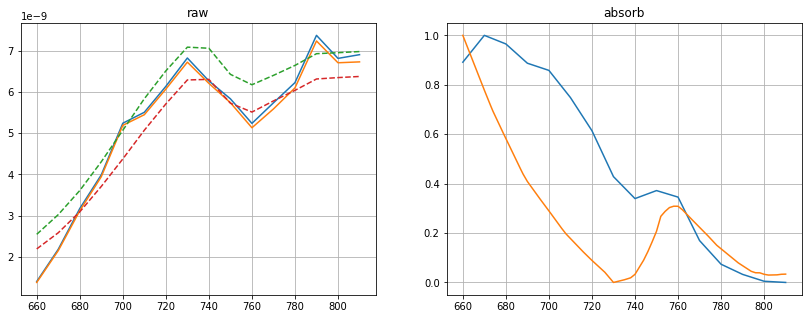

parameters: 
0.4894055097313043
iter: 1737 | loss: 0.07037248220265842


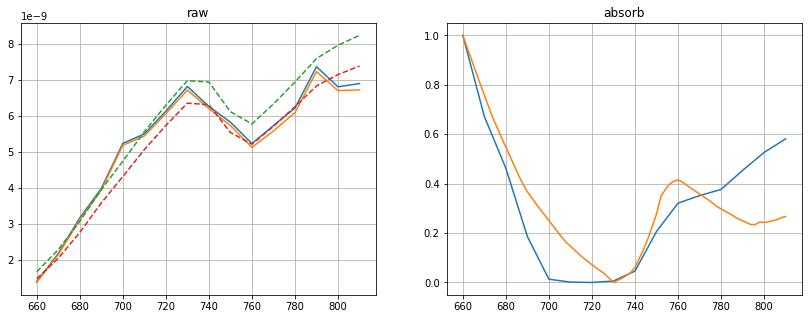

parameters: 
0.6589724676884988
data/calibrated/20190528_split/IJV/20190528_split_2_2.csv
iter: 3 | loss: 19.724077869786232


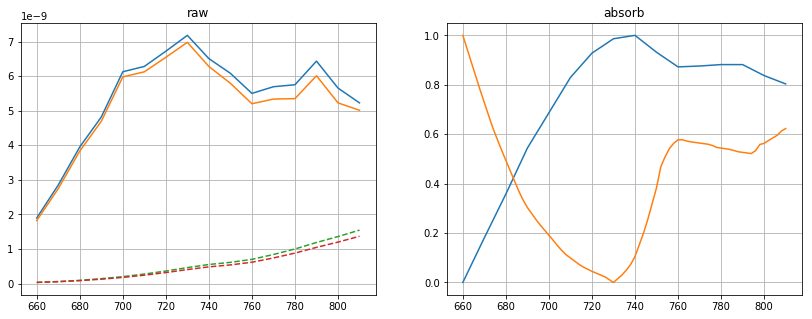

parameters: 
0.7673987612920716
iter: 6 | loss: 0.6144896954294808


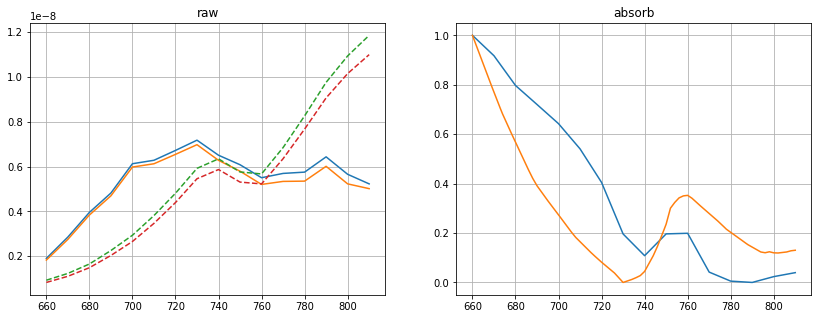

parameters: 
0.5780637040420309
iter: 36 | loss: 0.4409273740745099


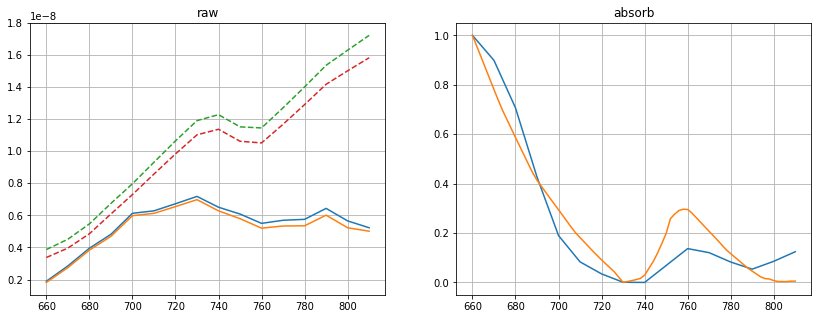

parameters: 
0.4552630109506413
iter: 69 | loss: 0.3449858007819222


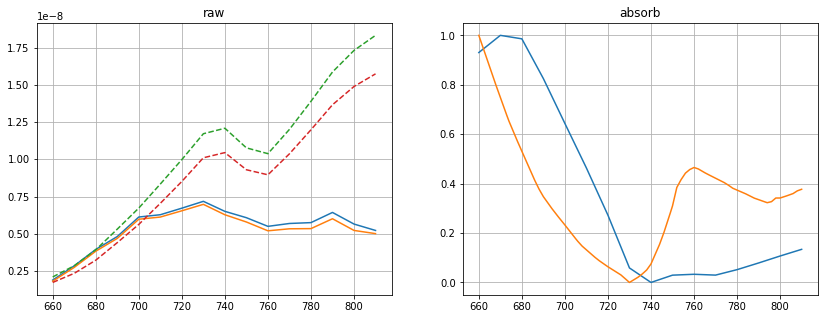

parameters: 
0.7032416040157152
iter: 78 | loss: 0.25846841489009953


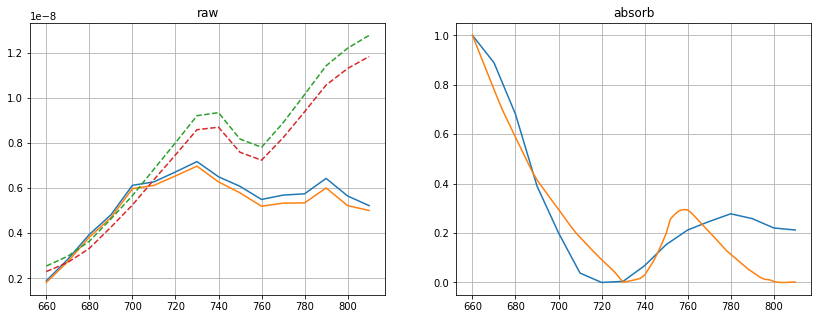

parameters: 
0.44922421011140384
iter: 515 | loss: 0.22548323834707962


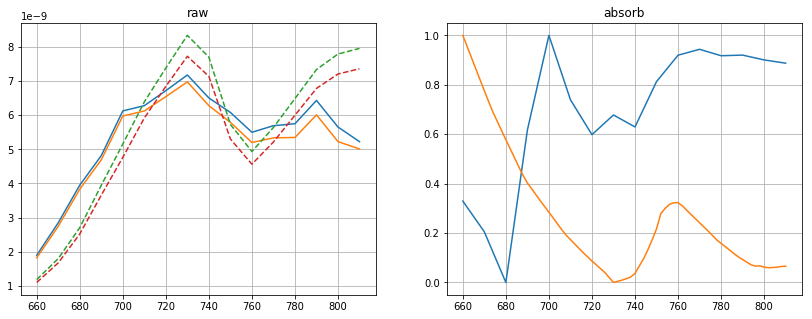

parameters: 
0.52308027371364
iter: 1207 | loss: 0.16487388066667918


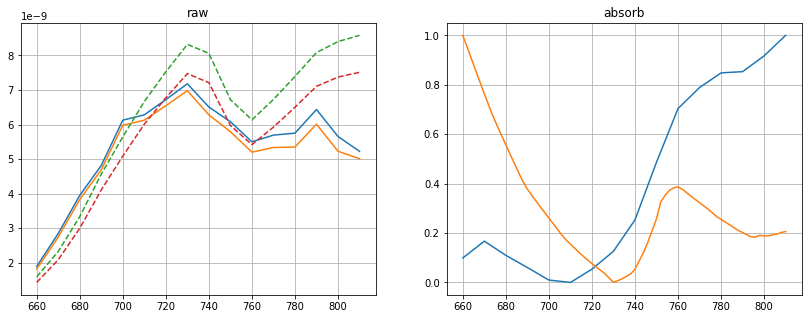

parameters: 
0.6274317257747273
iter: 1396 | loss: 0.14364653086240958


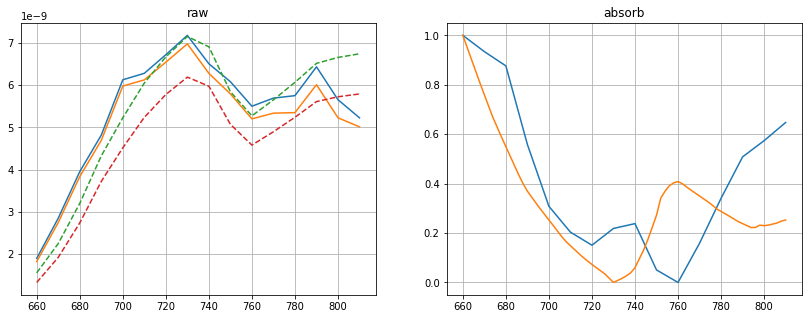

parameters: 
0.6520596414187316
iter: 8986 | loss: 0.14136015491683085


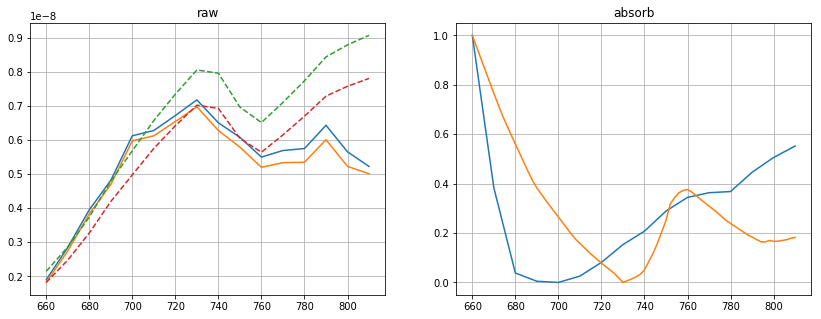

parameters: 
0.6132446376863071
data/calibrated/20190528_split/IJV/20190528_split_2_3.csv
iter: 0 | loss: 0.9097766792453862


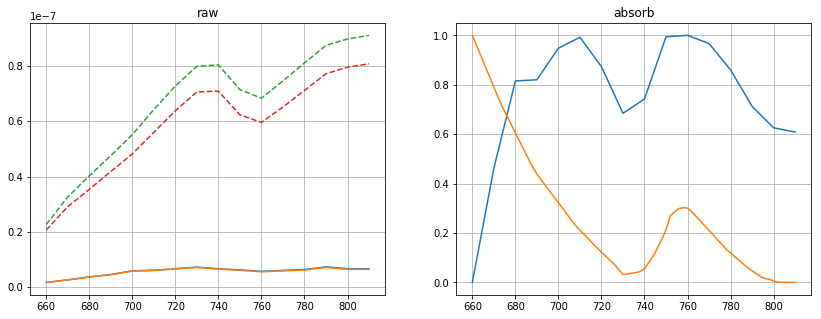

parameters: 
0.40135067900236404
iter: 3 | loss: 0.5588272759070693


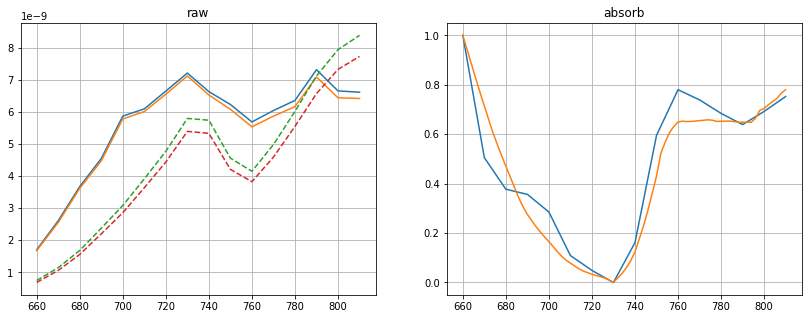

parameters: 
0.7942427525810442
iter: 40 | loss: 0.4731873069041883


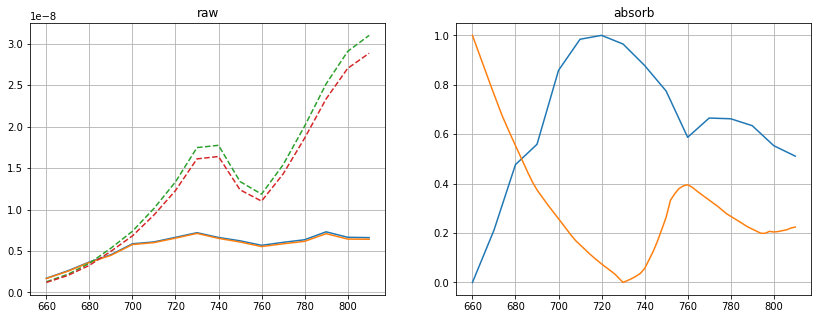

parameters: 
0.6374553027424905
iter: 53 | loss: 0.4120797547579942


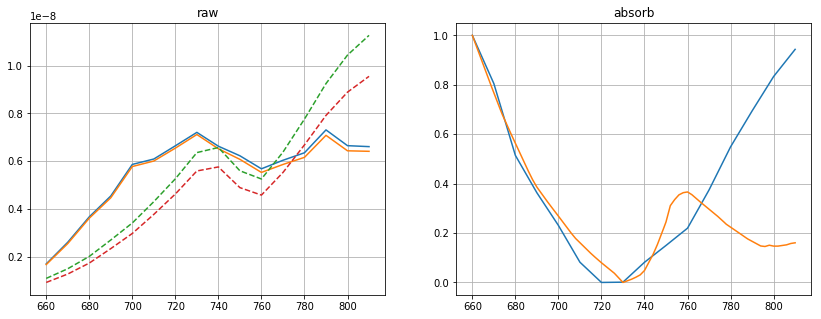

parameters: 
0.5993542647801247
iter: 85 | loss: 0.26906331733818034


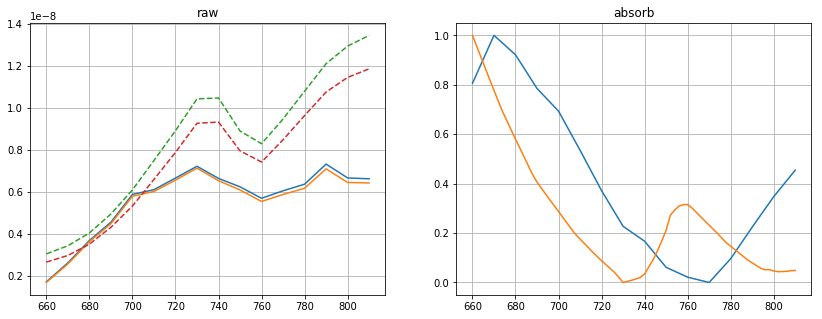

parameters: 
0.5054713585184686
iter: 154 | loss: 0.22788158511608084


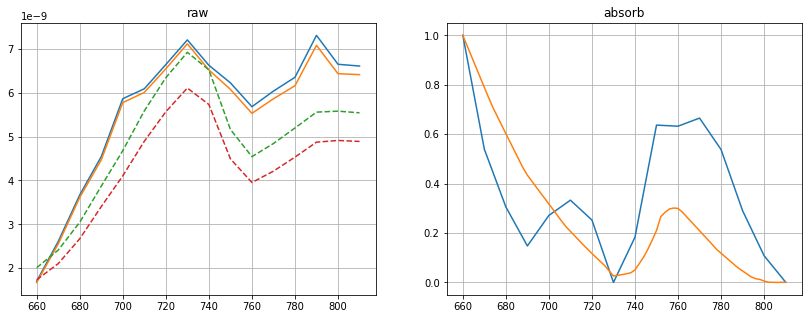

parameters: 
0.41117691039005155
iter: 161 | loss: 0.20323059858048315


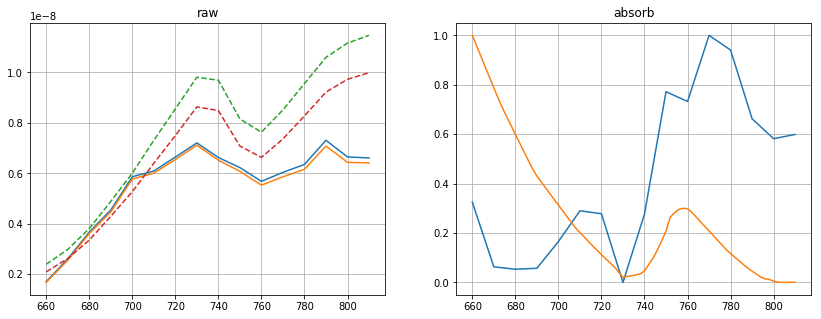

parameters: 
0.41907848286330035
iter: 681 | loss: 0.11024397316258726


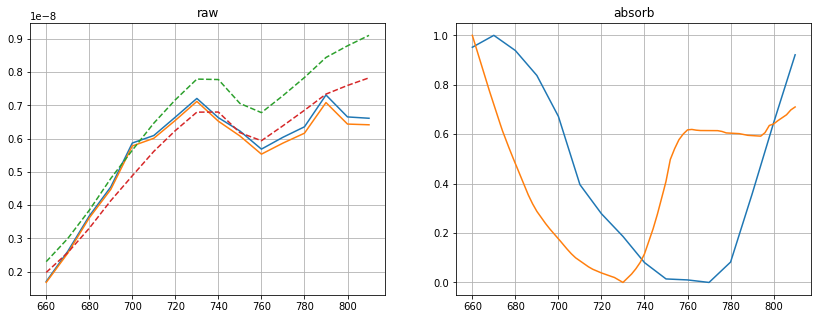

parameters: 
0.7832757421254162
iter: 5339 | loss: 0.08333911799290387


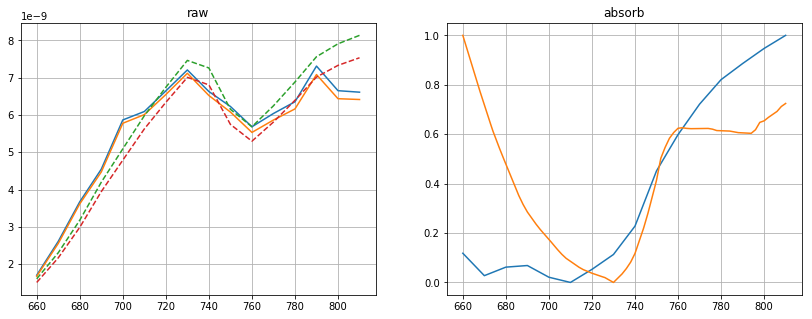

parameters: 
0.7856248945241909
data/calibrated/20190528_split/IJV/20190528_split_2_4.csv
iter: 0 | loss: 0.38113748191493446


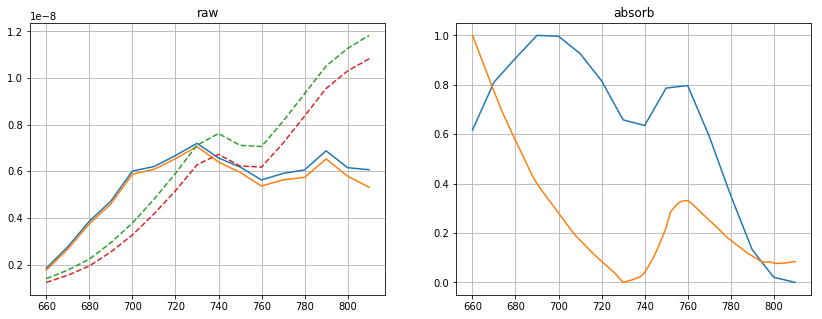

parameters: 
0.5404367618413346
iter: 21 | loss: 0.3380941859115867


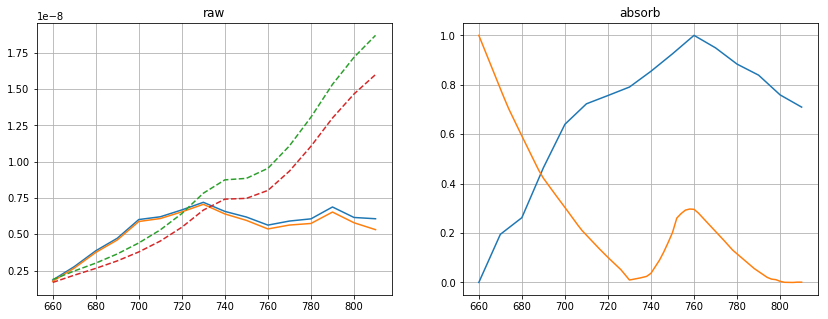

parameters: 
0.43632375906505716
iter: 201 | loss: 0.16093779851496692


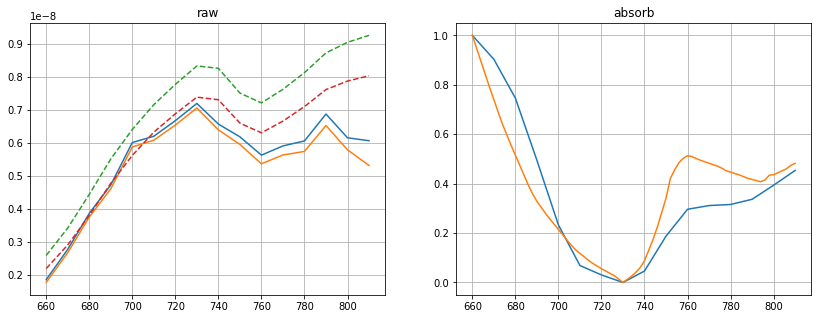

parameters: 
0.7350217012460665
iter: 2210 | loss: 0.13439176338144082


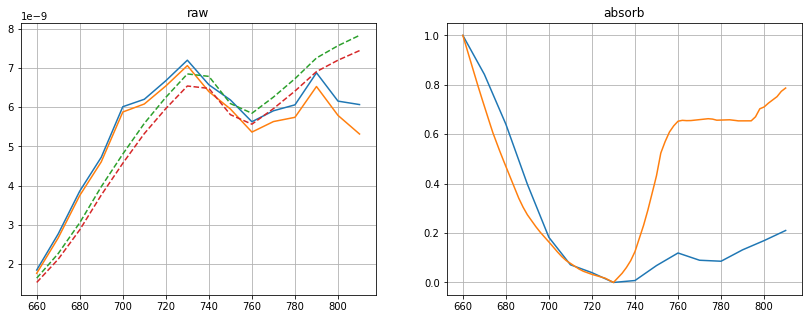

parameters: 
0.7952841318847704
iter: 3234 | loss: 0.07886415373669935


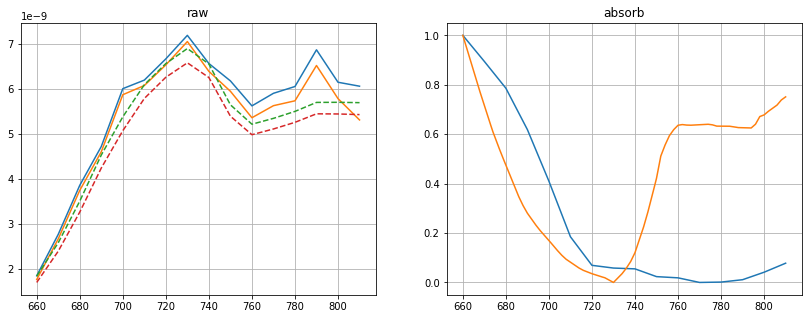

parameters: 
0.7898914309392159
iter: 3555 | loss: 0.0735997851937163


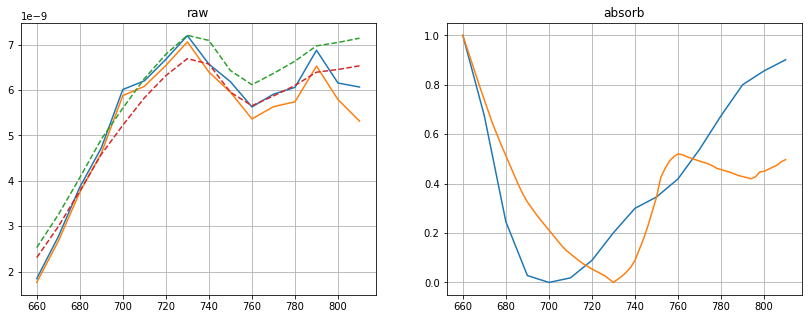

parameters: 
0.7390021421898956
data/calibrated/20190528_split/IJV/20190528_split_2_5.csv
iter: 3 | loss: 21.218898917053284


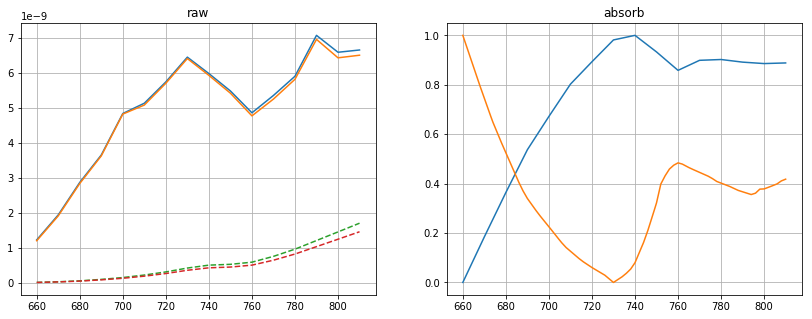

parameters: 
0.716606164140046
iter: 4 | loss: 0.9080401728535394


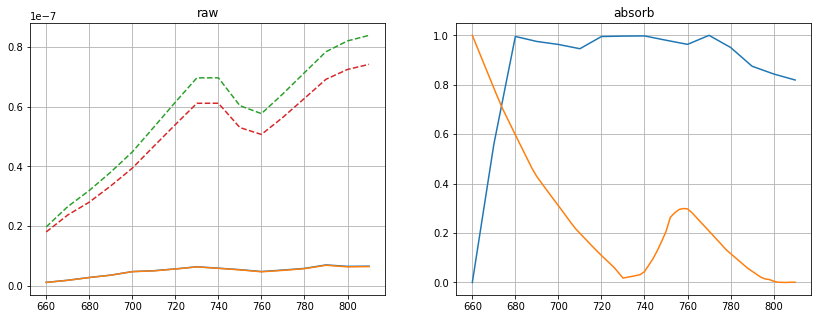

parameters: 
0.42420779381328166
iter: 12 | loss: 0.8443079071854958


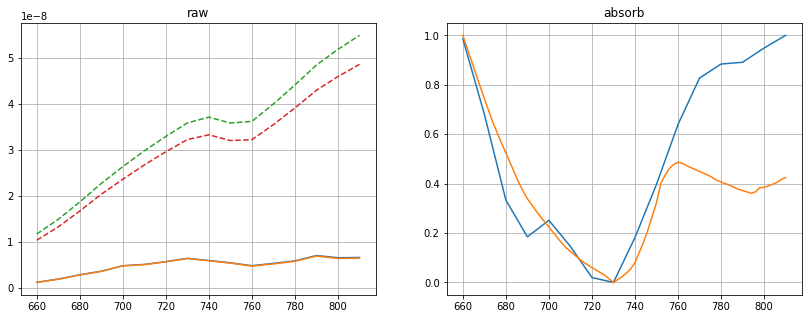

parameters: 
0.7185965636688588
iter: 20 | loss: 0.4562594545275235


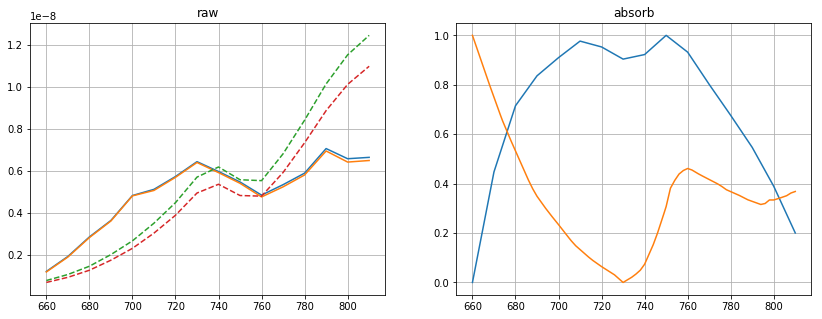

parameters: 
0.7001415117704747
iter: 60 | loss: 0.424953349636088


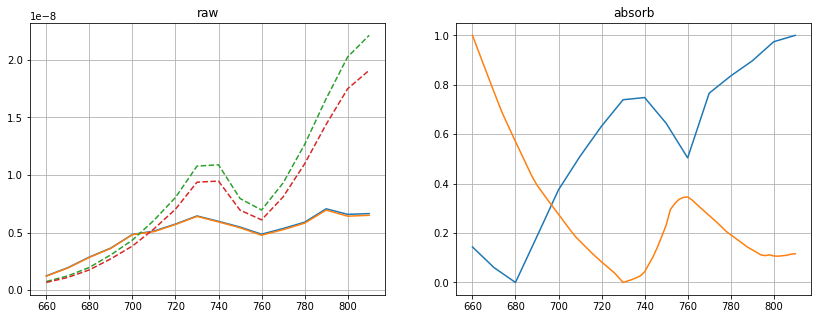

parameters: 
0.5672713169904299
iter: 109 | loss: 0.36785847042991554


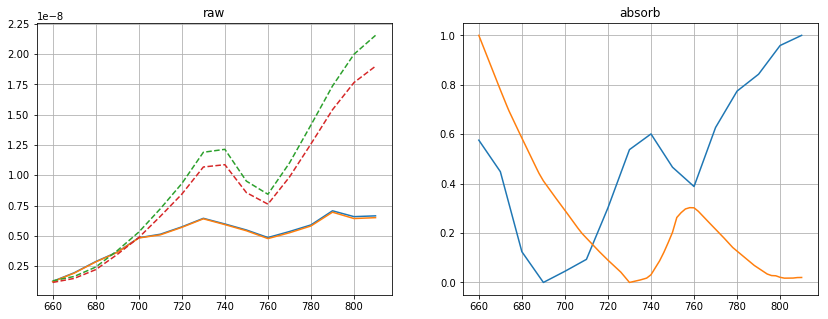

parameters: 
0.47363903893747206
iter: 134 | loss: 0.3178649130633088


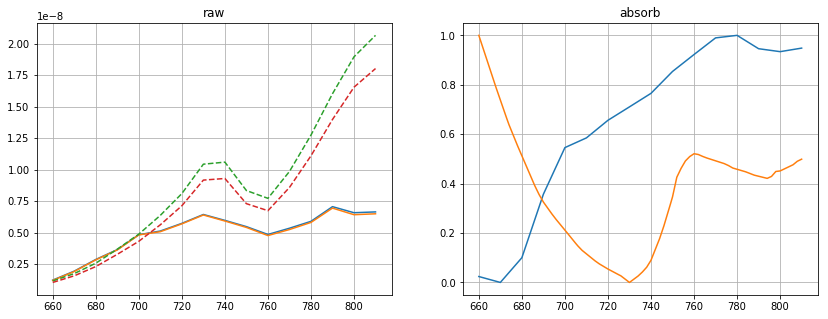

parameters: 
0.739451518807922
iter: 226 | loss: 0.20663444701835185


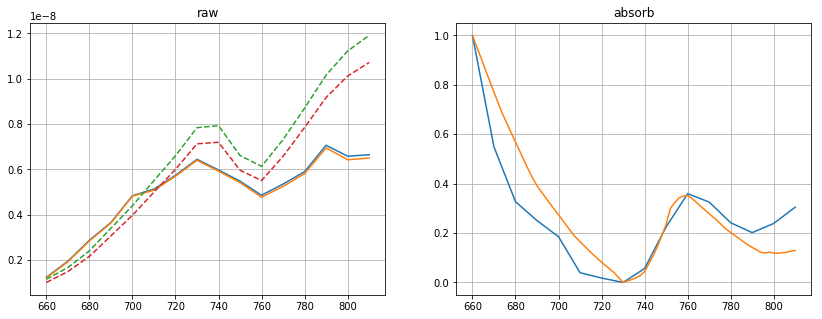

parameters: 
0.5771715082072457
iter: 319 | loss: 0.1710600693158567


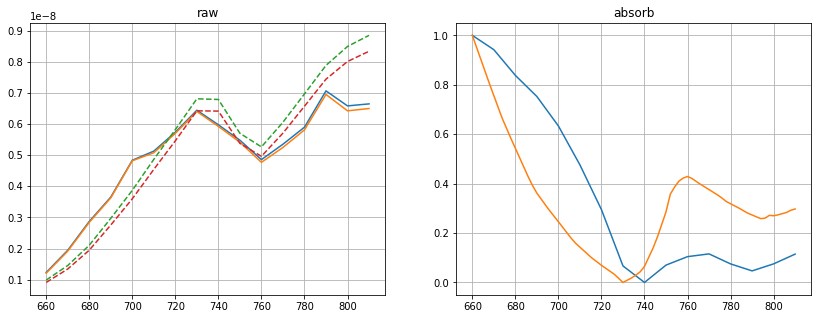

parameters: 
0.6725986585694532
iter: 508 | loss: 0.13983643506797305


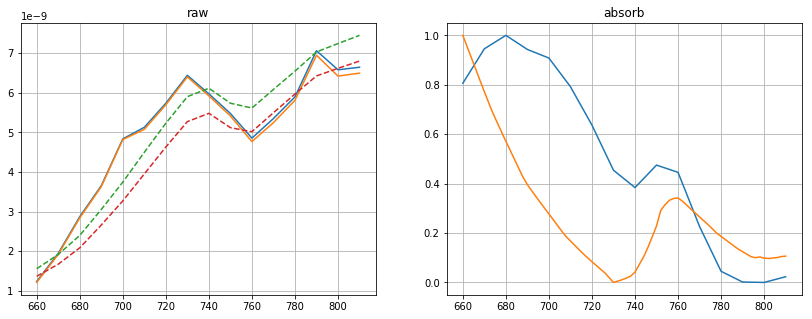

parameters: 
0.5594190634772795
iter: 528 | loss: 0.11267077302023461


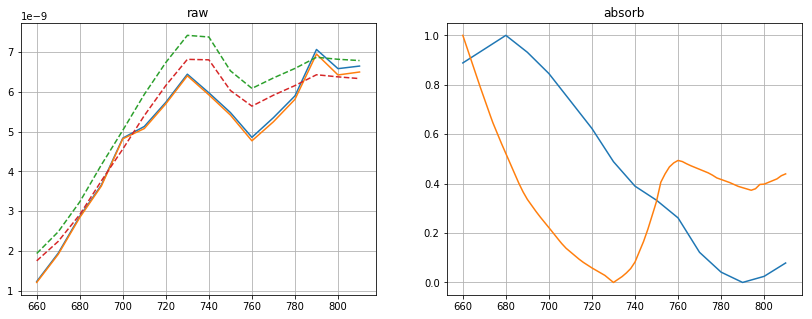

parameters: 
0.7230958081179957
iter: 1050 | loss: 0.08336759170731464


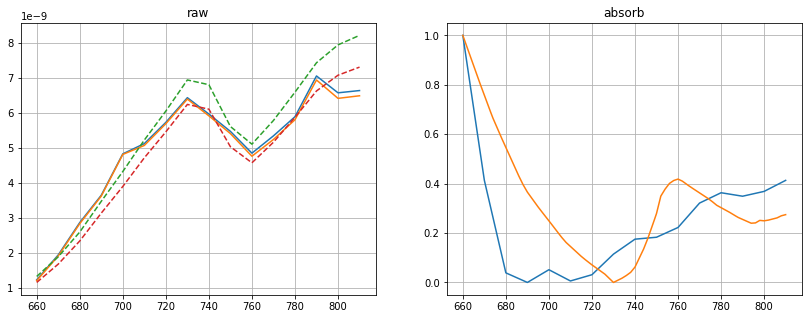

parameters: 
0.662426776945175
iter: 3130 | loss: 0.06706780690995248


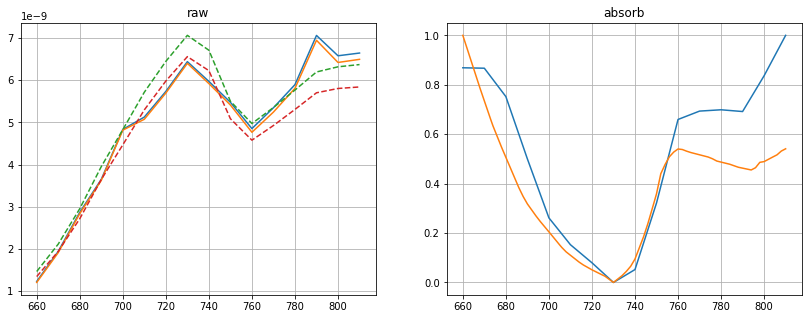

parameters: 
0.749753938809246
data/calibrated/20190528_split/IJV/20190528_split_3_1.csv
iter: 0 | loss: 54.014741888380186


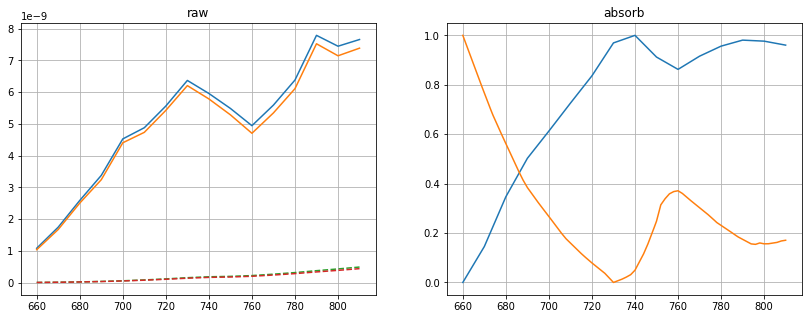

parameters: 
0.606133485644029
iter: 5 | loss: 0.8972095134841447


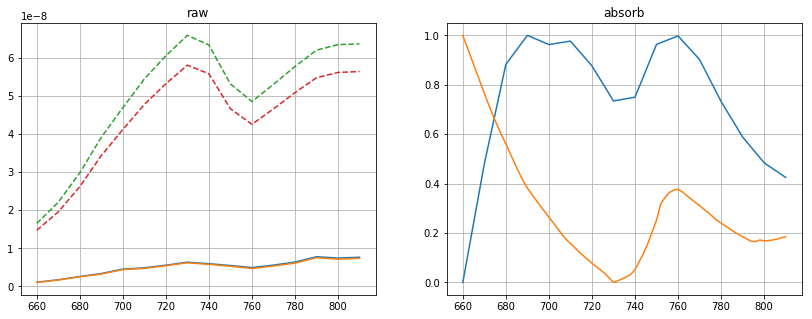

parameters: 
0.6146256022389665
iter: 11 | loss: 0.35233547888405325


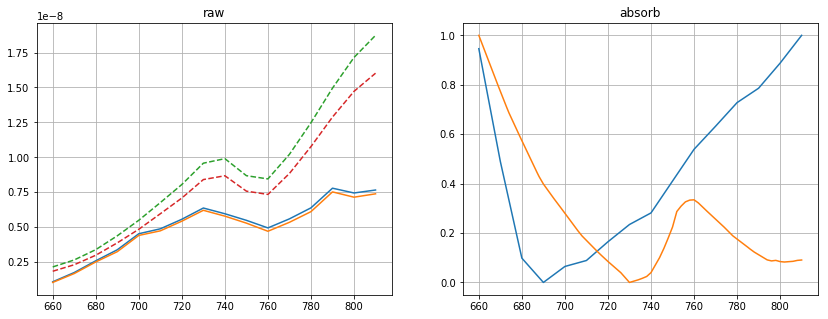

parameters: 
0.5461288980181759
iter: 20 | loss: 0.30999486638815427


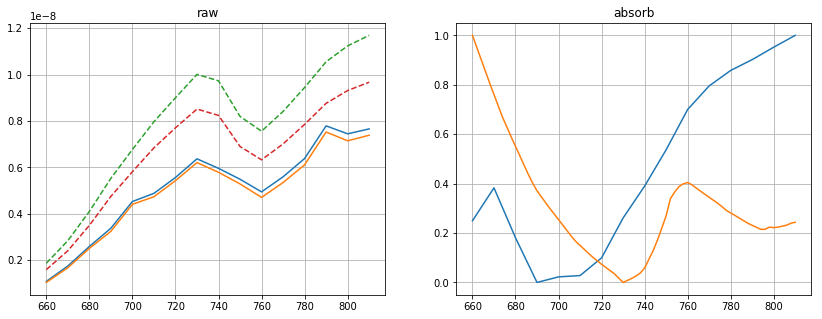

parameters: 
0.647642253092725
iter: 43 | loss: 0.25393035157083343


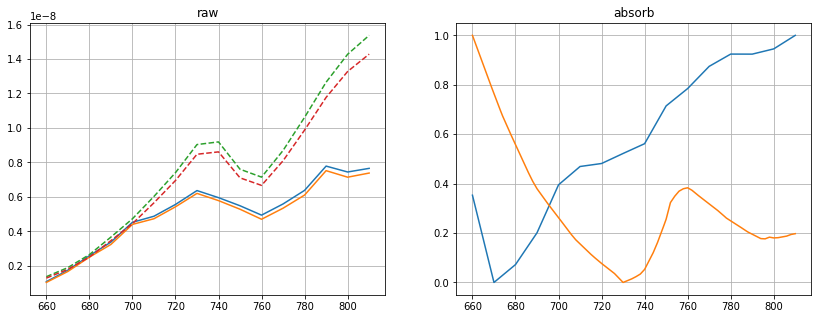

parameters: 
0.622465633010151
iter: 83 | loss: 0.07139951561811338


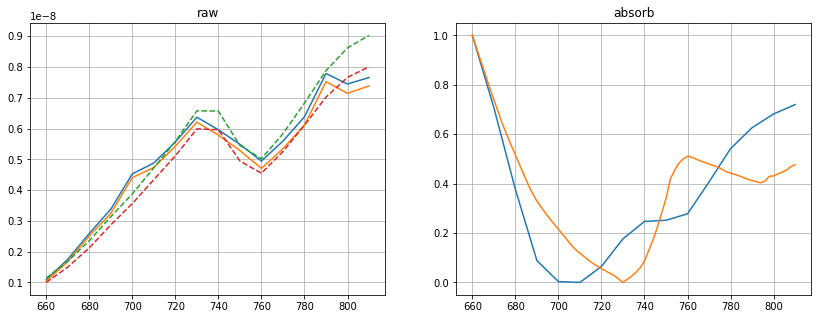

parameters: 
0.7335779134924718
iter: 4328 | loss: 0.06740850419029669


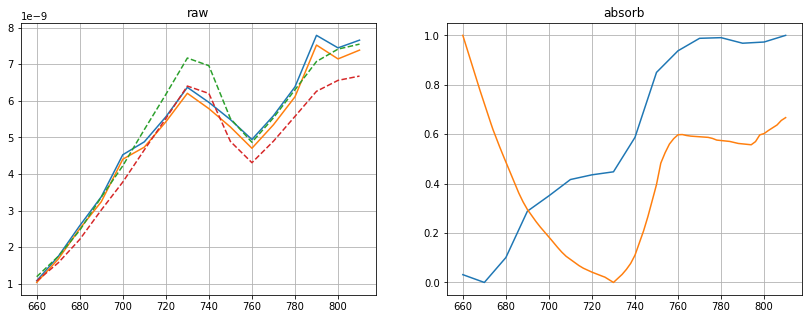

parameters: 
0.7757510881165581
data/calibrated/20190528_split/IJV/20190528_split_3_2.csv
iter: 3 | loss: 3.61255798730791


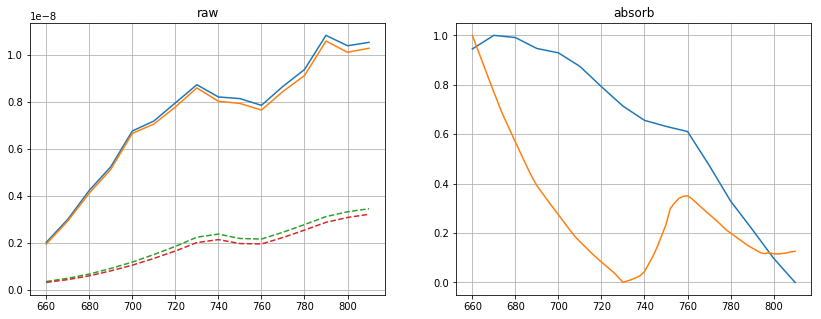

parameters: 
0.5748074364911263
iter: 7 | loss: 2.2033587696306167


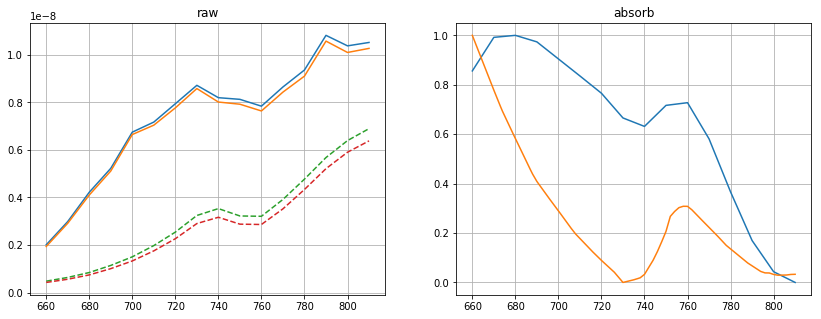

parameters: 
0.48864320667857775
iter: 30 | loss: 0.7707631535562911


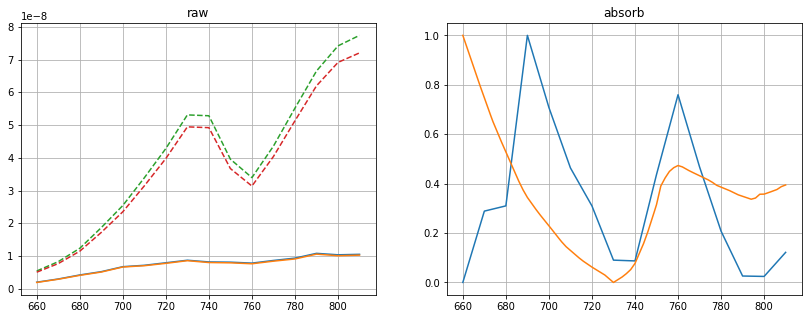

parameters: 
0.7091065587989966
iter: 51 | loss: 0.558180973827124


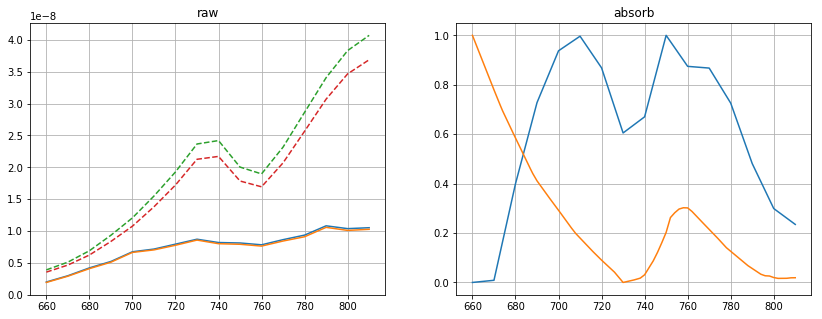

parameters: 
0.47243104110100526
iter: 58 | loss: 0.2897307504063681


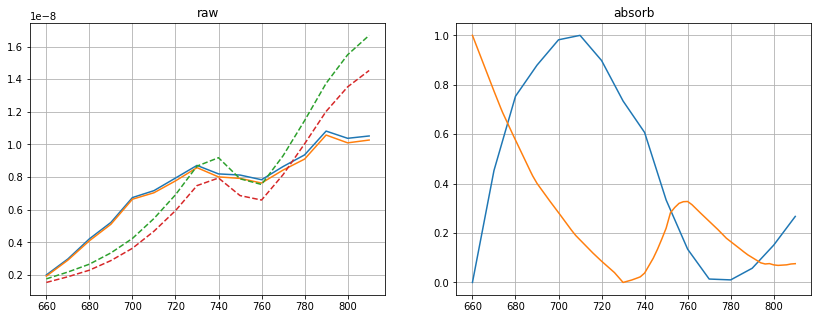

parameters: 
0.5327543382003221
iter: 66 | loss: 0.23853194417340423


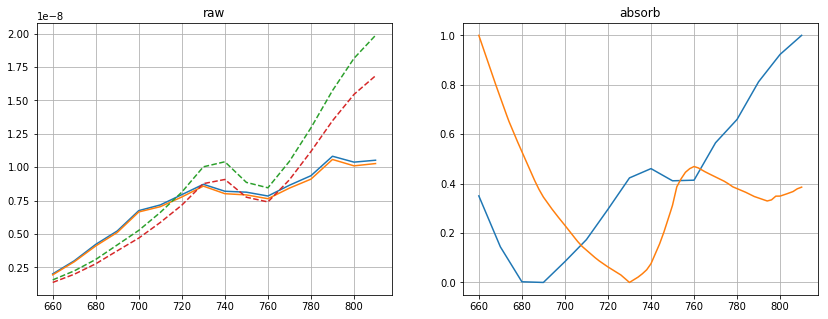

parameters: 
0.7061687317287428
iter: 267 | loss: 0.19715884191831598


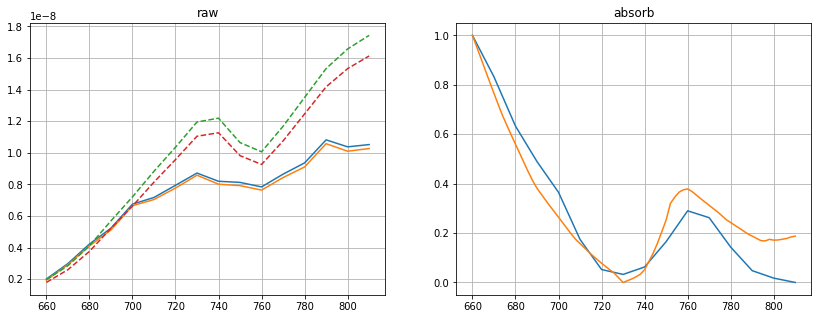

parameters: 
0.6164806405011611
iter: 312 | loss: 0.1559219558685221


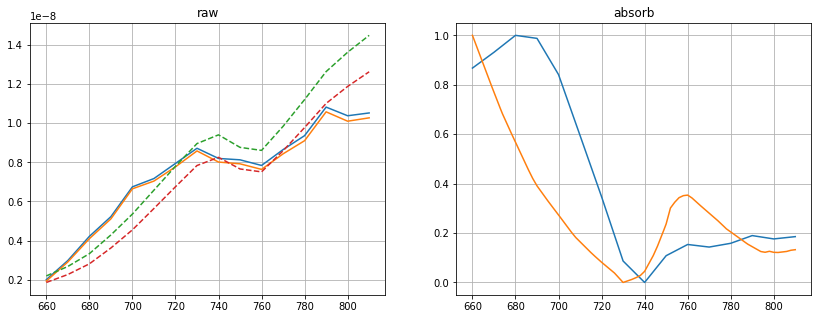

parameters: 
0.5797304165012129
iter: 679 | loss: 0.11526657850581312


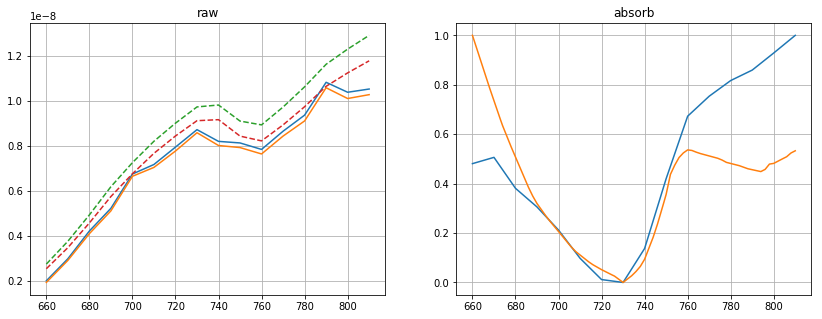

parameters: 
0.7478506901538735
iter: 2467 | loss: 0.11470107755393981


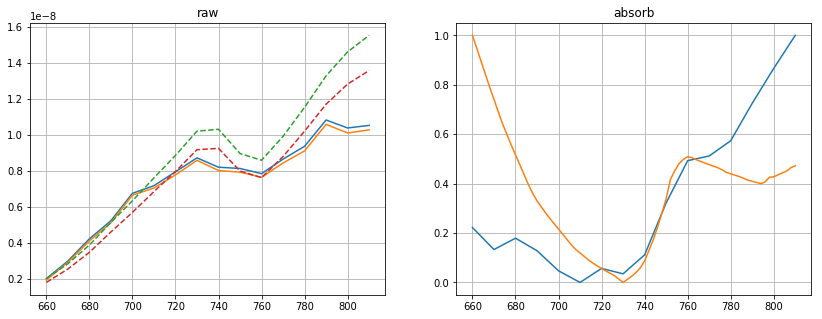

parameters: 
0.7324878016299243
iter: 3302 | loss: 0.105468965413833


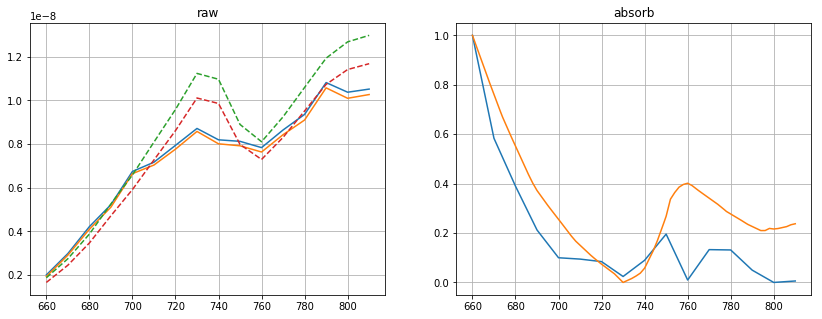

parameters: 
0.6445155204835742
iter: 5825 | loss: 0.0768345940550294


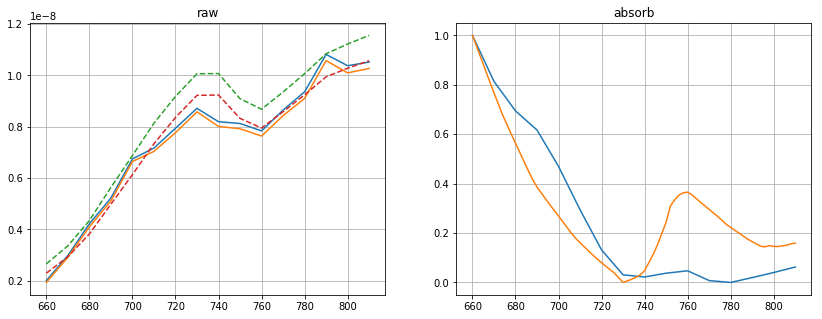

parameters: 
0.5983155641583264
iter: 6834 | loss: 0.07465776151302159


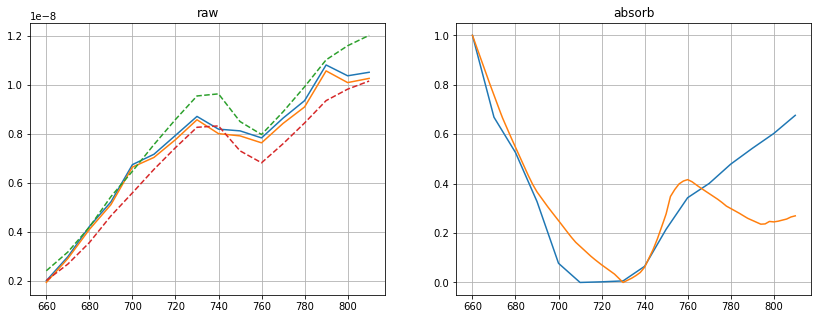

parameters: 
0.6601735027289781
iter: 8548 | loss: 0.06843929560097445


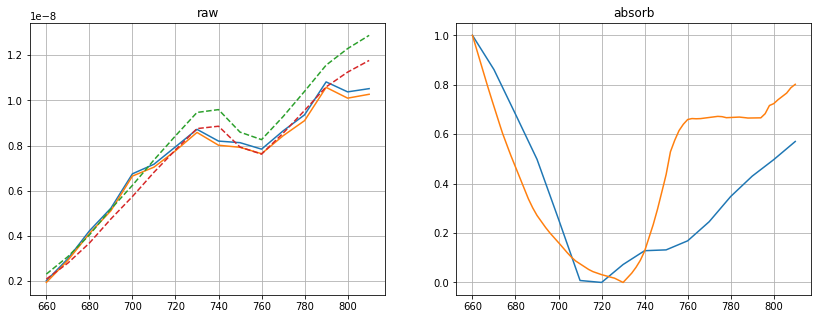

parameters: 
0.7974570270131967
iter: 9364 | loss: 0.06755476302494004


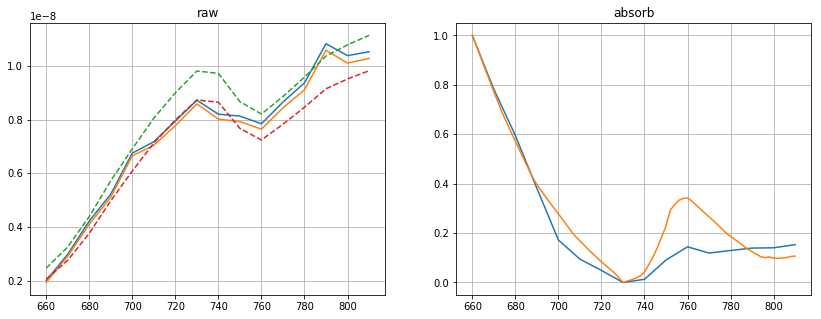

parameters: 
0.5595810921703516
data/calibrated/20190528_split/IJV/20190528_split_3_3.csv
iter: 3 | loss: 0.10683327965712813


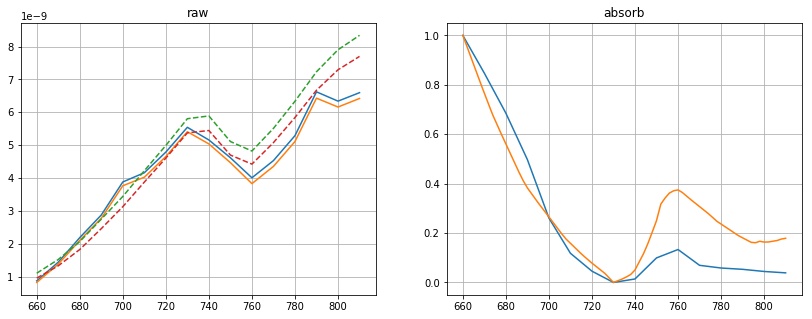

parameters: 
0.6111015445656417
iter: 119 | loss: 0.10665822039027315


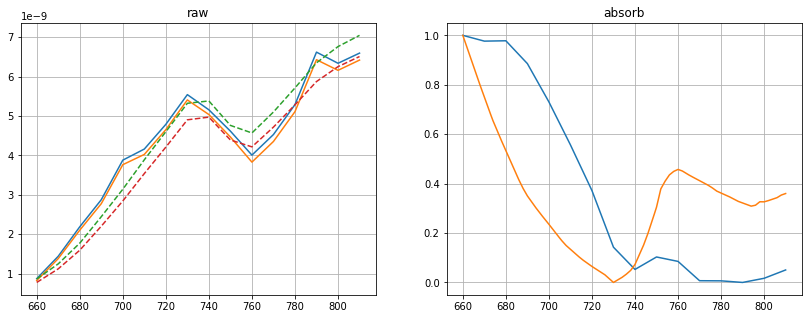

parameters: 
0.6971752320300013
iter: 1019 | loss: 0.10294612385528351


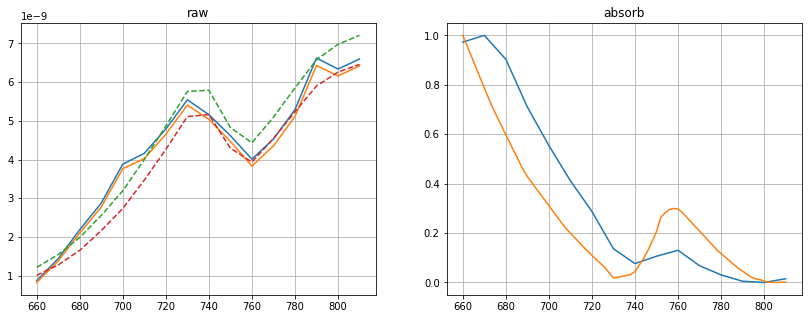

parameters: 
0.42365787211750683
iter: 2360 | loss: 0.09544943722053496


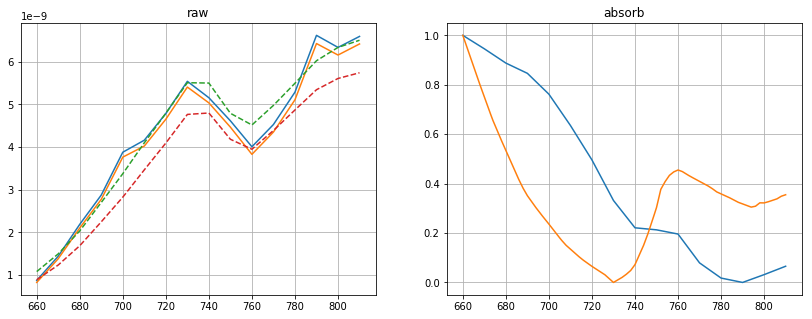

parameters: 
0.6954010057292144
iter: 5661 | loss: 0.07175883957673262


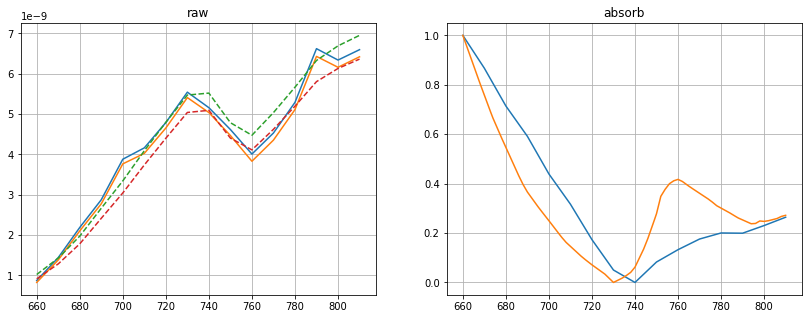

parameters: 
0.661191492322887
data/calibrated/20190528_split/IJV/20190528_split_3_4.csv
iter: 0 | loss: 0.6692893400951165


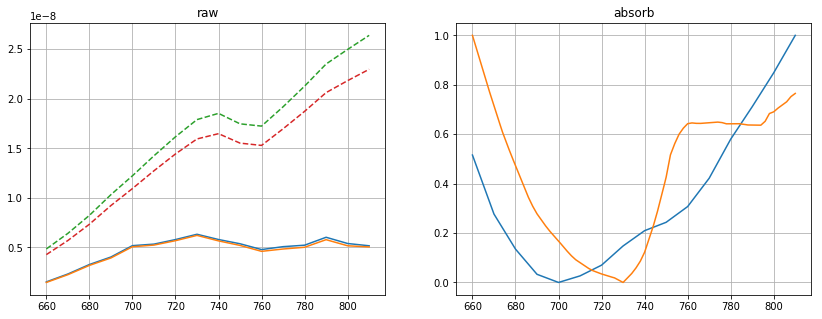

parameters: 
0.7920332267275231
iter: 3 | loss: 0.539199076306182


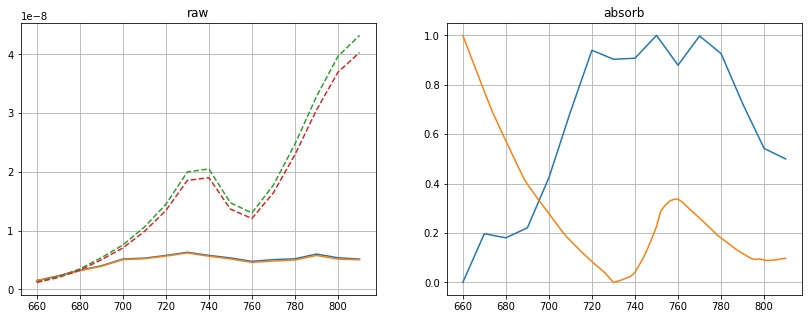

parameters: 
0.5519195432626559
iter: 5 | loss: 0.3626732098969837


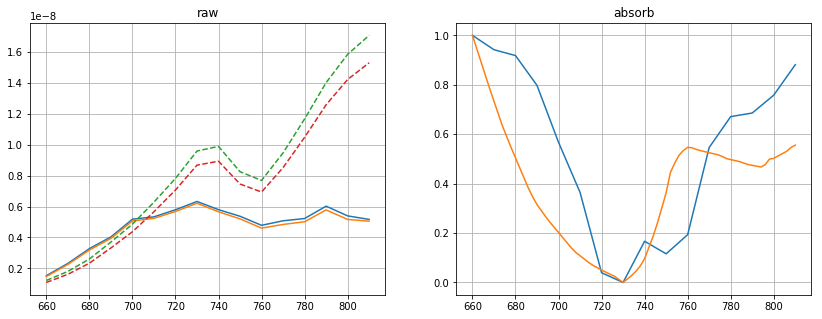

parameters: 
0.7531401188971428
iter: 98 | loss: 0.33736248195415636


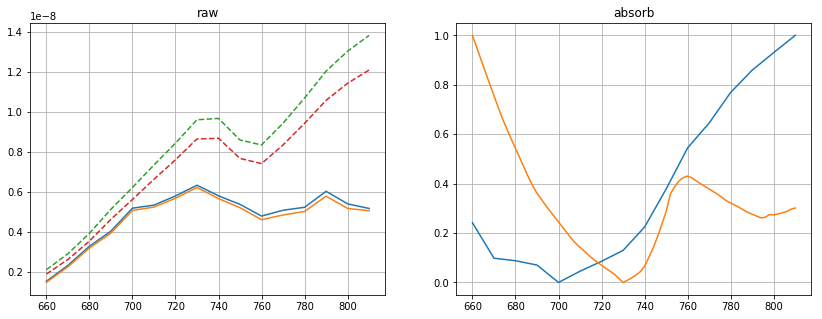

parameters: 
0.6742766249437989
iter: 141 | loss: 0.3250455232709064


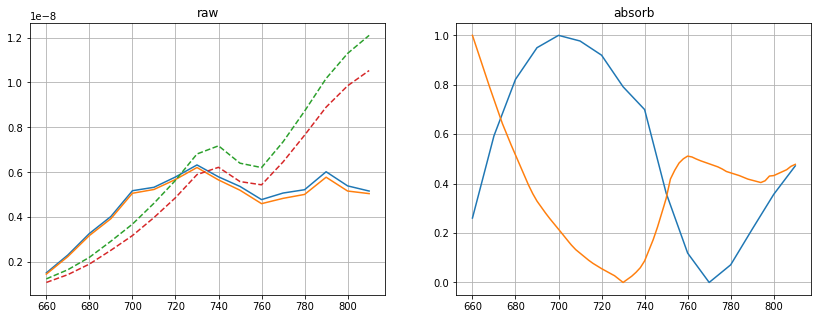

parameters: 
0.7339520473331846
iter: 206 | loss: 0.16606472610120704


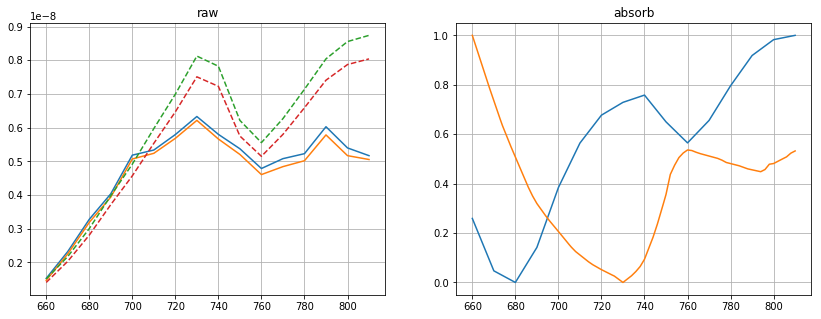

parameters: 
0.7477018369291436
iter: 4240 | loss: 0.10967678694812712


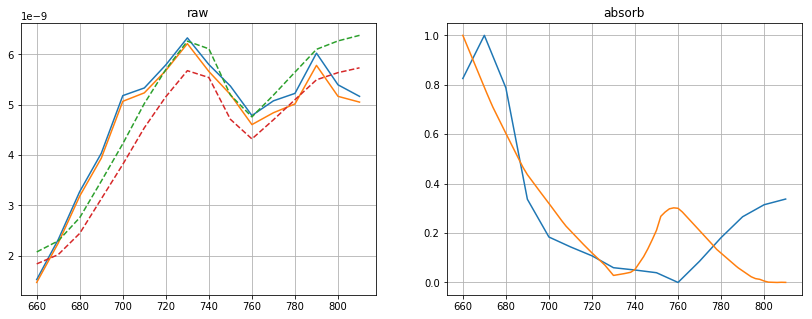

parameters: 
0.4067972707053127
iter: 5272 | loss: 0.070587342198423


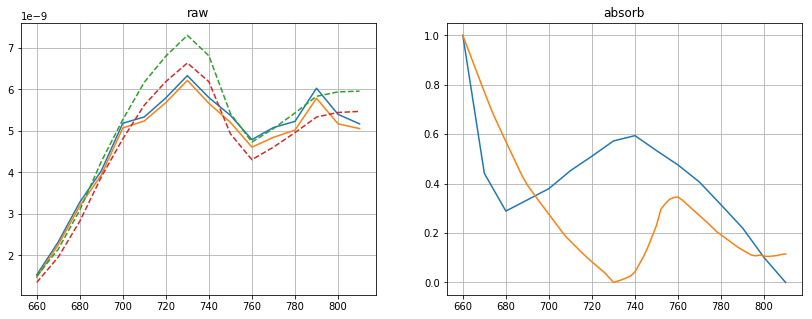

parameters: 
0.5664507443278387
data/calibrated/20190528_split/IJV/20190528_split_3_5.csv
iter: 0 | loss: 0.6520261237279117


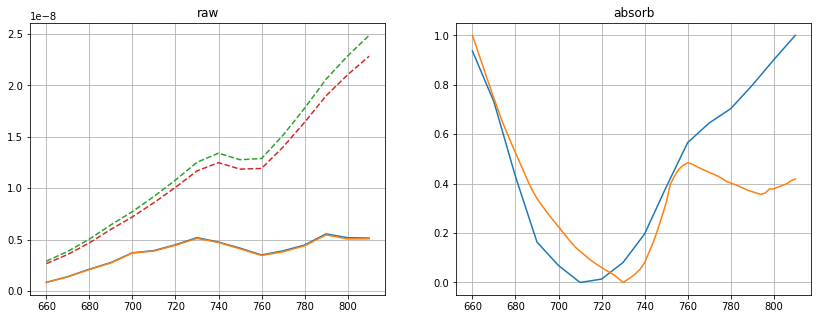

parameters: 
0.716783294227273
iter: 113 | loss: 0.4563149698161897


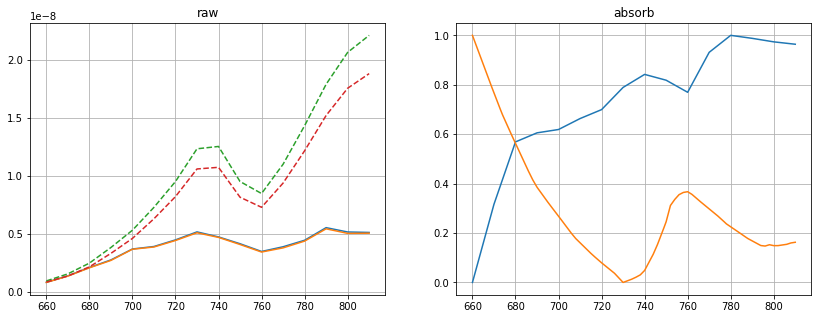

parameters: 
0.6007917270859131
iter: 116 | loss: 0.3300401764774241


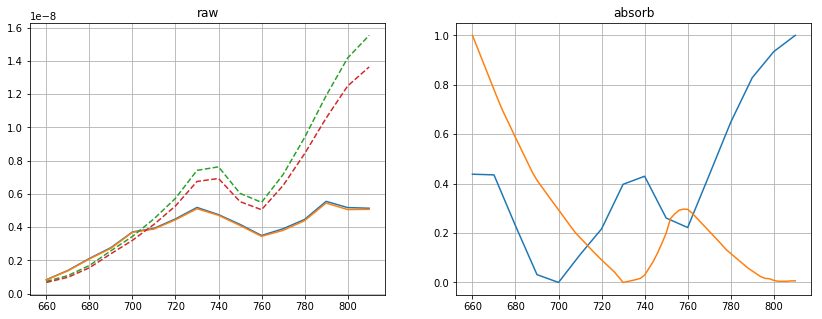

parameters: 
0.45672095467329
iter: 125 | loss: 0.26557384366108827


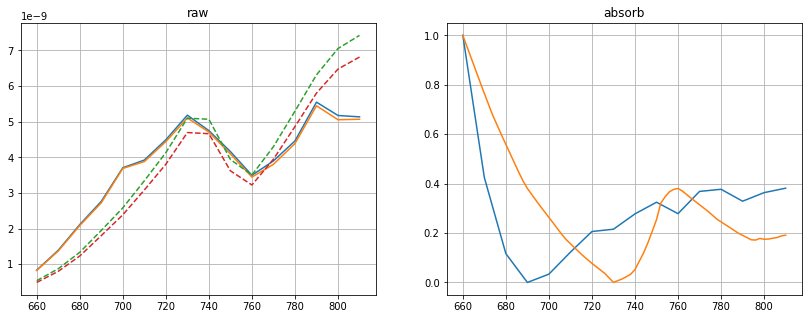

parameters: 
0.6189589074827886
iter: 197 | loss: 0.21332108770389252


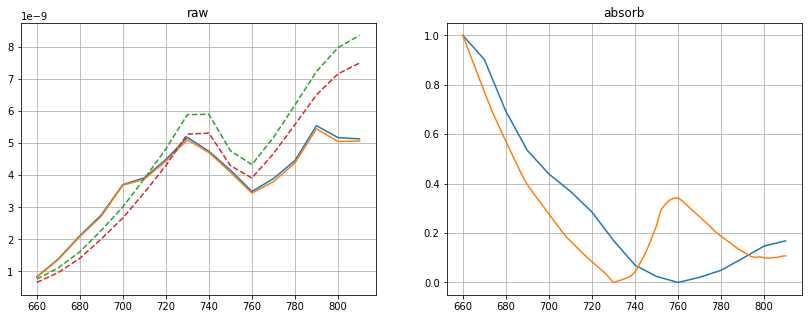

parameters: 
0.5603651709705293
iter: 235 | loss: 0.19979238446087502


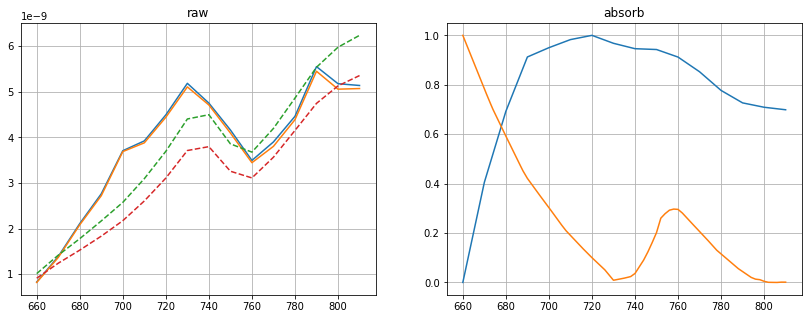

parameters: 
0.4377300949821519
iter: 504 | loss: 0.1211333278412002


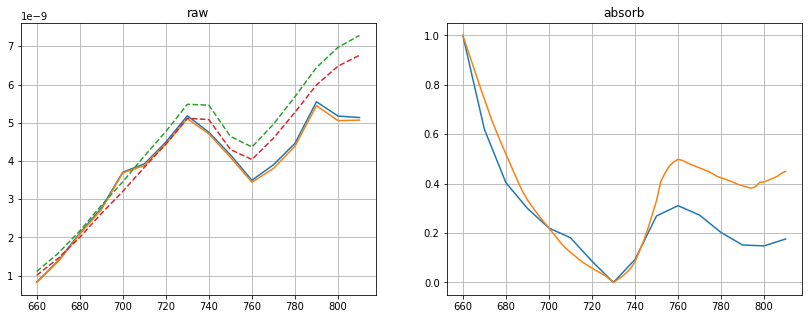

parameters: 
0.7259863979004817
iter: 1792 | loss: 0.0710609266953788


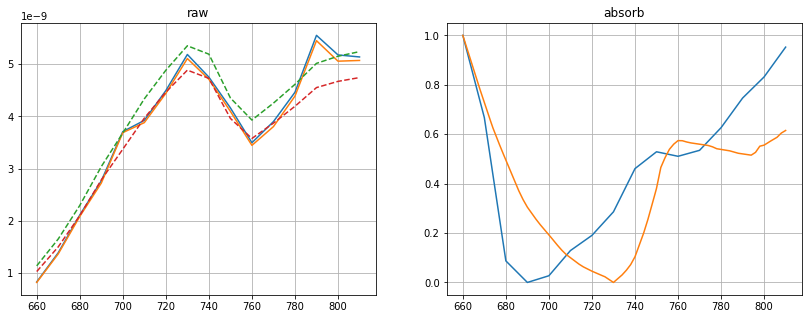

parameters: 
0.7658182075243771
data/calibrated/20190528_split/IJV/20190528_split_4_1.csv
iter: 11 | loss: 1.132266736590958


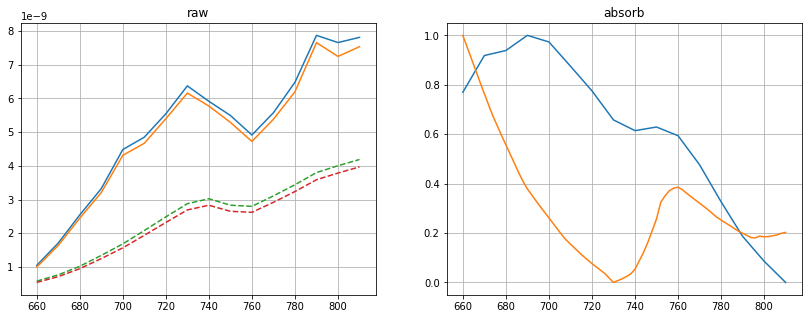

parameters: 
0.6253678953233436
iter: 14 | loss: 0.2919735252165978


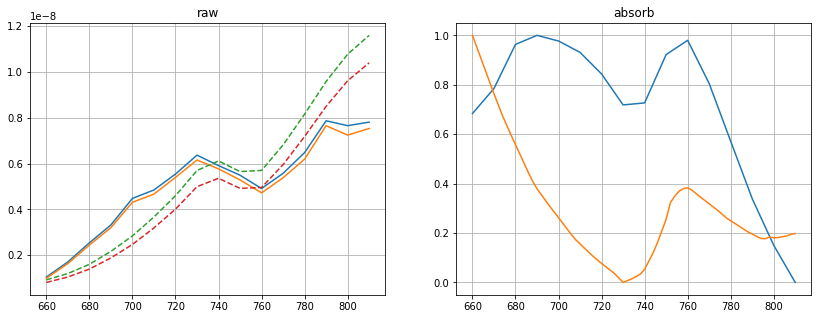

parameters: 
0.6228443966528786
iter: 118 | loss: 0.22597190527826544


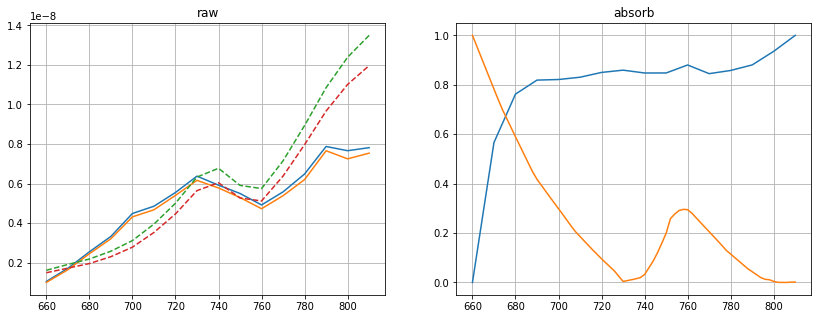

parameters: 
0.4447326434616568
iter: 171 | loss: 0.18621367770371516


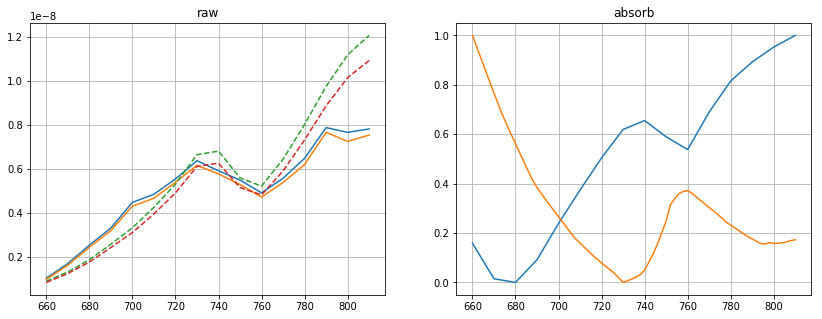

parameters: 
0.6072479037328884
iter: 374 | loss: 0.1802655503928815


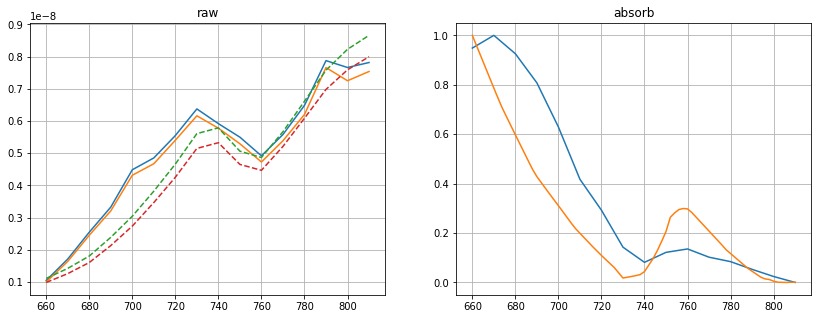

parameters: 
0.4240323320104315
iter: 437 | loss: 0.11754231317992053


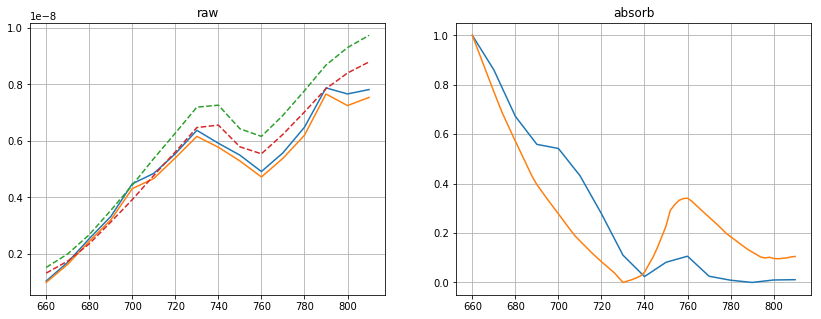

parameters: 
0.5582305247494872
iter: 683 | loss: 0.11154247323953868


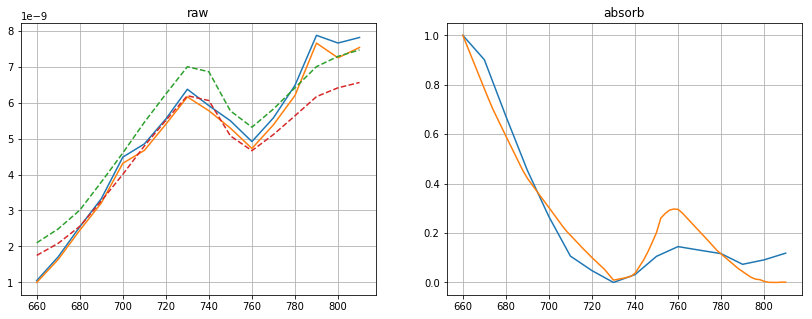

parameters: 
0.4369562233950139
iter: 1990 | loss: 0.10764195412024309


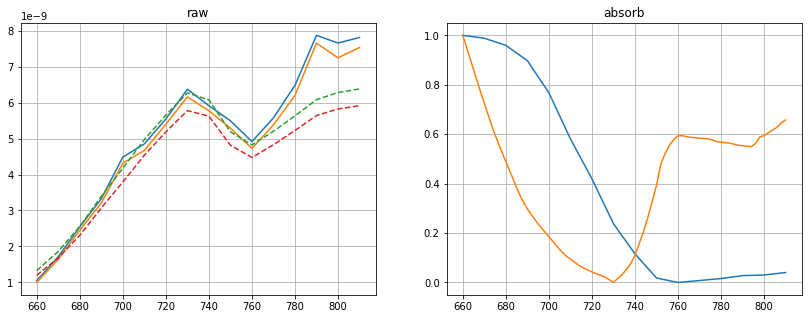

parameters: 
0.7740028115907901
iter: 2033 | loss: 0.08991247739817013


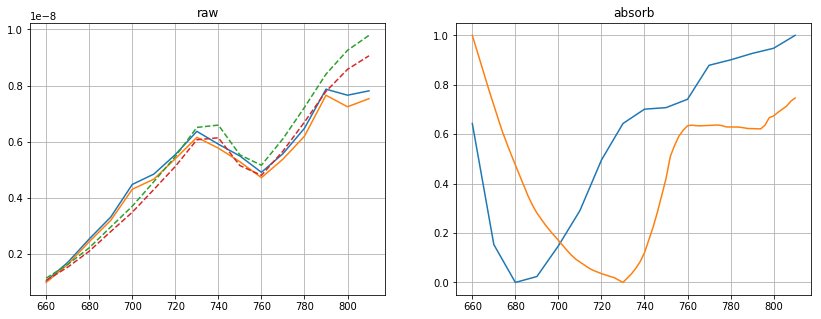

parameters: 
0.7891458823956702
iter: 3116 | loss: 0.07598393827176189


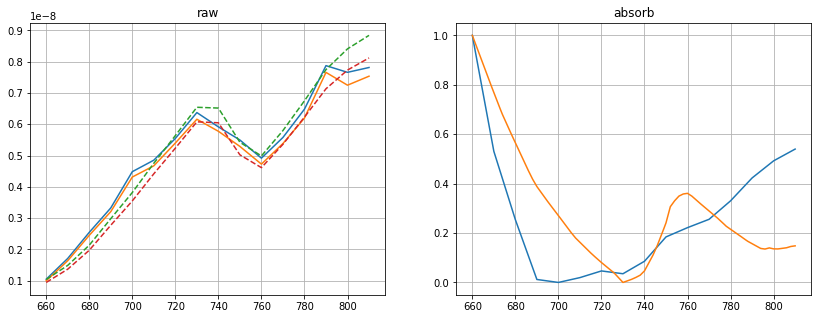

parameters: 
0.590919132974677
iter: 9746 | loss: 0.05165932473292133


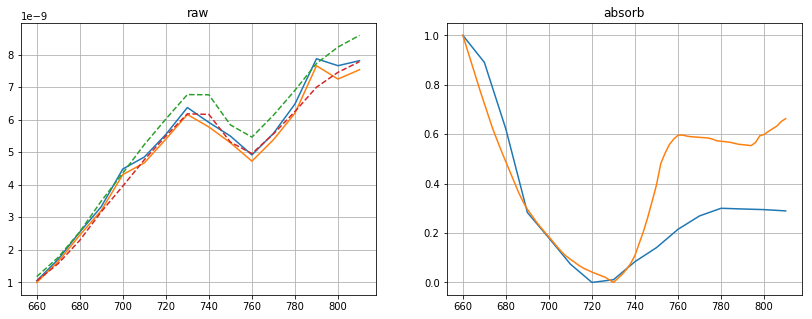

parameters: 
0.7749927121564925
data/calibrated/20190528_split/IJV/20190528_split_4_2.csv
iter: 0 | loss: 0.8584249644880186


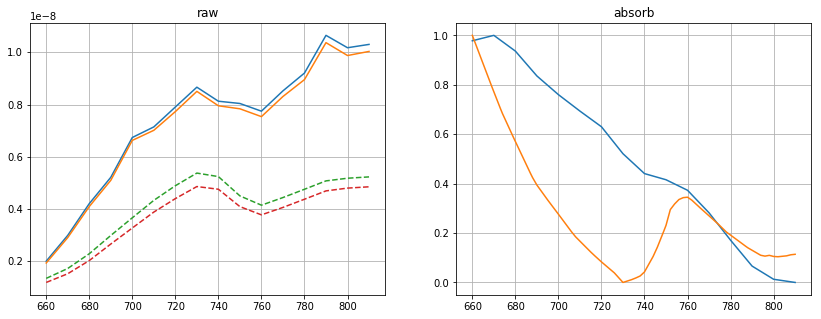

parameters: 
0.565415887292709
iter: 37 | loss: 0.11235459556659921


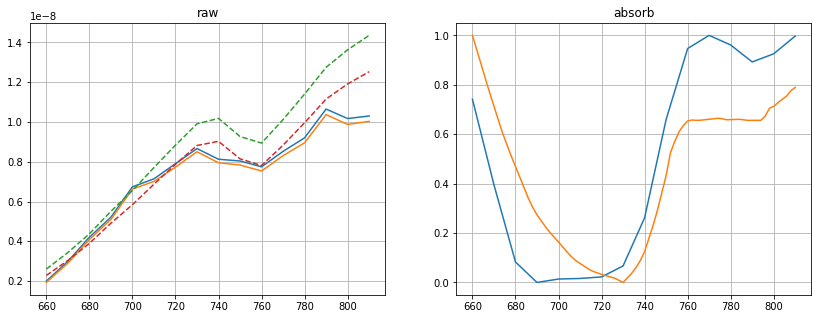

parameters: 
0.795662483918517
iter: 523 | loss: 0.10305080142841655


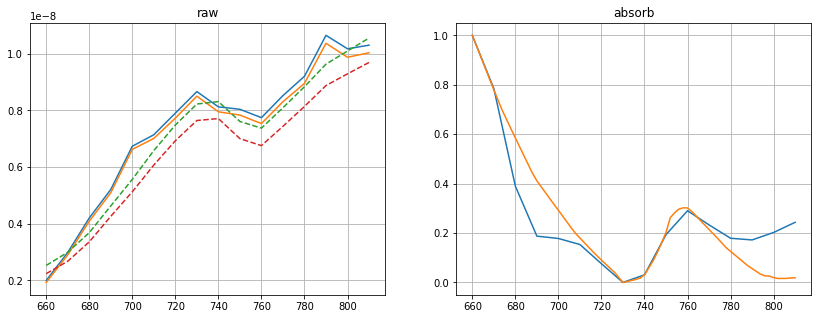

parameters: 
0.47194000520687424
iter: 2038 | loss: 0.08689472667711909


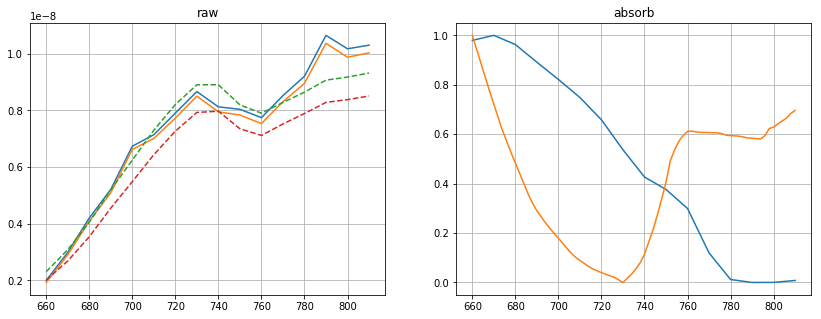

parameters: 
0.7808933001617328
iter: 5072 | loss: 0.07032519922756944


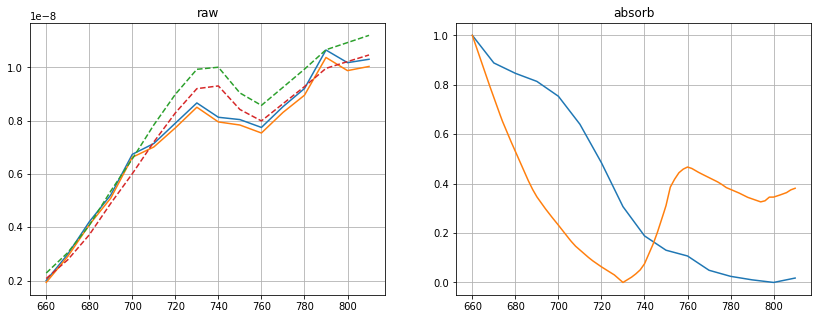

parameters: 
0.704639127804985
data/calibrated/20190528_split/IJV/20190528_split_4_3.csv
iter: 4 | loss: 0.751906457579221


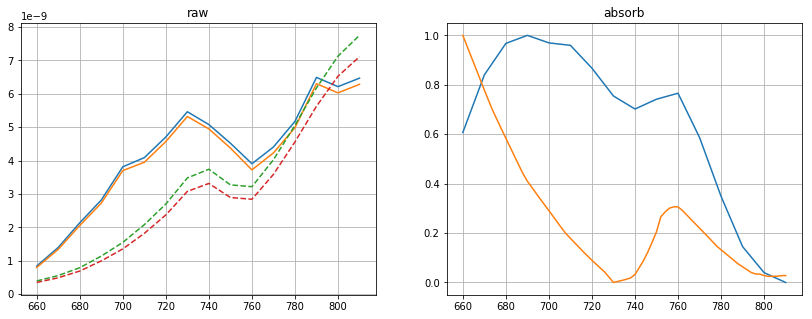

parameters: 
0.4828163054359229
iter: 14 | loss: 0.10852261819455455


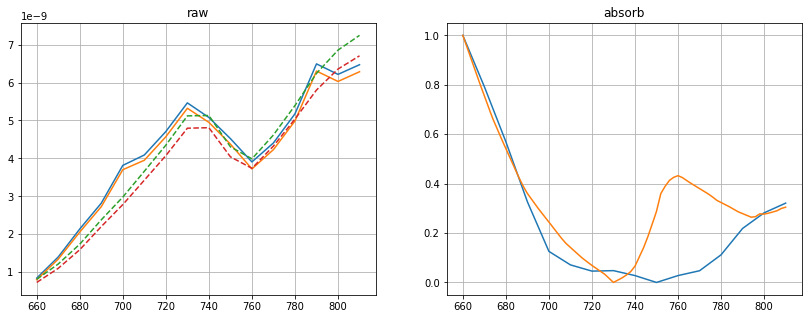

parameters: 
0.6756522033697199
iter: 1825 | loss: 0.09941571011724532


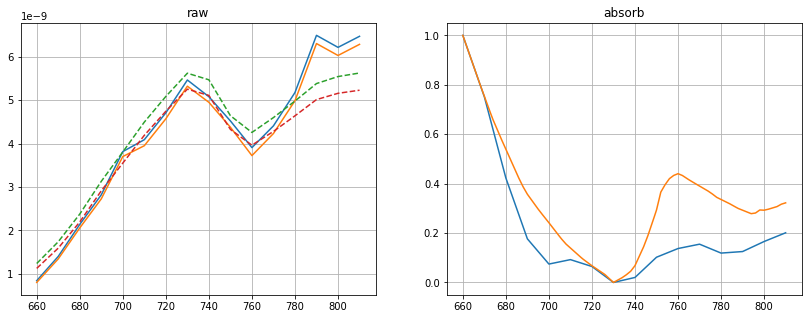

parameters: 
0.6828769706717901
iter: 4145 | loss: 0.07794621495955362


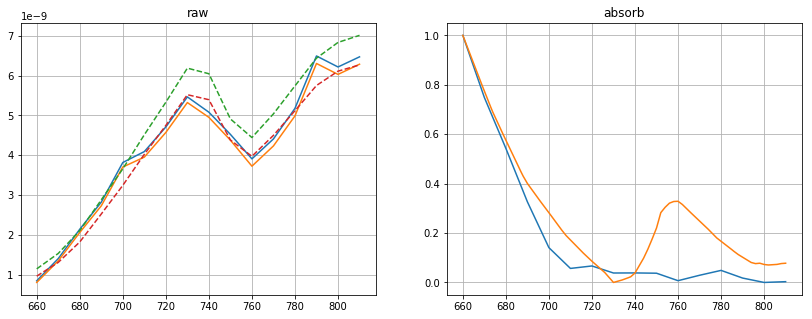

parameters: 
0.5344236829210968
iter: 4789 | loss: 0.06840802321138591


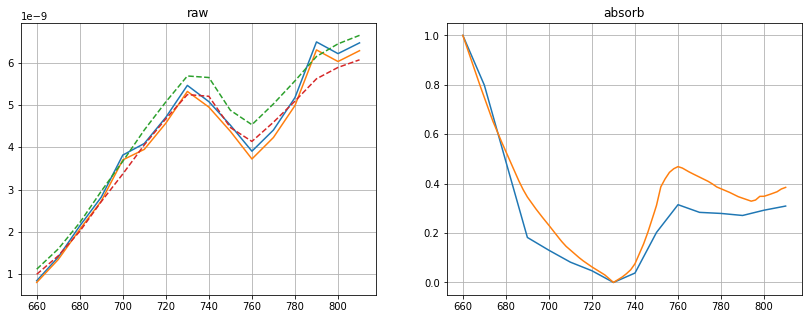

parameters: 
0.7058557681069922
data/calibrated/20190528_split/IJV/20190528_split_5_1.csv
iter: 3 | loss: 9.752377269094218


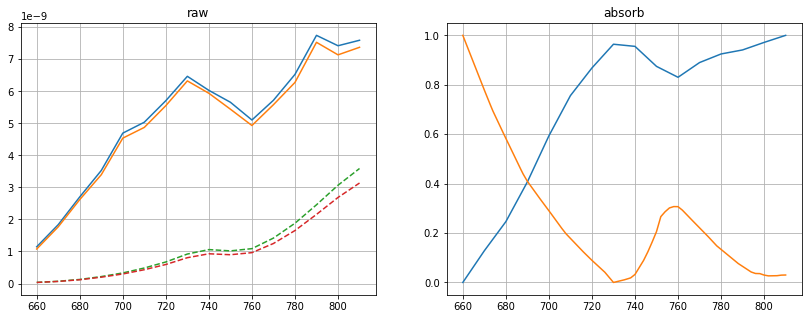

parameters: 
0.4853777372808551
iter: 6 | loss: 0.9609114385864646


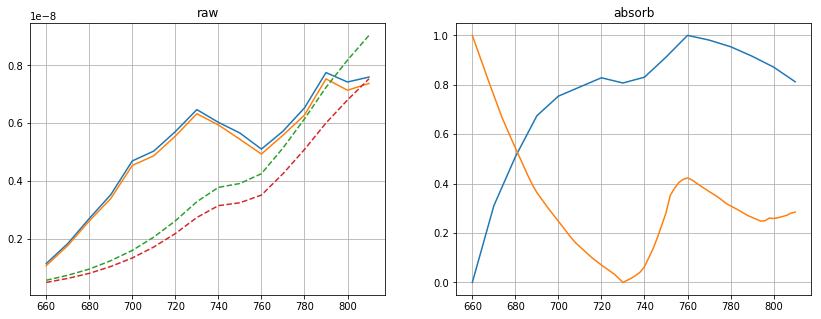

parameters: 
0.6671428307100891
iter: 12 | loss: 0.9289232451661427


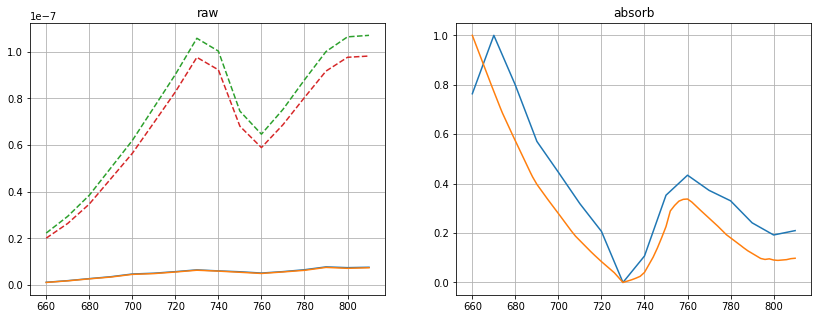

parameters: 
0.5522603821918428
iter: 15 | loss: 0.4340682191453734


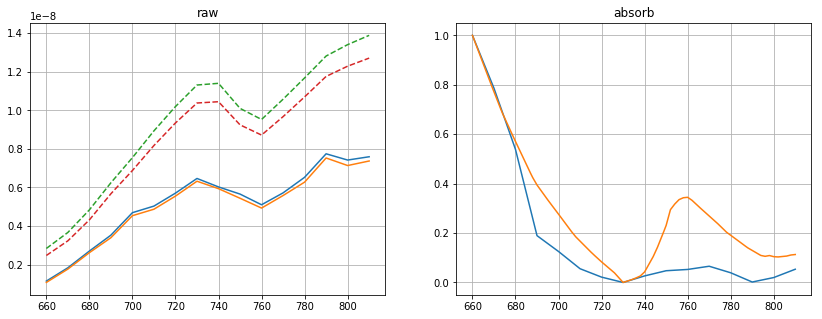

parameters: 
0.5646984135626304
iter: 37 | loss: 0.09512397863762603


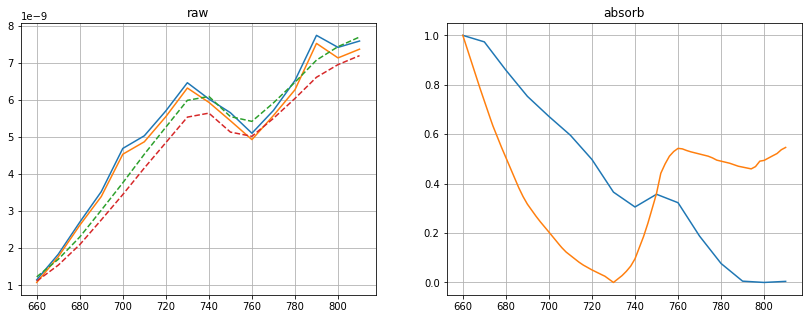

parameters: 
0.751017417046109
iter: 2720 | loss: 0.09475562581446112


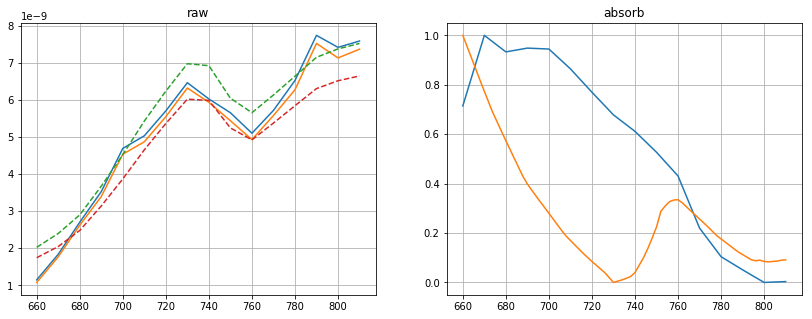

parameters: 
0.5468005647479406
iter: 3042 | loss: 0.06592397752611942


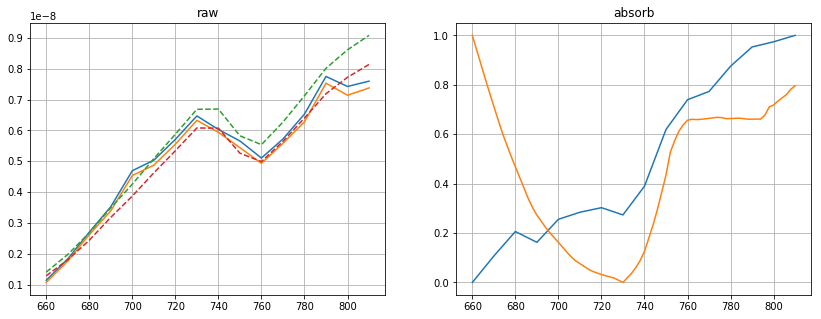

parameters: 
0.796583722870856
data/calibrated/20190528_split/IJV/20190528_split_5_2.csv
iter: 1 | loss: 0.8640507061955548


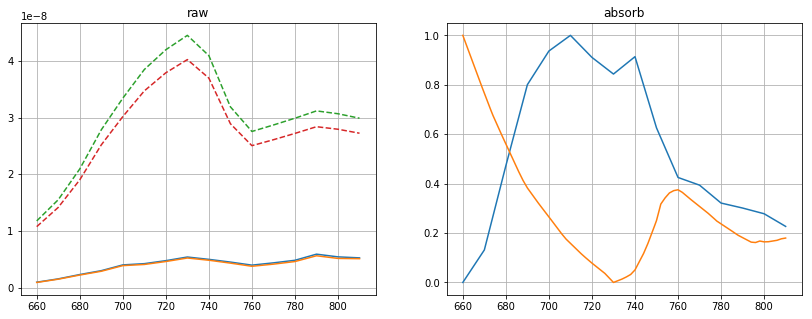

parameters: 
0.6117430050937608
iter: 4 | loss: 0.5648170004250381


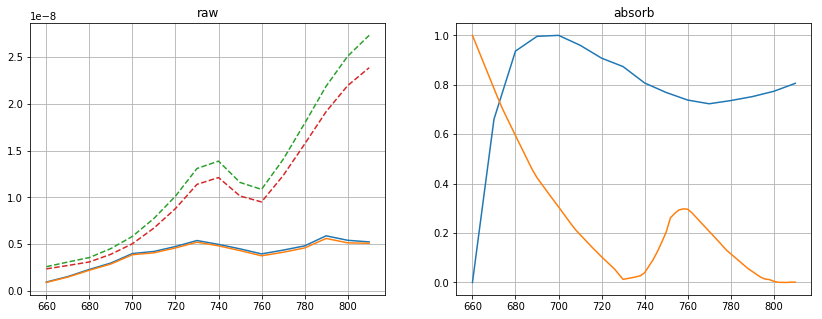

parameters: 
0.4324767648251254
iter: 37 | loss: 0.5324644979891162


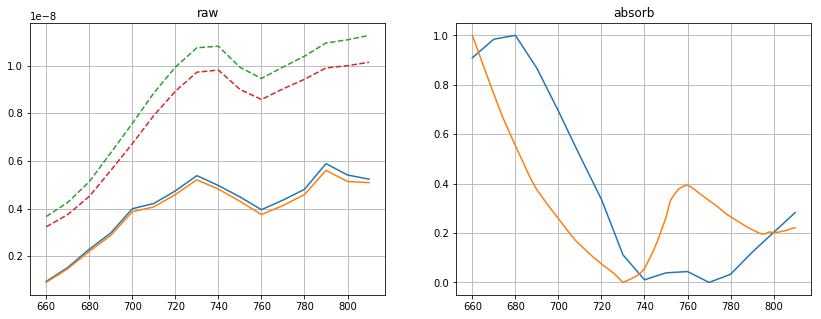

parameters: 
0.635962187899328
iter: 43 | loss: 0.5047557362542092


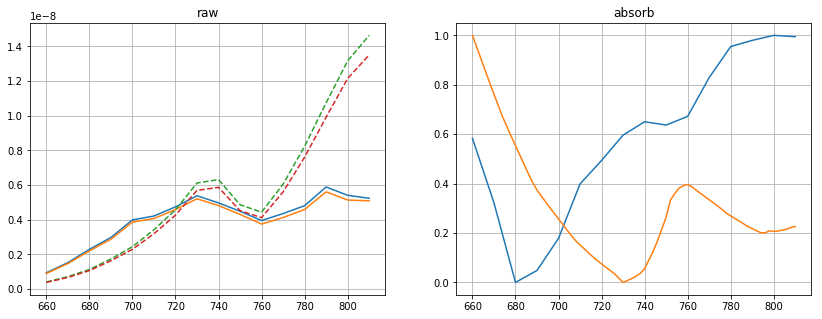

parameters: 
0.6387767550121541
iter: 62 | loss: 0.3017801692548177


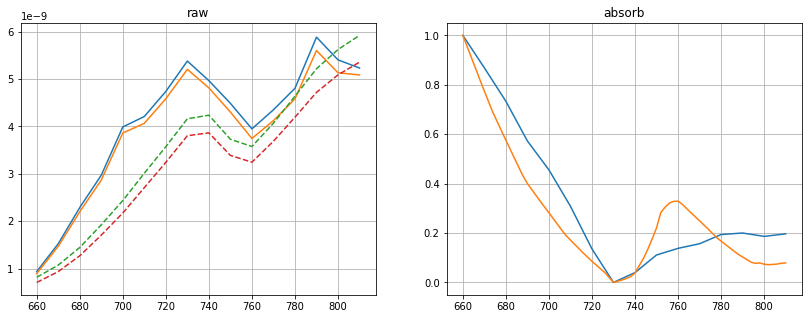

parameters: 
0.5355817871084343
iter: 80 | loss: 0.24235346078410896


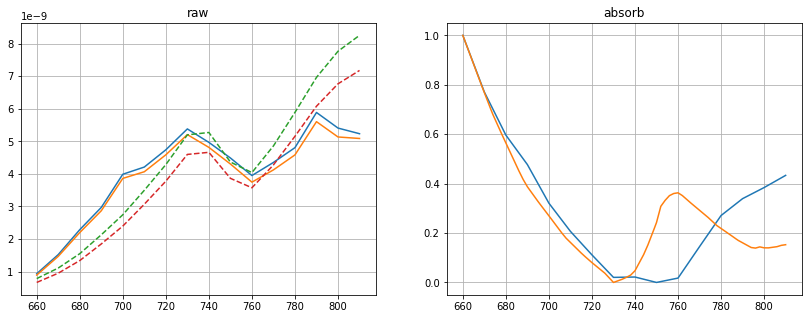

parameters: 
0.5941303137724068
iter: 154 | loss: 0.21242806351377025


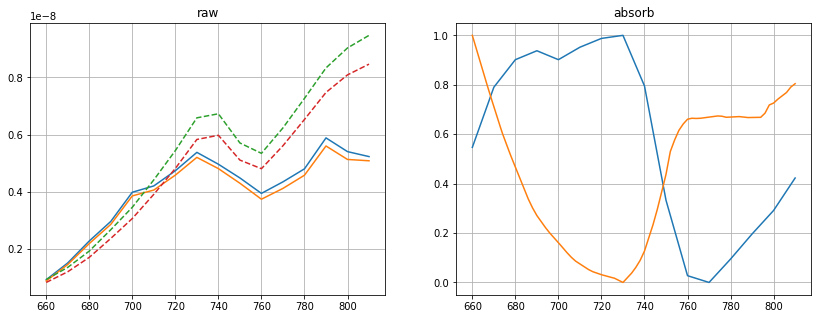

parameters: 
0.7978252726398143
iter: 198 | loss: 0.2107913627574087


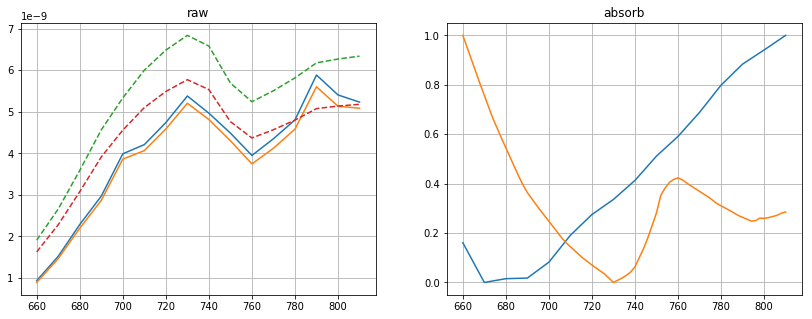

parameters: 
0.6672603802582598
iter: 210 | loss: 0.13357749803680674


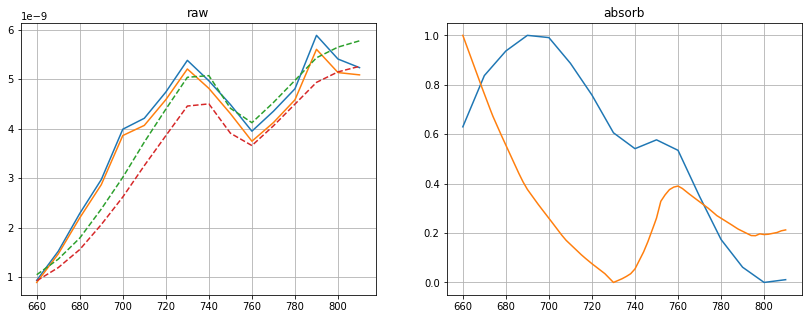

parameters: 
0.6311682502535555
iter: 1085 | loss: 0.1247225312603836


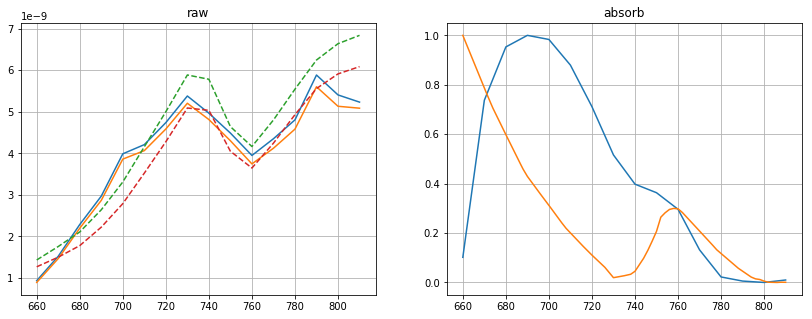

parameters: 
0.4217680403291784
iter: 1492 | loss: 0.11789477983935323


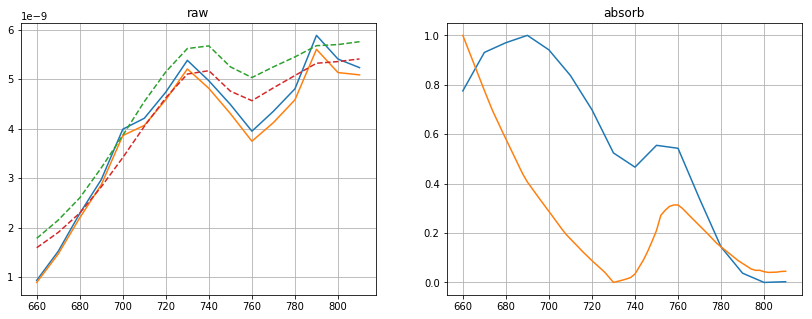

parameters: 
0.502121601177007
iter: 1503 | loss: 0.10053045974512795


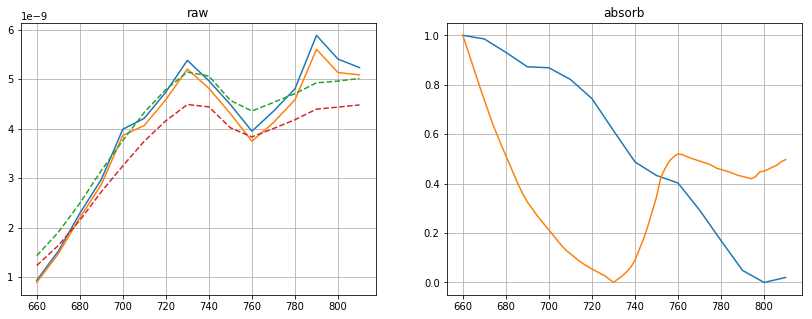

parameters: 
0.7390818281780138
iter: 8289 | loss: 0.0932874157187846


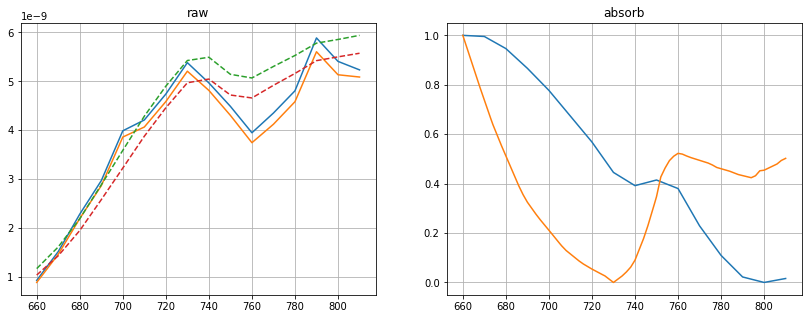

parameters: 
0.7402969026433598
iter: 9558 | loss: 0.07642569593857762


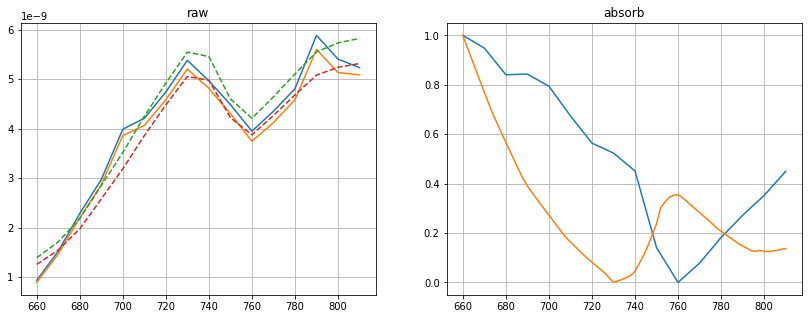

parameters: 
0.582840170180704
data/calibrated/20190528_split/IJV/20190528_split_5_3.csv
iter: 0 | loss: 0.5531406911540857


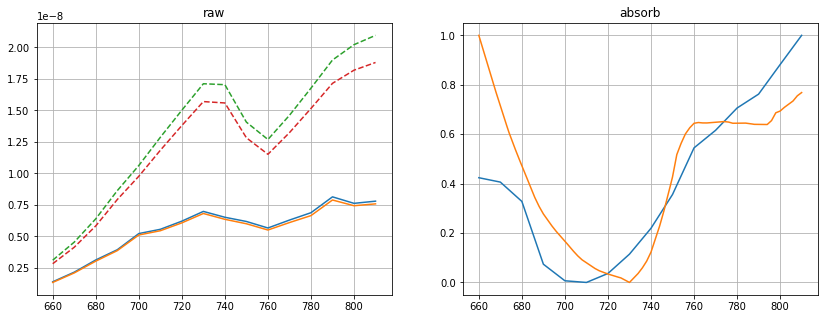

parameters: 
0.7925481663626862
iter: 22 | loss: 0.16330627410487786


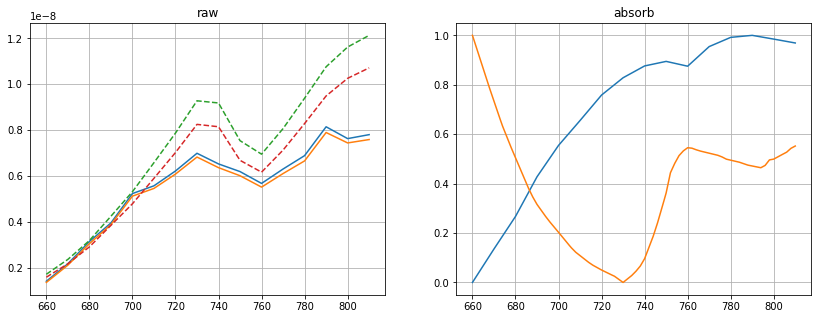

parameters: 
0.7523393962202447
iter: 101 | loss: 0.14572142598324958


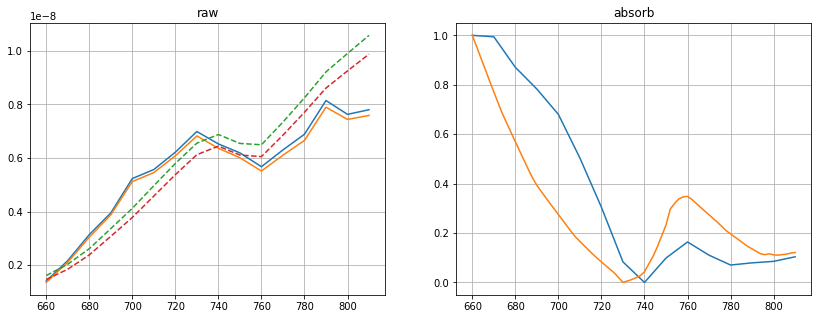

parameters: 
0.5709765115876275
iter: 406 | loss: 0.13348314510768494


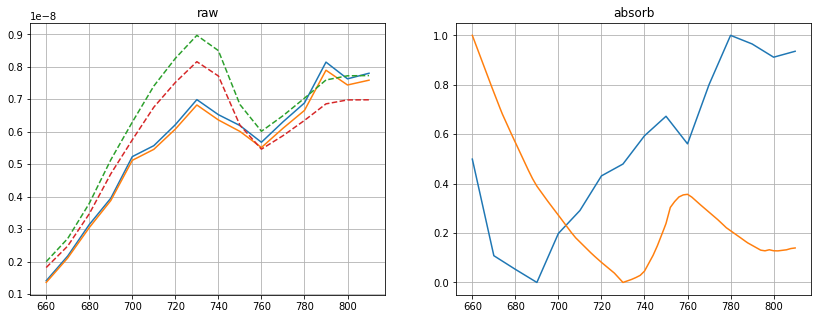

parameters: 
0.584852969169781
iter: 421 | loss: 0.1275085321982244


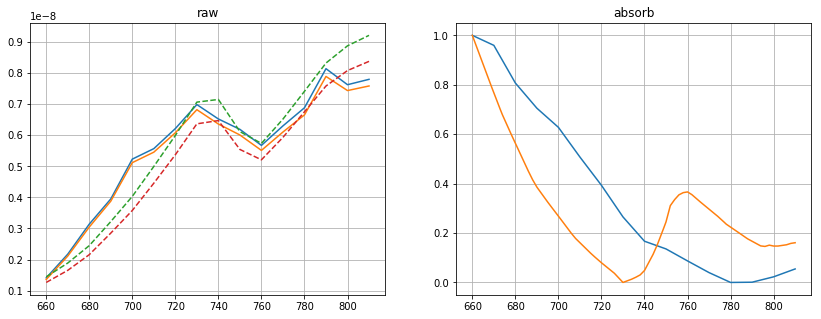

parameters: 
0.5995563256860208
iter: 718 | loss: 0.08840073356144287


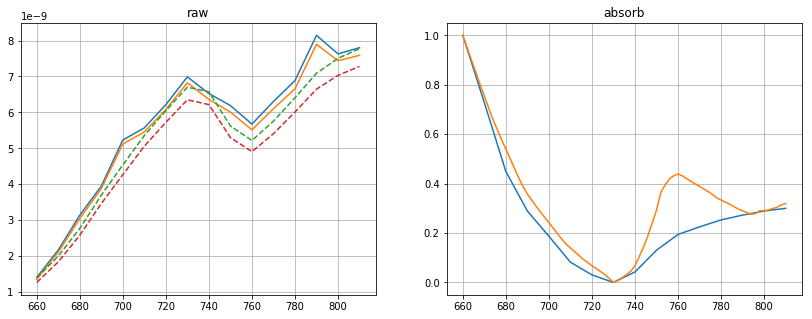

parameters: 
0.6817239807171008
iter: 2503 | loss: 0.0875588874292427


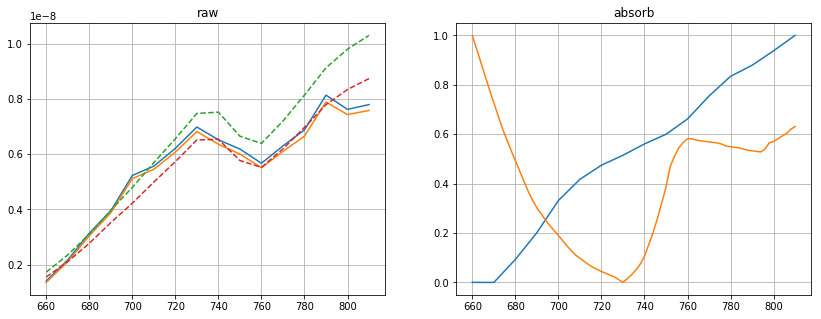

parameters: 
0.7689901100897145
iter: 4634 | loss: 0.08044240524398899


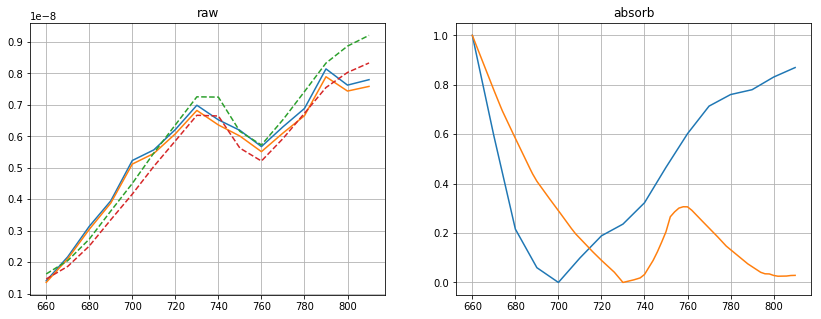

parameters: 
0.48364656344202
iter: 9467 | loss: 0.07278246687567297


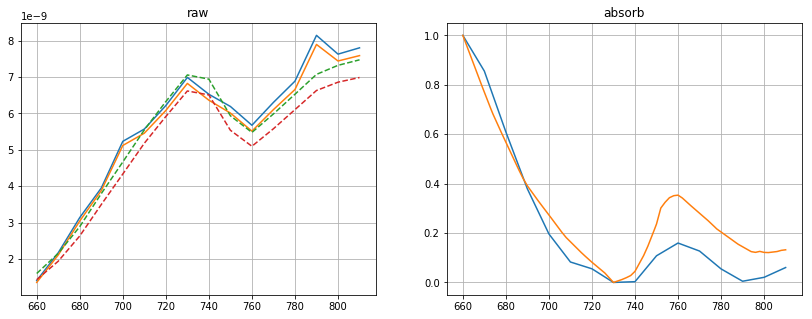

parameters: 
0.5794251457309472


In [82]:
for s in spec_list:
    print(s)
    spec = pd.read_csv(s)
    spec = spec[
        (spec["wavelength"] >= wl[0])&
        (spec["wavelength"] <= wl[-1])
    ]
    spec_max = spec["max"].values.T
    spec_min = spec["min"].values.T
    
    spec_max_n = normalize(spec_max)
    spec_min_n = normalize(spec_min)

    min_loss = 100
    min_args = {}
    for i in range(10000):
        args_max, args_min = get_args(
            geo_max=[2.18, 1.91, 5.28 + uniform(-0.1, 0.1), 15.36, 2.81, 24.32, 0.77],
            geo_min=[2.18, 1.91, 4.86 + uniform(-0.1, 0.1), 15.36, 2.81, 24.32, 0.77]
        )
        pred_max = engine.get_spectrum(args_min, warning=False)
        pred_min = engine.get_spectrum(args_max, warning=False)
        
        pred_max_n = normalize(pred_max)
        pred_min_n = normalize(pred_min)
        
#         loss = (rmse_loss(pred_max_n, spec_max_n) + rmse_loss(pred_min_n, spec_min_n))/2  
#         loss = (rmse_loss(pred_max, spec_max) + rmse_loss(pred_min, spec_min))/2
        
        loss = (rmsp_loss(pred_max, spec_max) + rmsp_loss(pred_min, spec_min))/2 \
#         + 0.001 * rmse_loss(
#             normalize(np.log(spec_max/spec_min)), normalize(np.log(pred_max/pred_min))
#         )
        if min_loss > loss:
            print("iter: {} | loss: {}".format(i, loss))
            min_loss = loss
            min_args = args_min
            
            fig, ax = plt.subplots(1, 2, figsize=(14, 5))
            ax[0].plot(wl, spec_max, label="spec_max")
            ax[0].plot(wl, spec_min, label="spec_min")
            ax[0].plot(wl, pred_max, '--', label="pred_max")
            ax[0].plot(wl, pred_min, '--', label="pred_min")
            ax[0].set_title("raw")
            ax[0].grid()
            
#             ax[1].plot(wl, spec_max_n, label="spec_max")
#             ax[1].plot(wl, spec_min_n, label="spec_min")
#             ax[1].plot(wl, pred_max_n, '--', label="pred_max")
#             ax[1].plot(wl, pred_min_n, '--', label="pred_min")
#             ax[1].set_title("norm")
#             plt.show()
            
#             ax[1].plot(wl, normalize(np.log(spec_max/spec_min)))
            ax[1].plot(wl, normalize(np.log(pred_max/pred_min)))
            sss = args_max["IJV"]["ScvO2"]
            ax[1].plot(mua["wavelength"], normalize(oxy * sss + deoxy * (1-sss)))
            ax[1].set_title("absorb")
            
            ax[1].grid()
            plt.show()
            
            print("parameters: ")
            print(args_max["IJV"]["ScvO2"])
            with open("fitting/" + s.split('/')[-1].strip('.csv') + ".json", 'w') as f:
                args_max["rmsp"] = loss
                json.dump(args_max, f, indent=4)
            
    
